# Packages

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from sklearn.preprocessing import MinMaxScaler
import copy as cp
import math
import warnings
import networkx as nx
warnings.filterwarnings("ignore")
import time
from scipy.integrate import ode
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from scipy.stats import norm
import time
from pandas import Series
from matplotlib import pyplot
from pandas.plotting import lag_plot
from statsmodels.tsa.ar_model import AR
from sklearn.metrics import mean_squared_error

import statsmodels.api as sm
import statsmodels.tsa.api as smt
import statsmodels.formula.api as smf
import warnings
import itertools
from sklearn.metrics import mean_squared_error
import gc
#%load_ext cython

In [2]:
%store 

Stored variables and their in-db values:


# Read Networks

In [41]:
 #load the edges list
Follow_AdjList = np.array(pd.read_csv("follower_gcc.anony.dat", header = None, sep=" "))

In [42]:
 #set number of users
Nusers = np.max(Follow_AdjList)+1
print(Nusers)

595460


In [43]:
#create a list containing, for each node, the list of nodes connected to it.
Follow_ConnList = [[] for i in range(Nusers)]
for edge in Follow_AdjList:
    Follow_ConnList[edge[0]].append(edge[1])
    Follow_ConnList[edge[1]].append(edge[0])

# Read tweets dataset

In [10]:
%%cython -a    

#Open file and read it into a list of strings
cdef OpenFile(filename):          
    cdef list TS_list = []
    
    with open(filename, "r") as TS:
        TS_list = TS.readlines()
    return TS_list


# read file with OpenFile(), convert the list into a dict {tag: timeseries} 
# with timeseries = [[user, time], [user, time],...]
cpdef DataToDict(filename):       
    cdef list TS_list = OpenFile(filename) 
    cdef dict tag_dict = {}
    cdef long time
    cdef list tag_timeserie
    cdef str char 
    cdef str tag
    cdef long user
    for j in range(len(TS_list)):
        head = True
        prv = 0
        tag_timeserie = []
        for i in range(len(TS_list[j])):
            char = TS_list[j][i]
            if char == ' ' and head == True:
                tag = TS_list[j][0:i]
                head = False
                prv = i
            elif char == ',' and head == False:
                time = int(TS_list[j][prv+1:i])
                prv = i
            elif char == ' ' or char == '\n' and head == False:
                user = int(TS_list[j][prv+1:i])
                prv = i
                tag_timeserie.append([time, user])
        tag_dict[tag] = tag_timeserie
    return tag_dict

# read Retweets 

In [11]:
%%cython -a    

#Open file and read it into a list of strings
cdef OpenFile(filename):          
    cdef list TS_list = []
    
    with open(filename, "r") as TS:
        TS_list = TS.readlines()
    return TS_list


# read file with OpenFile(), convert the list into a dict {tag: timeseries} 
# with timeseries = [[user, time], [user, time],...]
cpdef DataToDict_rt(filename):       
    cdef list TS_list = OpenFile(filename) 
    cdef dict tag_dict = {}
    cdef long time
    cdef list tag_timeserie
    cdef str char 
    cdef str tag
    cdef long user1
    for j in range(len(TS_list)):
        head = True
        t = False
        prv = 0
        tag_timeserie = []
        for i in range(len(TS_list[j])):
            char = TS_list[j][i]
            if char == ' ' and head == True:
                tag = TS_list[j][0:i]
                head = False
                prv = i
            elif char == ',' and head == False and t == False:
                time = int(TS_list[j][prv+1:i])
                prv = i
                t = True
            elif char == ',' and head == False and t == True:
                user1 = int(TS_list[j][prv+1:i])
                prv = i
            elif char == ' ' or char == '\n' and head == False and t == True:
                prv = i
                tag_timeserie.append([time, user1])
        tag_dict[tag] = tag_timeserie
    return tag_dict

In [12]:
#import time
#start_time1 = time.time()
Data_dict = DataToDict('timeline_tag.anony.dat')
#elapsed_time1 = time.time() - start_time1
#print(elapsed_time1)

1229.05650902


In [13]:
#import time
#start_time2 = time.time()
rt = DataToDict_rt("timeline_tag_rt.anony.dat")
#elapsed_time2 = time.time() - start_time2
#print(elapsed_time2)

1650.20121002


In [14]:
len(rt)

226488

In [15]:
Data= {k : Data_dict[k]+rt[k] for k in rt}

In [16]:
Data_rt = {k : Data[k] for k in Data if len(Data[k]) > 10000}

In [15]:
#import time
#start_time3 = time.time()
#np.save('Data_rt.npy', Data_rt)
#elapsed_time3 = time.time() - start_time3
#print(elapsed_time3)

# load data from .npy

In [3]:
#saved data as npy file and will always load it this way
start_time0 = time.time()
Data_rt = np.load('Data_rt.npy', allow_pickle=True)
Data_rt = Data_rt.item()
elapsed_time0 = time.time() - start_time0
print(elapsed_time0)

9.08350300789


# Infection, Recovery counting function

In [4]:
def InfectionHistory(Time_series, N_hours, seasonality=None):    
    InfUsers = np.zeros(np.max(np.hstack(Time_series).astype(int))+1) #usrs who tweeted
    I_history = []
    R_history = []
    InfUsers_history = []
    RecUsers_history = []
    bad_list = []
    
    #setting seasonal behaviour
    if seasonality  != None:
        reset = int(seasonality/N_hours) #each seasonality/time_window we "reset" the epidemic
    else:
        reset = float('inf')
    for i in range(len(Time_series)): #len(Time_Series) is the number of time windows I have
        #PROBLEM: AS LONG AS i < 2, I get Time_series[-2] or [-1] which is not what I want. We have to find a way not to do that
        #print("Time window:", i)
        curr = np.array(Time_series[i])
        prev = np.array(Time_series[i-1])
        pprev = np.array(Time_series[i-2])
        
        bad = 0 
        
        #INFECTION
        for user in curr:
            if InfUsers[user] != -1: #meaning, the users hasn't recovered
                InfUsers[user] = 1 #users who tweeted the ashtag in the current time window are infected
                                   #(if they already are, it's ok)
                                  
            elif InfUsers[user] == -1:
                bad += 1 #counts how many tweeters retweeted the ashtag even though we considered them recovered 
                         #(it's the error of out assumptions)
                 
        #RECOVERY
        for user in pprev: #modify here to have different recovery time   
            
           #curr[curr == user] it's an empty array if user did not
           #retweeted in the current time window (idem as for prev[prev==user]). Hence the sum 
           #of their lenght is 0 if the user has recovered (meaning
           #he did not retweeted for two time windows)
            
            if len(curr[curr == user]) + len(prev[prev == user]) == 0: #+ len(pprev[pprev == user]) + len(ppprev[ppprev==user])== 0: 
                InfUsers[user] = -1 #recovery
                
                
        #RESET
        if i >= reset: #check if useres' seasonality passed, then they're recovered0
            #i-reset correspond to one season
            InfUsers[RecUsers_history[i-reset]]=0
        
    
                
        #outputs
        InfUsers_history.append(np.argwhere(InfUsers==1).flatten()) #array of arrays of infected users
                                                                    #infected users of each time window
        RecUsers_history.append(np.argwhere(InfUsers==-1).flatten()) #array of arrays of recovered users, #same
        
        R_history.append(np.sum(InfUsers==-1))   
        I_history.append(np.sum(InfUsers==1))
        bad_list.append(bad)
        
    
    return I_history, R_history, InfUsers_history, RecUsers_history, bad_list

In [5]:
def SusceptibleHistory(ConnectionList, InfUsers_history, RecUsers_history):    
    Nepochs = np.shape(InfUsers_history)[0]
    S_history = []
    for i in range(Nepochs):
        SuscUsers = []
        Epoch_InfUsers = InfUsers_history[i]
        Epoch_RecUsers = RecUsers_history[i]
        #we should check wheter all the individuals in the network are infected (highly unlikely but still)
        for j in range(len(Epoch_InfUsers)): #for each infected individual at time i
            if Epoch_InfUsers[j] < len(ConnectionList):
                AdjacentUsers = ConnectionList[Epoch_InfUsers[j]] #AdjacentUsers is the list of users connected to InfUser[j] in that epoch
                for AdjUser in AdjacentUsers:
                    if (len(np.argwhere(Epoch_InfUsers==AdjUser)) == 0) and (len(np.argwhere(Epoch_RecUsers==AdjUser)) == 0):
                        SuscUsers.append(AdjUser)
            #else:
                #print(Epoch_InfUsers[j], len(ConnectionList))
                
        SuscUsers = np.unique(SuscUsers)
        S_history.append(len(SuscUsers))    
        
            
    return S_history

In [6]:
#this function outputs an array of arrays that have users who tweeted at each time window
#calculating times of each infection is by reversing this process>>
def Series_time_convert(tag, N_hours):   
    tag = np.array(tag).T #in this way I have a 2D array, a dimension contains the users and a time
    tag = np.array([(tag[0]-np.min(tag[0]))//(N_hours*3600),  tag[1]]).astype(int).T #convert time 
                                                                                    #desired scale
    tag_series = []
    t = -10
    events = []
    for tweet in tag: #tweet = [time, user]
        if tweet[0] > t: 
            for i in range(tweet[0] - t-1):
                tag_series.append([])
            tag_series.append(events)
            events = [tweet[1]]
            t = tweet[0]
    
        else:
            events.append(tweet[1])
    tag_series = tag_series[1:]
    tag_series = np.array([np.array(day) for day in tag_series])
    return tag_series

In [7]:
len(Data_rt)

109

# Calculate all Infection/Recovery counts

In [8]:
start_time1 = time.time()


#in this part I'm trying to calculate all counts & users of Infection 
#all counts and users of recovery
#I won't need users for now so I'll only append counts and comment the rest
df= np.zeros((2,109,140),dtype = np.int64)
#passed_tags= []
#passed_indices= []
#Iused try except to ignore erros if the outpu arrays are less oor more than 140 elements
#then I padded the missing
#a dataframe that has the five outputs of InfectionHistory
#for the 109 hashtags
#max length of each outpu is 140
for i in (Data_rt):
    try:
        #print(i)
        series = Series_time_convert(Data_rt[i], 6)
        #index of the hashtag to assign arrays in the dataframe
        indx = list(Data_rt).index(i)
        
        I, R, InfUsershist,RecUsershist,bad = InfectionHistory(series, N_hours=6)
        #print(np.array(I).T)
        #define padded arrays to relace missing values
        I_pad = np.zeros((140,),dtype = np.int64)
        R_pad = np.zeros((140,),dtype = np.int64)
        #I_use_pad = np.zeros((140,),dtype = np.int64)
        #R_use_pad = np.zeros((140,),dtype = np.int64)
        #bad_pad = np.zeros((140,),dtype = np.int64)
        #y= [x[0] if len(x)>0 else 0 for x in InfUsers_history]
        #z =[x[0] if len(x)>0 else 0 for x in RecUsers_history]
        #bad_arr =[x[0] if len(x)>0 else 0 for x in bad]
        #I_use_pad[0:len(y)] = y
        I_pad[0:len(I)] = I
        R_pad[0:len(R)] = R
        #R_use_pad[0:len(z)] = z
        #bad_pad[0:len(bad)] = bad
        #print(len(R_use_pad))
        #print(len(bad_pad))
        df[0][int(indx)][:]=np.array(I_pad).T
        df[1][int(indx)][:]=np.array(R_pad).T
        #df[2][int(indx)][:]= np.array(I_use_pad).T
        #df[3][int(indx)][:]= np.array(R_use_pad).T
        #df[4][int(indx)][:]= np.array(bad_pad).T
        #print(df[0][int(indx)][:])
        #passed_tags.append([i])
        #passed_indices.append(indx)
    except:
        print('valueError')
        pass

    
    
elapsed_time1 = time.time() - start_time1
print(elapsed_time1)

106.8749578


# Collecting Infection and recovery times for each user

In [21]:
#see what's the real time
from datetime import datetime
timestamp = np.array(Data_rt['ff']).T[0][0]
dt_object = datetime.fromtimestamp(np.floor(timestamp))
dt_object

datetime.datetime(2012, 3, 24, 6, 0, 4)

In [ ]:
(datetime.utcfromtimestamp(1335406739).strftime('%Y-%m-%d %H:%M:%S'))

In [ ]:
#calculating infection times might be useful in if we want to predict futureinfection times of  each individual
#the input of MCMC function is the time of each individual getting infected and recovered..

In [9]:
#inintialize the time array with the length of the maximum ID just in case that all users have recovered
#because some users might never recover we can see that about half of the times = 0
#this method gives the last recovery time of each Id >> lat time window
start_time2 = time.time()

Rec_time_dict= {}
for i in Data_rt:
    series = Series_time_convert(Data_rt[str(i)], 8)
    I, R, InfUsers, RecUsers, badd = InfectionHistory(series, 8)
    #8 hours is my chosen time window, I'll try different time windows
    #calculated times can be converted into real tim by *(8*3600)
    a = np.zeros(np.max(np.hstack(RecUsers).astype(int))+1)
    for j in range(0,len(RecUsers)):
        if len(RecUsers[j]) != 0:
            #Some arrays in Rec user hitory are empty
            a[RecUsers[j]] = j
    Rec_time_dict.update({'Rec_times_'+str(i): a})
elapsed_time2 = time.time() - start_time2
print(elapsed_time2)

81.8199100494


In [10]:
#just a check for errors if nothing was replaced
Rec_time_dict['Rec_times_ff'] == Rec_time_dict['Rec_times_tbt']

False

In [11]:
#here on the contrary I try to calculte the very first infection
#and evetually predictions are calculated over both of them
#I am following the approximation that times in between are noise.
start_time3 = time.time()
Inf_time_dict= {}
for i in Data_rt:
    series = Series_time_convert(Data_rt[str(i)], 8)
    I, R, InfUsers, RecUsers, badd = InfectionHistory(series, 8)
    b = np.zeros(np.max(np.hstack(InfUsers).astype(int))+1)
    for j in range(1,len(InfUsers)+1):
        if len(InfUsers[len(InfUsers)-j]) != 0:
            #Some arrays in Inf user hitory are empty
            b[InfUsers[len(InfUsers)-j]] = len(InfUsers)-j
    Inf_time_dict.update({'Inf_times_'+str(i): b})
elapsed_time3 = time.time() - start_time3
print(elapsed_time3)

89.3534610271


In [12]:
Inf_time_dict['Inf_times_ff'] == Inf_time_dict['Inf_times_tbt']

False

# Time Series Analysis

A time series is a sequence of measurements of the same variable(s) made over time. Usually the measurements are made at evenly spaced times (our case is the given time window (N_hours)) - for example, monthly or yearly.

Our Time Series is the counts of infection and recovery with there corresponding time window.

# Autoregression

An autoregression model makes an assumption that the observations at previous time steps are useful to predict the value at the next time step >> correlation.
to show this relation I'll first try to show autocorrelation in recovery and infection times

AutoRegressive model is when a value from a time series is regressed on previous values from that same time series

$ I_{t} = \beta_{0} + \beta_{1} I_{t-1}+\epsilon_{t}$

500aday


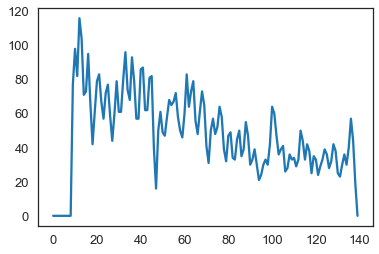

gnation


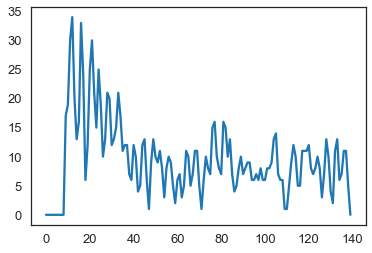

random


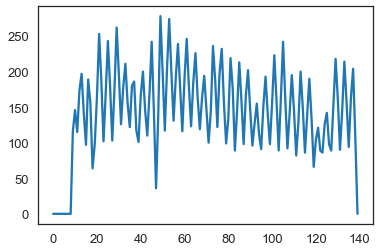

mythoughtsduringschool


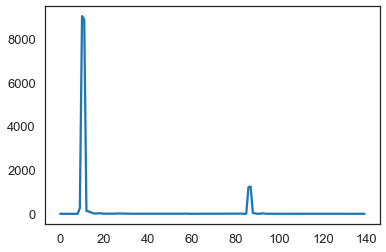

follow


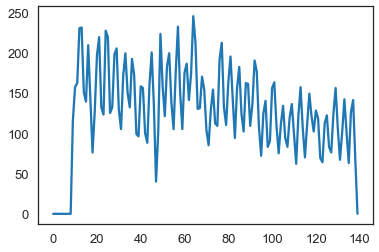

swag


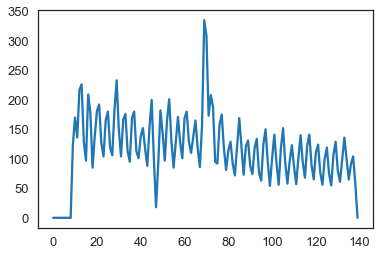

scorpio


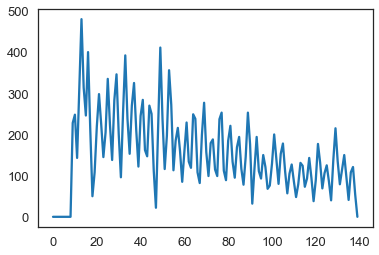

twitterpeopleilove


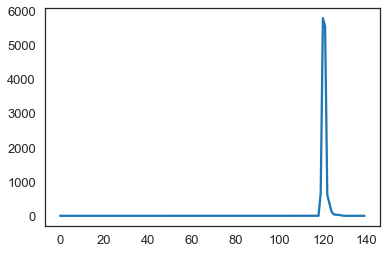

winning


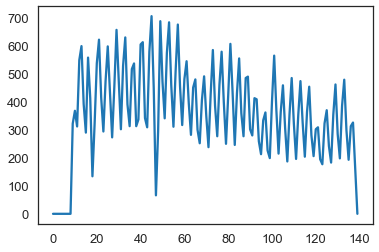

virgo


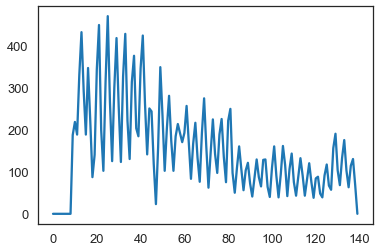

lt


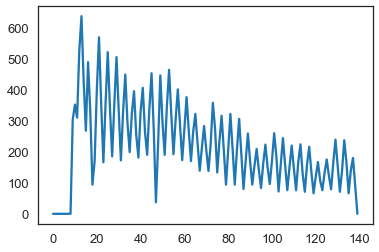

libra


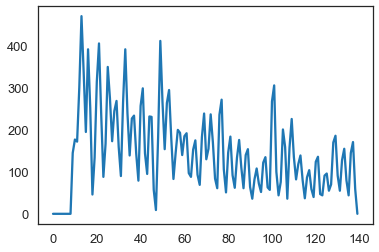

In [ ]:
#Plot Infection counts first
for i in (Data_rt):
        print(i)
        indx = list(Data_rt).index(i)
        plt.plot(df[0][indx])
        plt.show()

Lag plot is a simple pandas function plotting scatter plotd of the function you have >> counts between t+1 and t

500aday


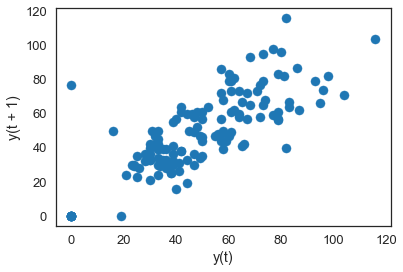

gnation


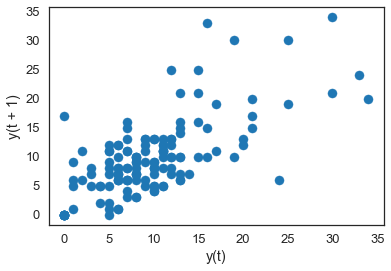

random


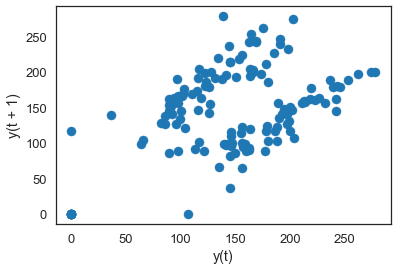

mythoughtsduringschool


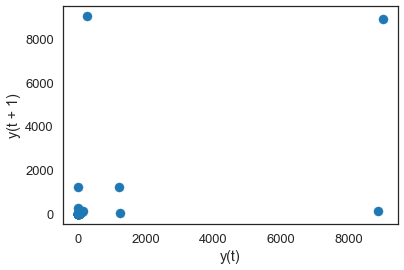

follow


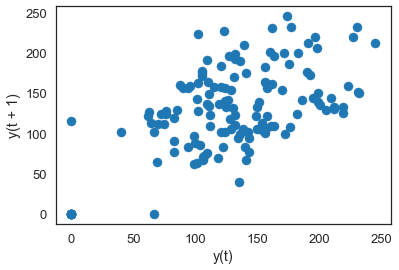

swag


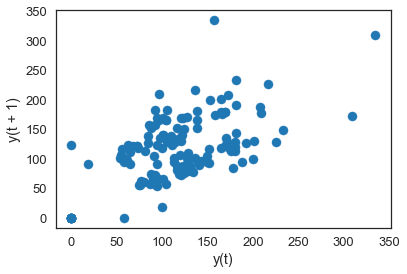

scorpio


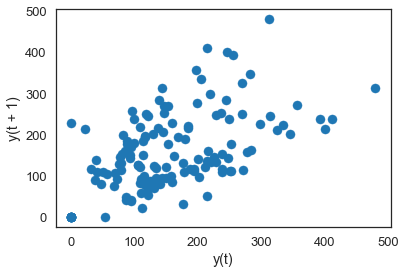

twitterpeopleilove


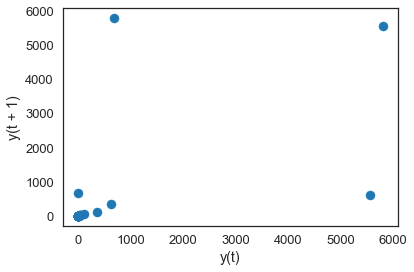

winning


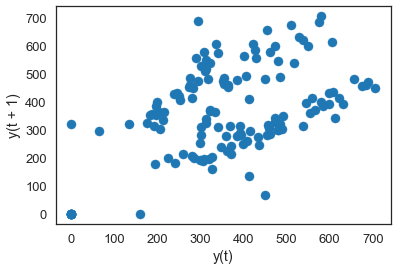

virgo


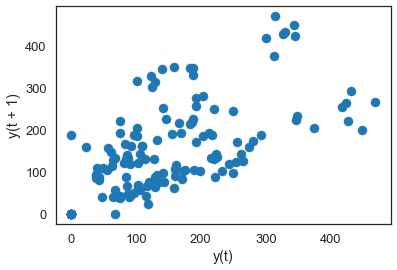

lt


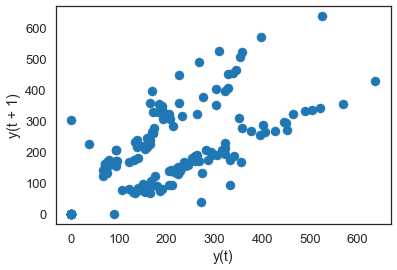

libra


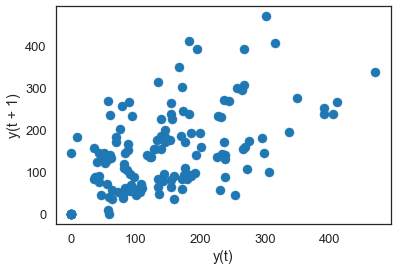

sorrynotsorry


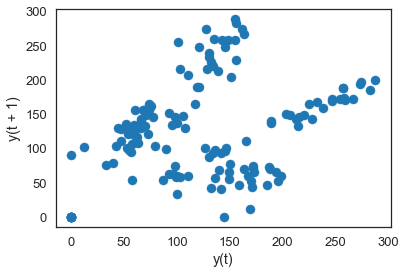

bahrain


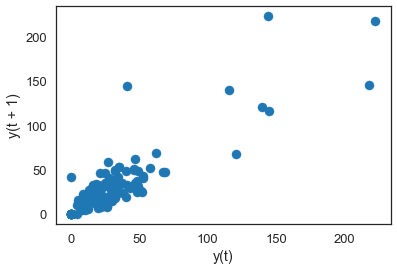

followback


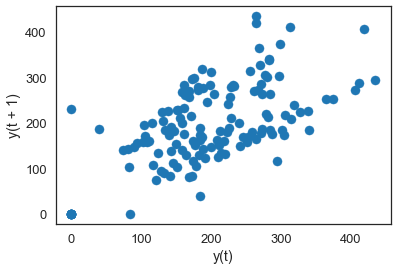

yougetpointsif


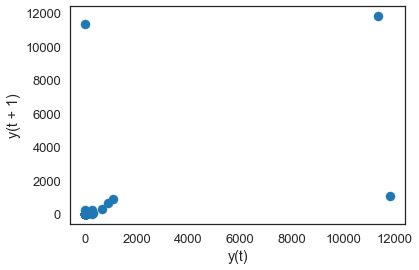

tbt


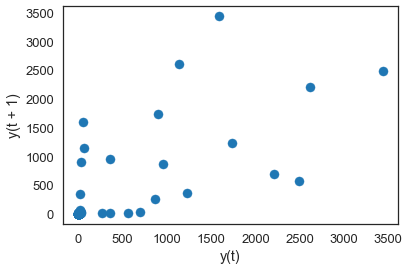

yougetmajorpointsif


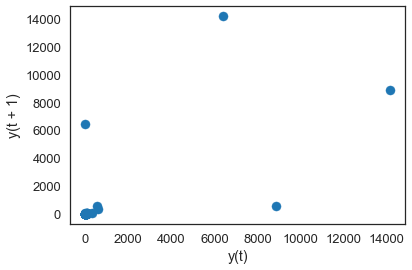

lrt


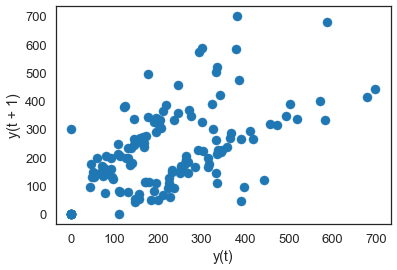

libras


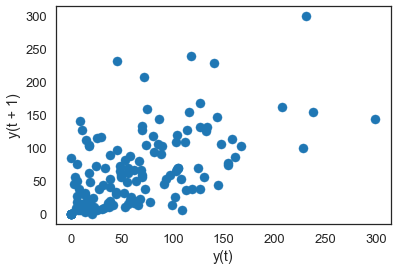

trayvonmartin


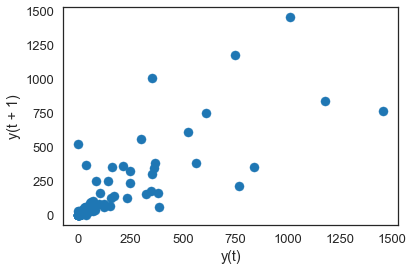

aquarians


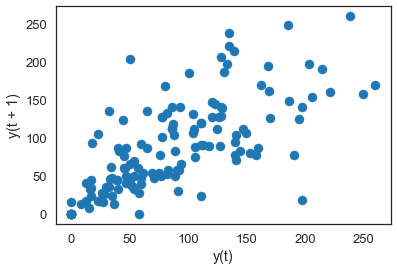

oomfs


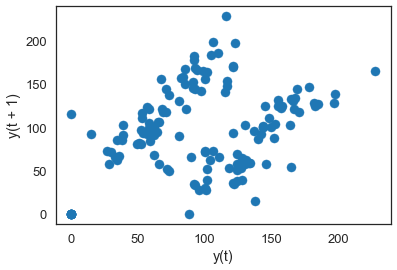

nfb


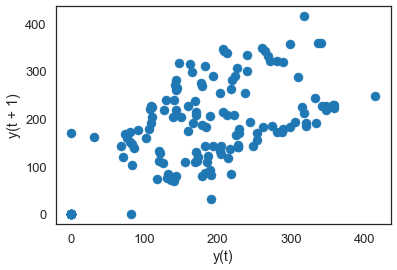

dailytweet


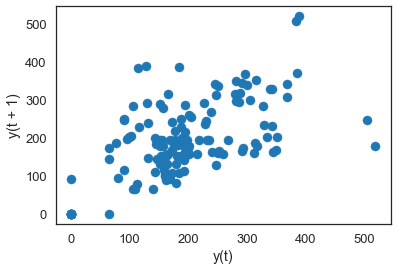

youknowwhatsannoying


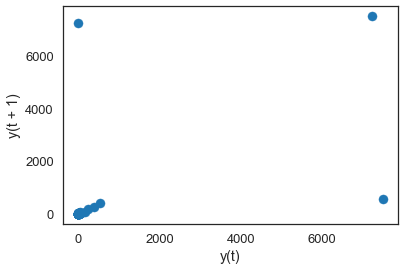

capricorn


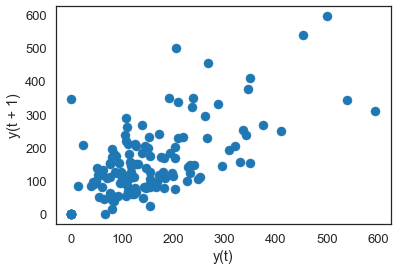

truth


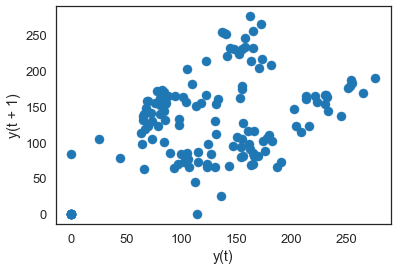

instagram


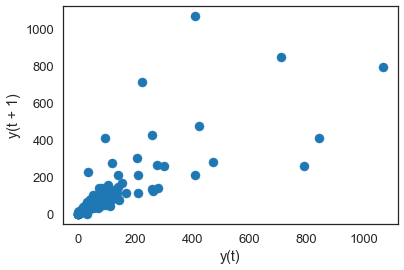

yolo


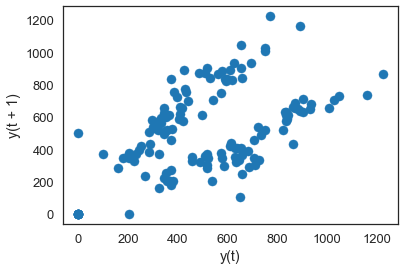

dead


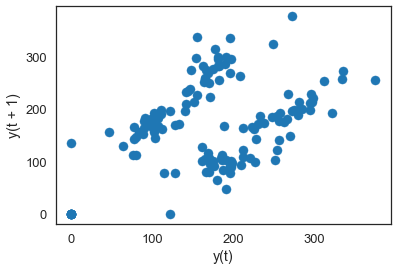

10thingsthatilike


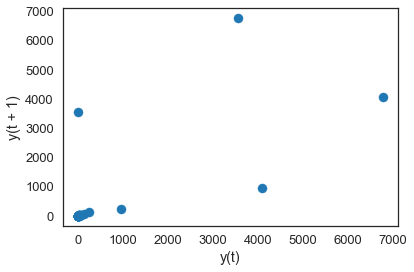

goodnight


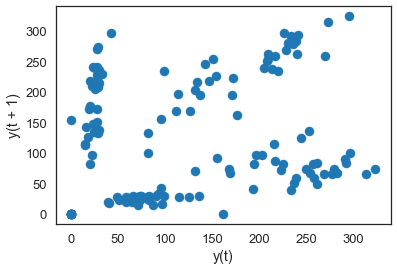

pisces


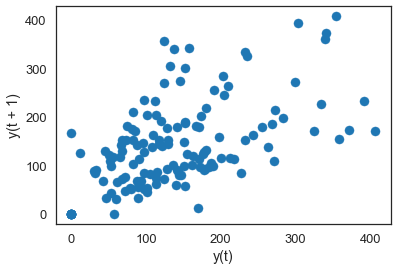

ifitwasuptome


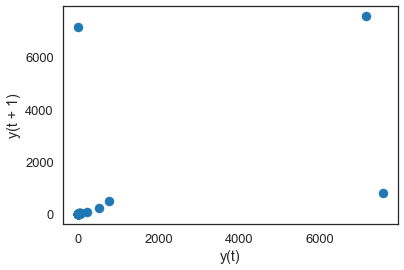

10thingsihate


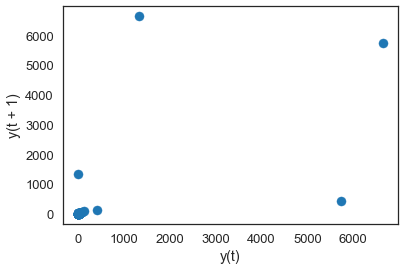

retweet


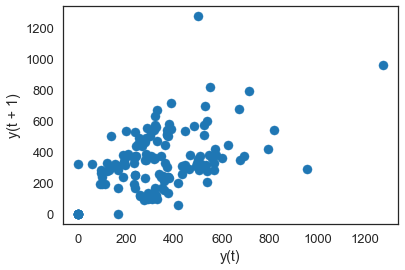

icantstandwhen


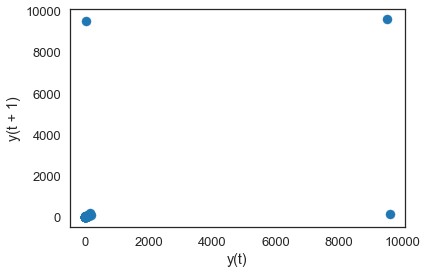

rt


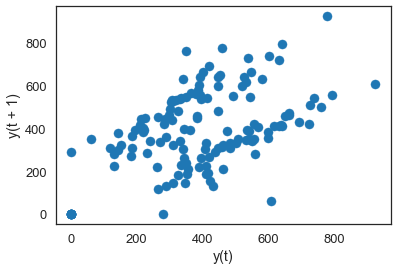

wheniwaslittle


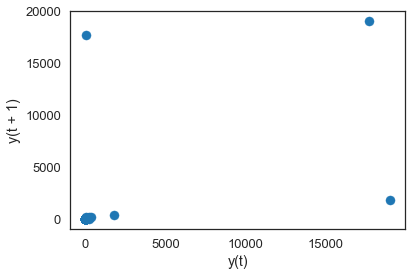

smh


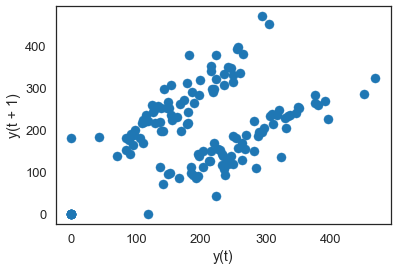

moviesthatnevergetold


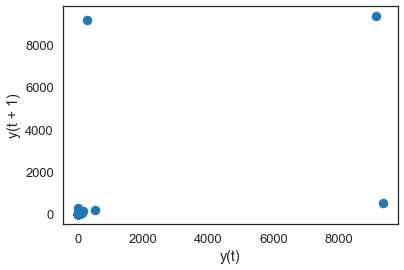

tweegram


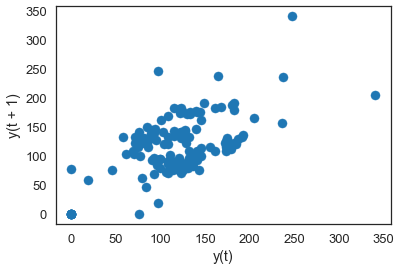

salute


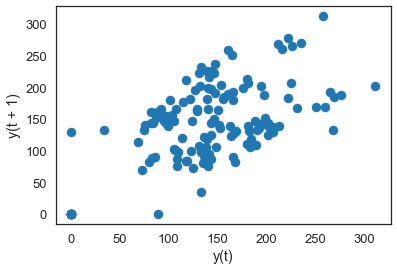

oomf


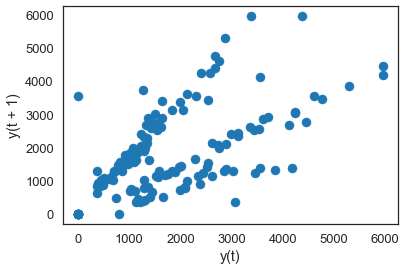

tcot


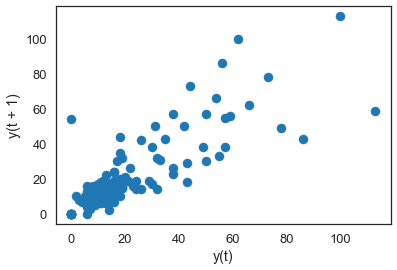

nationalbestfriendday


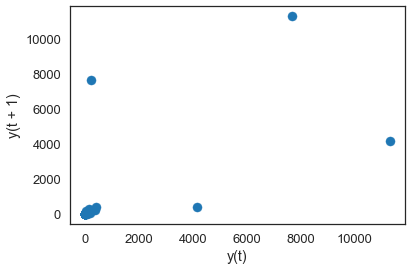

aquarius


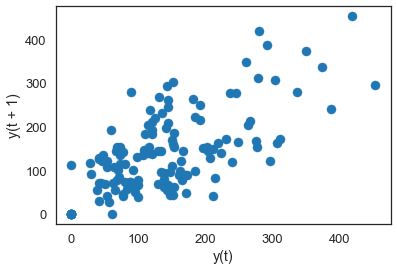

free


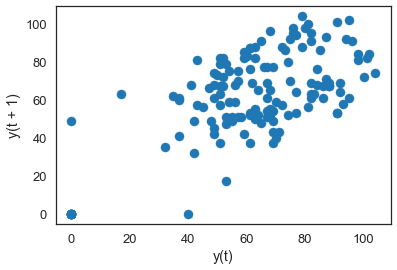

leo


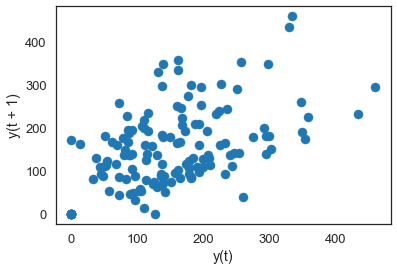

taurus


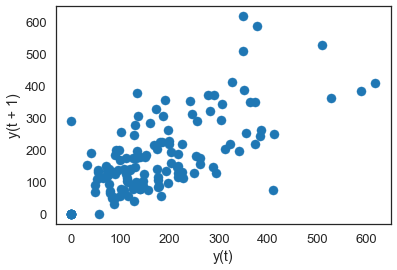

wtf


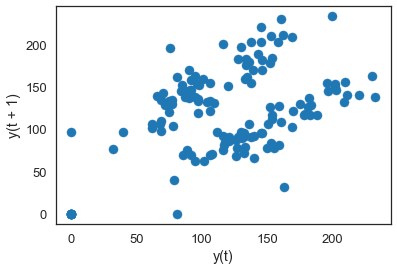

imagine


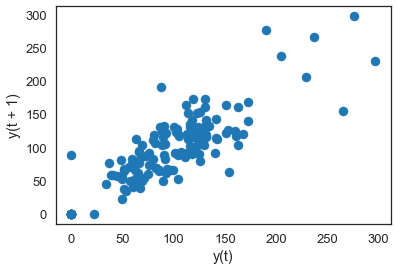

1dfact


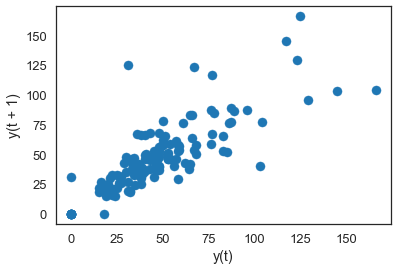

thingsigetalot


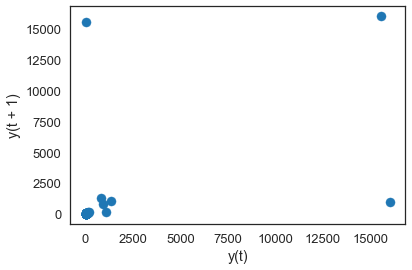

nowplaying


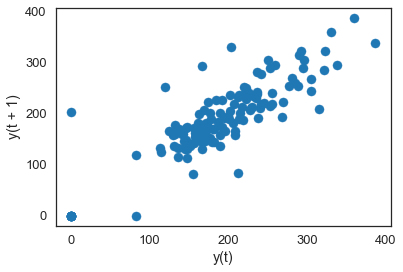

thingsisaywhilereadingmytl


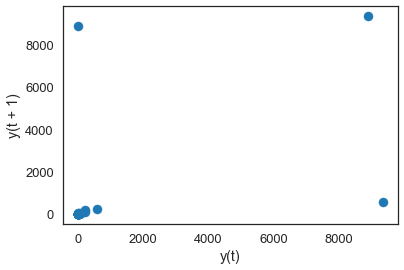

nowfollowing


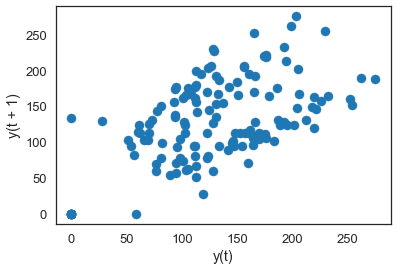

syria


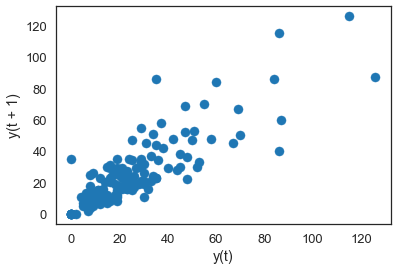

top100lies


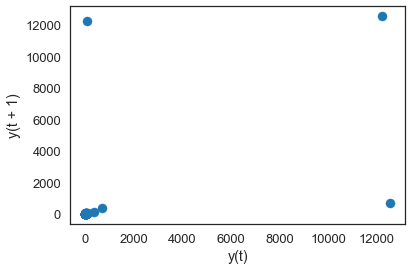

love


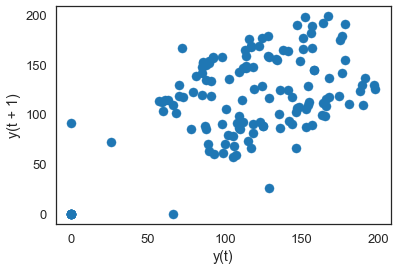

cancer


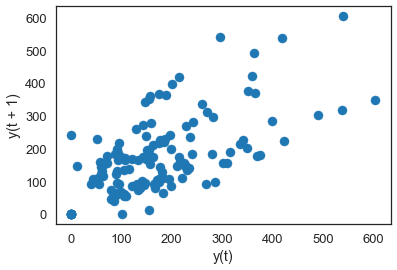

dearoomf


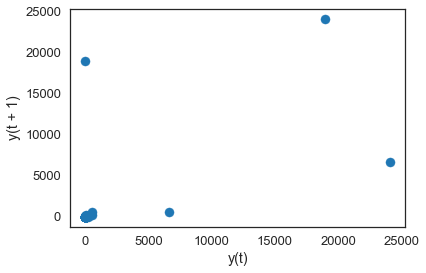

blessed


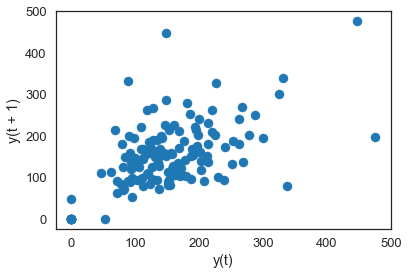

thoughtsduringschool


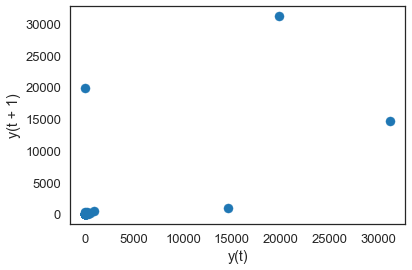

imhappywhen


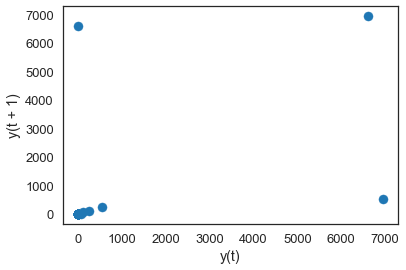

truthis


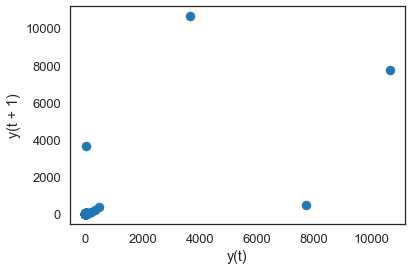

lol


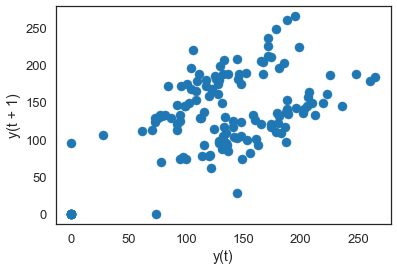

fml


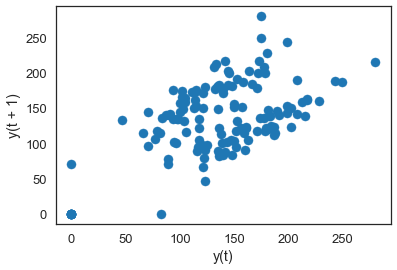

aries


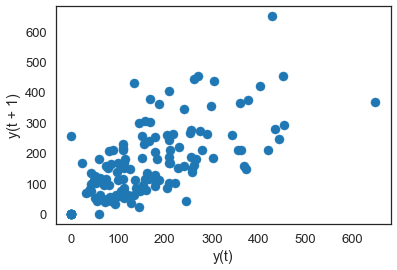

realshit


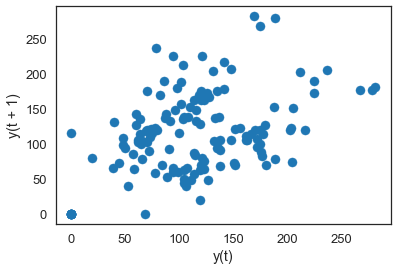

confessionhour


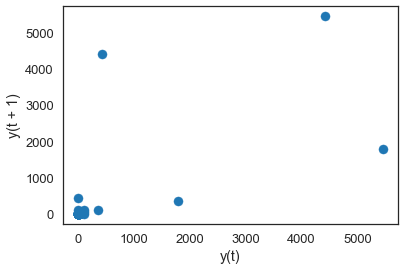

iadmit


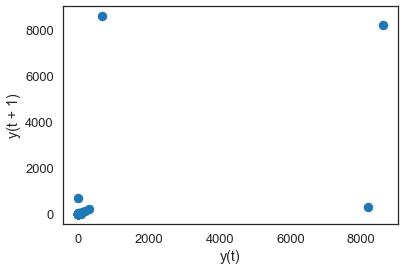

realtalk


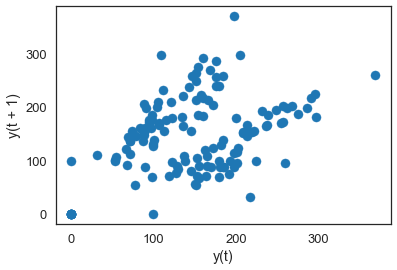

subtweet


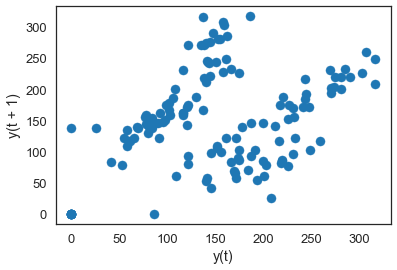

tfb


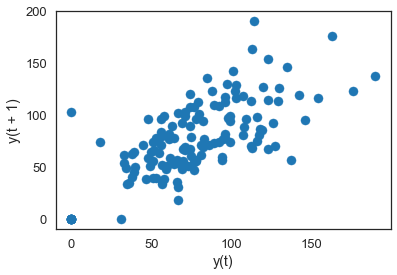

bgc


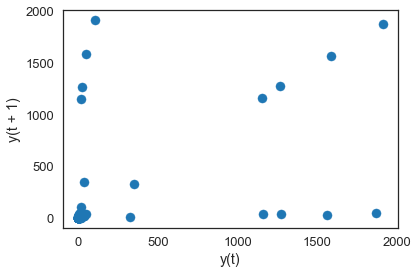

theworstfeeling


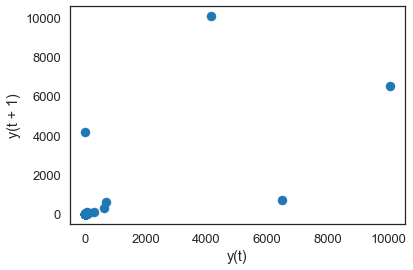

believe


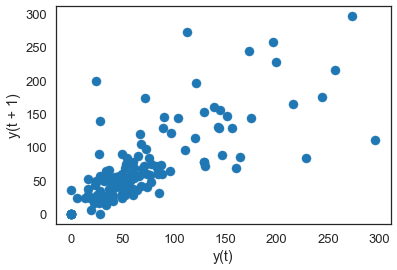

boyfriend


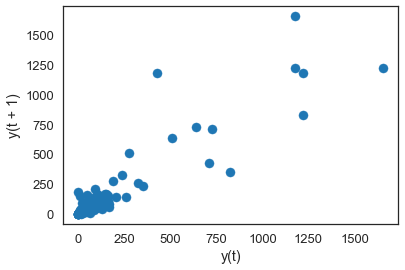

p2


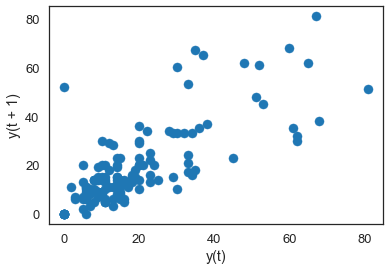

inourgeneration


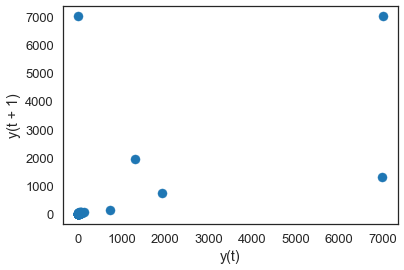

teamfollowback


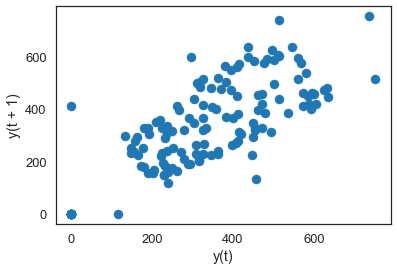

10thingsifindattractive


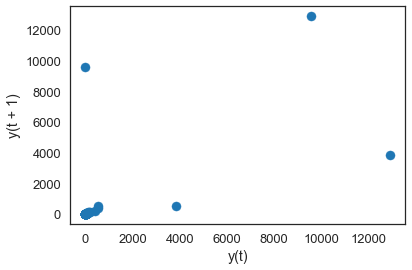

cancers


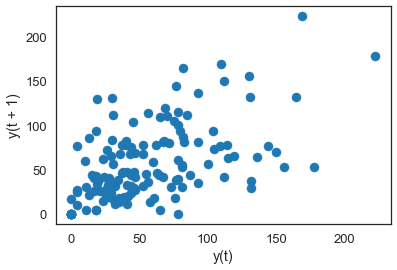

mybiggestproblem


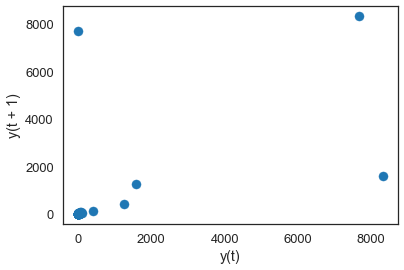

f1


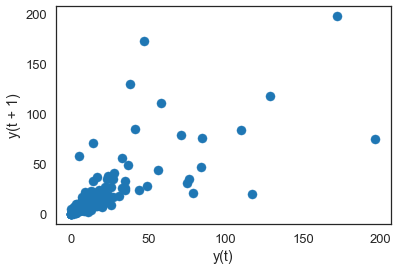

wewontworkoutif


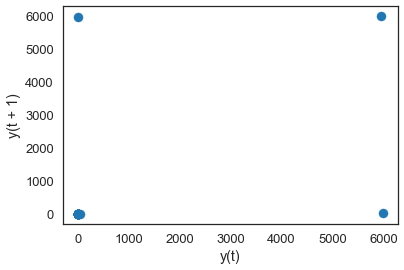

middleschoolmemories


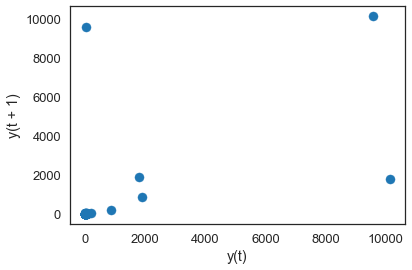

gemini


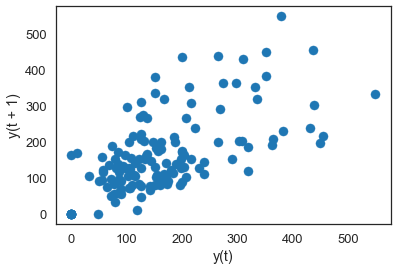

thatirritatesme


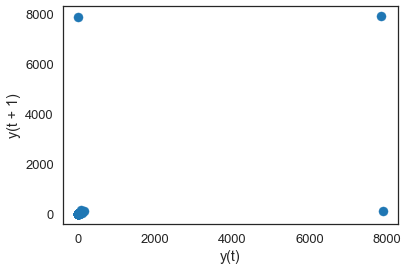

kca


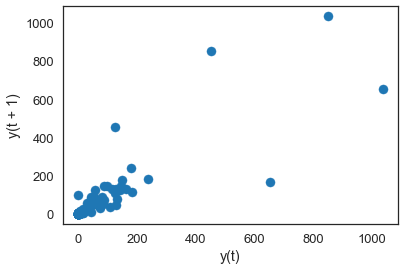

sagittarius


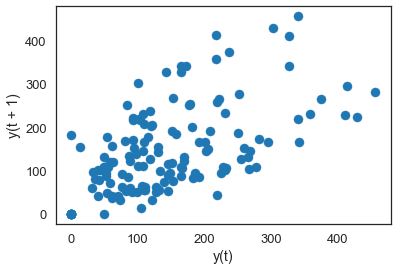

throwbackthursday


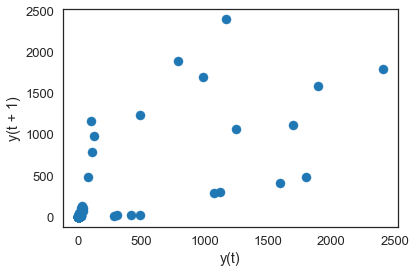

virgos


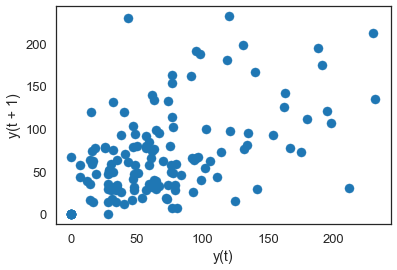

nf


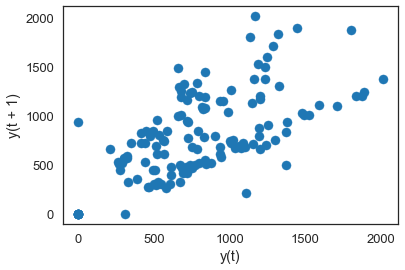

imsinglebecause


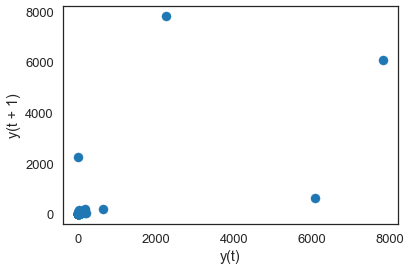

np


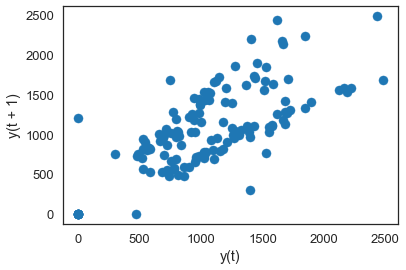

nw


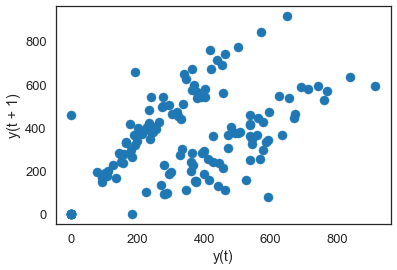

itscutewhen


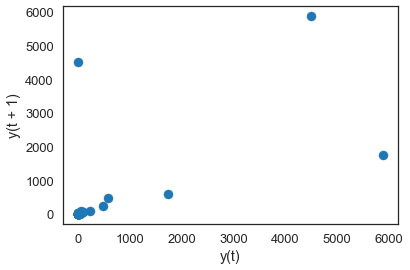

justsaying


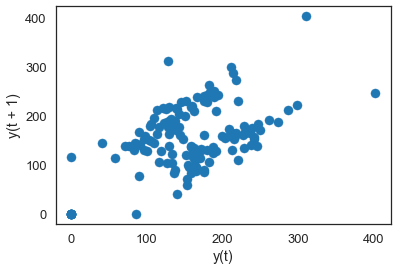

thingsmostpeoplelikebutidont


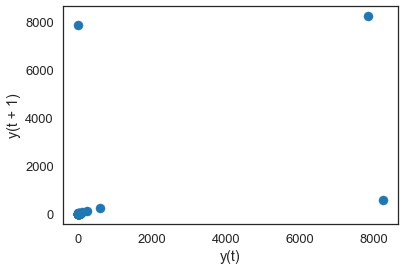

teamiphone


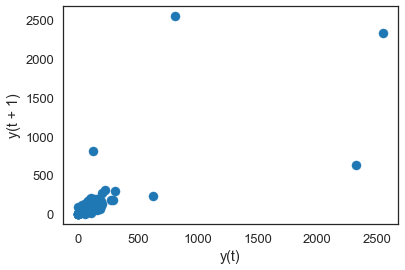

20thingsilove


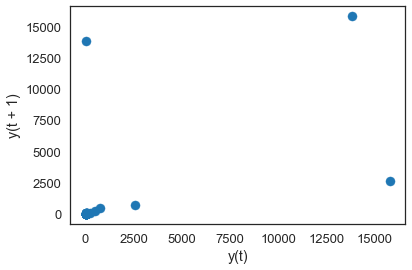

fb


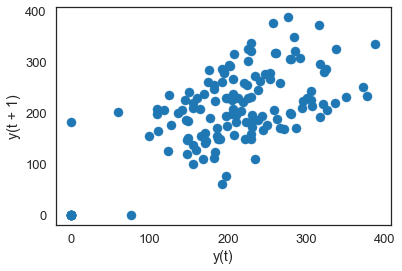

10factsaboutme


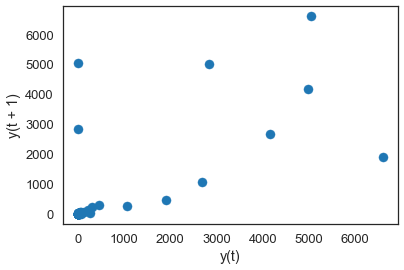

ff


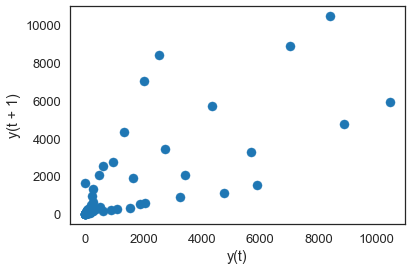

shoutout


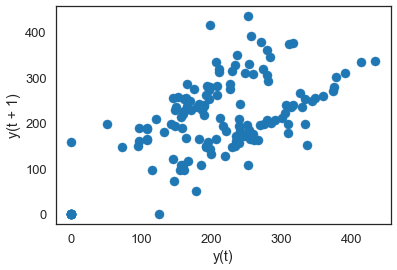

fact


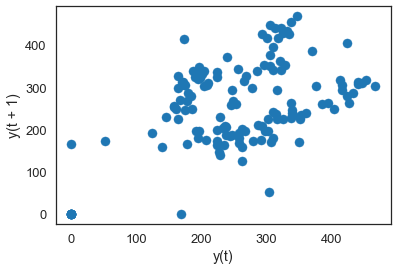

In [24]:
#plot  lag plot of infection counts as we know that infection counts are the counts in each
#time window in the time series
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    lag_plot(series)
    pyplot.show()

Auto correlation plots show which lag variables may be good candidates for use in a predictive model and how the relationship between the observation and its historic values changes over time

Autocorrelation plots check randomness in data and as it goes near to zero it shows the randomness in data

500aday


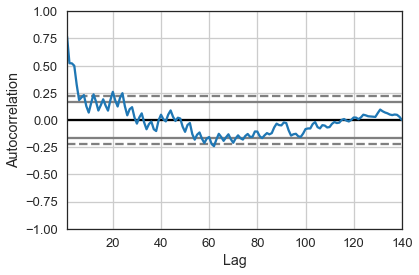

gnation


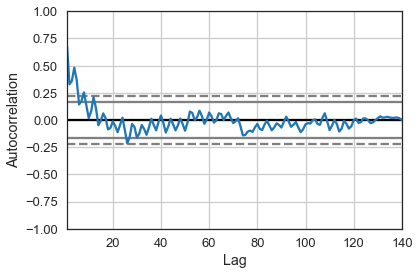

random


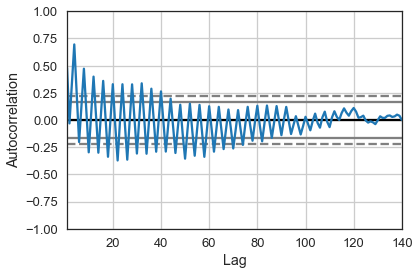

mythoughtsduringschool


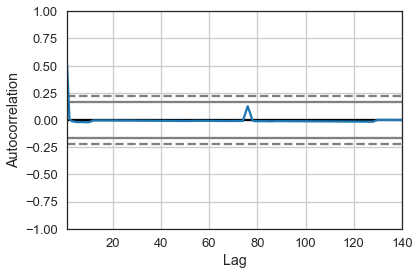

follow


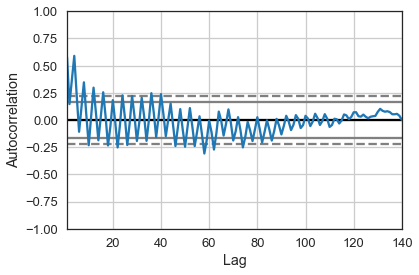

swag


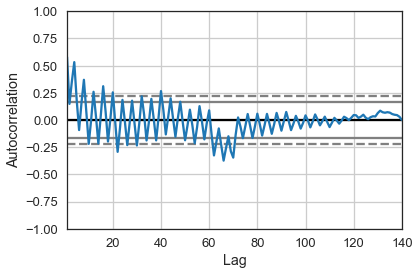

scorpio


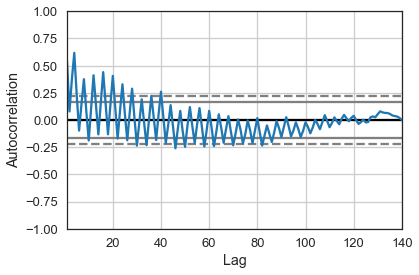

twitterpeopleilove


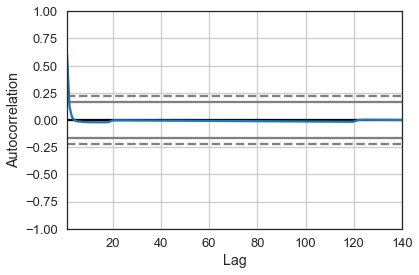

winning


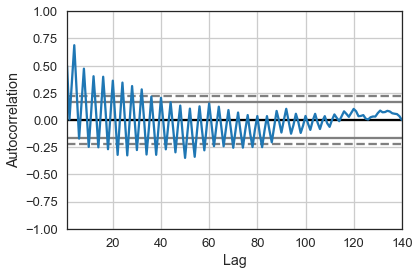

virgo


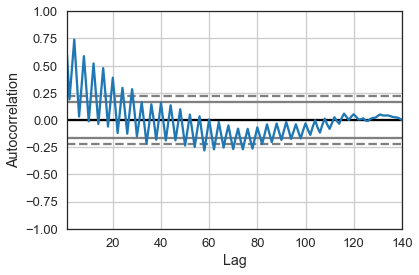

lt


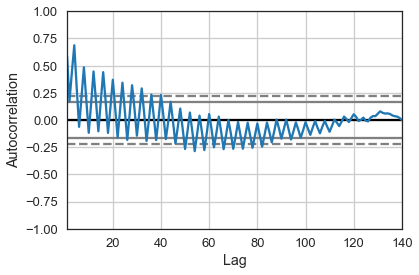

libra


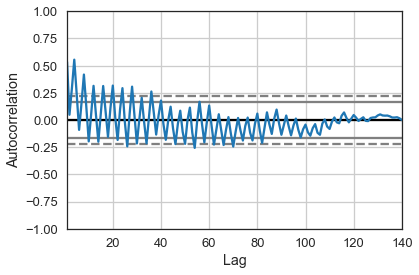

sorrynotsorry


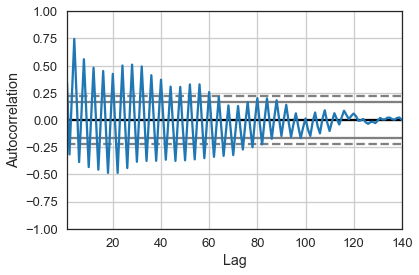

bahrain


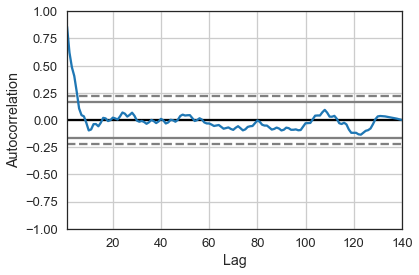

followback


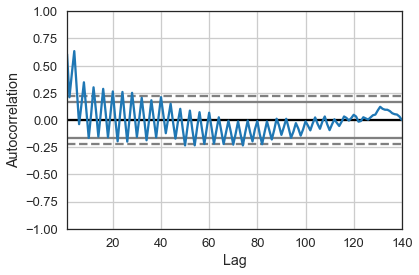

yougetpointsif


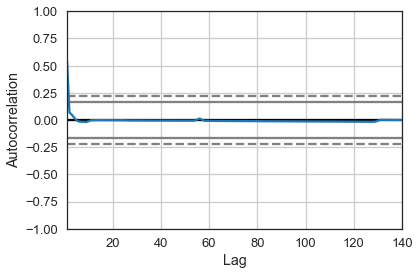

tbt


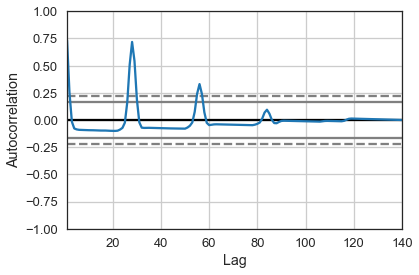

yougetmajorpointsif


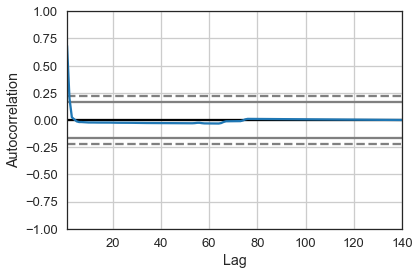

lrt


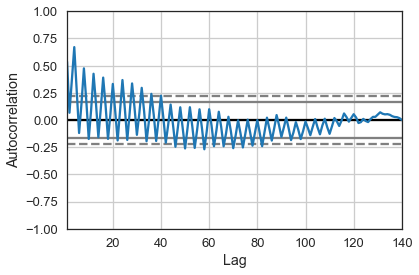

libras


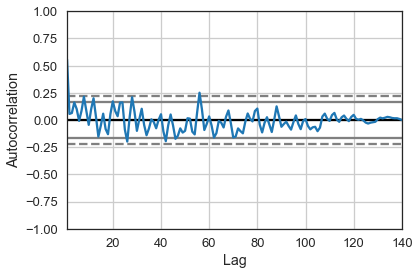

trayvonmartin


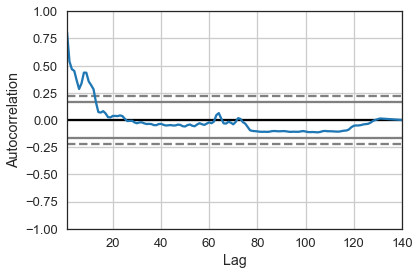

aquarians


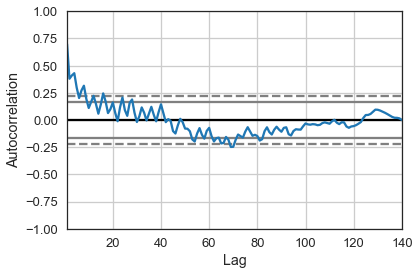

oomfs


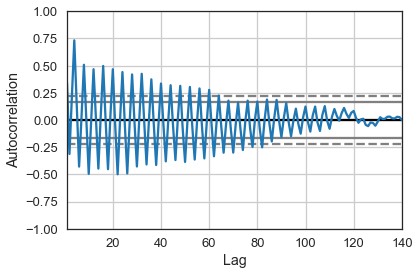

nfb


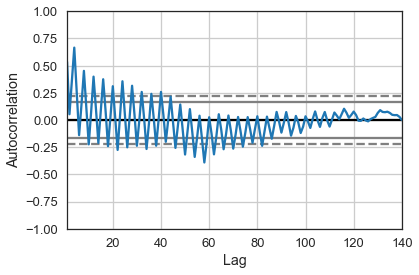

dailytweet


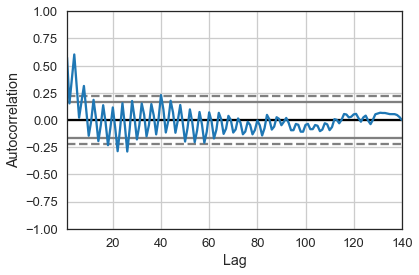

youknowwhatsannoying


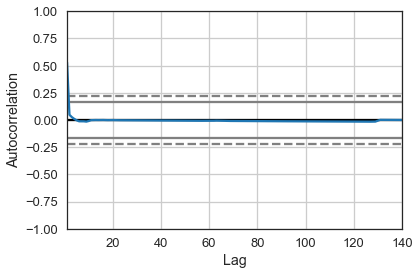

capricorn


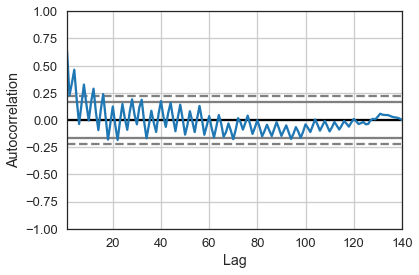

truth


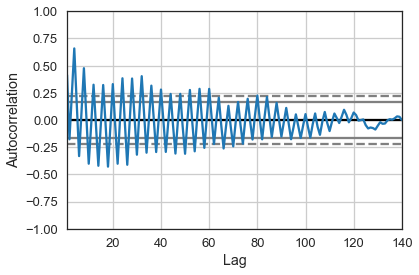

instagram


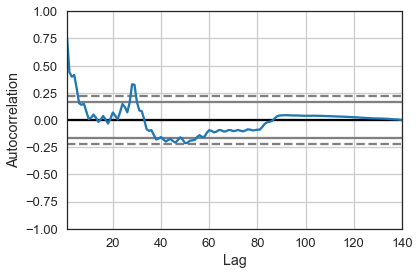

yolo


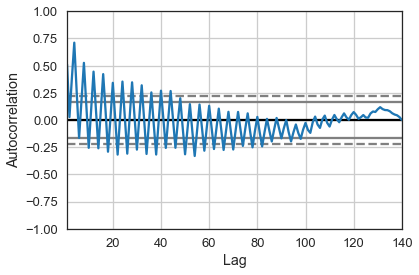

dead


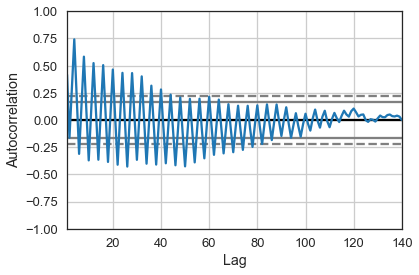

10thingsthatilike


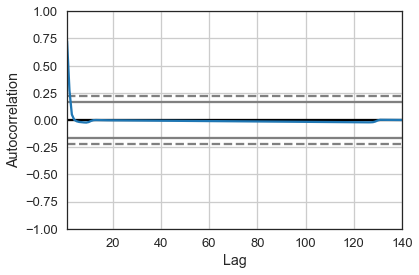

goodnight


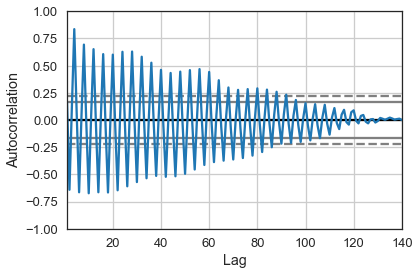

pisces


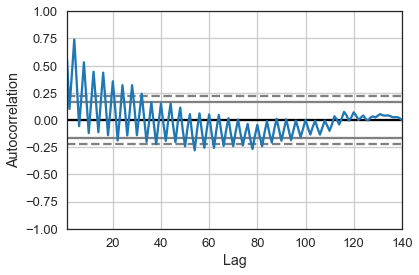

ifitwasuptome


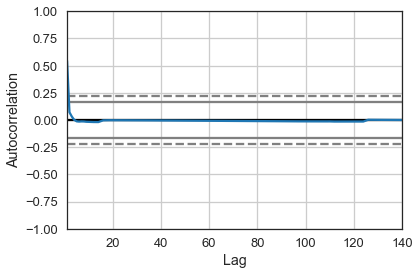

10thingsihate


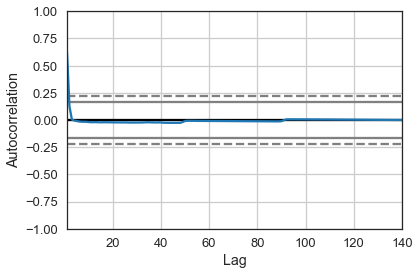

retweet


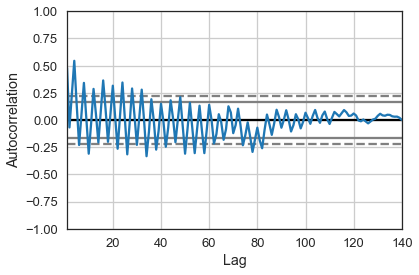

icantstandwhen


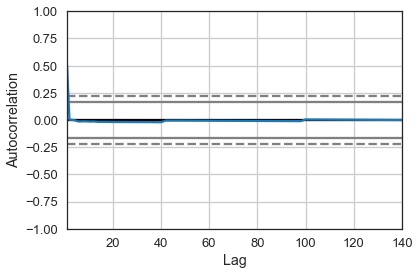

rt


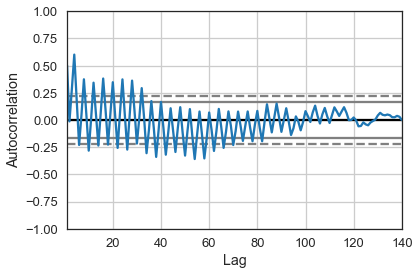

wheniwaslittle


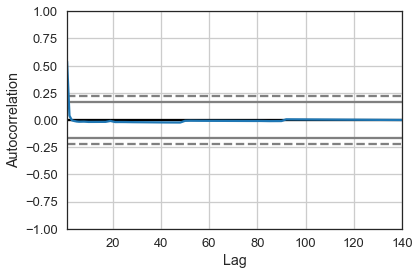

smh


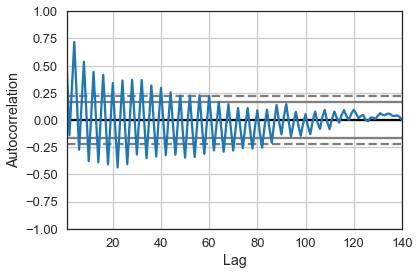

moviesthatnevergetold


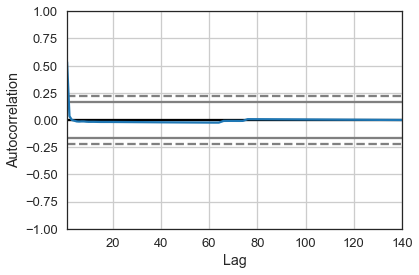

tweegram


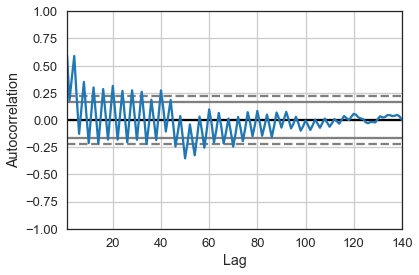

salute


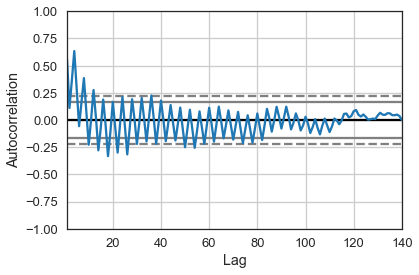

oomf


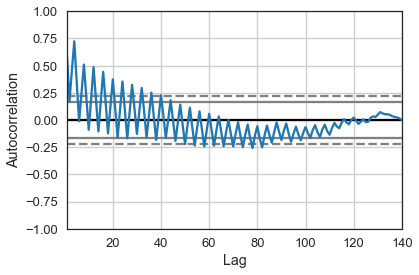

tcot


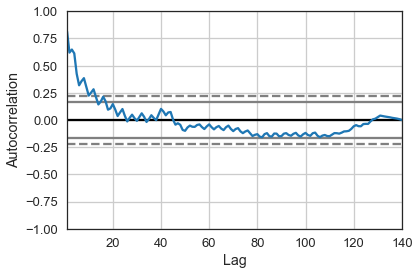

nationalbestfriendday


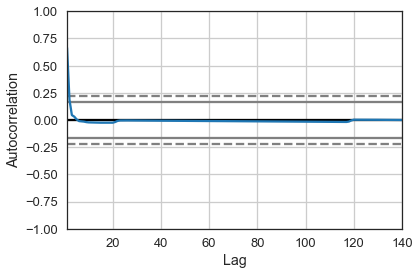

aquarius


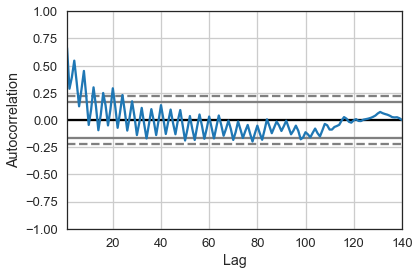

free


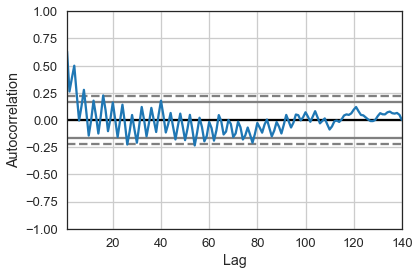

leo


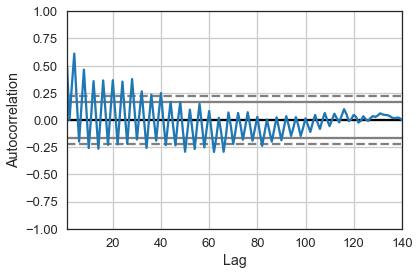

taurus


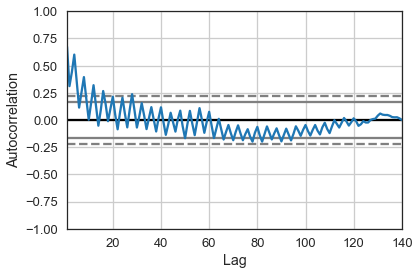

wtf


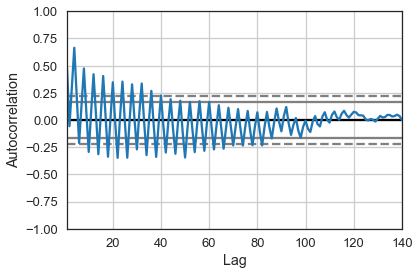

imagine


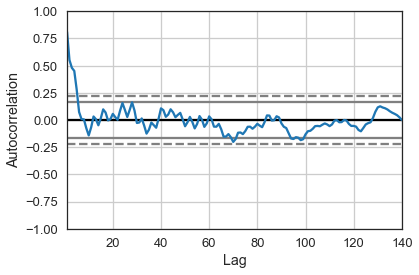

1dfact


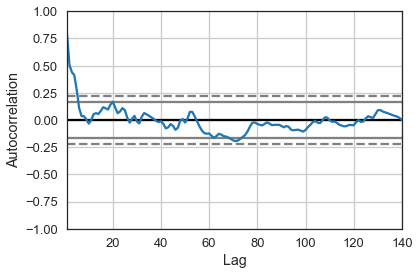

thingsigetalot


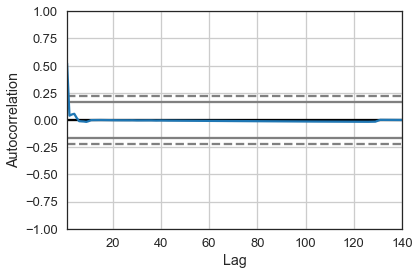

nowplaying


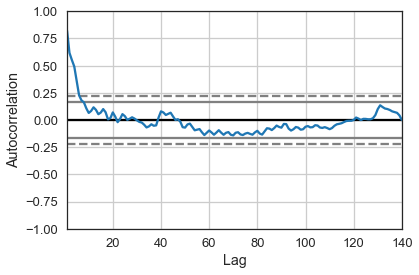

thingsisaywhilereadingmytl


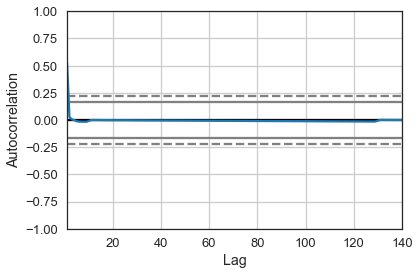

nowfollowing


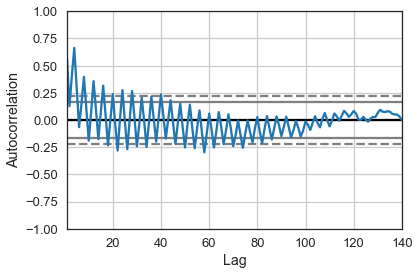

syria


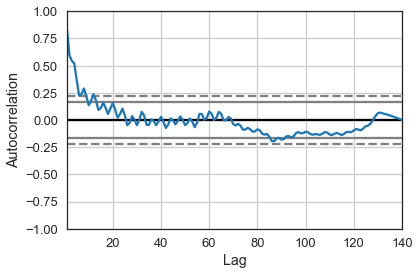

top100lies


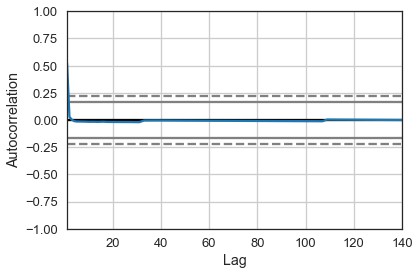

love


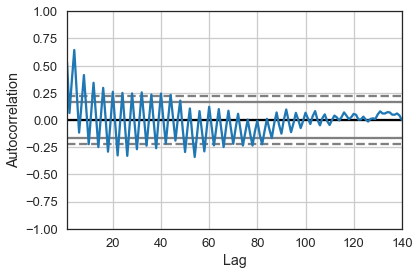

cancer


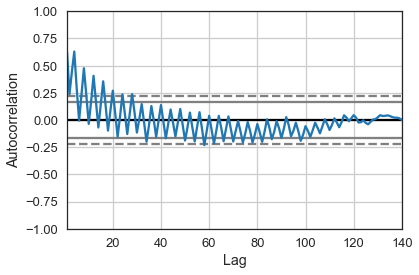

dearoomf


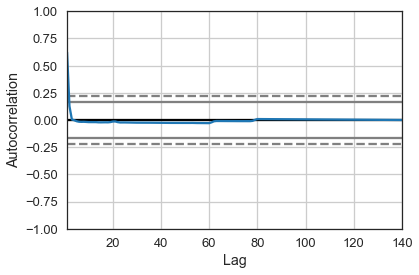

blessed


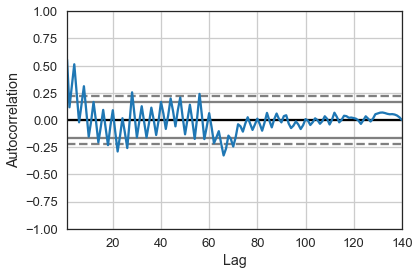

thoughtsduringschool


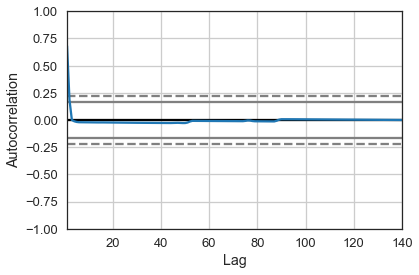

imhappywhen


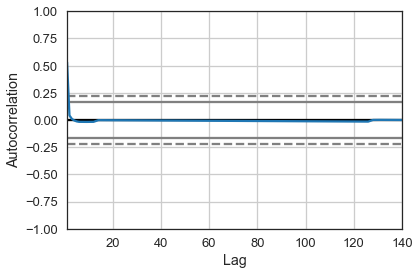

truthis


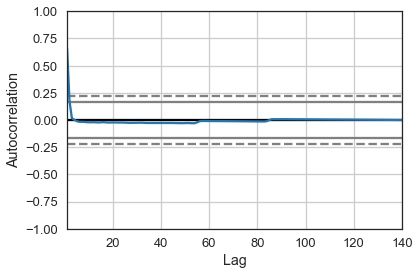

lol


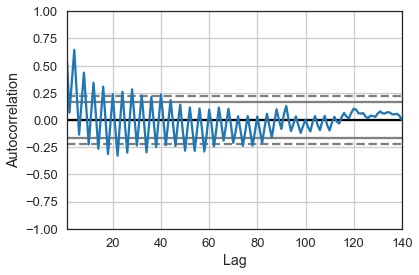

fml


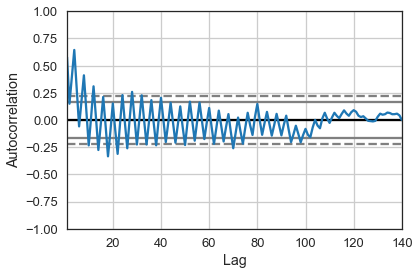

aries


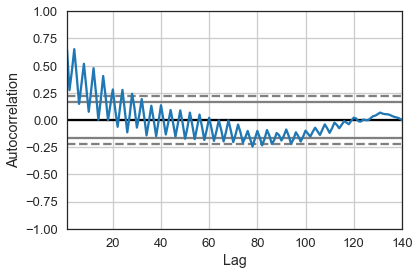

realshit


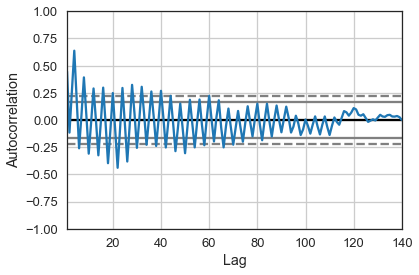

confessionhour


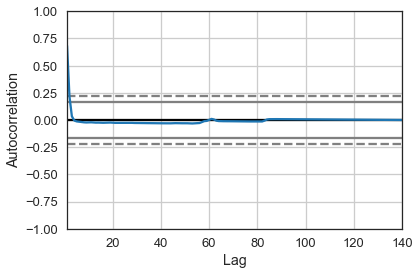

iadmit


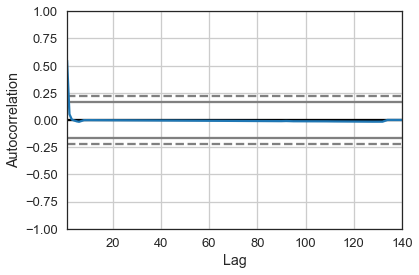

realtalk


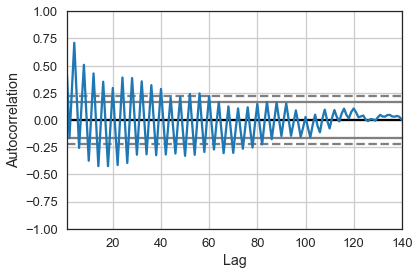

subtweet


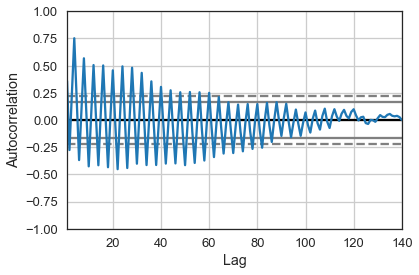

tfb


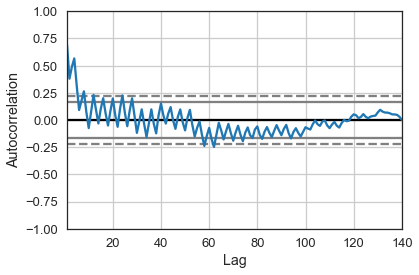

bgc


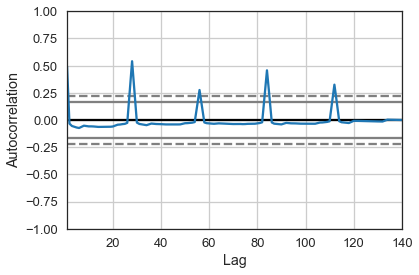

theworstfeeling


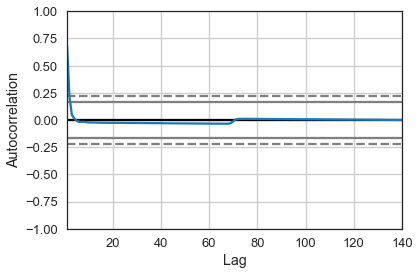

believe


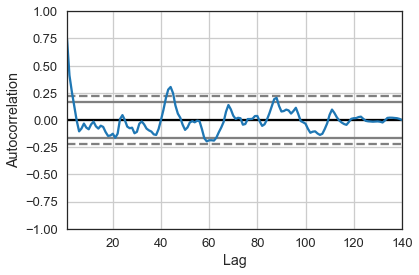

boyfriend


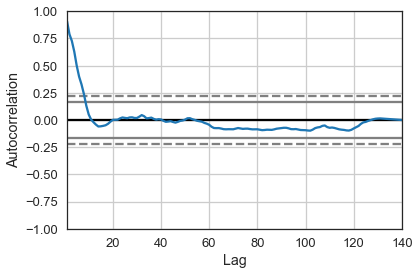

p2


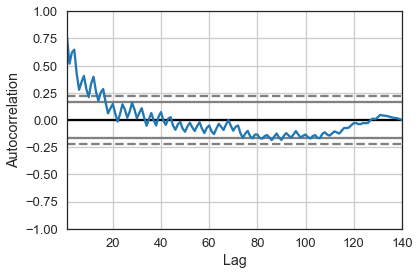

inourgeneration


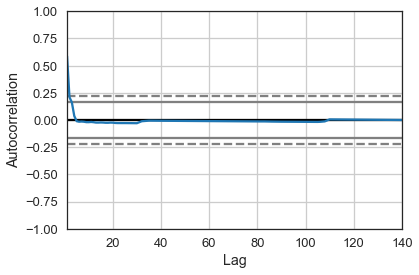

teamfollowback


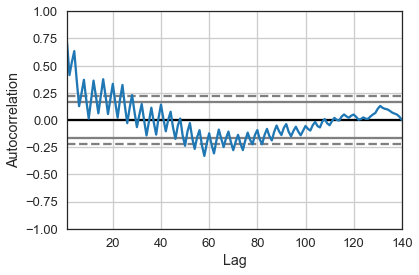

10thingsifindattractive


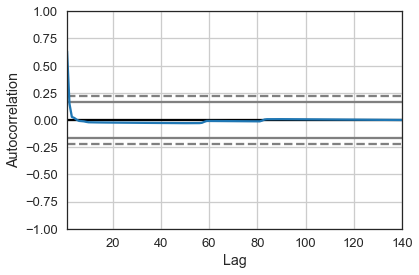

cancers


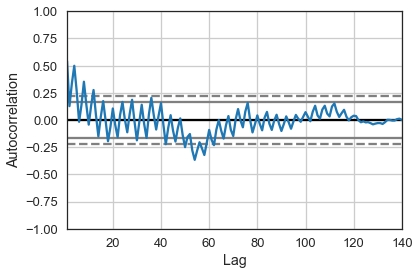

mybiggestproblem


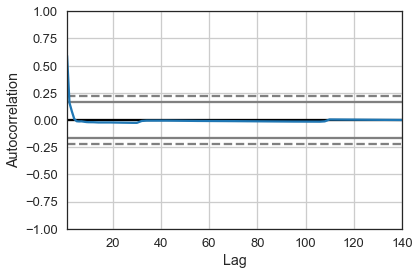

f1


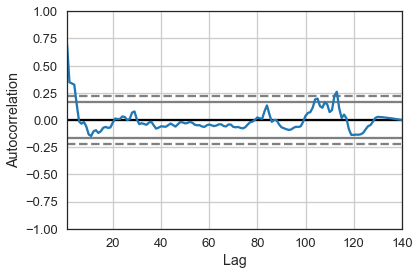

wewontworkoutif


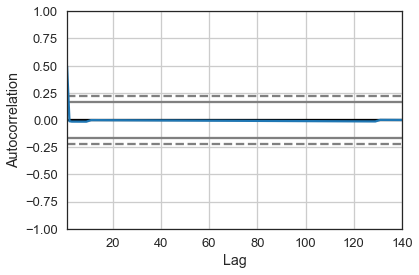

middleschoolmemories


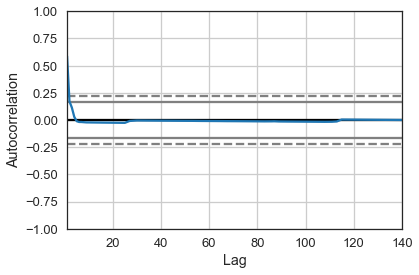

gemini


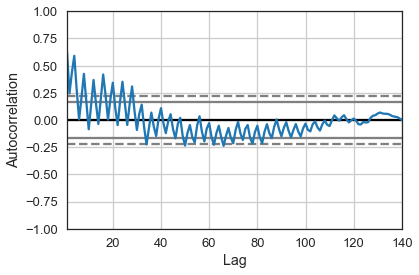

thatirritatesme


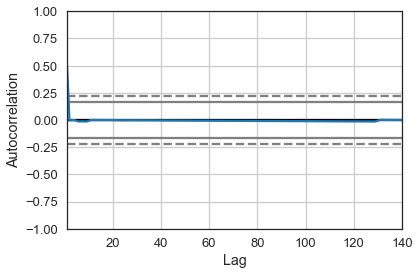

kca


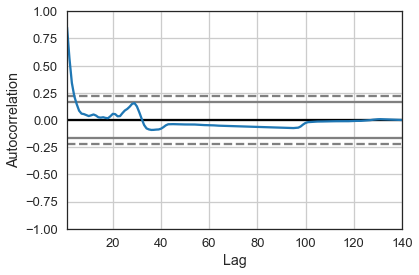

sagittarius


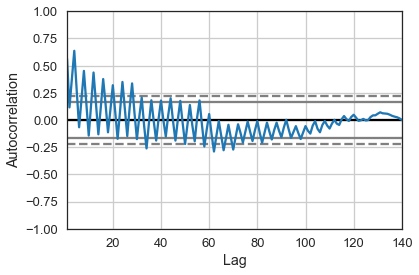

throwbackthursday


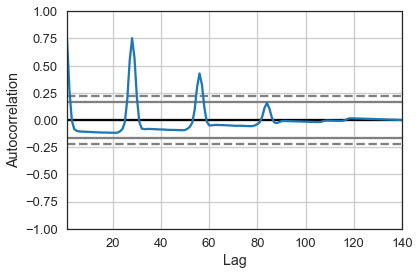

virgos


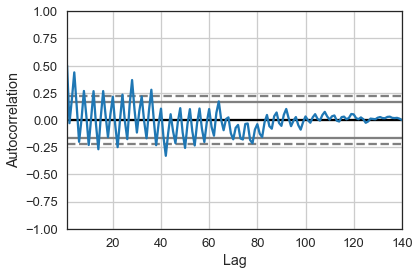

nf


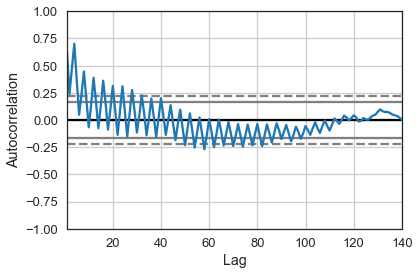

imsinglebecause


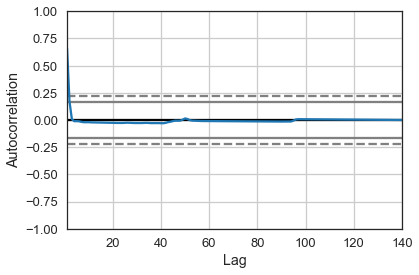

np


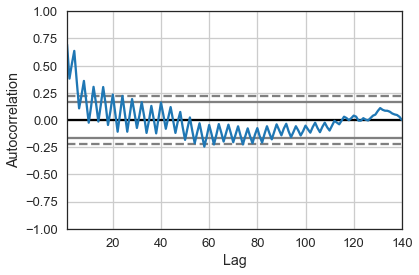

nw


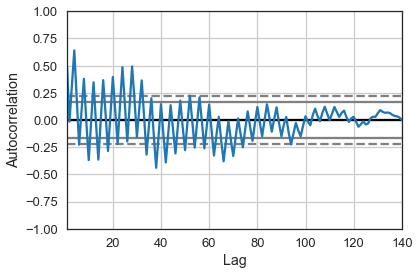

itscutewhen


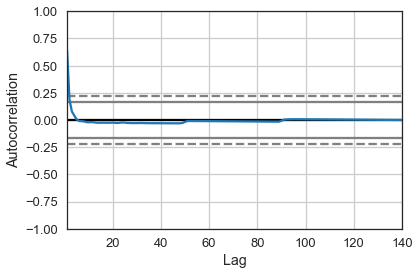

justsaying


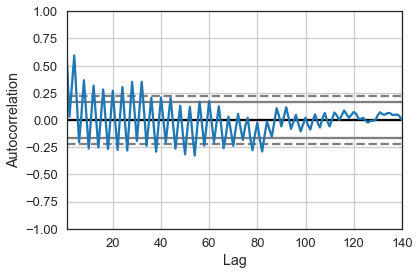

thingsmostpeoplelikebutidont


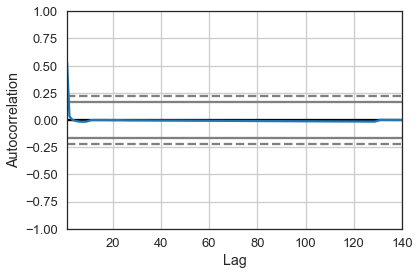

teamiphone


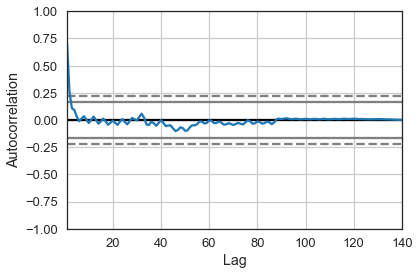

20thingsilove


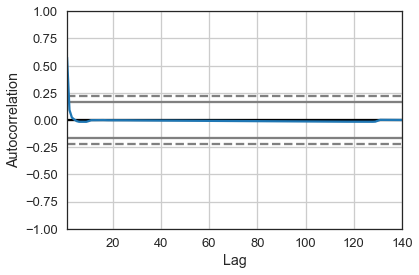

fb


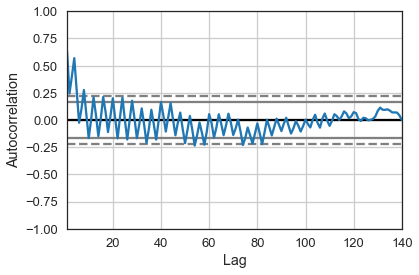

10factsaboutme


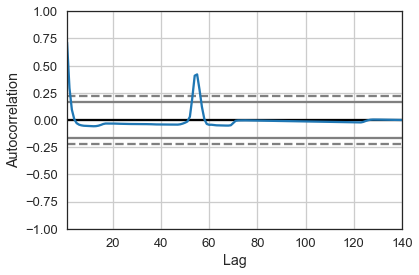

ff


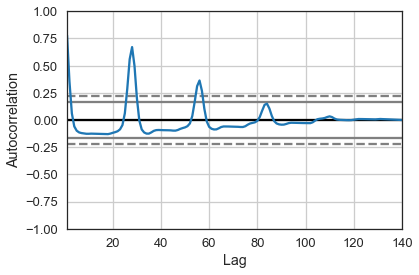

shoutout


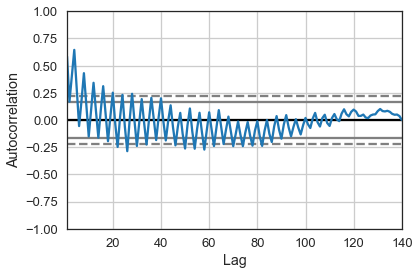

fact


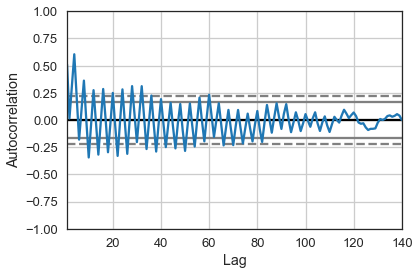

In [15]:
from pandas.tools.plotting import autocorrelation_plot
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    autocorrelation_plot(series)
    pyplot.show()

ACF PLOT

500aday


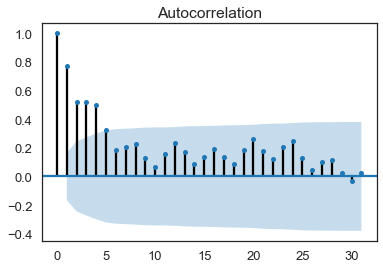

gnation


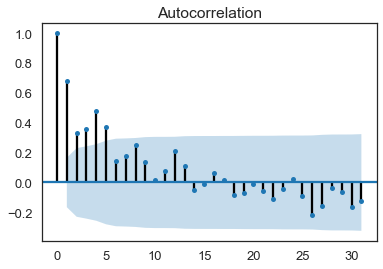

random


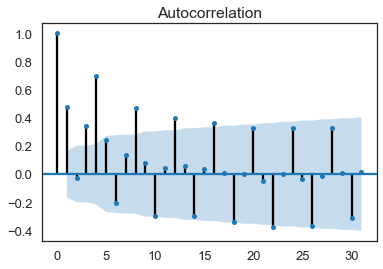

mythoughtsduringschool


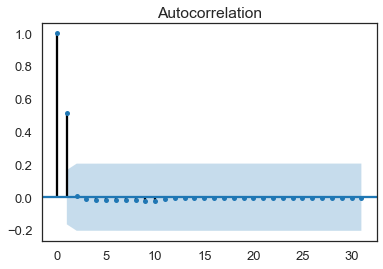

follow


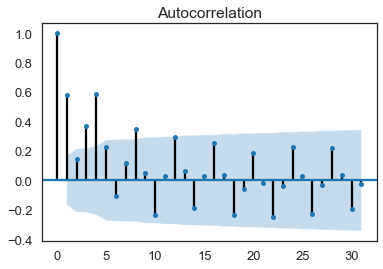

swag


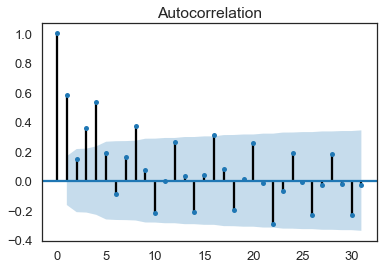

scorpio


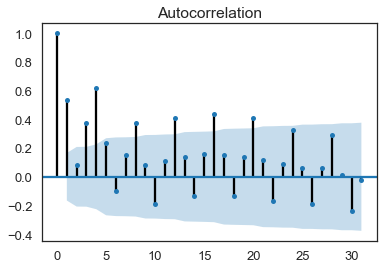

twitterpeopleilove


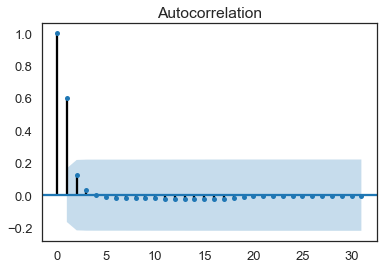

winning


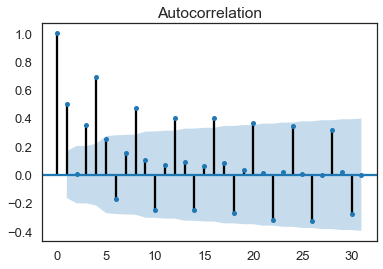

virgo


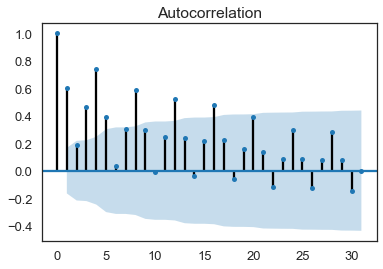

lt


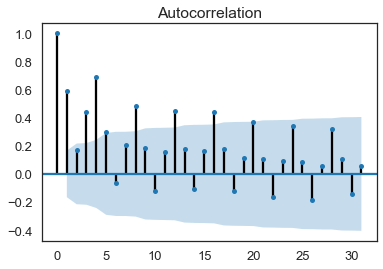

libra


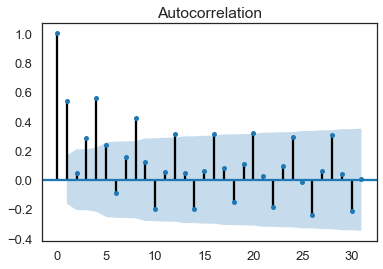

sorrynotsorry


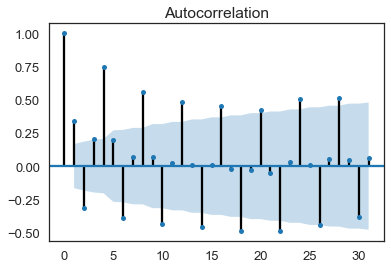

bahrain


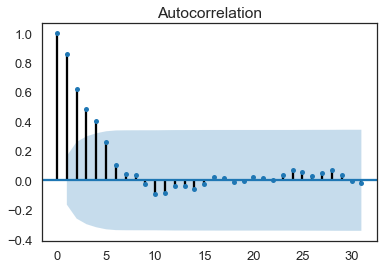

followback


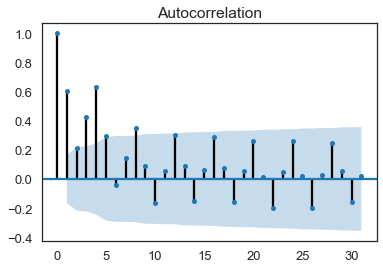

yougetpointsif


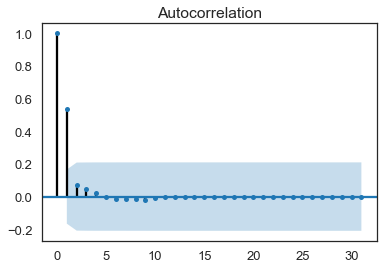

tbt


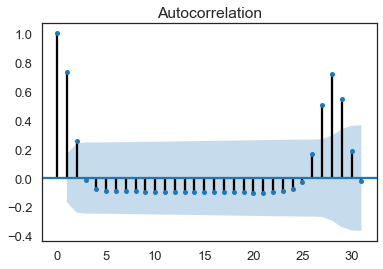

yougetmajorpointsif


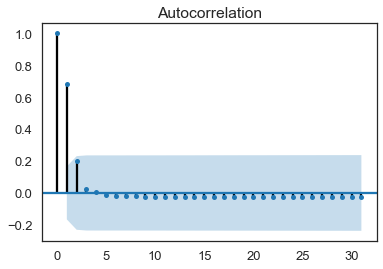

lrt


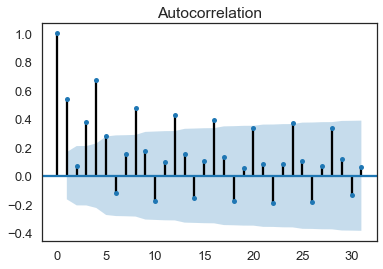

libras


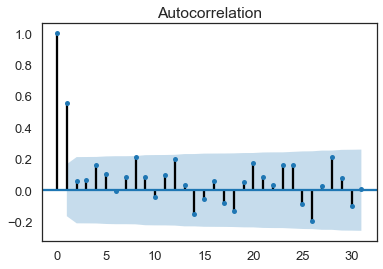

trayvonmartin


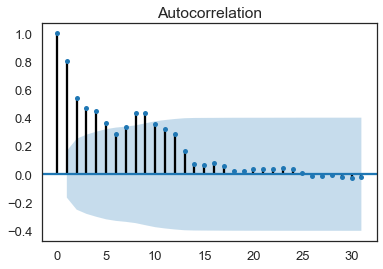

aquarians


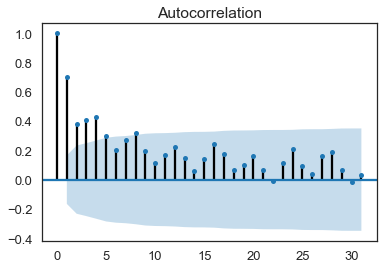

oomfs


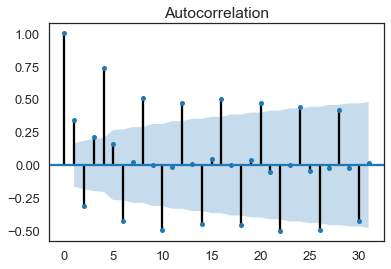

nfb


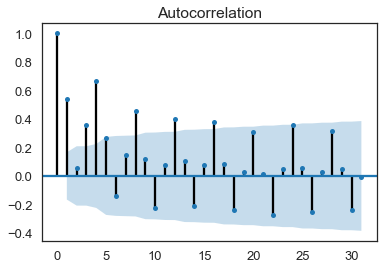

dailytweet


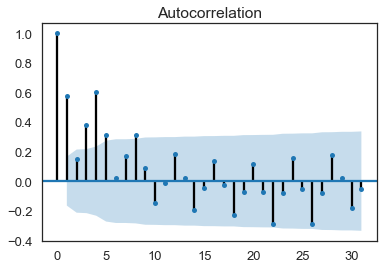

youknowwhatsannoying


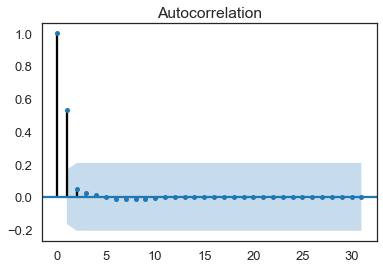

capricorn


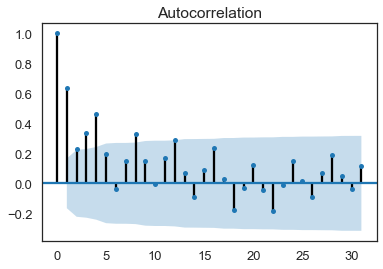

truth


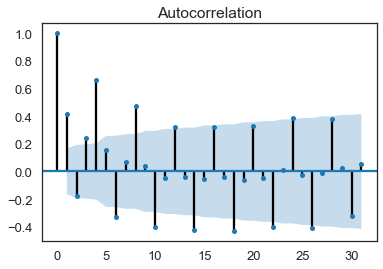

instagram


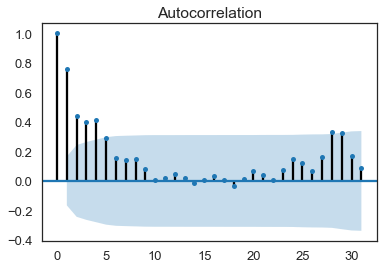

yolo


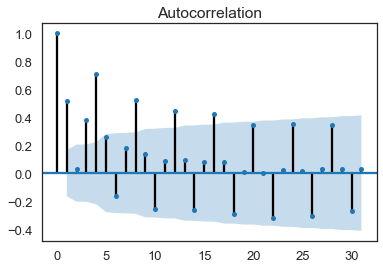

dead


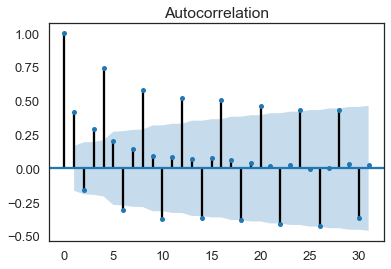

10thingsthatilike


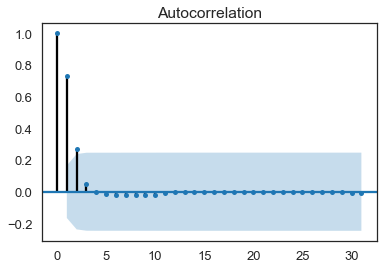

goodnight


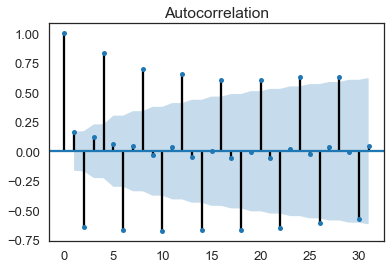

pisces


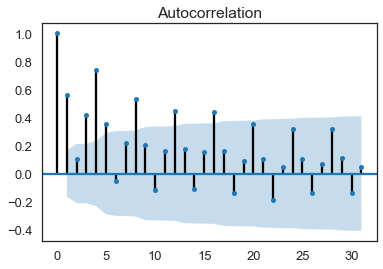

ifitwasuptome


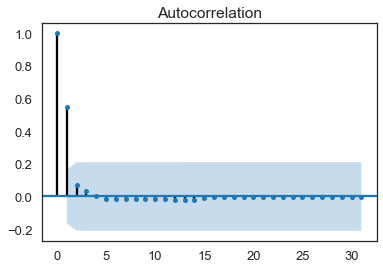

10thingsihate


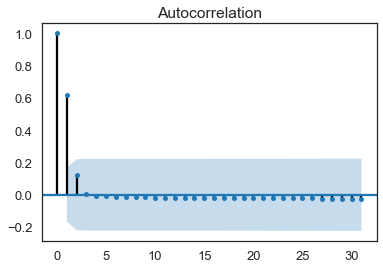

retweet


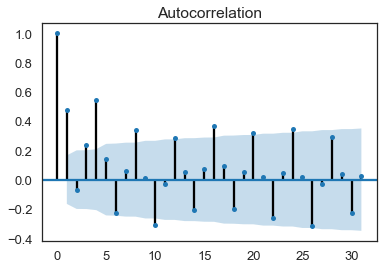

icantstandwhen


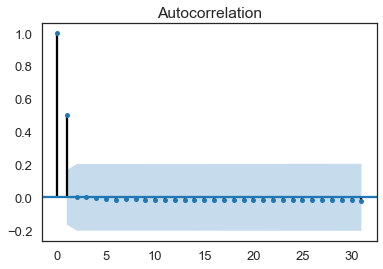

rt


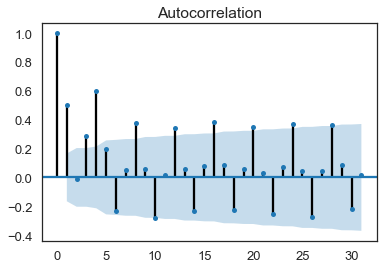

wheniwaslittle


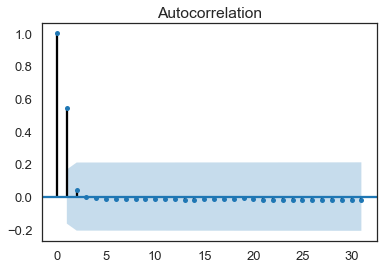

smh


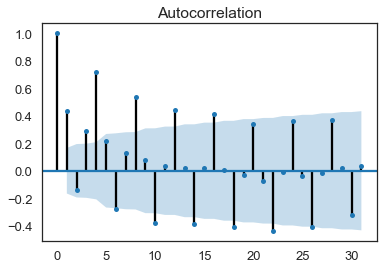

moviesthatnevergetold


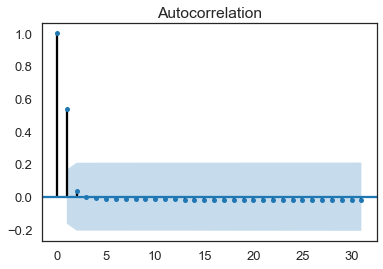

tweegram


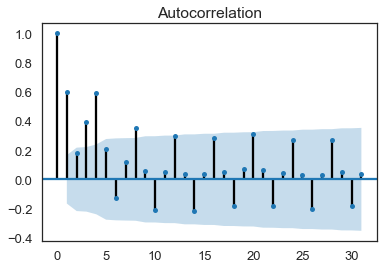

salute


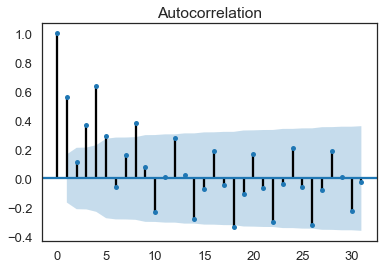

oomf


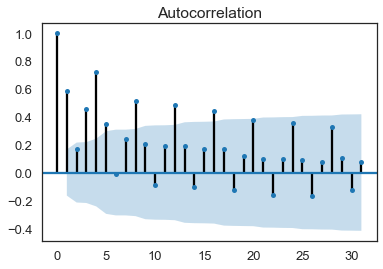

tcot


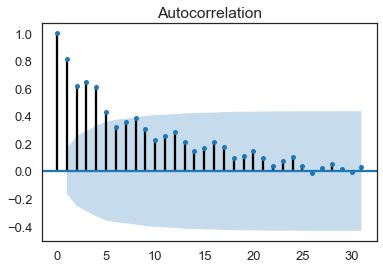

nationalbestfriendday


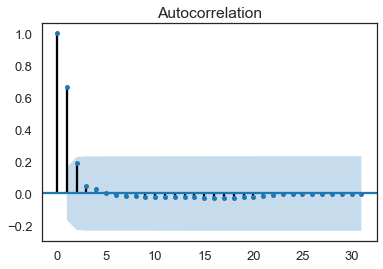

aquarius


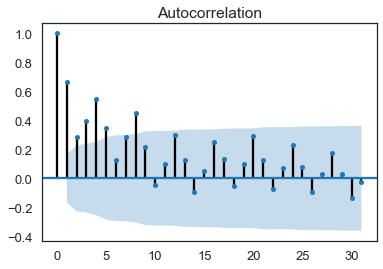

free


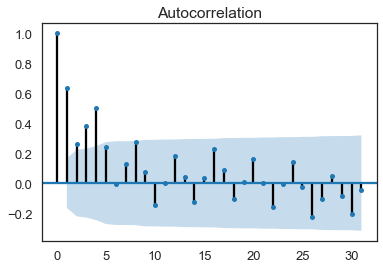

leo


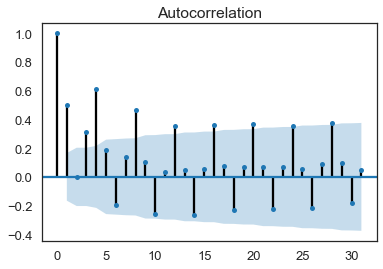

taurus


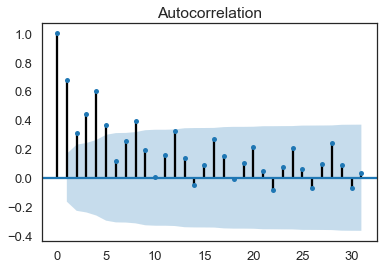

wtf


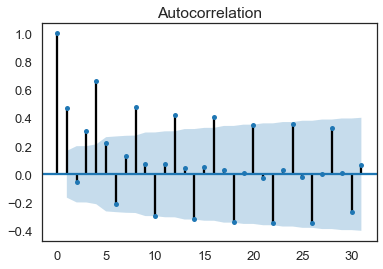

imagine


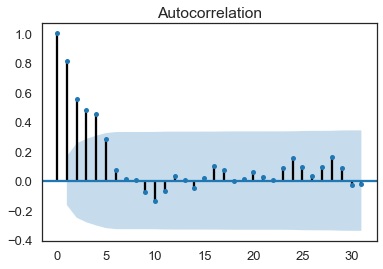

1dfact


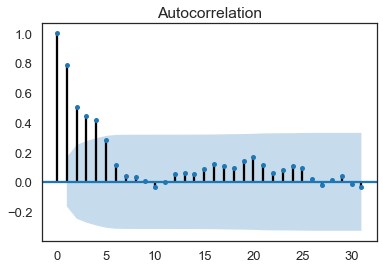

thingsigetalot


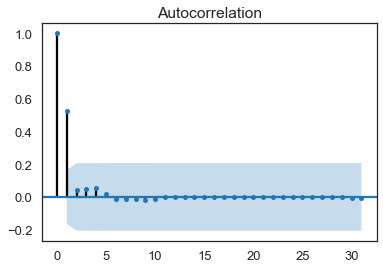

nowplaying


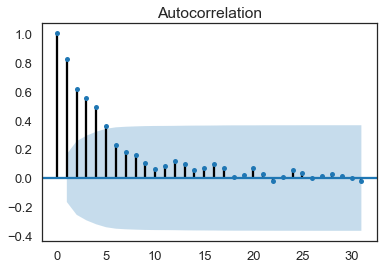

thingsisaywhilereadingmytl


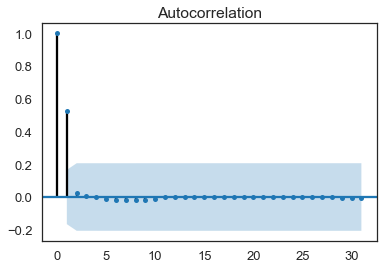

nowfollowing


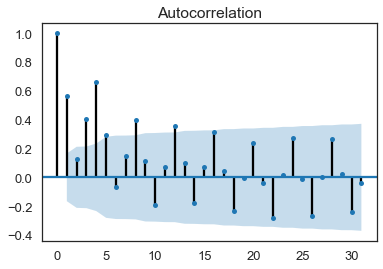

syria


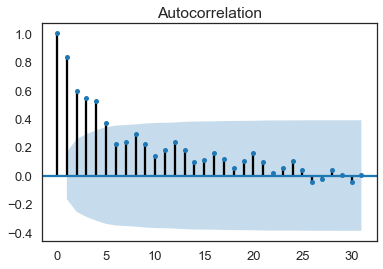

top100lies


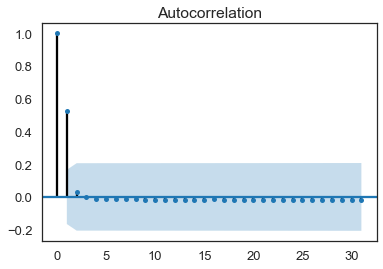

love


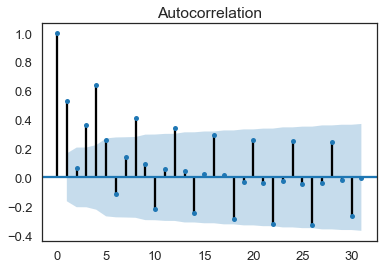

cancer


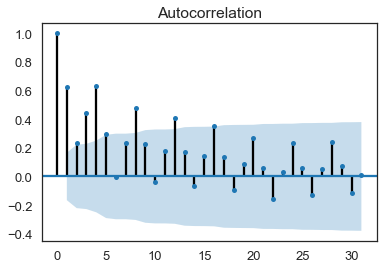

dearoomf


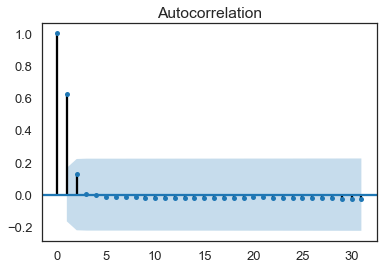

blessed


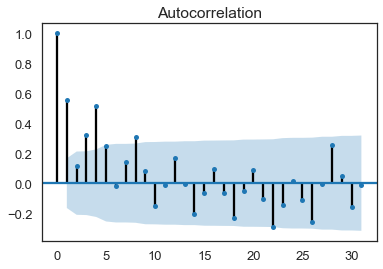

thoughtsduringschool


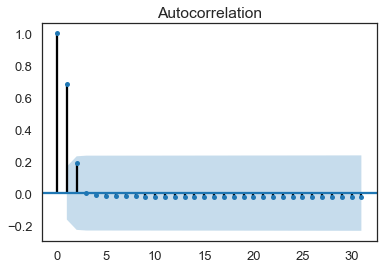

imhappywhen


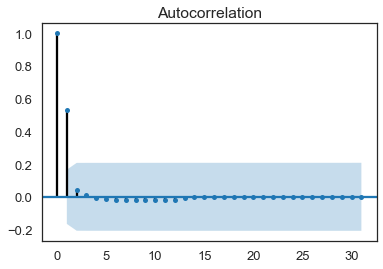

truthis


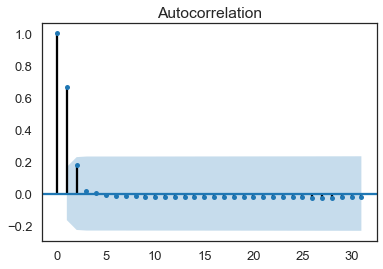

lol


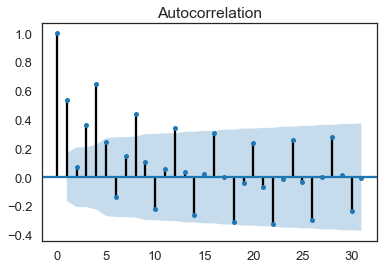

fml


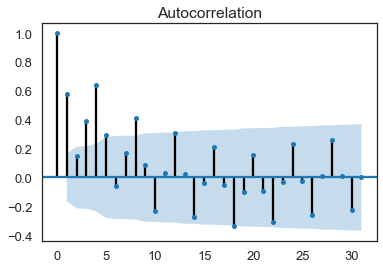

aries


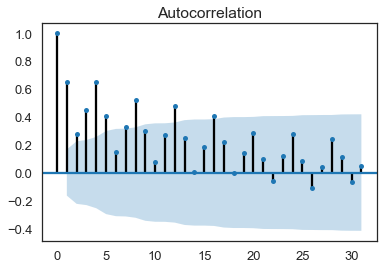

realshit


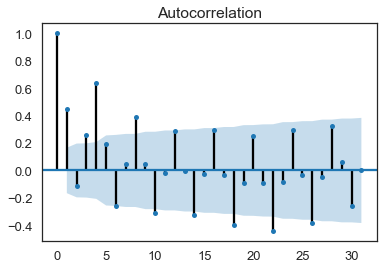

confessionhour


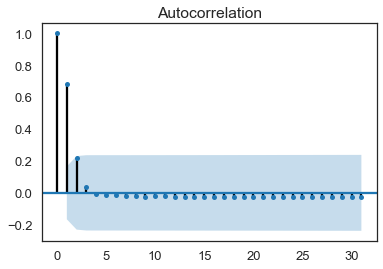

iadmit


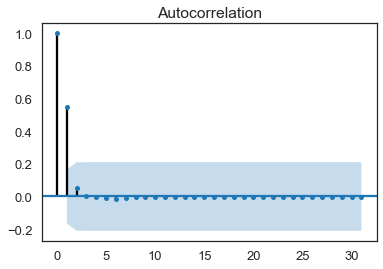

realtalk


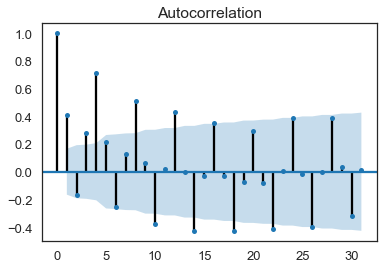

subtweet


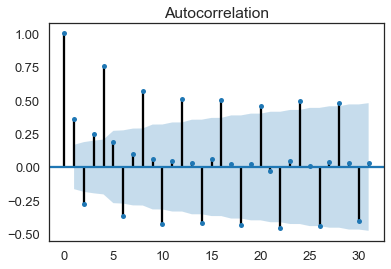

tfb


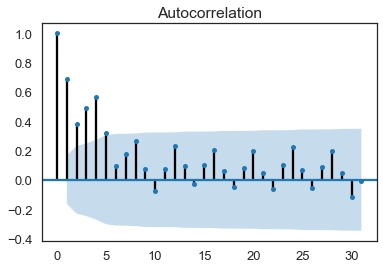

bgc


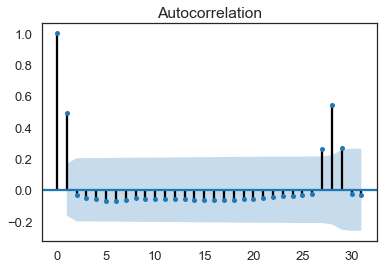

theworstfeeling


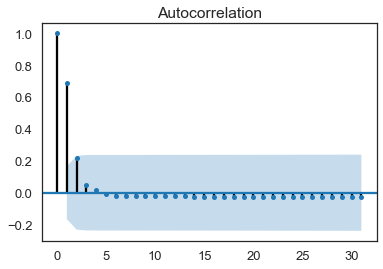

believe


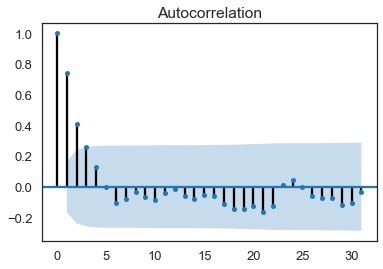

boyfriend


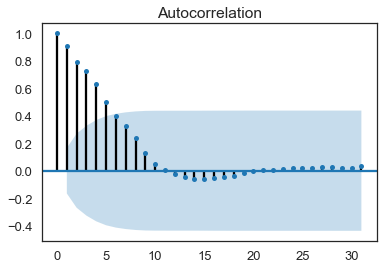

p2


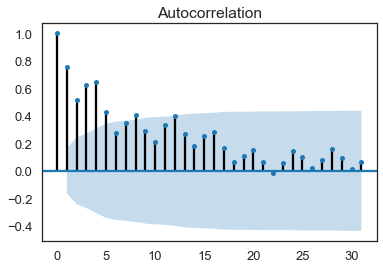

inourgeneration


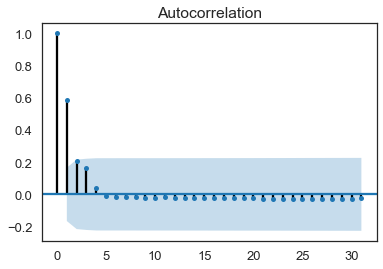

teamfollowback


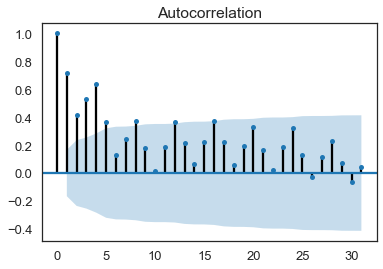

10thingsifindattractive


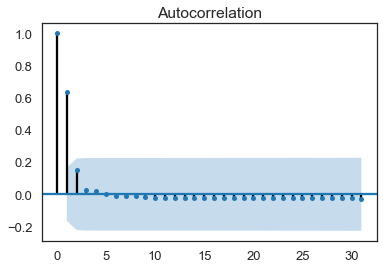

cancers


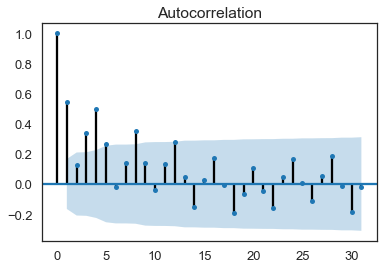

mybiggestproblem


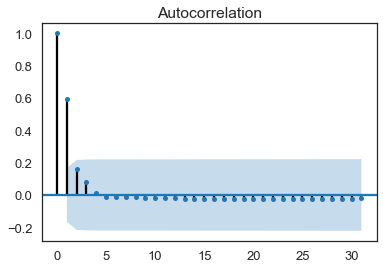

f1


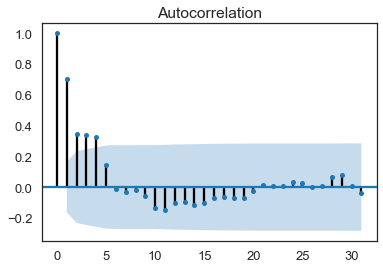

wewontworkoutif


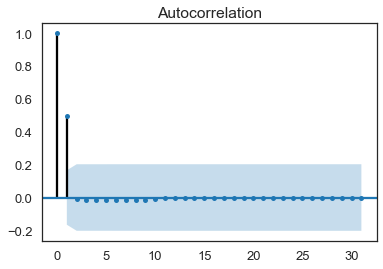

middleschoolmemories


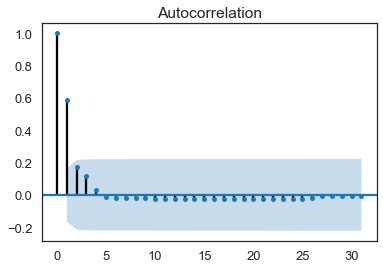

gemini


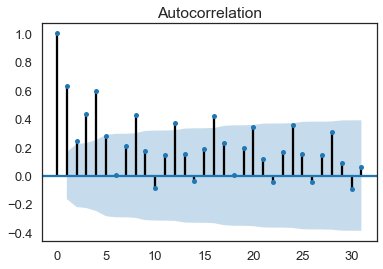

thatirritatesme


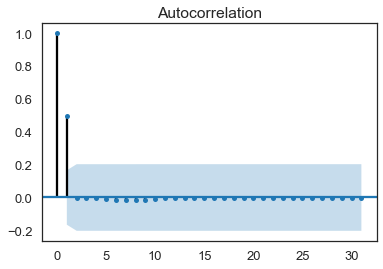

kca


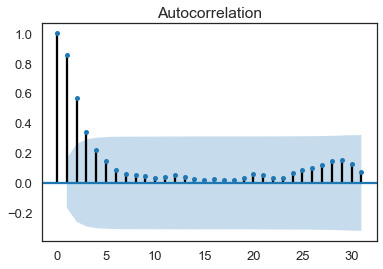

sagittarius


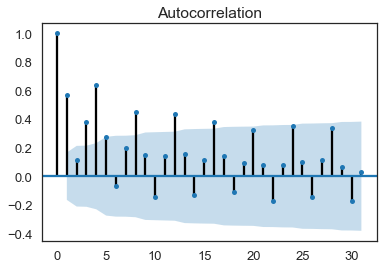

throwbackthursday


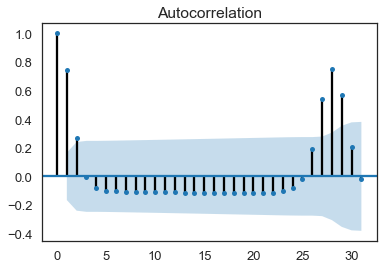

virgos


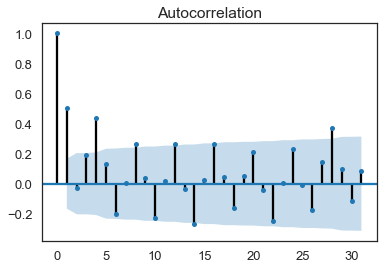

nf


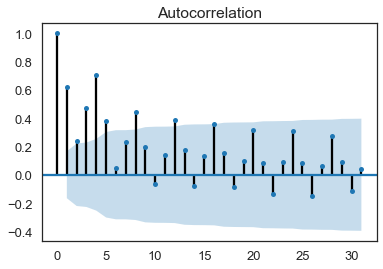

imsinglebecause


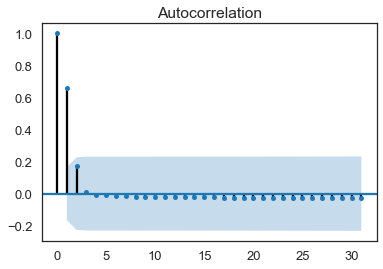

np


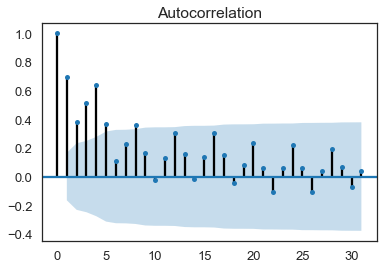

nw


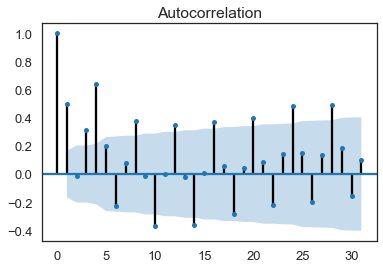

itscutewhen


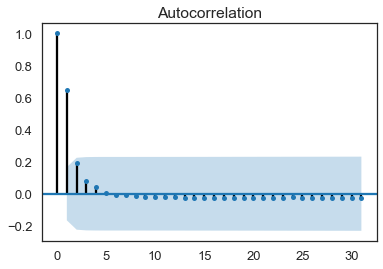

justsaying


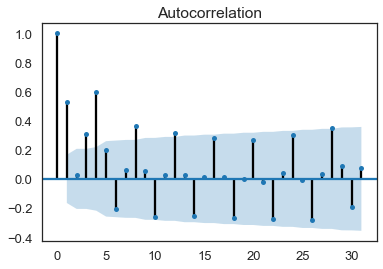

thingsmostpeoplelikebutidont


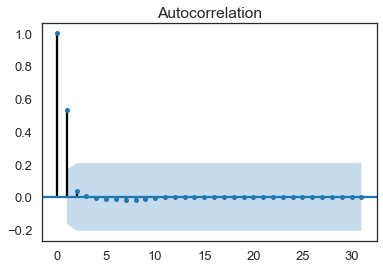

teamiphone


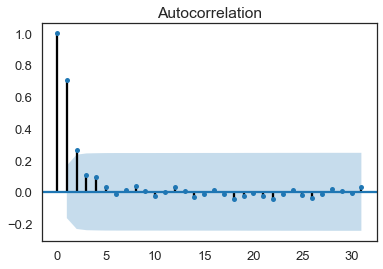

20thingsilove


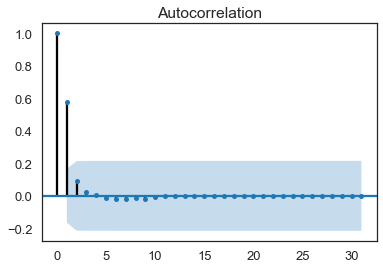

fb


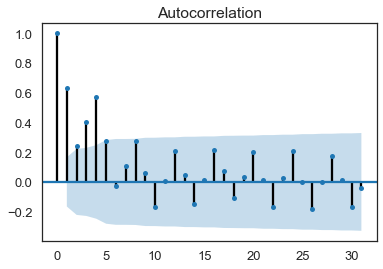

10factsaboutme


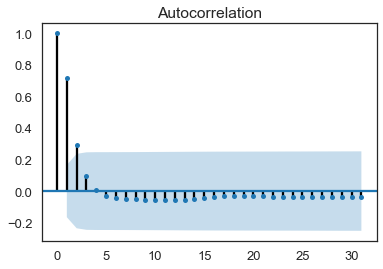

ff


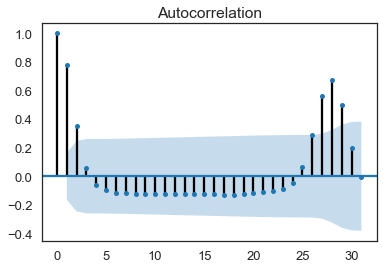

shoutout


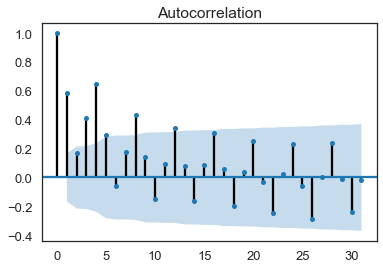

fact


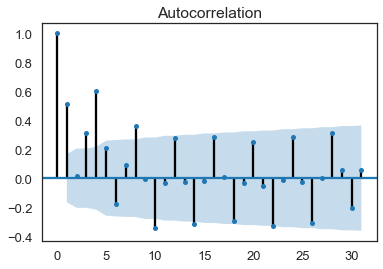

In [17]:
from pandas import Series
from matplotlib import pyplot
from statsmodels.graphics.tsaplots import plot_acf
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    plot_acf(series, lags=31)
    pyplot.show()

Autoregression: predicts future behavior based on past behavior. It’s used for forecasting when there is No correlation between values because Autoregression model is basically a linear regression and linear regression is a good fit when there's no linear independence between the data.
the following would be the model applied on our counts

some Infection counts have autocorrelation going to zero which imply randomness, On the other hand seasonal hashtags show also seasonality even with the lag >> check throwbackthursday and ff

500aday
Test MSE: 133.216


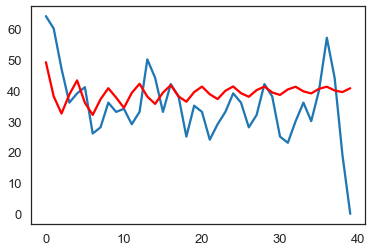

gnation
Test MSE: 13.291


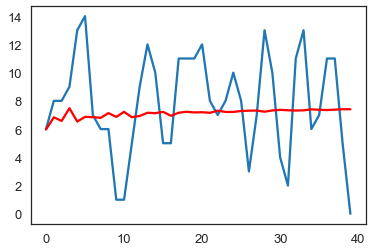

random
Test MSE: 1668.868


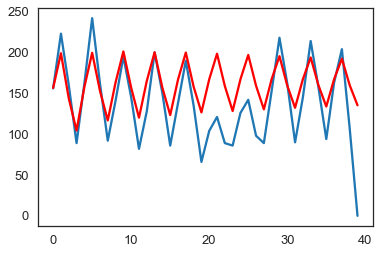

mythoughtsduringschool
Test MSE: 1470.262


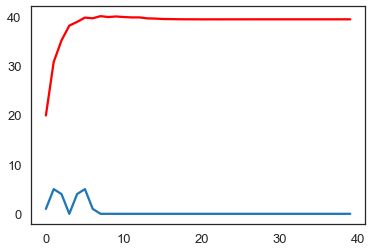

follow
Test MSE: 2332.844


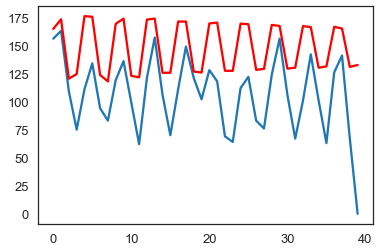

swag
Test MSE: 1700.699


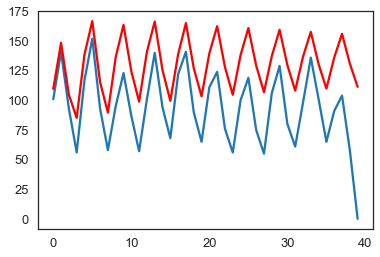

scorpio
Test MSE: 5204.715


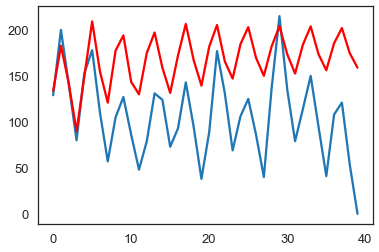

twitterpeopleilove
Test MSE: 1639691.176


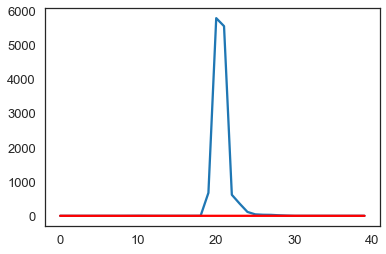

winning
Test MSE: 15323.488


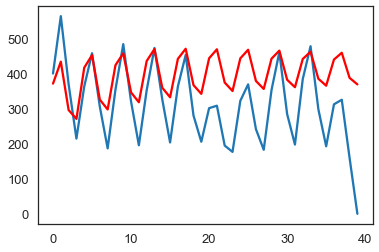

virgo
Test MSE: 1395.858


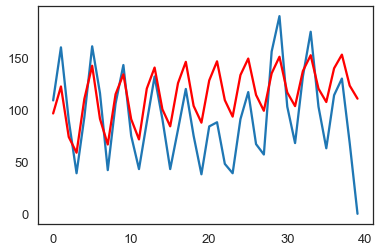

lt
Test MSE: 4093.265


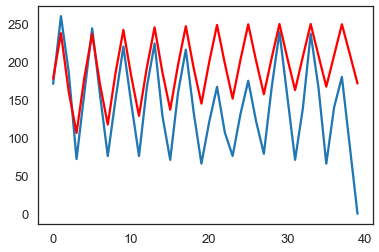

libra
Test MSE: 6105.159


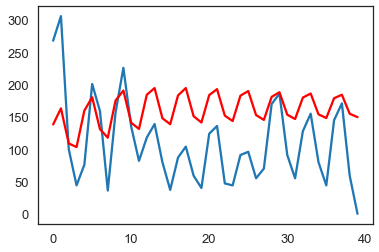

sorrynotsorry
Test MSE: 2355.014


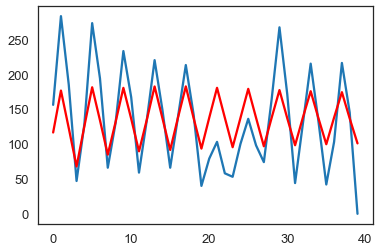

bahrain
Test MSE: 221.391


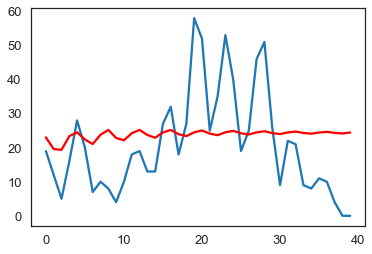

followback
Test MSE: 5367.083


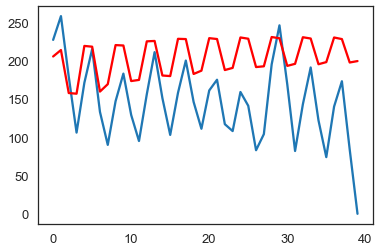

yougetpointsif
Test MSE: 108.191


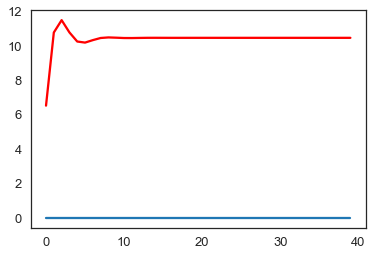

tbt
Test MSE: 302502.820


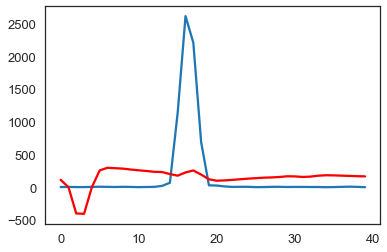

yougetmajorpointsif
Test MSE: 131052.040


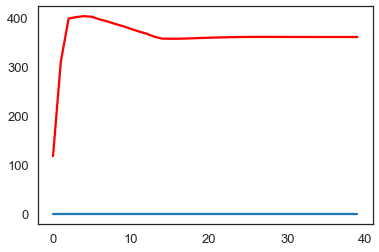

lrt
Test MSE: 9804.629


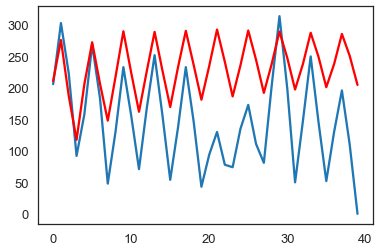

libras
Test MSE: 2113.252


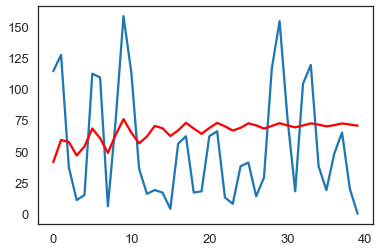

trayvonmartin
Test MSE: 996.374


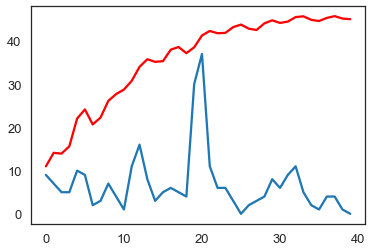

aquarians
Test MSE: 3781.939


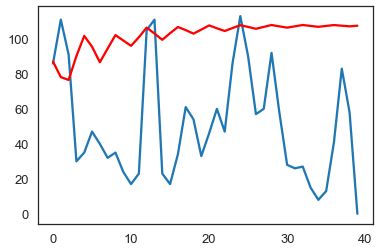

oomfs
Test MSE: 981.112


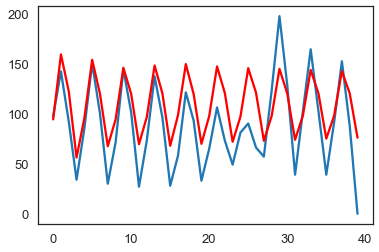

nfb
Test MSE: 5900.054


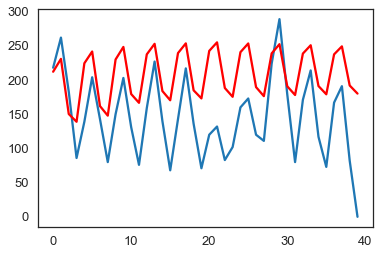

dailytweet
Test MSE: 5007.888


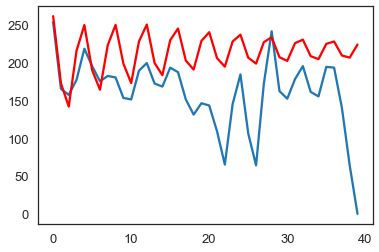

youknowwhatsannoying
Test MSE: 10.484


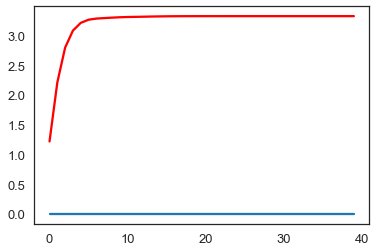

capricorn
Test MSE: 4966.914


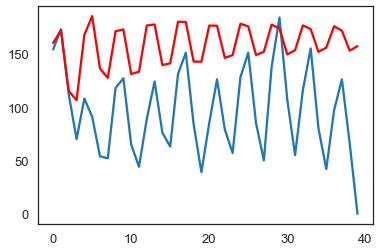

truth
Test MSE: 1903.077


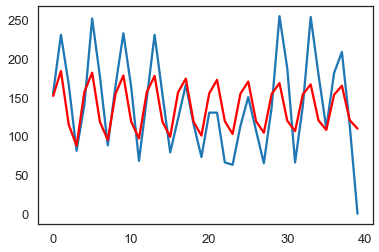

instagram
Test MSE: 6231.061


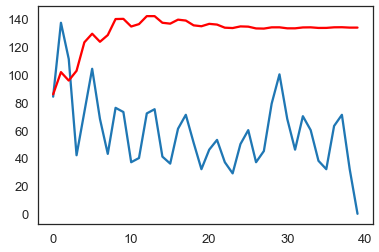

yolo
Test MSE: 73094.470


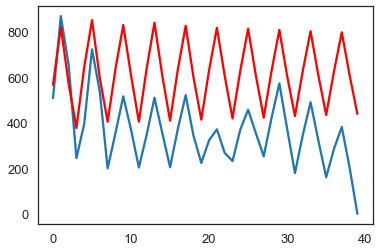

dead
Test MSE: 2657.031


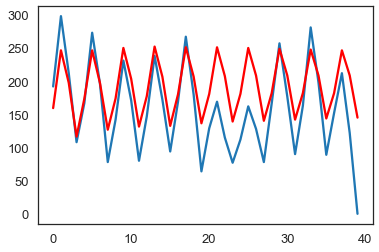

10thingsthatilike
Test MSE: 1.225


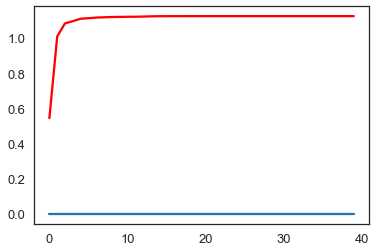

goodnight
Test MSE: 3770.620


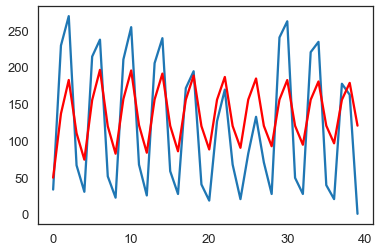

pisces
Test MSE: 2068.605


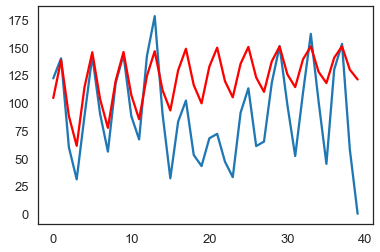

ifitwasuptome
Test MSE: 38001.624


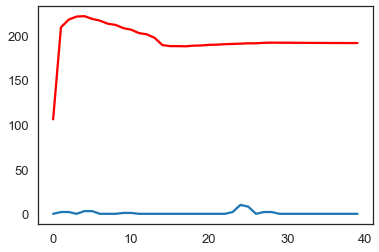

10thingsihate
Test MSE: 7208041363957131.000


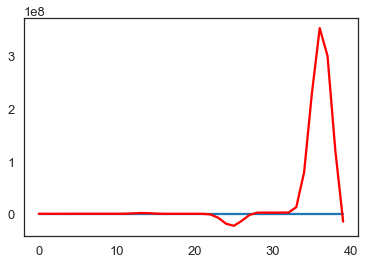

retweet
Test MSE: 26970.139


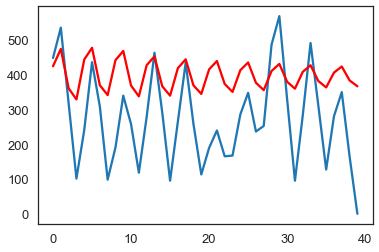

icantstandwhen
Test MSE: 56281.464


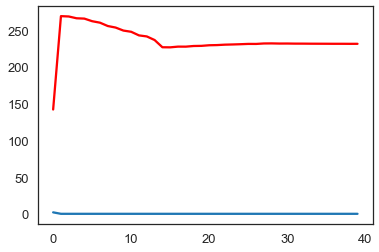

rt
Test MSE: 24282.545


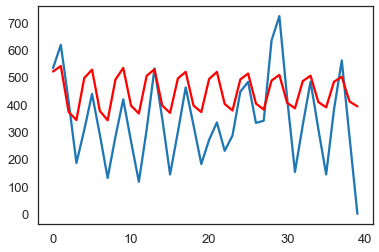

wheniwaslittle
Test MSE: 222942.481


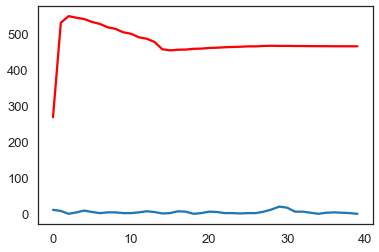

smh
Test MSE: 4340.282


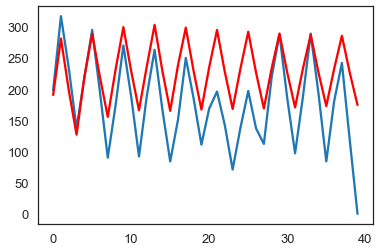

moviesthatnevergetold
Test MSE: 54397.657


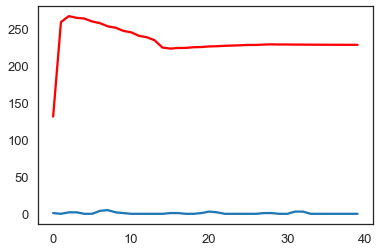

tweegram
Test MSE: 917.889


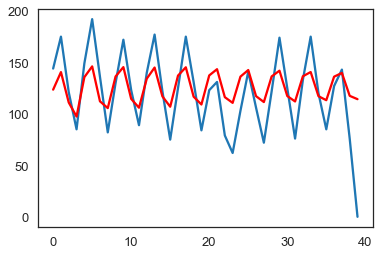

salute
Test MSE: 1700.421


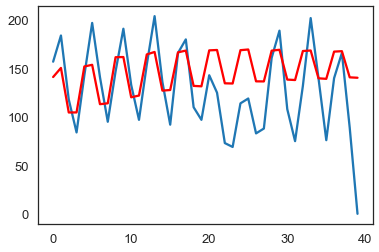

oomf
Test MSE: 218153.994


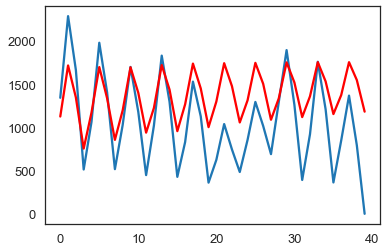

tcot
Test MSE: 51.002


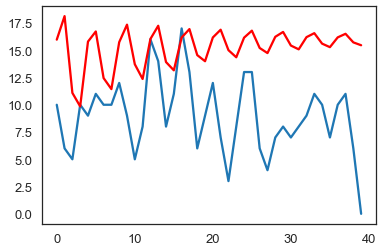

nationalbestfriendday
Test MSE: 88593.732


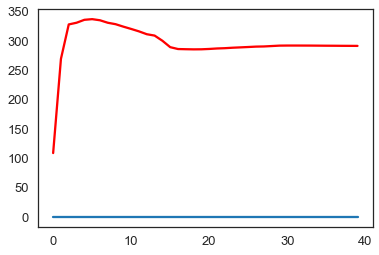

aquarius
Test MSE: 5065.121


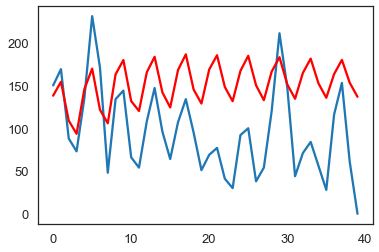

free
Test MSE: 403.322


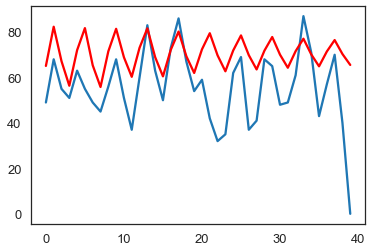

leo
Test MSE: 7120.808


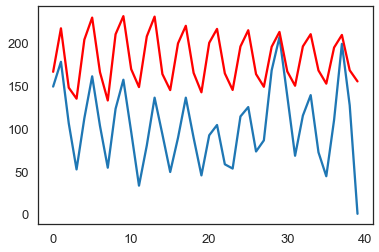

taurus
Test MSE: 4439.133


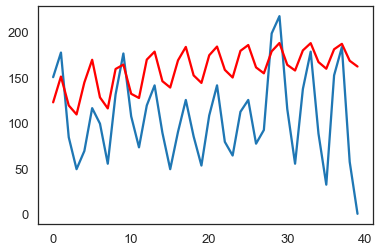

wtf
Test MSE: 1147.793


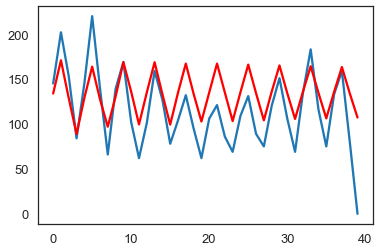

imagine
Test MSE: 2711.849


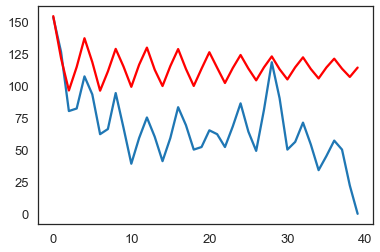

1dfact
Test MSE: 989.662


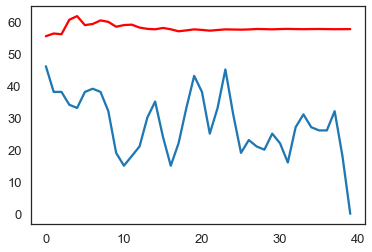

thingsigetalot
Test MSE: 44.578


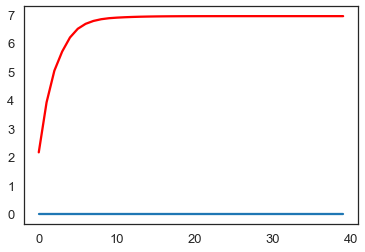

nowplaying
Test MSE: 1514.812


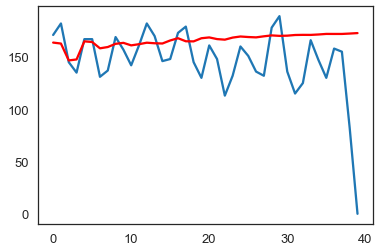

thingsisaywhilereadingmytl
Test MSE: 1.054


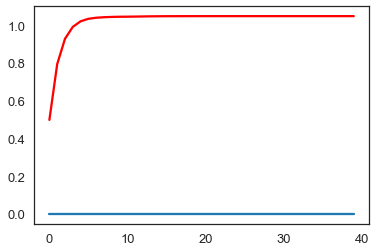

nowfollowing
Test MSE: 2635.761


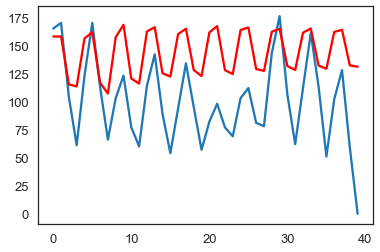

syria
Test MSE: 82.108


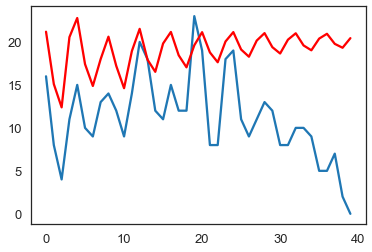

top100lies
Test MSE: 96489.530


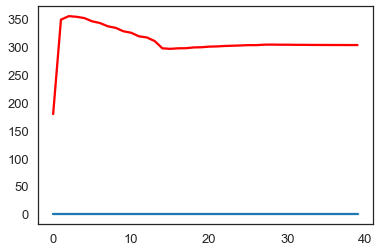

love
Test MSE: 1124.818


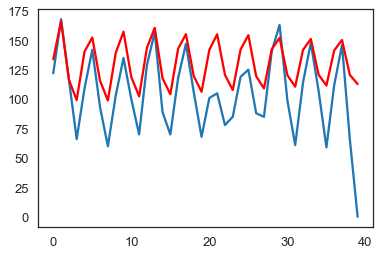

cancer
Test MSE: 1607.932


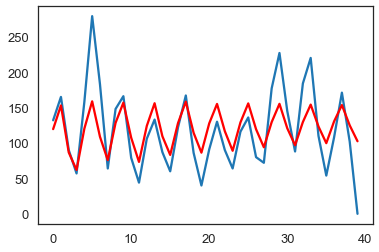

dearoomf
Test MSE: 370358.212


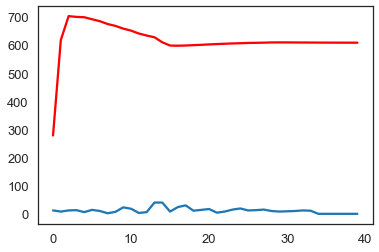

blessed
Test MSE: 4301.873


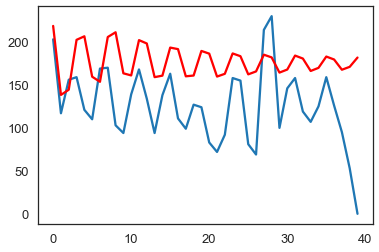

thoughtsduringschool
Test MSE: 8242041.689


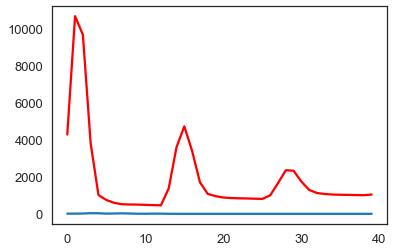

imhappywhen
Test MSE: 2304142.625


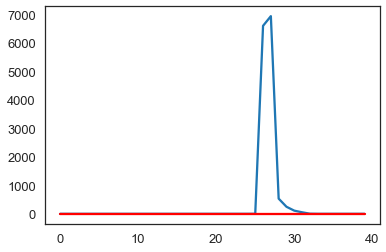

truthis
Test MSE: 69461.391


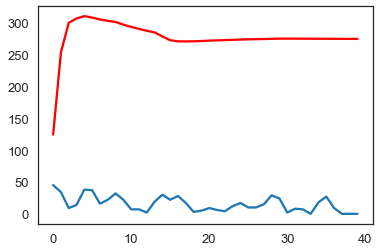

lol
Test MSE: 1572.330


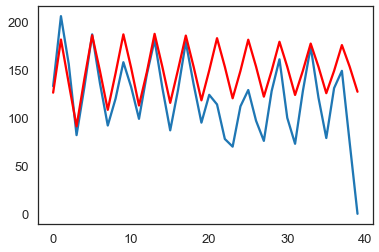

fml
Test MSE: 1907.366


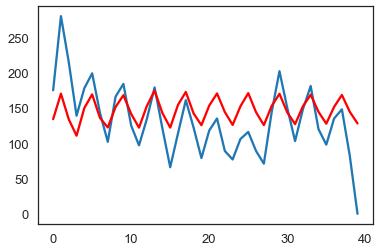

aries
Test MSE: 3421.093


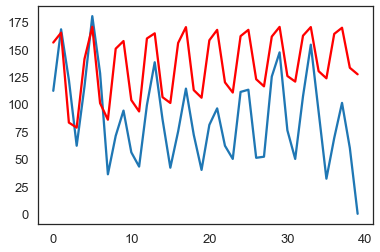

realshit
Test MSE: 1977.987


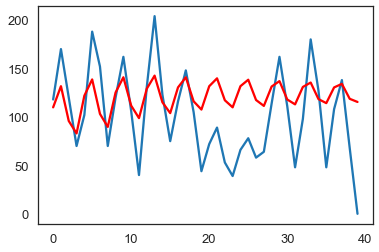

confessionhour
Test MSE: 21651.518


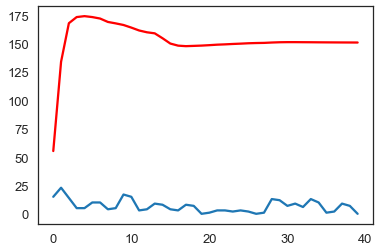

iadmit
Test MSE: 3546464.274


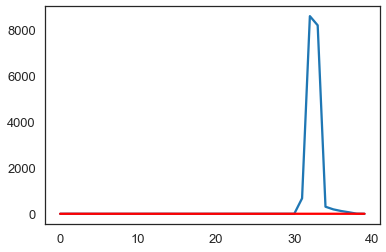

realtalk
Test MSE: 2643.013


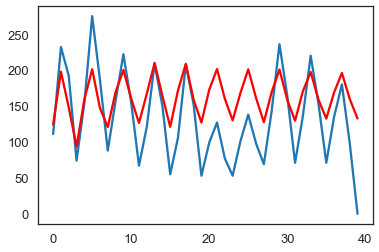

subtweet
Test MSE: 2769.244


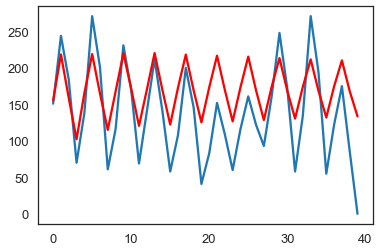

tfb
Test MSE: 1165.447


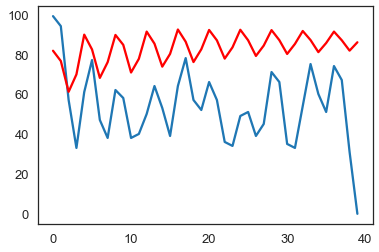

bgc
Test MSE: 183682.364


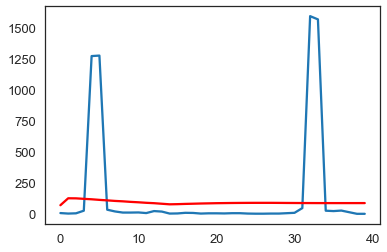

theworstfeeling
Test MSE: 69750.312


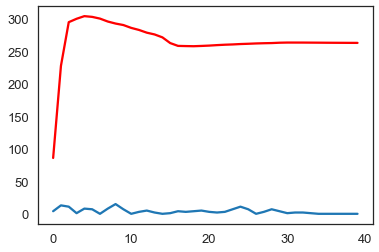

believe
Test MSE: 4109.693


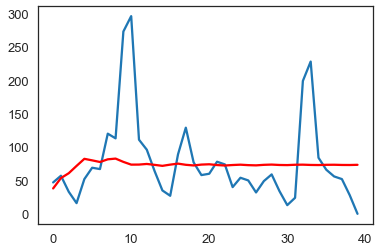

boyfriend
Test MSE: 12589.883


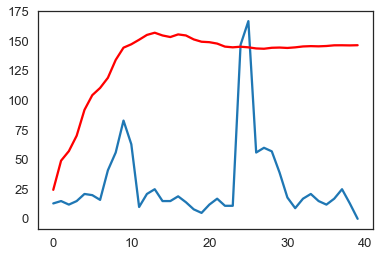

p2
Test MSE: 12.098


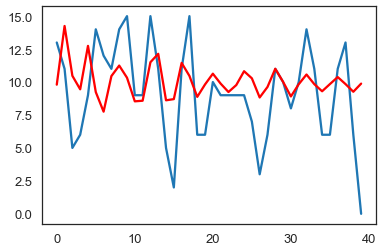

inourgeneration
Test MSE: 48041.825


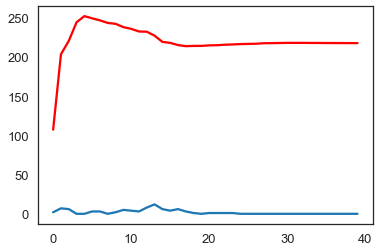

teamfollowback
Test MSE: 8336.540


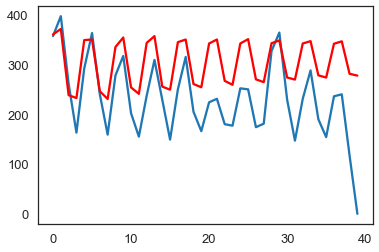

10thingsifindattractive
Test MSE: 108576.199


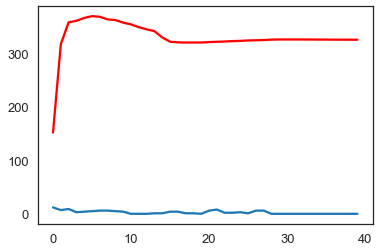

cancers
Test MSE: 1443.092


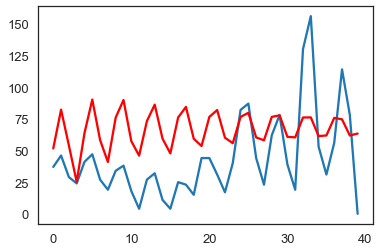

mybiggestproblem
Test MSE: 53715.129


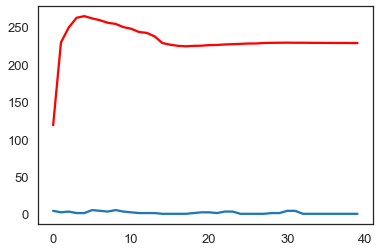

f1
Test MSE: 1073.488


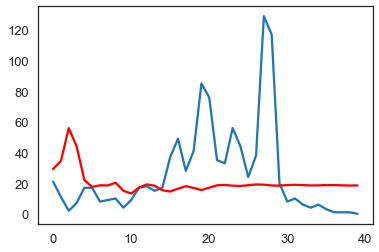

wewontworkoutif
Test MSE: 0.000


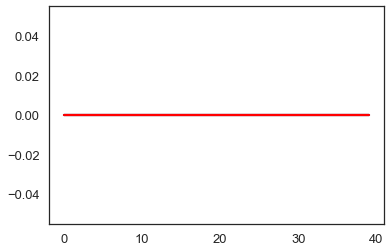

middleschoolmemories
Test MSE: 83599.314


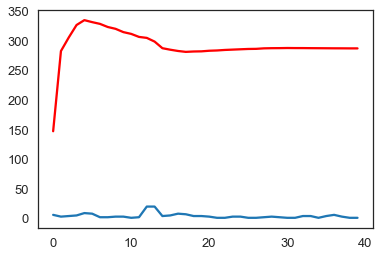

gemini
Test MSE: 5633.078


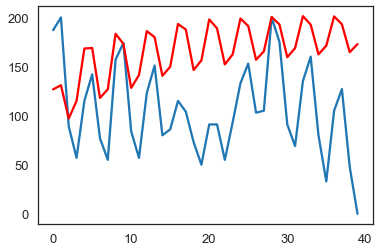

thatirritatesme
Test MSE: 6.486


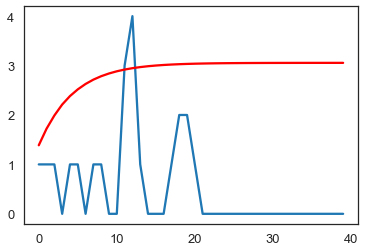

kca
Test MSE: 3470.189


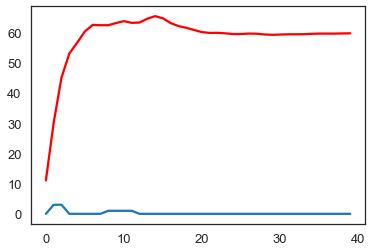

sagittarius
Test MSE: 6926.459


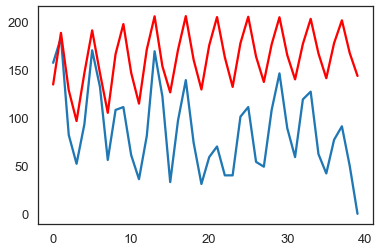

throwbackthursday
Test MSE: 161572.225


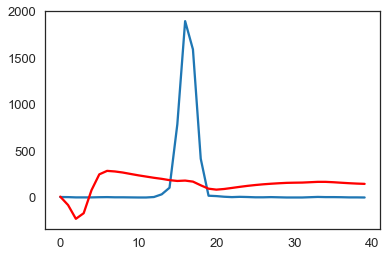

virgos
Test MSE: 1947.197


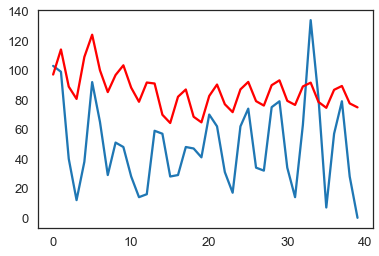

nf
Test MSE: 73007.006


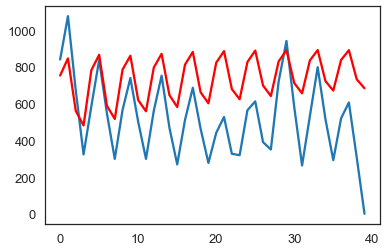

imsinglebecause
Test MSE: 45200.590


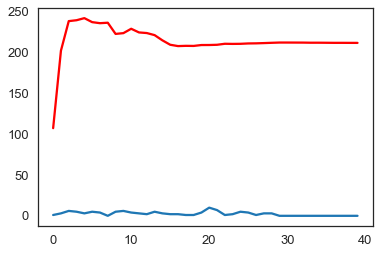

np
Test MSE: 50808.295


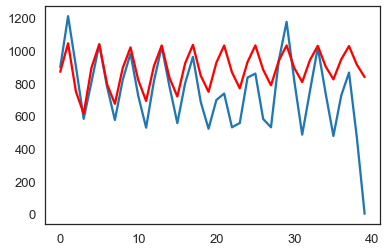

nw
Test MSE: 30269.696


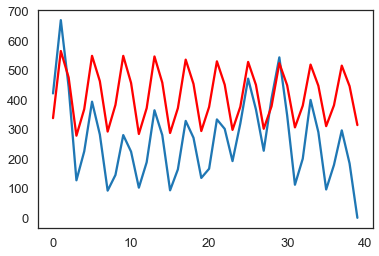

itscutewhen
Test MSE: 106370346614386.844


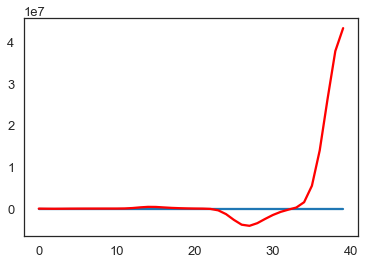

justsaying
Test MSE: 2473.137


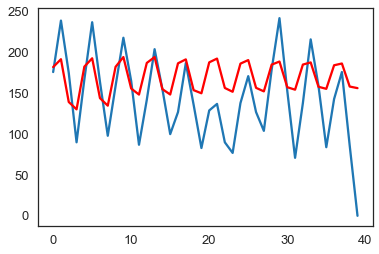

thingsmostpeoplelikebutidont
Test MSE: 1.635


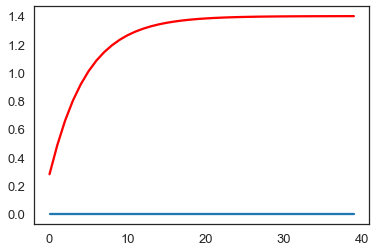

teamiphone
Test MSE: 12815.840


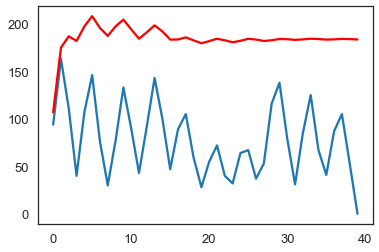

20thingsilove
Test MSE: 7.681


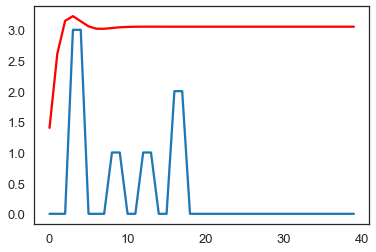

fb
Test MSE: 5499.122


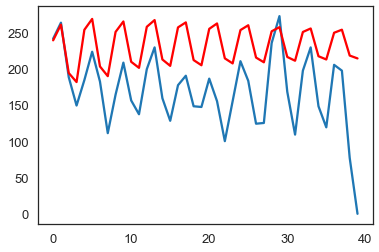

10factsaboutme
Test MSE: 1356219.823


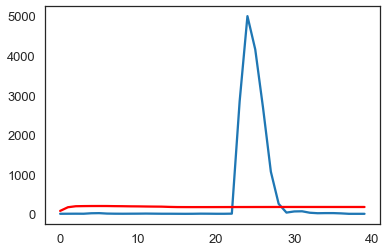

ff
Test MSE: 866137.956


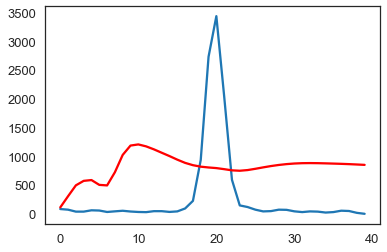

shoutout
Test MSE: 8096.832


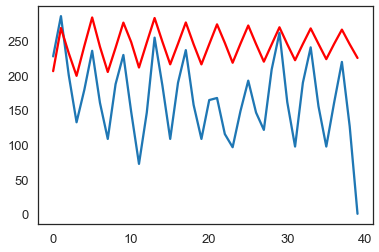

fact
Test MSE: 5396.609


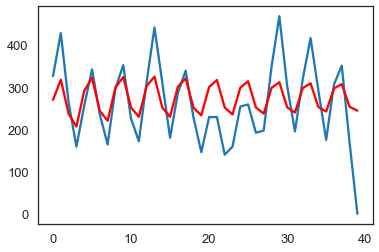

In [59]:
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
# create lagged dataset
    X = series.values 
    #10 here is to say we want to pedict the ten following time windows
    train, test = X[1:len(X)-40], X[len(X)-40:]
# train autoregression
    model = AR(train)
    model_fit = model.fit()
    #print('Lag: %s' % model_fit.k_ar)
    #print('Coefficients: %s' % model_fit.params)
    # make predictions
    predictions = model_fit.predict(start=len(train), end=len(train)+len(test)-1, dynamic=False)
    #for i in range(len(predictions)):
        #print('predicted=%f, expected=%f' % (predictions[i], test[i]))
    error = mean_squared_error(test, predictions)
    print('Test MSE: %.3f' % error)
# plot results
    pyplot.plot(test)
    pyplot.plot(predictions, color='red')
    pyplot.show()

As Expected autoregression is not the best predictor for all hashtags since some of them have autocorrelation that goes to zero

# Moving Average

Moving Average tries to smooth outs counts by cancelling noise "short term fluctuations so we can see that big peaks are cancelled

Simple Moving Average follows the following formula:

$SMA = \frac{A_1 + A_2 + A_3+...+A_n}{n}$

where A is the average in period n, and n is the number of periods.

$Y_{t} = \alpha + \epsilon_{t}+\phi_{1} \epsilon_{t-1}+ \phi_{2} \epsilon_{t-2}+...+ \phi_{q} \epsilon_{t-q}$

500aday


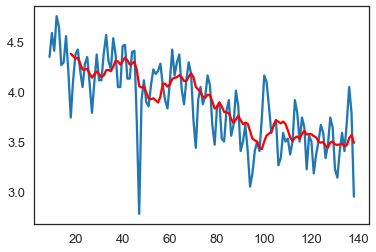

gnation


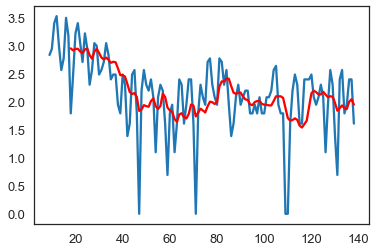

random


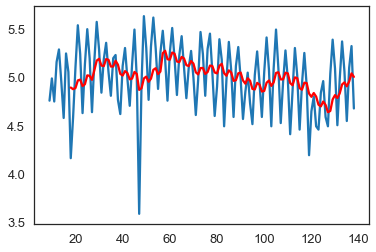

mythoughtsduringschool


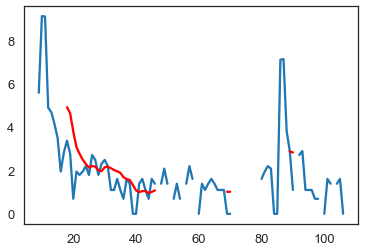

follow


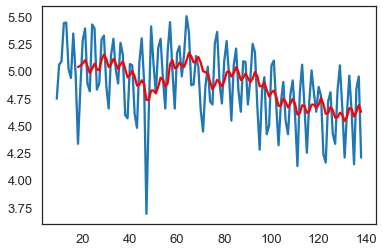

swag


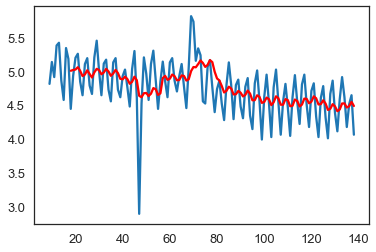

scorpio


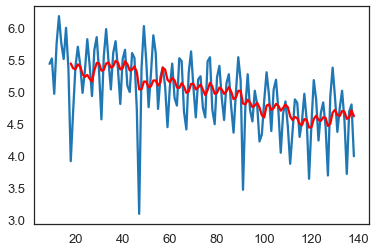

twitterpeopleilove


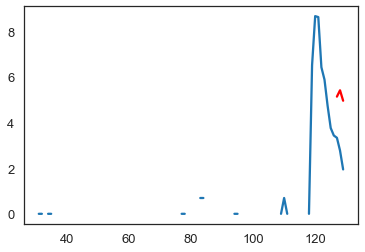

winning


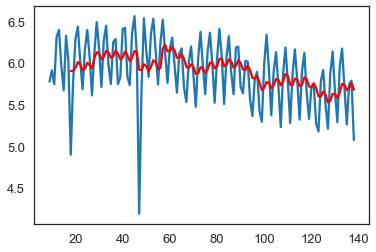

virgo


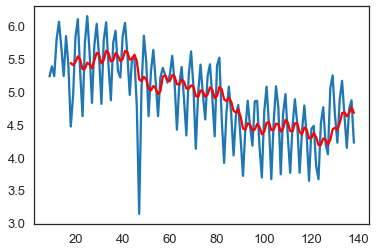

lt


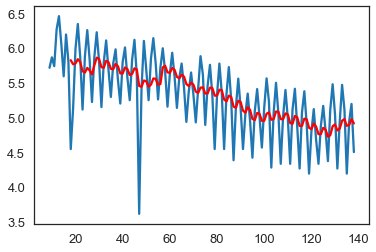

libra


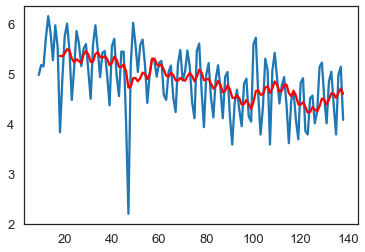

sorrynotsorry


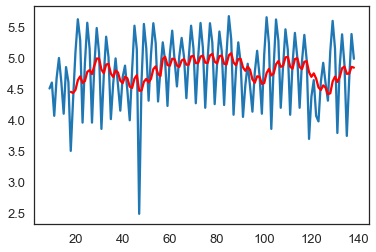

bahrain


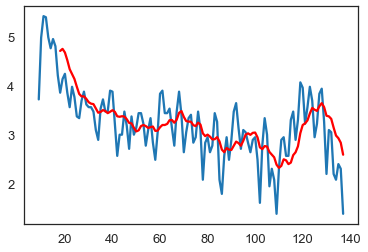

followback


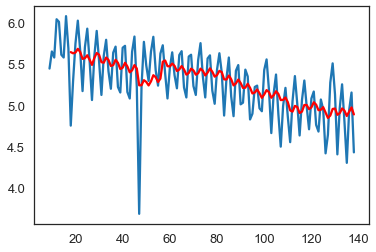

yougetpointsif


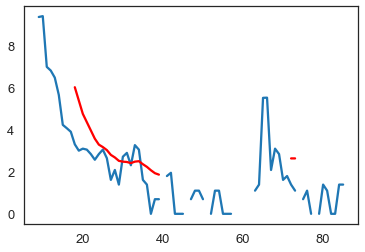

tbt


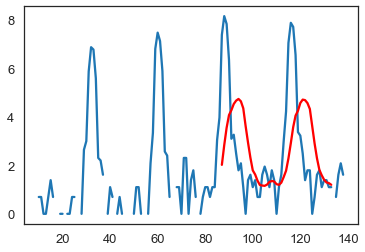

yougetmajorpointsif


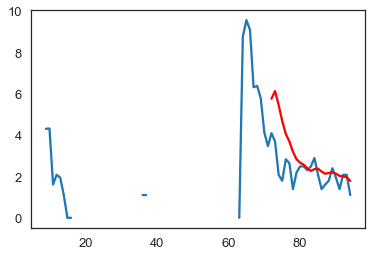

lrt


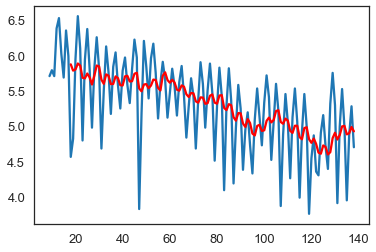

libras


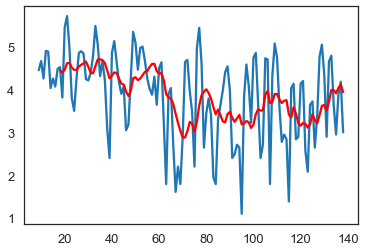

trayvonmartin


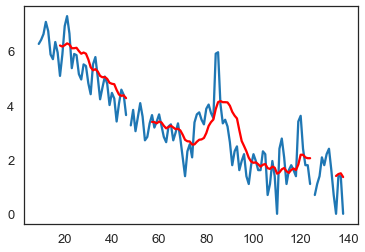

aquarians


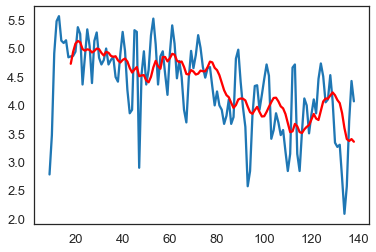

oomfs


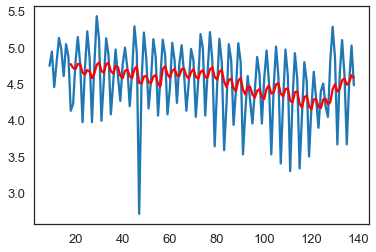

nfb


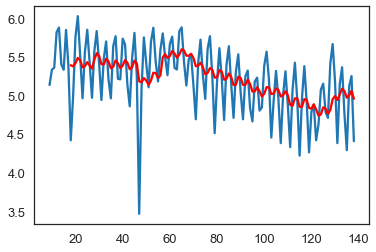

dailytweet


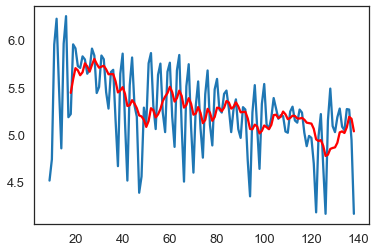

youknowwhatsannoying


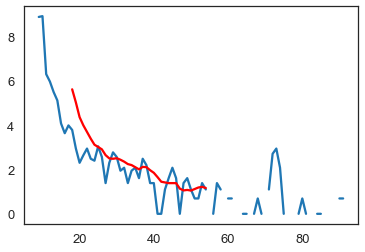

capricorn


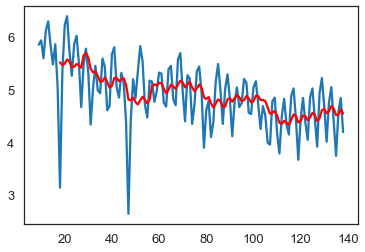

truth


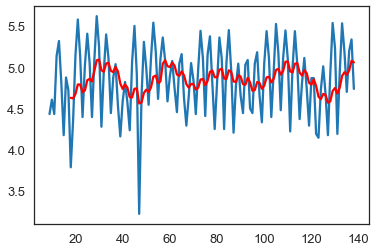

instagram


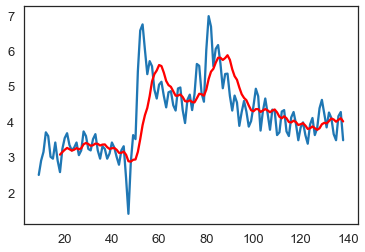

yolo


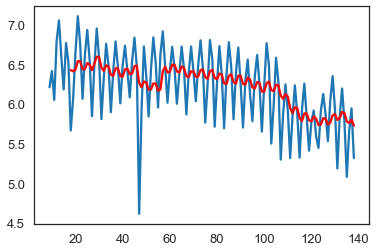

dead


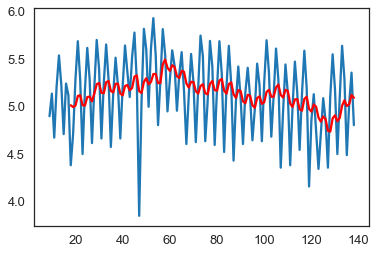

10thingsthatilike


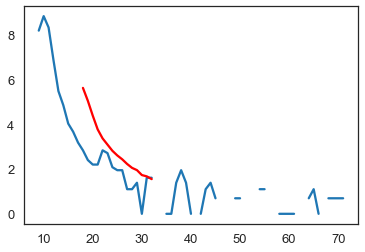

goodnight


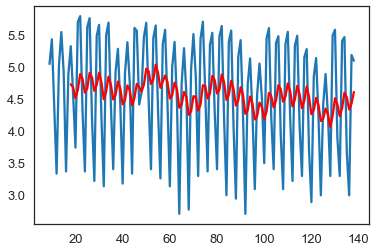

pisces


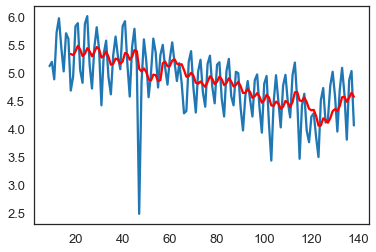

ifitwasuptome


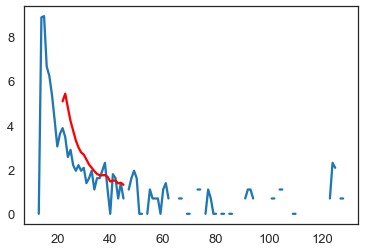

10thingsihate


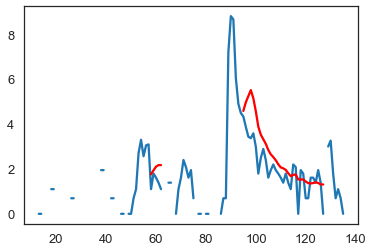

retweet


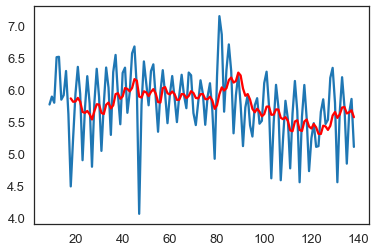

icantstandwhen


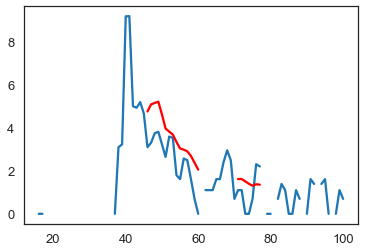

rt


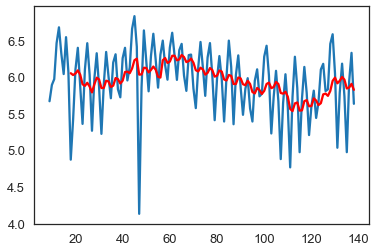

wheniwaslittle


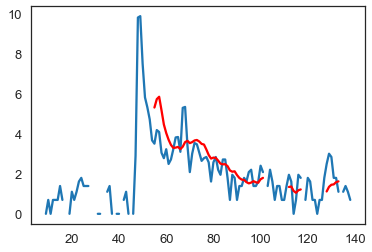

smh


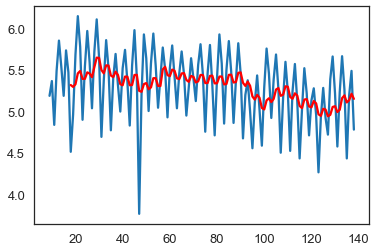

moviesthatnevergetold


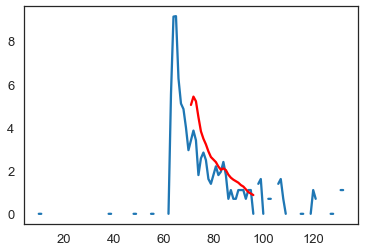

tweegram


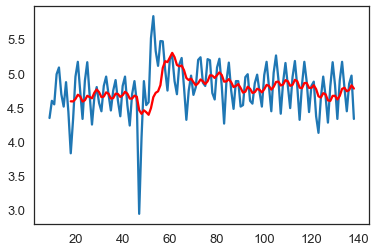

salute


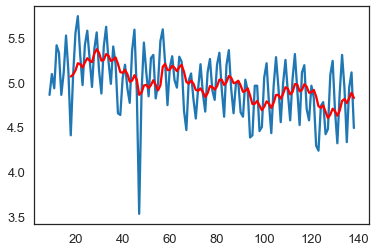

oomf


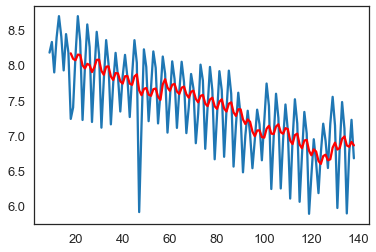

tcot


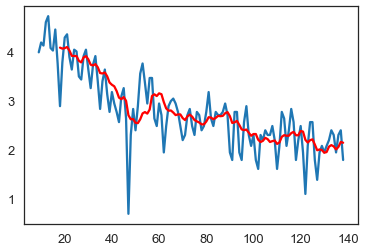

nationalbestfriendday


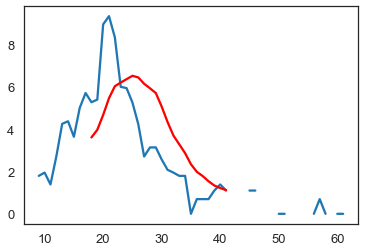

aquarius


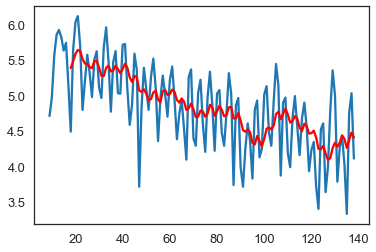

free


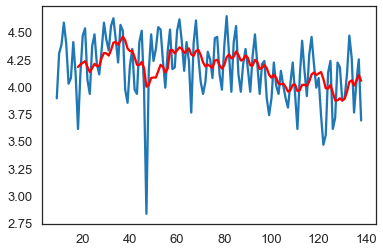

leo


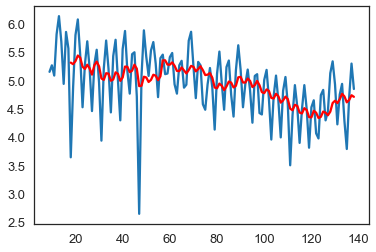

taurus


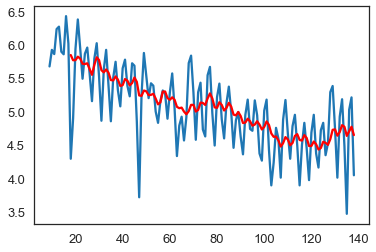

wtf


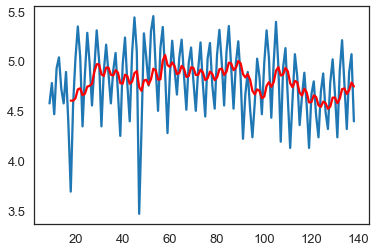

imagine


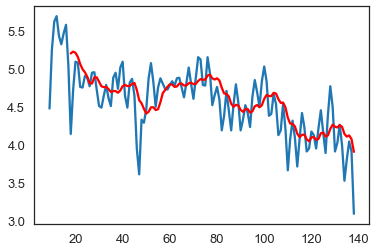

1dfact


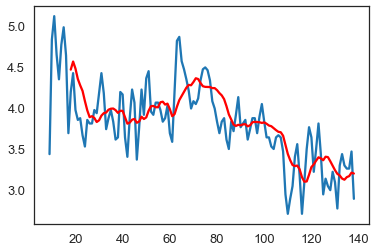

thingsigetalot


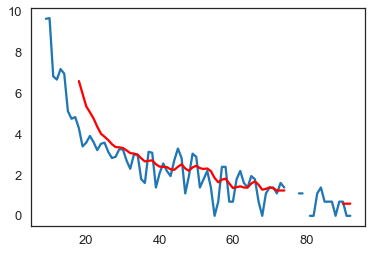

nowplaying


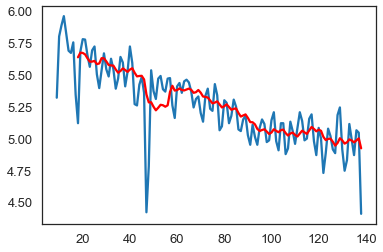

thingsisaywhilereadingmytl


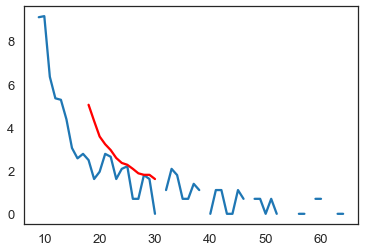

nowfollowing


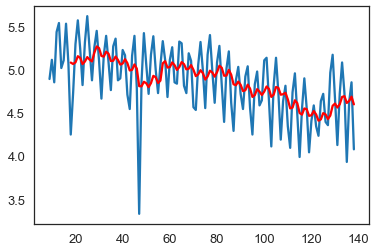

syria


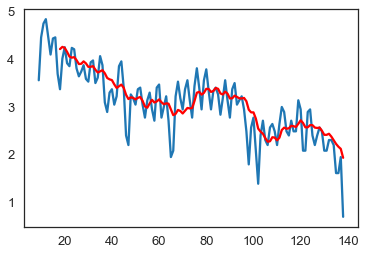

top100lies


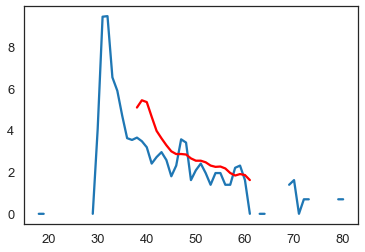

love


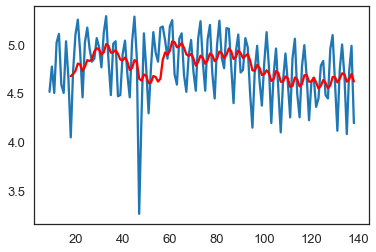

cancer


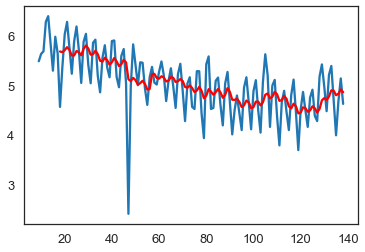

dearoomf


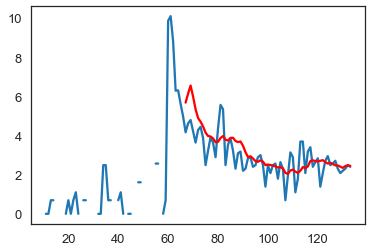

blessed


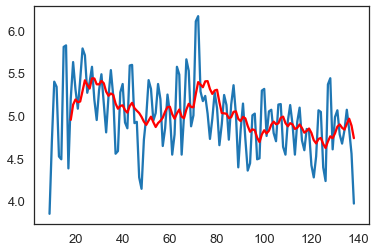

thoughtsduringschool


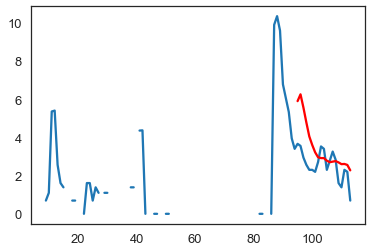

imhappywhen


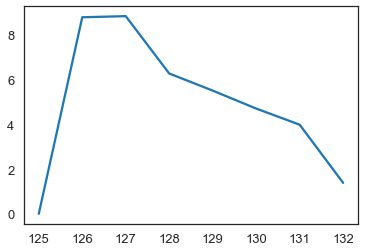

truthis


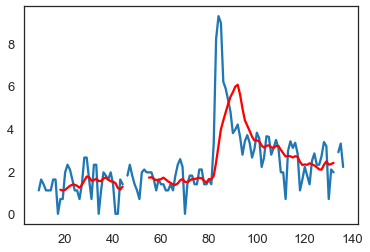

lol


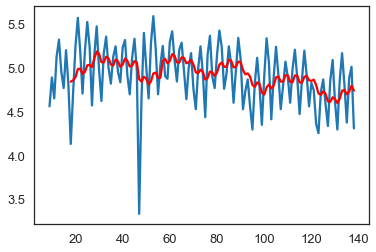

fml


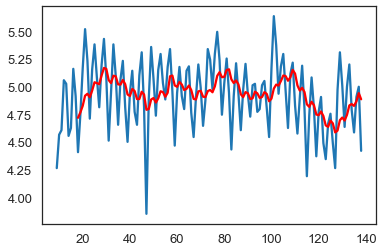

aries


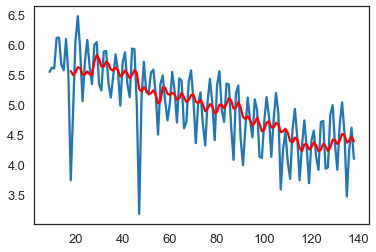

realshit


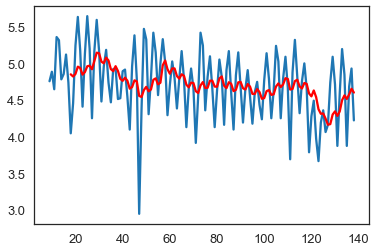

confessionhour


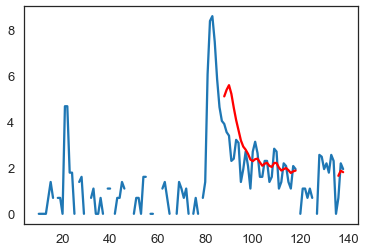

iadmit


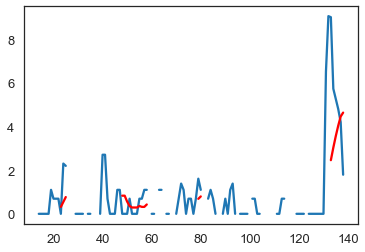

realtalk


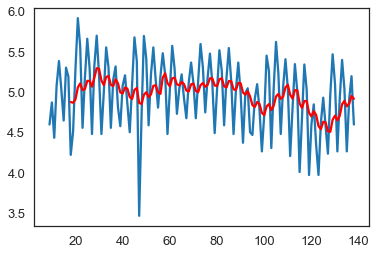

subtweet


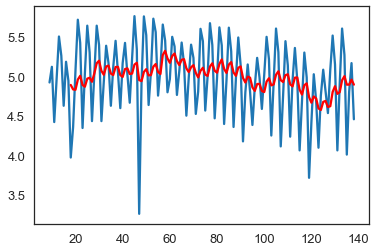

tfb


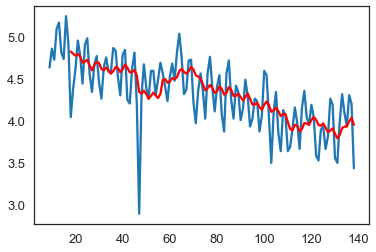

bgc


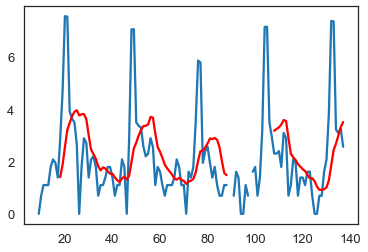

theworstfeeling


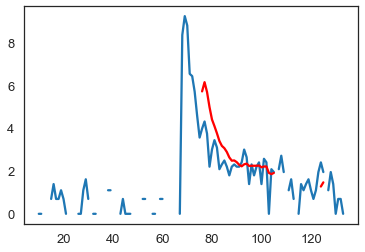

believe


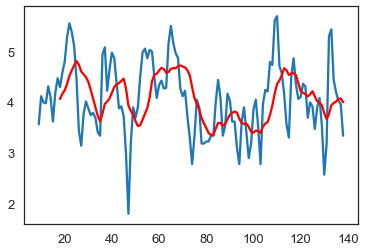

boyfriend


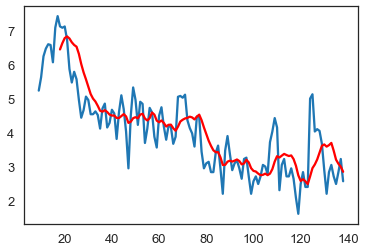

p2


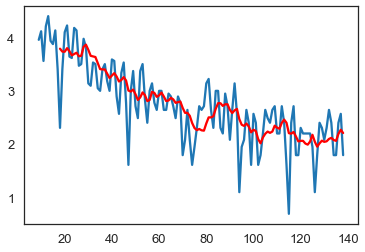

inourgeneration


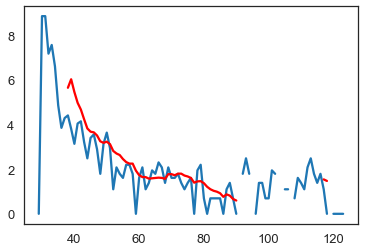

teamfollowback


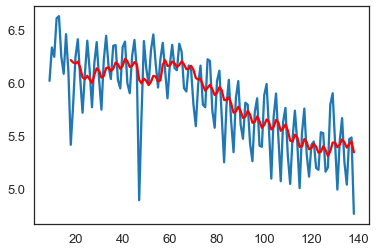

10thingsifindattractive


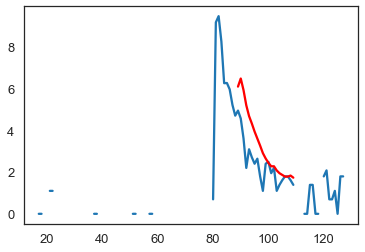

cancers


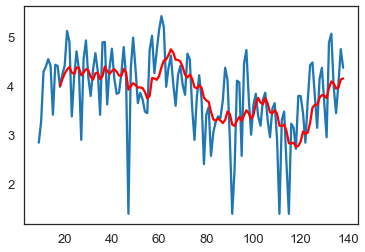

mybiggestproblem


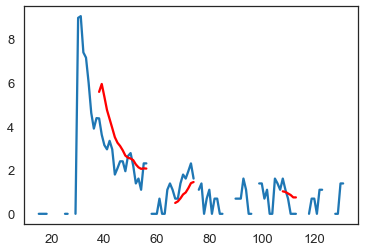

f1


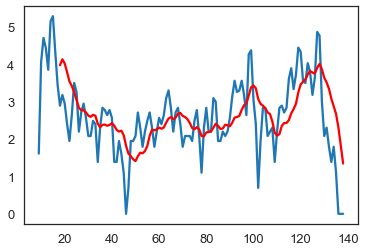

wewontworkoutif


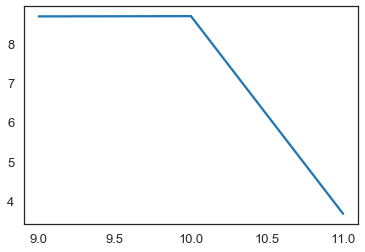

middleschoolmemories


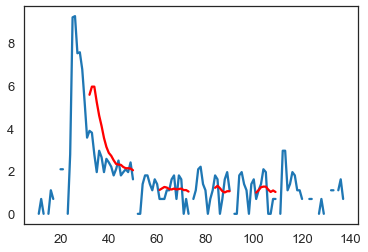

gemini


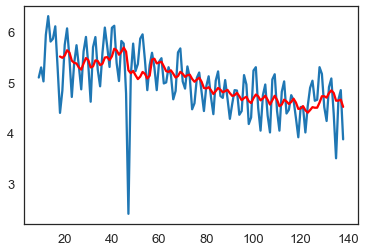

thatirritatesme


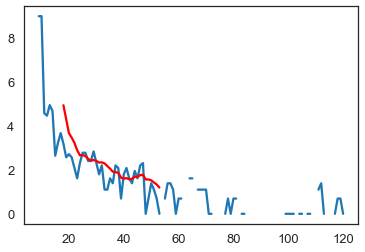

kca


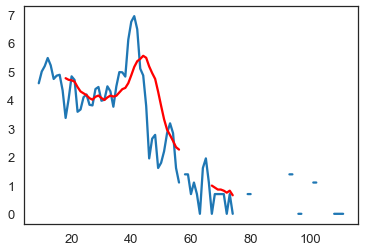

sagittarius


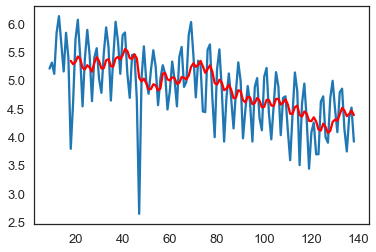

throwbackthursday


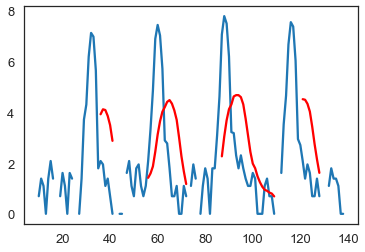

virgos


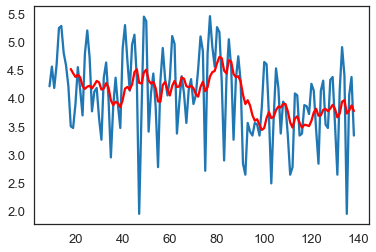

nf


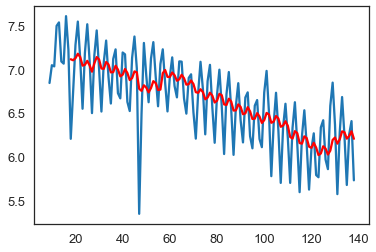

imsinglebecause


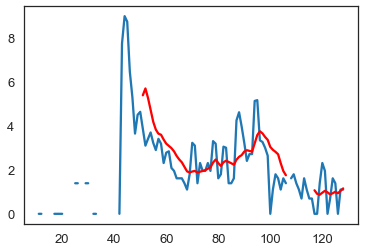

np


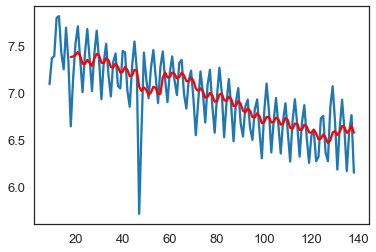

nw


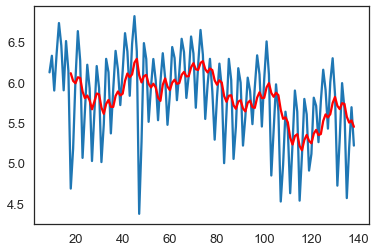

itscutewhen


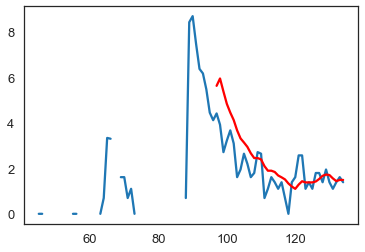

justsaying


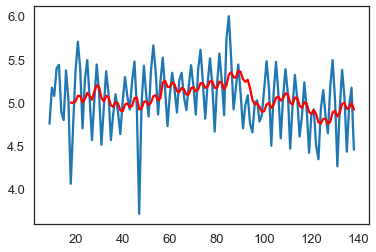

thingsmostpeoplelikebutidont


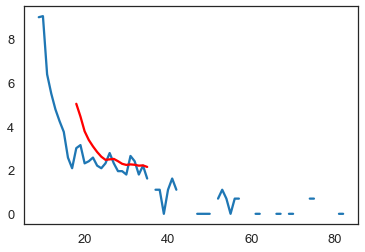

teamiphone


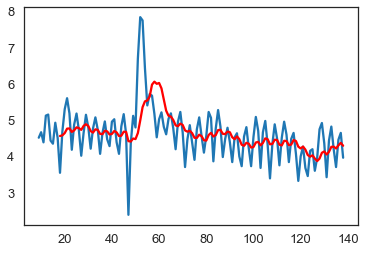

20thingsilove


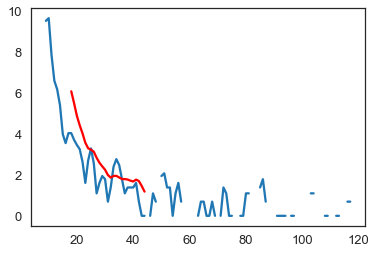

fb


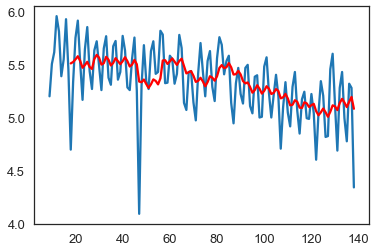

10factsaboutme


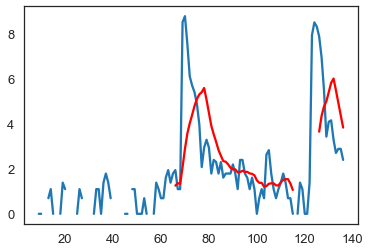

ff


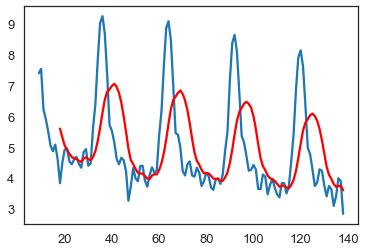

shoutout


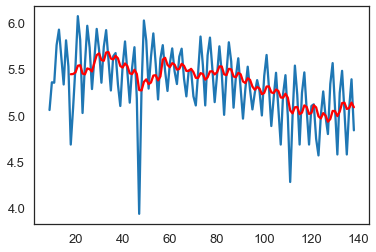

fact


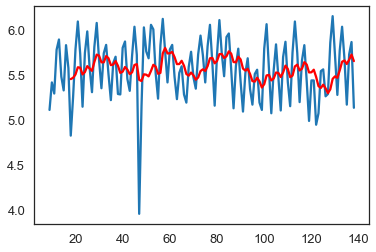

In [17]:
from statsmodels.tsa.arima_model import ARMA
from random import random
# contrived dataset
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    data = pd.Series(df[0][indx])
    ts_log = (np.log(pd.Series(data)))
    moving_avg = ts_log.rolling(10).mean()
    plt.plot(ts_log)
    plt.plot(moving_avg, color='red')
    plt.show()

# ARIMA

Auto Regressive Integrated Moving Average.

"Explains" a given time series based on its own past values, that is, its own lags and the lagged forecast errors, so that equation can be used to forecast future values.

Any ‘non-seasonal’ time series that exhibits patterns and is not a random white noise can be modeled with ARIMA models.
So I'll drop few hashtags that 'look' seasonal, (or maybe have a look on the result anyway) and continue the model

ARIMA Basically use both equations of AR and MA to calculate current Y_{t} by first calculating errors then calculating the needed function Y.

Stationarity:

Stationarity is a property of a time series. A stationary series is one where the values of the series is not a function of time.

That is, the statistical properties of the series like mean, variance and autocorrelation are constant over time. 

ARIMA is charectrized by the following:
p is the order of the AR term


q is the order of the MA term


d is the number of differencing required to make the time series stationary, were differencing is: If:

Y_t is the value at time ‘t’, then the first difference of Y = Yt – Yt-1. >>>>>> Differencing helps making the timeseries stationary.

walk forward model:

500aday
Test RMSE: 8.643


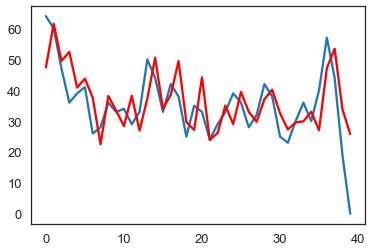

gnation
Test RMSE: 2.857


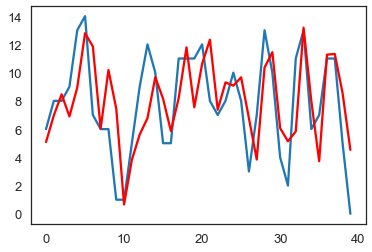

random
Test RMSE: 20.493


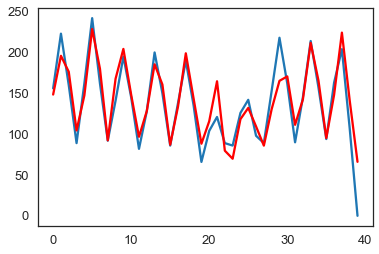

mythoughtsduringschool
Test RMSE: 0.930


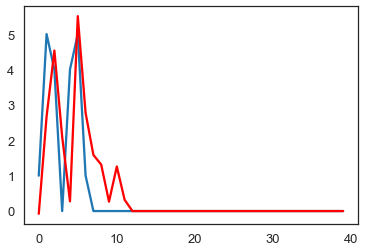

follow
Test RMSE: 16.236


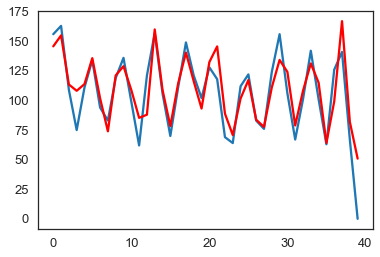

swag
Test RMSE: 12.816


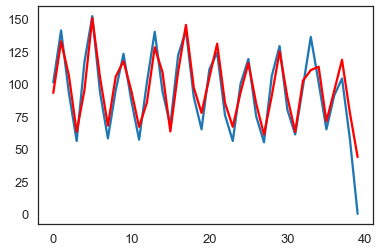

scorpio
Test RMSE: 26.807


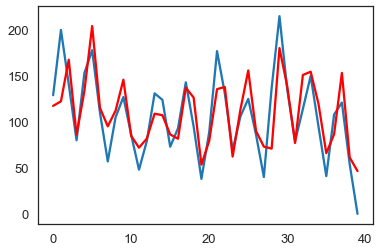

twitterpeopleilove
LinAlgError: SVD did not converge
winning
Test RMSE: 45.658


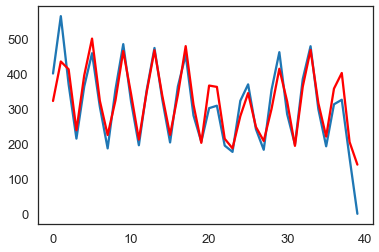

virgo
Test RMSE: 18.387


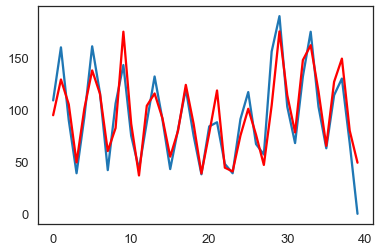

lt
Test RMSE: 20.261


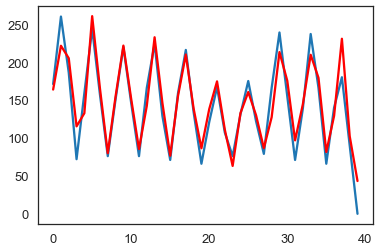

libra
Test RMSE: 45.665


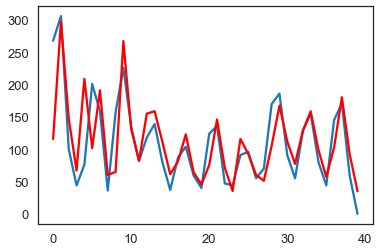

sorrynotsorry
Test RMSE: 27.957


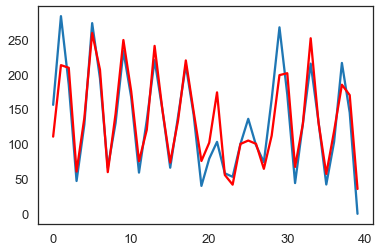

bahrain
Test RMSE: 7.507


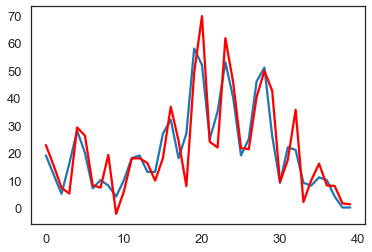

followback
Test RMSE: 23.761


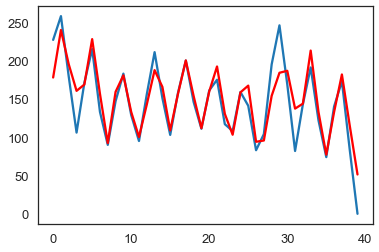

yougetpointsif
Test RMSE: 0.000


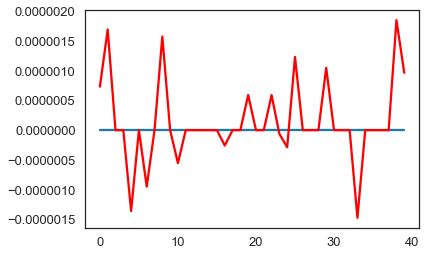

tbt
Test RMSE: 227.304


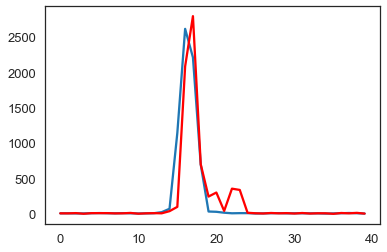

yougetmajorpointsif
Test RMSE: 0.000


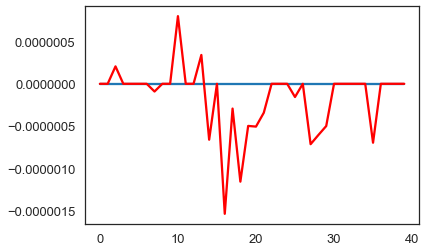

lrt
Test RMSE: 28.976


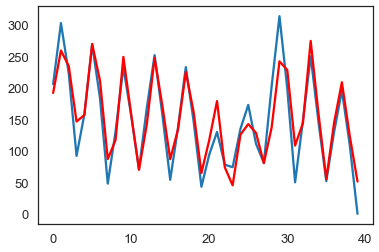

libras
Test RMSE: 36.928


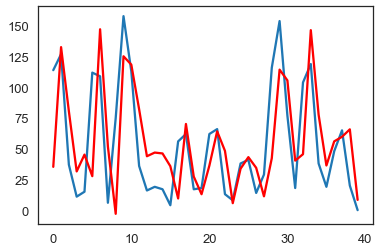

trayvonmartin
Test RMSE: 5.692


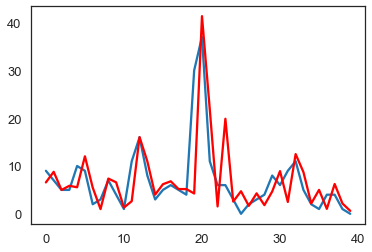

aquarians
Test RMSE: 23.892


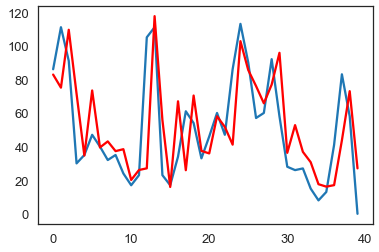

oomfs
Test RMSE: 16.241


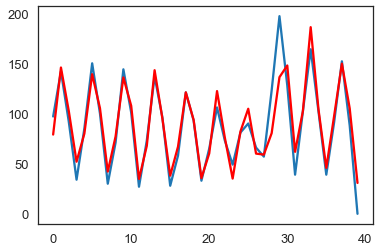

nfb
Test RMSE: 25.494


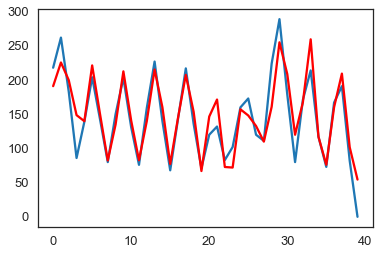

dailytweet
Test RMSE: 31.626


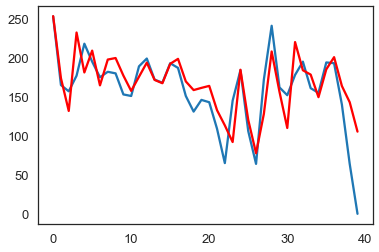

youknowwhatsannoying
Test RMSE: 0.000


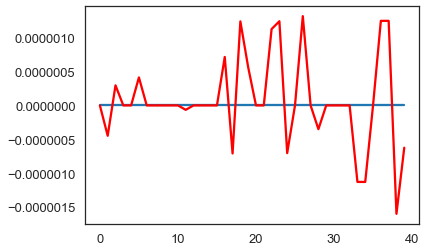

capricorn
Test RMSE: 20.502


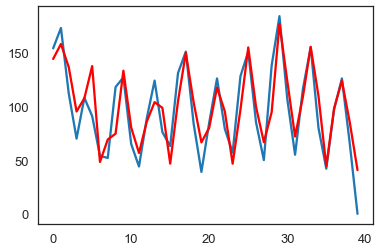

truth
Test RMSE: 27.361


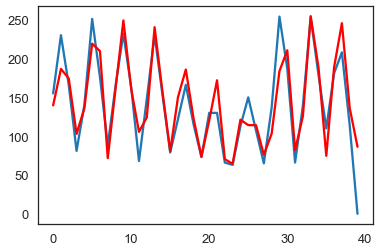

instagram
Test RMSE: 16.891


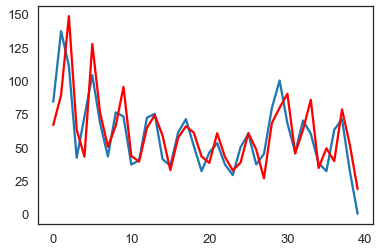

yolo
Test RMSE: 52.925


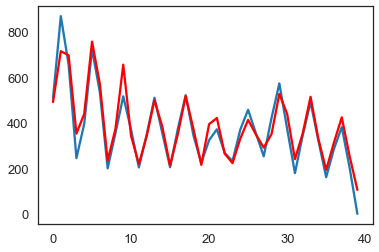

dead
Test RMSE: 24.411


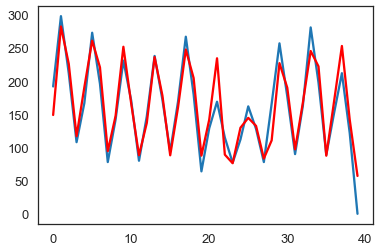

10thingsthatilike
Test RMSE: 0.000


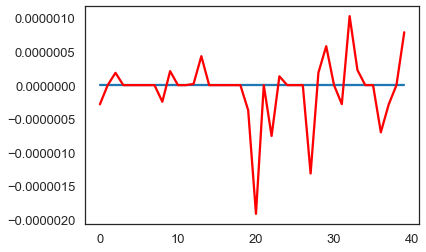

goodnight
Test RMSE: 36.184


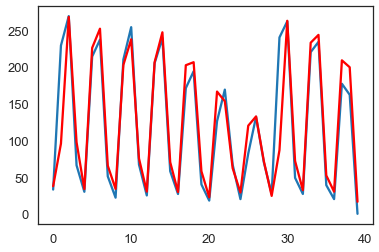

pisces
Test RMSE: 18.497


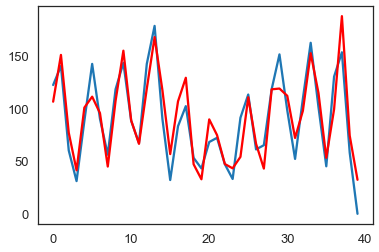

ifitwasuptome
Test RMSE: 1.686


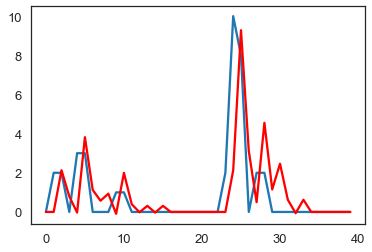

10thingsihate
Test RMSE: 6.431


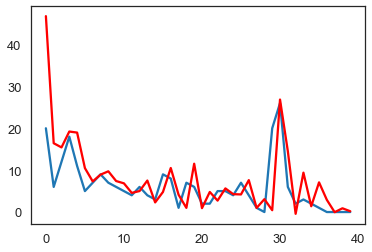

retweet
Test RMSE: 59.779


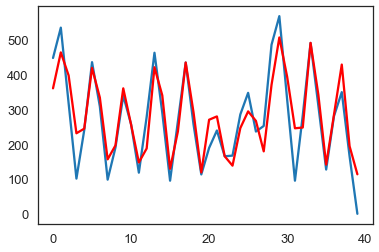

icantstandwhen
Test RMSE: 0.352


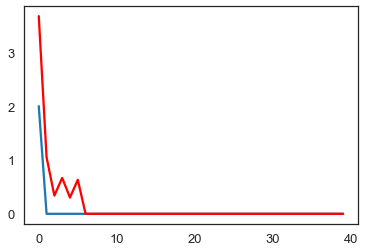

rt
Test RMSE: 67.649


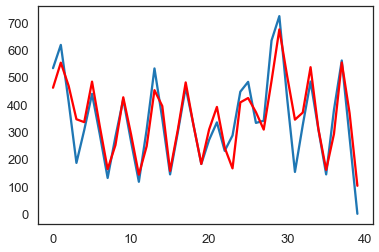

wheniwaslittle
Test RMSE: 3.266


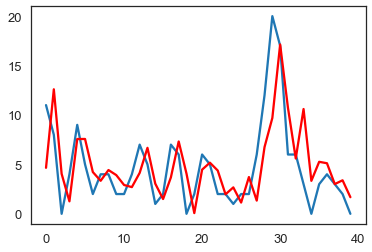

smh
Test RMSE: 25.626


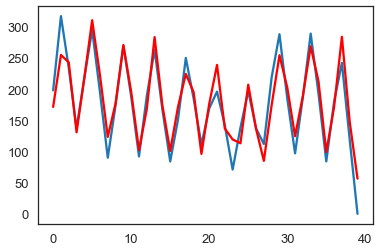

moviesthatnevergetold
Test RMSE: 1.094


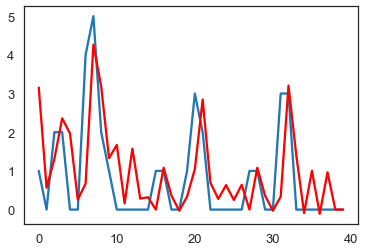

tweegram
Test RMSE: 14.927


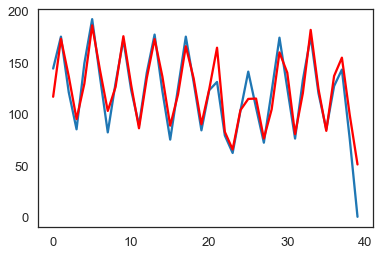

salute
Test RMSE: 20.593


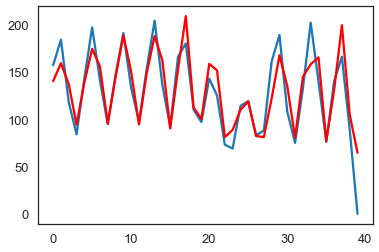

oomf
Test RMSE: 178.199


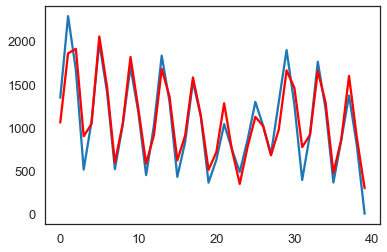

tcot
Test RMSE: 2.675


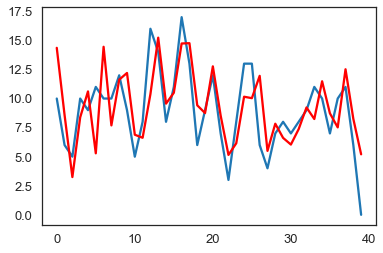

nationalbestfriendday
Test RMSE: 0.000


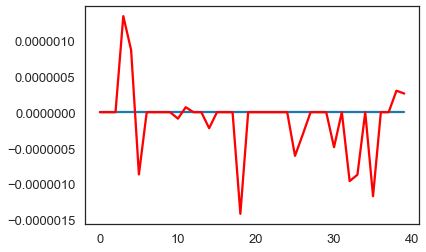

aquarius
Test RMSE: 36.518


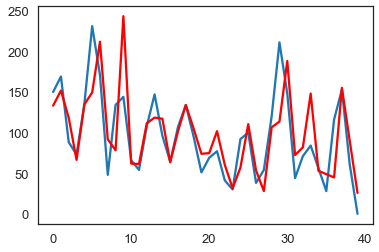

free
Test RMSE: 11.417


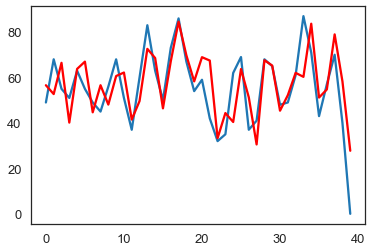

leo
Test RMSE: 22.746


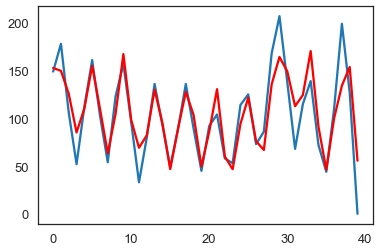

taurus
Test RMSE: 25.894


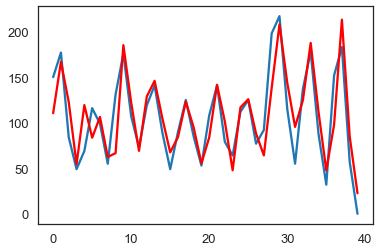

wtf
Test RMSE: 17.434


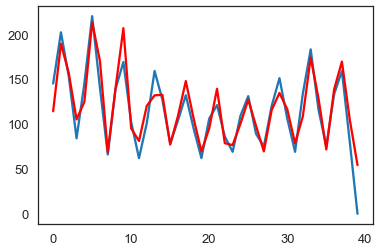

imagine
Test RMSE: 10.778


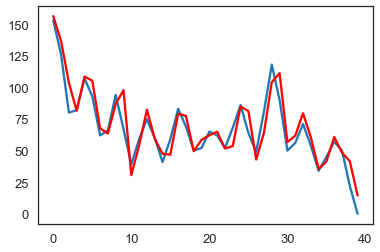

1dfact
Test RMSE: 6.153


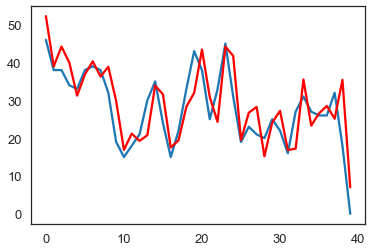

thingsigetalot
Test RMSE: 0.000


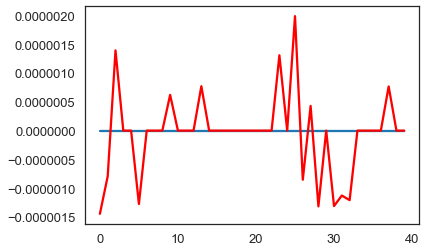

nowplaying
Test RMSE: 21.189


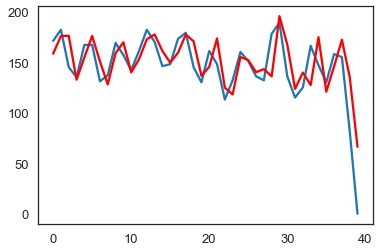

thingsisaywhilereadingmytl
Test RMSE: 0.000


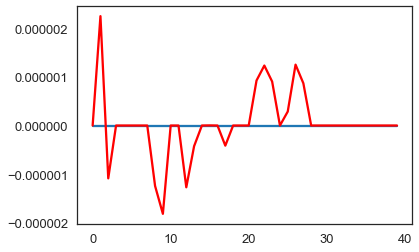

nowfollowing
Test RMSE: 15.943


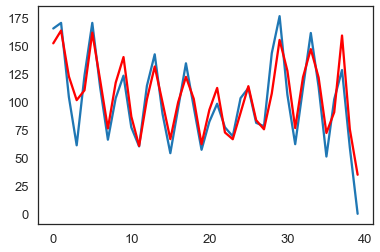

syria


/home/mariam/anaconda2/lib/python2.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Test RMSE: 3.025


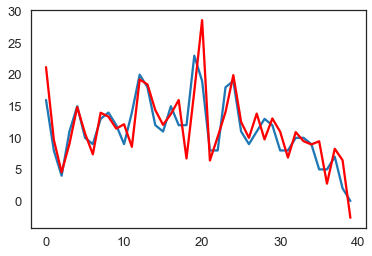

top100lies
Test RMSE: 0.000


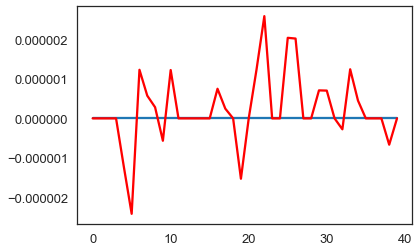

love
Test RMSE: 15.303


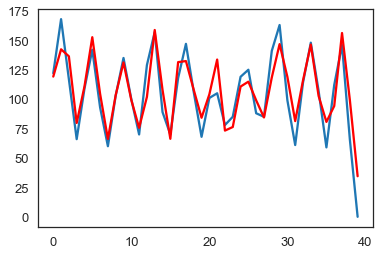

cancer
Test RMSE: 28.713


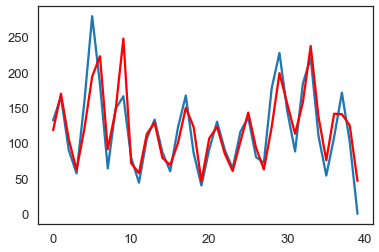

dearoomf
Test RMSE: 8.364


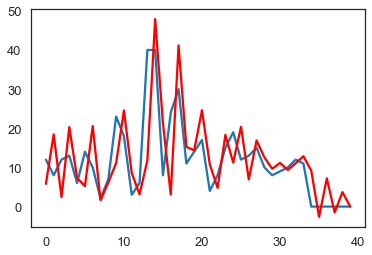

blessed
Test RMSE: 34.153


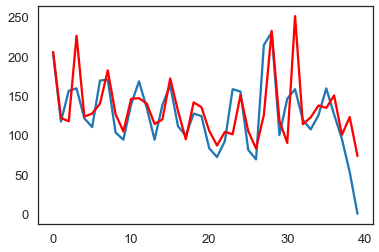

thoughtsduringschool
Test RMSE: 3.946


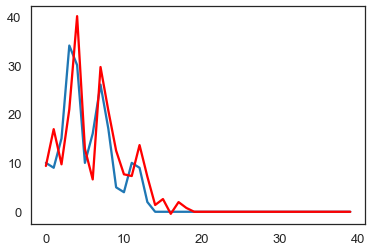

imhappywhen
LinAlgError: SVD did not converge
truthis
Test RMSE: 9.133


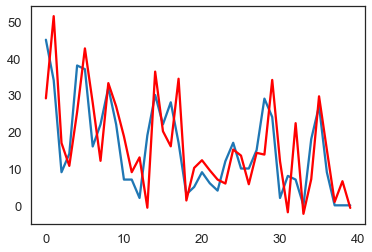

lol
Test RMSE: 16.928


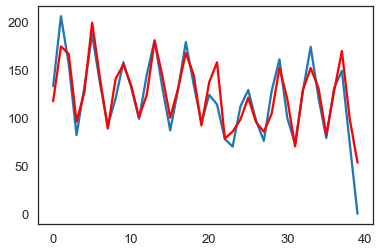

fml
Test RMSE: 24.925


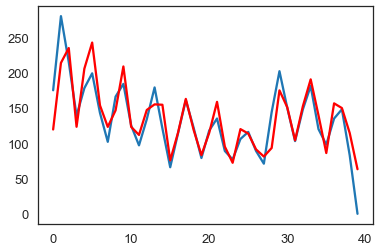

aries
Test RMSE: 20.134


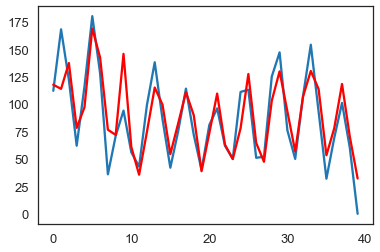

realshit
Test RMSE: 23.555


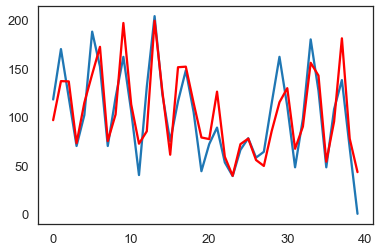

confessionhour
Test RMSE: 4.494


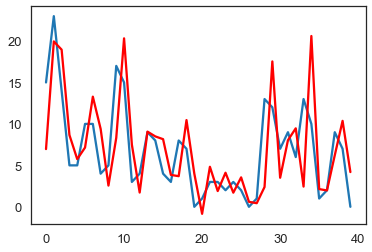

iadmit
LinAlgError: SVD did not converge
realtalk
Test RMSE: 25.771


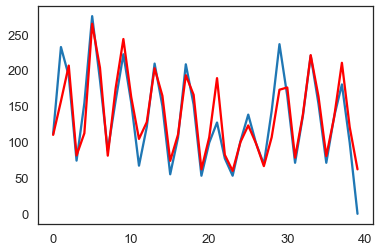

subtweet
Test RMSE: 24.291


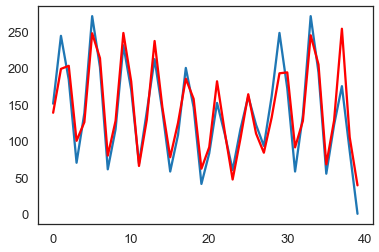

tfb
Test RMSE: 11.914


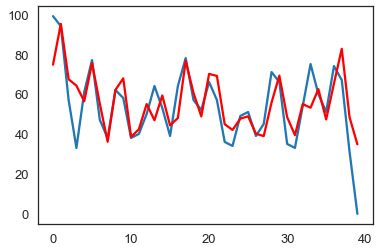

bgc
Test RMSE: 373.826


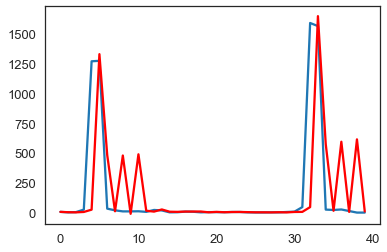

theworstfeeling
Test RMSE: 3.764


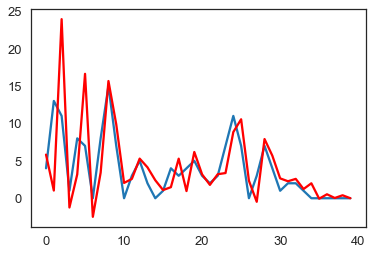

believe
Test RMSE: 57.930


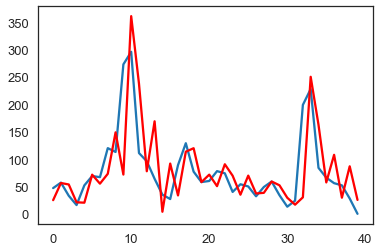

boyfriend
Test RMSE: 27.954


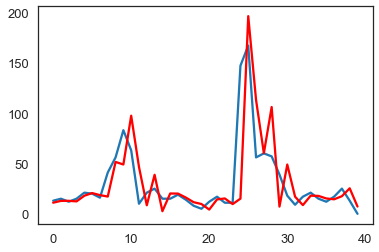

p2
Test RMSE: 3.153


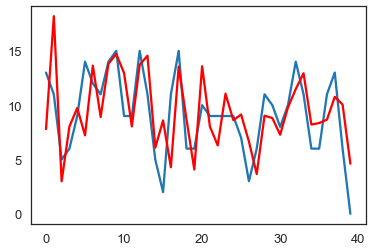

inourgeneration
Test RMSE: 1.929


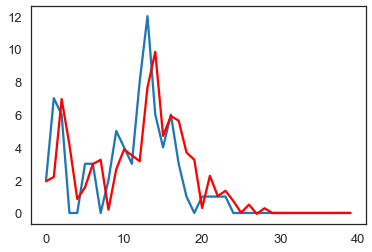

teamfollowback
Test RMSE: 33.977


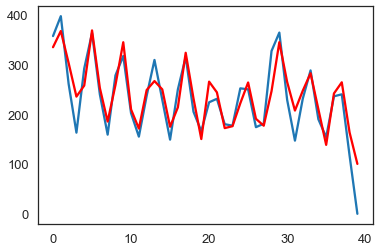

10thingsifindattractive
Test RMSE: 2.790


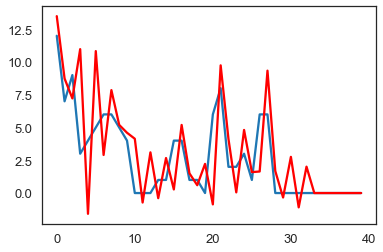

cancers
Test RMSE: 22.337


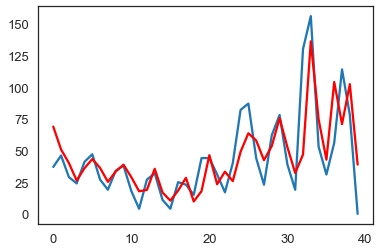

mybiggestproblem
Test RMSE: 1.202


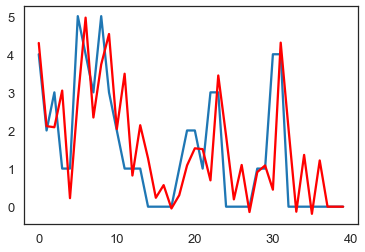

f1
Test RMSE: 20.546


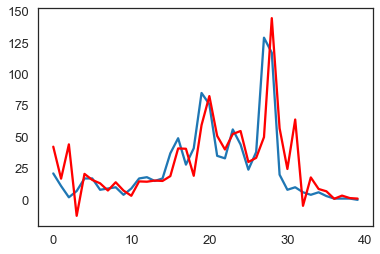

wewontworkoutif
Test RMSE: 0.000


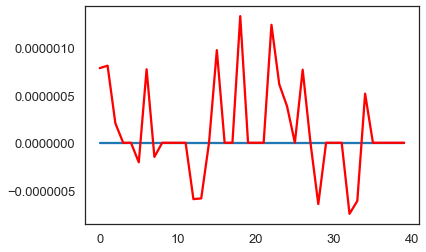

middleschoolmemories
Test RMSE: 3.461


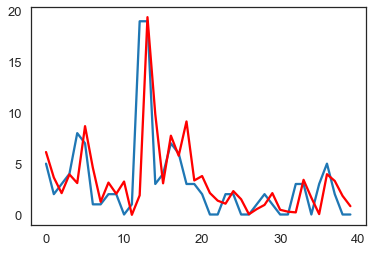

gemini
Test RMSE: 26.579


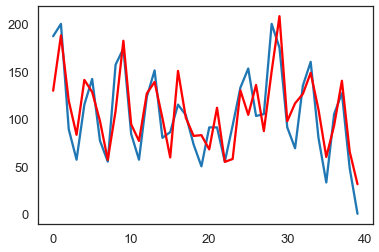

thatirritatesme
Test RMSE: 0.648


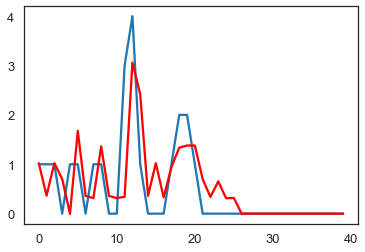

kca
Test RMSE: 0.839


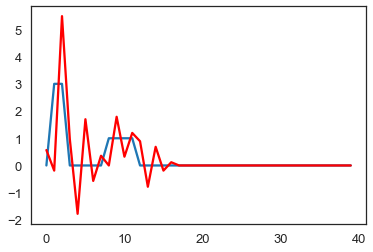

sagittarius
Test RMSE: 25.902


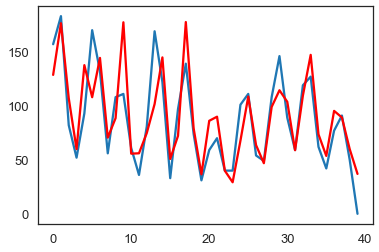

throwbackthursday
Test RMSE: 188.652


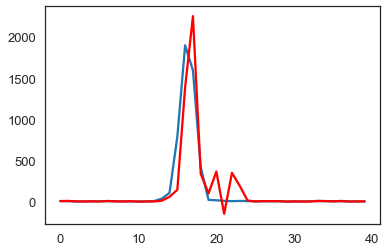

virgos
Test RMSE: 20.100


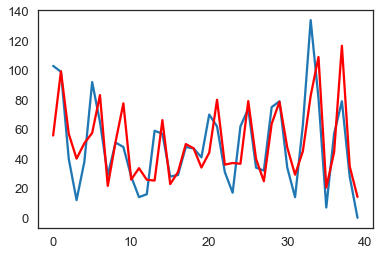

nf
Test RMSE: 83.549


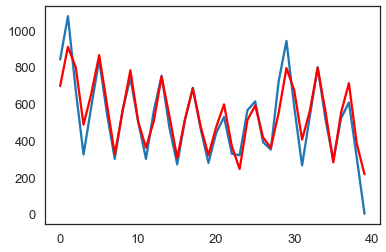

imsinglebecause
Test RMSE: 10.674


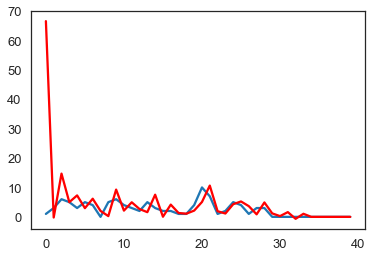

np
Test RMSE: 92.559


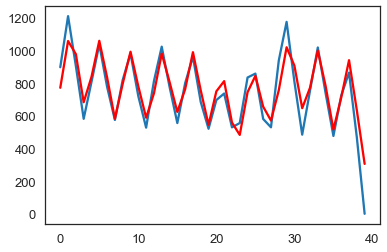

nw
Test RMSE: 49.690


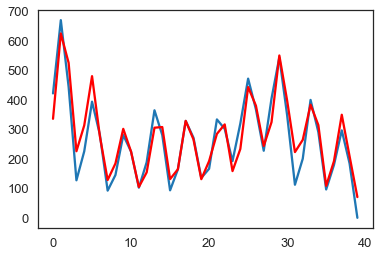

itscutewhen
Test RMSE: 5.870


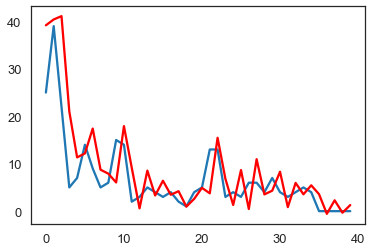

justsaying
Test RMSE: 23.639


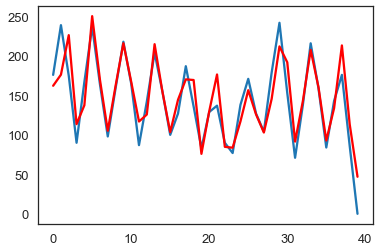

thingsmostpeoplelikebutidont
Test RMSE: 0.000


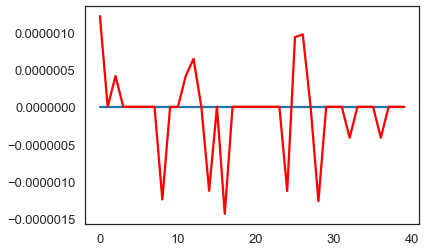

teamiphone
Test RMSE: 25.127


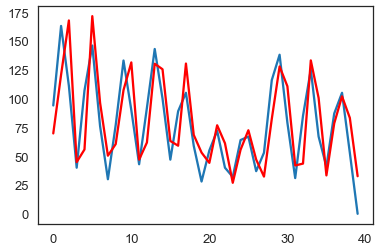

20thingsilove
Test RMSE: 0.711


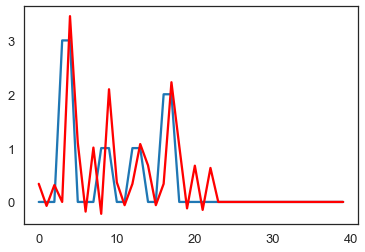

fb
Test RMSE: 25.707


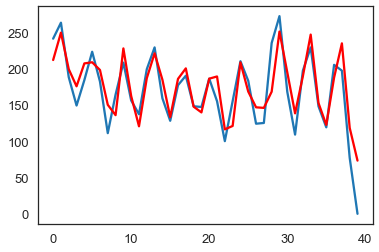

10factsaboutme
Test RMSE: 583.897


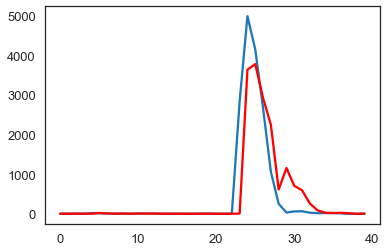

ff
Test RMSE: 247.439


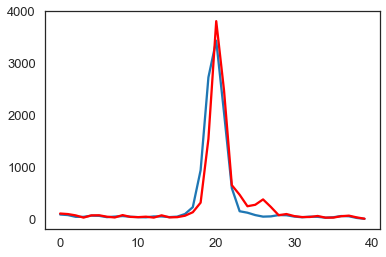

shoutout
Test RMSE: 25.392


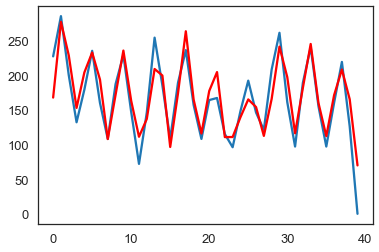

fact
Test RMSE: 46.607


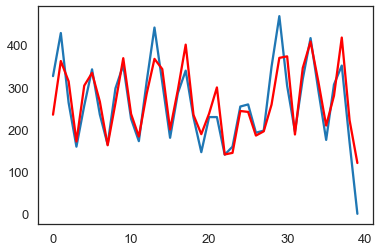

In [15]:
from pandas import read_csv
from pandas import datetime
from matplotlib import pyplot
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
# load dataset
high_err_tag = []
for i in Data_rt:
    try:
        print(i)
        def parser(x):
            return datetime.strptime('190'+x, '%Y-%m')
        indx = list(Data_rt).index(i)
        series = pd.Series(df[0][indx])
        X = series.values
        train, test = X[0:-40], X[-40:]
        history = [x for x in train]
        predictions = list()
# walk-forward validation
        for t in range(0,len(test)):
# fit model
            model = ARIMA(history, order=(4,1,0))
            model_fit = model.fit()
# one step forecast
            yhat = model_fit.forecast()[0]
# store forecast and ob
            predictions.append(yhat)
            history.append(test[t])
# evaluate forecasts
        rmse = sqrt(mean_squared_error(test, predictions))
        print('Test RMSE: %.3f' % rmse)
        if rmse >20:
            high_err_tag.append((i,rmse))
        
# plot forecasts against actual outcomes
        pyplot.plot(test)
        pyplot.plot(predictions, color='red')
        pyplot.show()
    except:
        print('LinAlgError: SVD did not converge')
        pass

In [16]:
len(high_err_tag)

54

In [17]:
# maybe 20% error is not too high let's try for 30%
trial =[]
for i in range(0,len(np.array(high_err_tag))):
    if float(np.array(high_err_tag)[i][1])>30:
               trial.append(np.array(high_err_tag)[i])

Now I will try to trat seasonality with differecing seasonality for Hashtags in trial>>> Error larger than 30%

In [51]:
###################DIFFERENCING######################
tags = np.array(trial).T[0]
diff = []
data = []
for i in tags:
    #print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    #apply differencing
    X = series.values
    for j in range(0, len(X)):
        value = X[j] - X[j - 8]
        diff.append(np.abs(value))
    data.append(np.array(diff))
    #pyplot.plot(diff)
    #pyplot.show()

Retry ARIMA Model with the difference Data:

winning
Test RMSE: 51.052


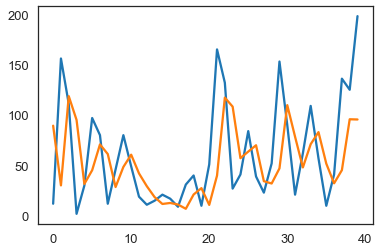

libra
Test RMSE: 46.721


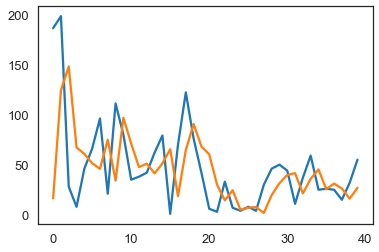

tbt
Test RMSE: 348.079


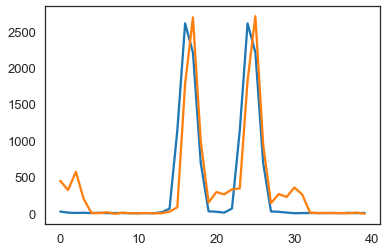

libras
Test RMSE: 46.894


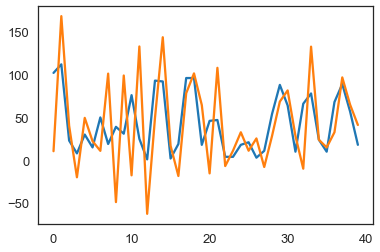

dailytweet
Test RMSE: 79.916


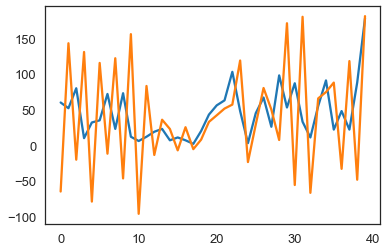

yolo
Test RMSE: 95.505


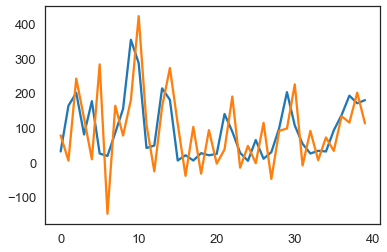

goodnight
Test RMSE: 50.262


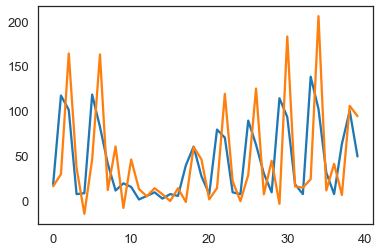

retweet
Test RMSE: 81.773


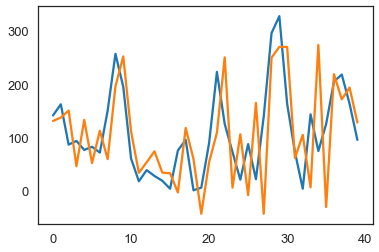

rt
Test RMSE: 77.233


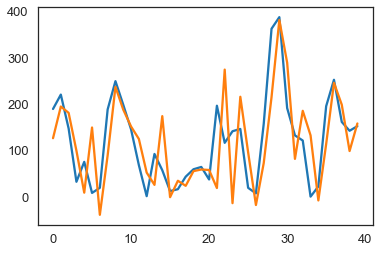

oomf
Test RMSE: 219.759


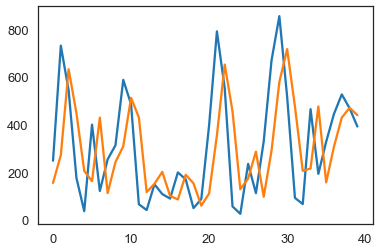

aquarius
Test RMSE: 35.396


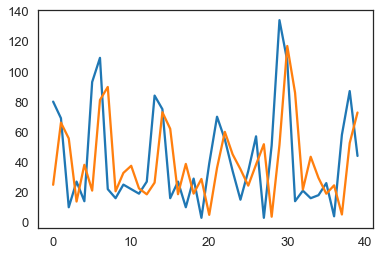

blessed
Test RMSE: 44.150


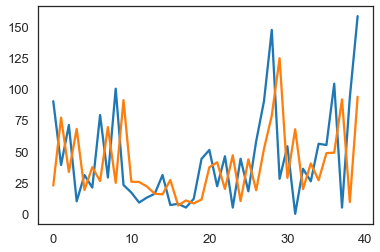

bgc
Test RMSE: 470.884


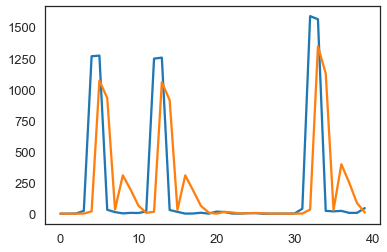

believe
Test RMSE: 60.421


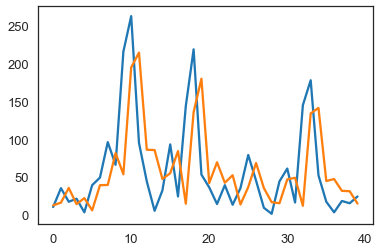

teamfollowback
Test RMSE: 32.994


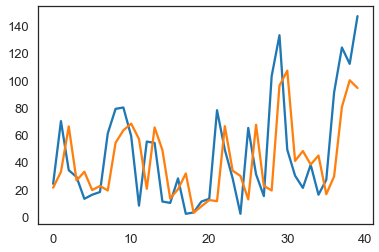

throwbackthursday
Test RMSE: 391.740


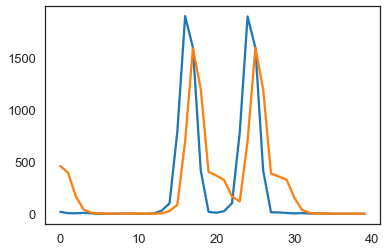

nf
Test RMSE: 84.170


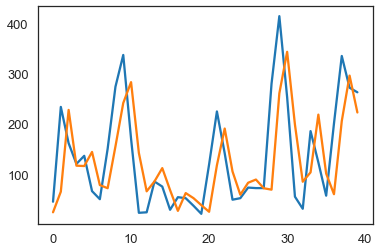

np
Test RMSE: 98.030


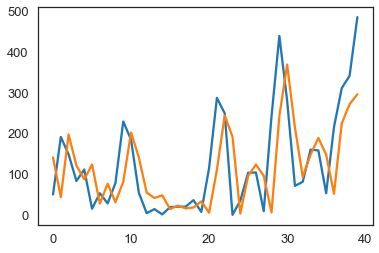

nw
Test RMSE: 68.859


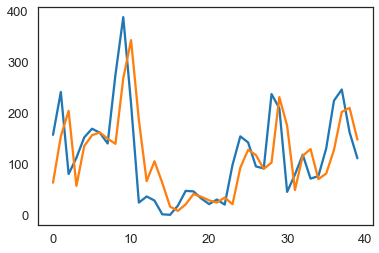

10factsaboutme
Test RMSE: 902.925


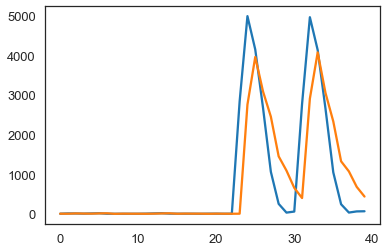

ff
Test RMSE: 591.951


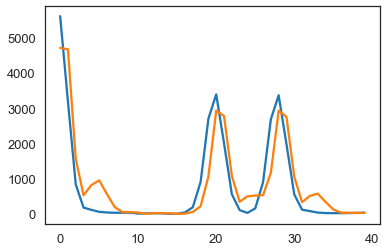

fact
Test RMSE: 53.862


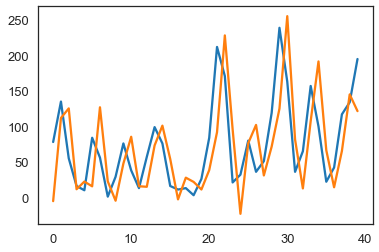

In [50]:
for i in tags:
    print(i)
    inx = list(tags).index(i)
    def parser(x):
        return datetime.strptime('190'+x, '%Y-%m')
    series = pd.Series(data[inx])
    X = series.values
    train, test = X[0:-40], X[-40:]
    history = [x for x in train]
    predictions = list()
# walk-forward validation
    for t in range(0,len(test)):
# fit model
        model = ARIMA(history, order=(4,1,0))
        model_fit = model.fit()
# one step forecast
        yhat = model_fit.forecast()[0]
# store forecast and ob
        predictions.append(yhat)
        history.append(test[t])
# evaluate forecasts
    rmse = sqrt(mean_squared_error(test, predictions))
    print('Test RMSE: %.3f' % rmse)
    plt.plot(test)
    plt.plot(predictions)
    plt.show()

It seems that the seasonality is not very well treated with differencing, and maybe the whole issue is in the mosel, that's why I will Try Seasonal ARIMA:

# stationarity test

Now I'll Apply Stationarity Test to support my use od SARIMA:
AS Previously mentiones, Stationarity oppose seasonality.

In [11]:
def TestStationaryPlot(ts):
    rol_mean = ts.rolling(window = 12, center = False).mean()
    rol_std = ts.rolling(window = 12, center = False).std()
    
    plt.plot(ts, color = 'blue',label = 'Original Data')
    plt.plot(rol_mean, color = 'red', label = 'Rolling Mean')
    plt.plot(rol_std, color ='black', label = 'Rolling Std')
    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)
    
    plt.xlabel('Time in Years', fontsize = 15)
    plt.ylabel('Total Emissions', fontsize = 15)
    plt.legend(loc='best', fontsize = 15)
    plt.title('Rolling Mean & Standard Deviation', fontsize = 15)
    plt.show(block= True)

500aday


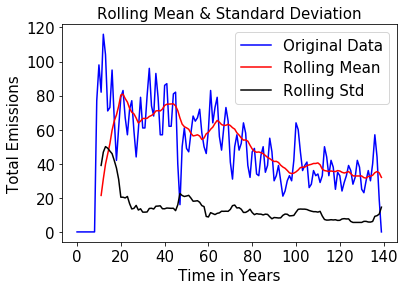

Test Statistic                  -1.293187
p-value                          0.632284
#Lags Used                      10.000000
Number of Observations Used    129.000000
Critical Value (5%)             -2.884219
Critical Value (1%)             -3.482088
Critical Value (10%)            -2.578864
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
gnation


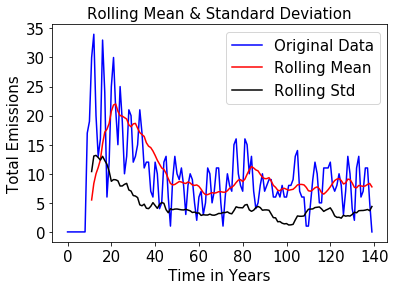

Test Statistic                  -2.271527
p-value                          0.181316
#Lags Used                      12.000000
Number of Observations Used    127.000000
Critical Value (5%)             -2.884580
Critical Value (1%)             -3.482920
Critical Value (10%)            -2.579058
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
random


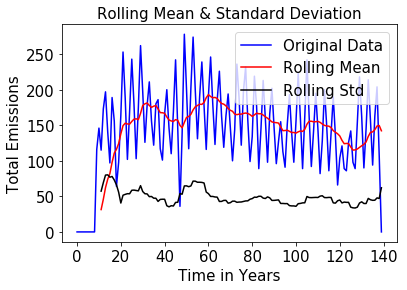

Test Statistic                  -2.858222
p-value                          0.050426
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
mythoughtsduringschool


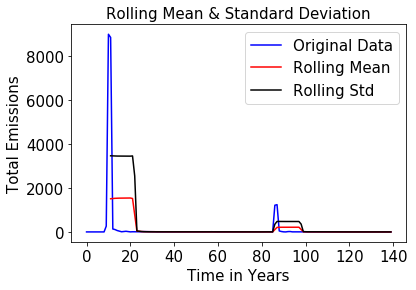

Test Statistic                  -5.179899
p-value                          0.000010
#Lags Used                       2.000000
Number of Observations Used    137.000000
Critical Value (5%)             -2.882878
Critical Value (1%)             -3.479007
Critical Value (10%)            -2.578149
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
follow


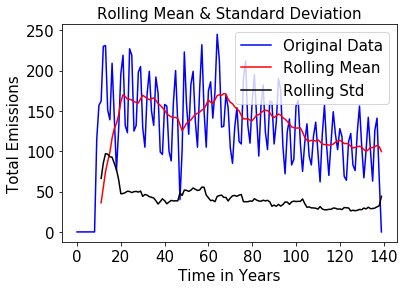

Test Statistic                  -3.898991
p-value                          0.002042
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
swag


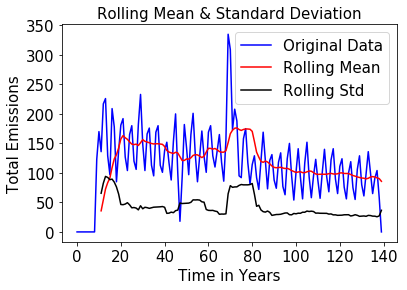

Test Statistic                  -2.478451
p-value                          0.120806
#Lags Used                      10.000000
Number of Observations Used    129.000000
Critical Value (5%)             -2.884219
Critical Value (1%)             -3.482088
Critical Value (10%)            -2.578864
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
scorpio


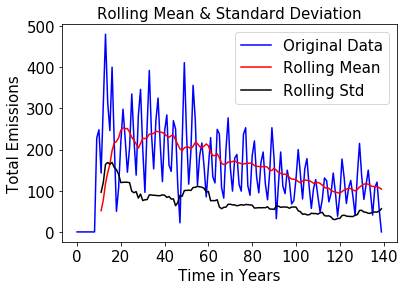

Test Statistic                  -1.809423
p-value                          0.375794
#Lags Used                      10.000000
Number of Observations Used    129.000000
Critical Value (5%)             -2.884219
Critical Value (1%)             -3.482088
Critical Value (10%)            -2.578864
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
twitterpeopleilove


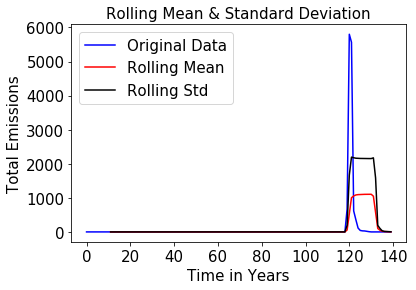

Test Statistic                  -4.534712
p-value                          0.000170
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
winning


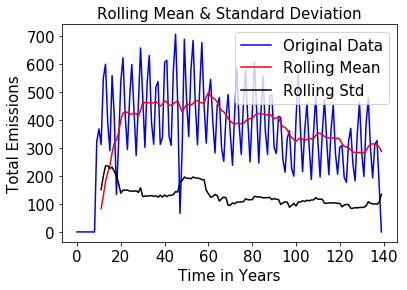

Test Statistic                  -0.607300
p-value                          0.869324
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
virgo


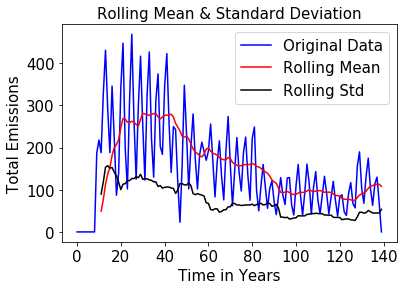

Test Statistic                  -1.432903
p-value                          0.566404
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
lt


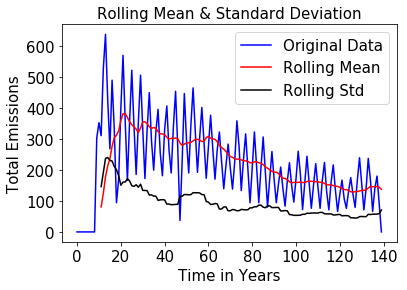

Test Statistic                  -1.268771
p-value                          0.643336
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
libra


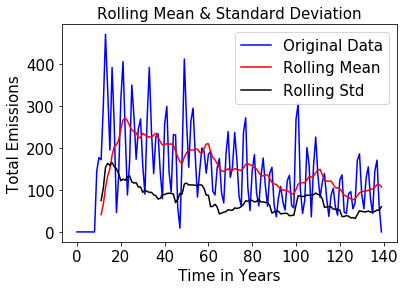

Test Statistic                  -2.394485
p-value                          0.143299
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
sorrynotsorry


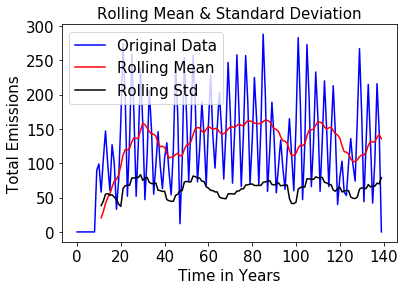

Test Statistic                  -3.561427
p-value                          0.006543
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
bahrain


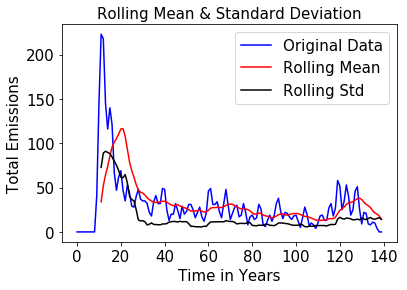

Test Statistic                  -3.728114
p-value                          0.003735
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
followback


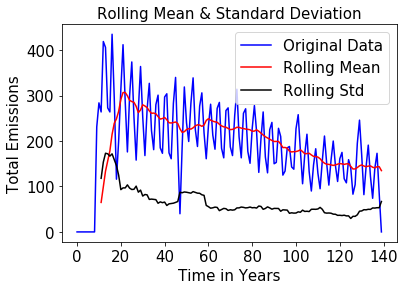

Test Statistic                  -1.175574
p-value                          0.684014
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
yougetpointsif


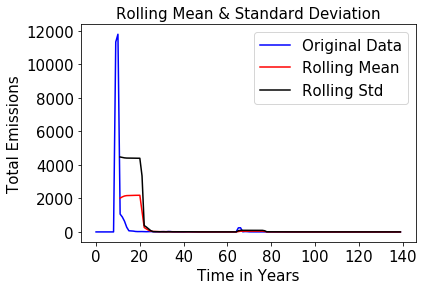

Test Statistic                  -5.507882
p-value                          0.000002
#Lags Used                       3.000000
Number of Observations Used    136.000000
Critical Value (5%)             -2.883037
Critical Value (1%)             -3.479372
Critical Value (10%)            -2.578234
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
tbt


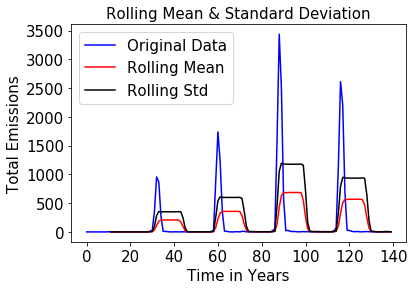

Test Statistic                  -4.130204
p-value                          0.000863
#Lags Used                       9.000000
Number of Observations Used    130.000000
Critical Value (5%)             -2.884042
Critical Value (1%)             -3.481682
Critical Value (10%)            -2.578770
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
yougetmajorpointsif


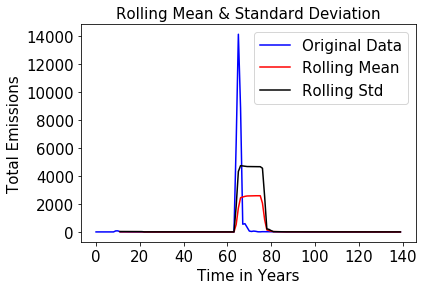

Test Statistic                  -3.881977
p-value                          0.002172
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
lrt


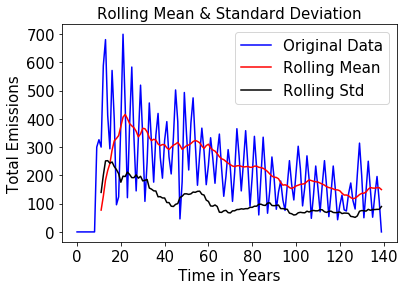

Test Statistic                  -1.613956
p-value                          0.475899
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
libras


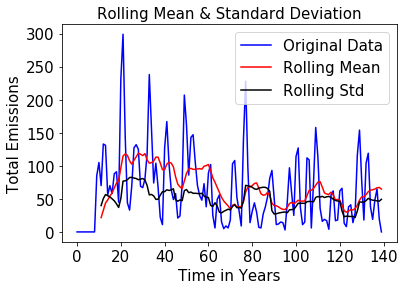

Test Statistic                  -3.192699
p-value                          0.020411
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
trayvonmartin


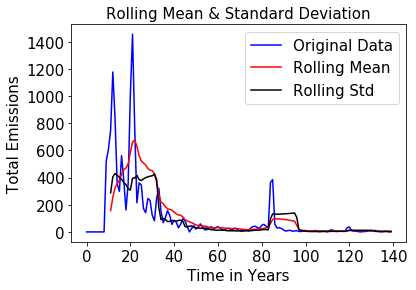

Test Statistic                  -3.214105
p-value                          0.019183
#Lags Used                      13.000000
Number of Observations Used    126.000000
Critical Value (5%)             -2.884766
Critical Value (1%)             -3.483346
Critical Value (10%)            -2.579156
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
aquarians


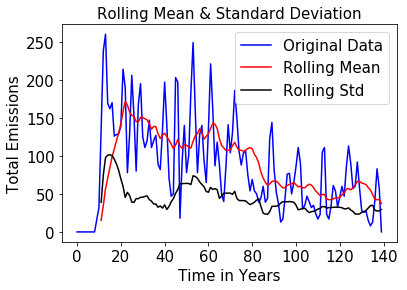

Test Statistic                  -2.378512
p-value                          0.147893
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
oomfs


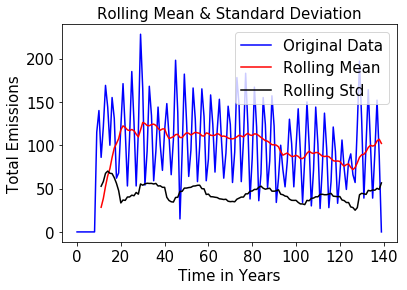

Test Statistic                  -2.702842
p-value                          0.073548
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
nfb


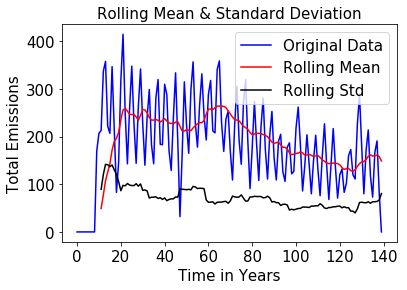

Test Statistic                  -1.614699
p-value                          0.475510
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
dailytweet


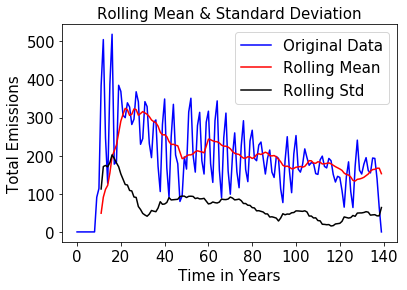

Test Statistic                  -1.764052
p-value                          0.398449
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
youknowwhatsannoying


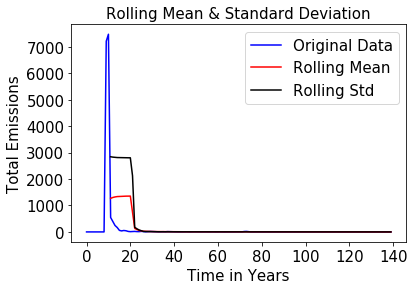

Test Statistic                  -4.904717
p-value                          0.000034
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
capricorn


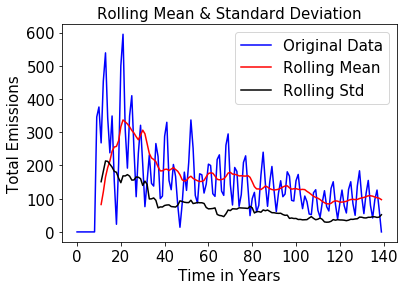

Test Statistic                  -1.913765
p-value                          0.325614
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
truth


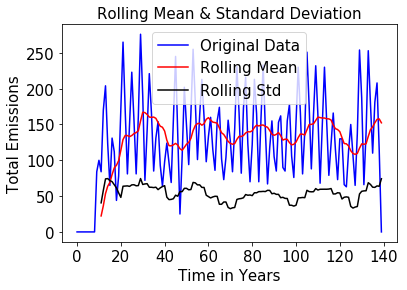

Test Statistic                  -4.502726
p-value                          0.000194
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
instagram


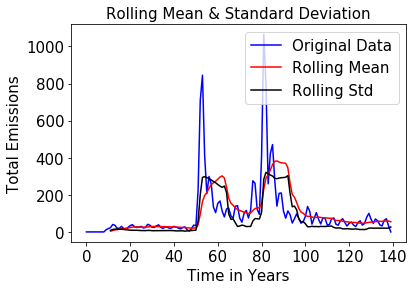

Test Statistic                  -3.187318
p-value                          0.020731
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
yolo


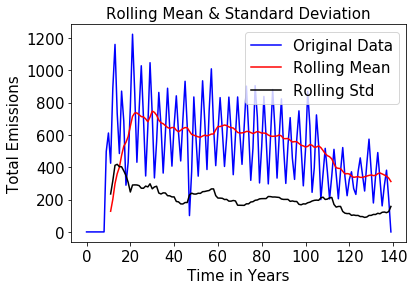

Test Statistic                  -1.547213
p-value                          0.510040
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
dead


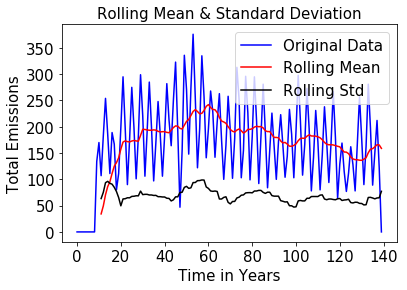

Test Statistic                  -2.930883
p-value                          0.041873
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
10thingsthatilike


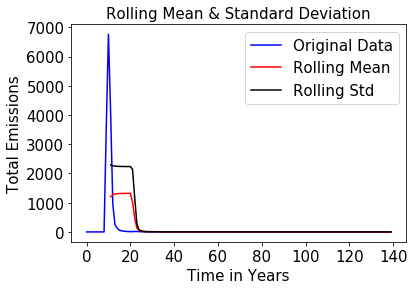

Test Statistic                -6.130738e+00
p-value                        8.414140e-08
#Lags Used                     1.300000e+01
Number of Observations Used    1.260000e+02
Critical Value (5%)           -2.884766e+00
Critical Value (1%)           -3.483346e+00
Critical Value (10%)          -2.579156e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
goodnight


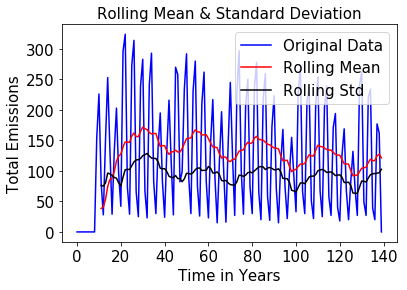

Test Statistic                  -3.698789
p-value                          0.004130
#Lags Used                       2.000000
Number of Observations Used    137.000000
Critical Value (5%)             -2.882878
Critical Value (1%)             -3.479007
Critical Value (10%)            -2.578149
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
pisces


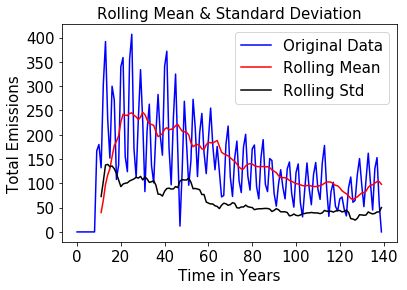

Test Statistic                  -0.898641
p-value                          0.788420
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
ifitwasuptome


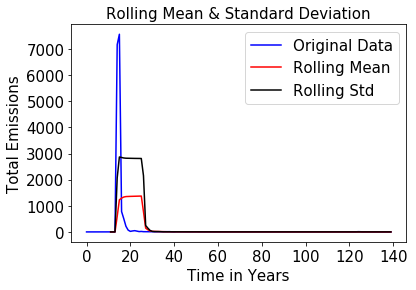

Test Statistic                -9.760057e+00
p-value                        7.605372e-17
#Lags Used                     1.400000e+01
Number of Observations Used    1.250000e+02
Critical Value (5%)           -2.884954e+00
Critical Value (1%)           -3.483779e+00
Critical Value (10%)          -2.579257e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
10thingsihate


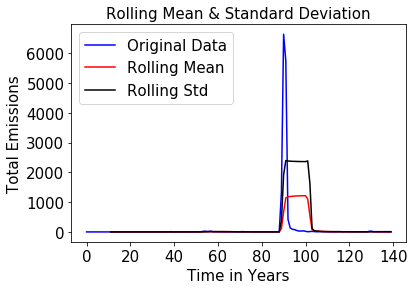

Test Statistic                  -3.931234
p-value                          0.001817
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
retweet


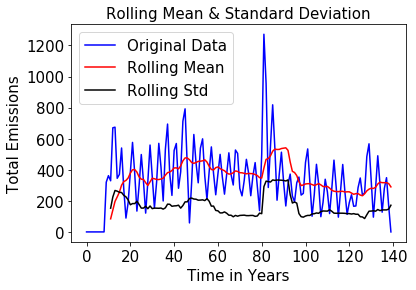

Test Statistic                  -3.623196
p-value                          0.005333
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
icantstandwhen


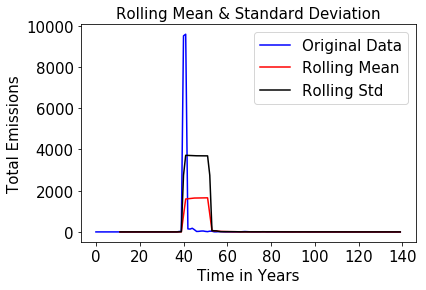

Test Statistic                  -4.674896
p-value                          0.000094
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
rt


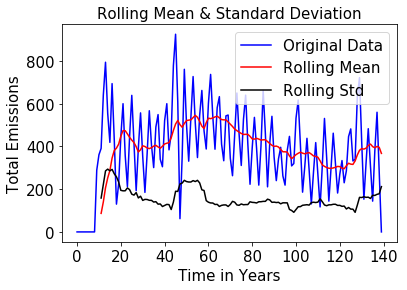

Test Statistic                  -2.784227
p-value                          0.060562
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
wheniwaslittle


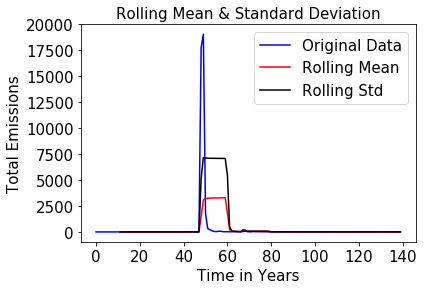

Test Statistic                  -4.660437
p-value                          0.000100
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
smh


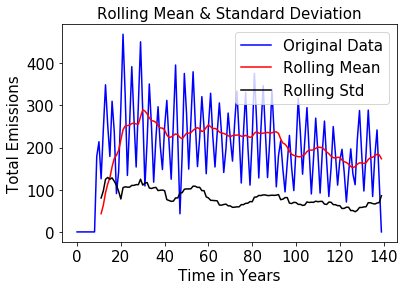

Test Statistic                  -2.850962
p-value                          0.051355
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
moviesthatnevergetold


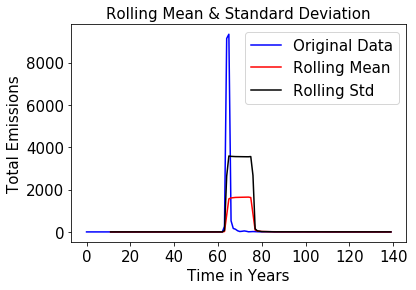

Test Statistic                  -4.651757
p-value                          0.000104
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
tweegram


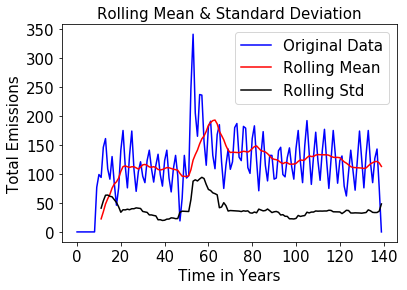

Test Statistic                  -2.930125
p-value                          0.041955
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
salute


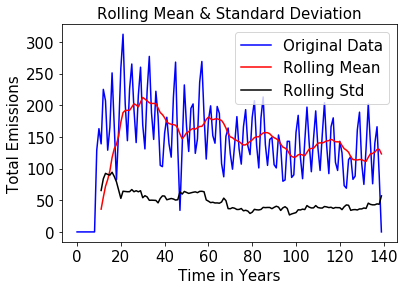

Test Statistic                  -2.386835
p-value                          0.145487
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
oomf


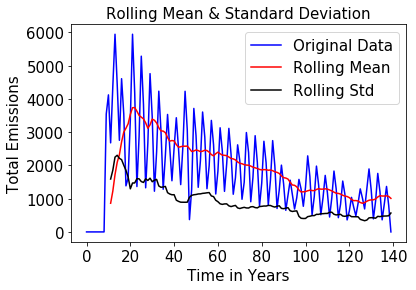

Test Statistic                  -1.220818
p-value                          0.664577
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
tcot


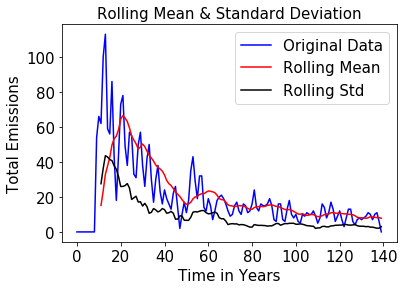

Test Statistic                  -1.890851
p-value                          0.336377
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
nationalbestfriendday


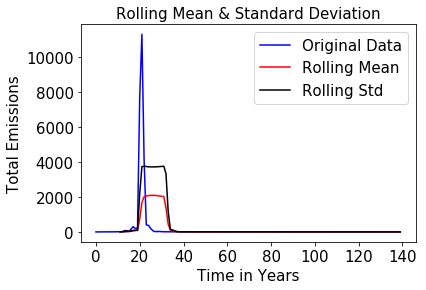

Test Statistic                  -3.881524
p-value                          0.002175
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
aquarius


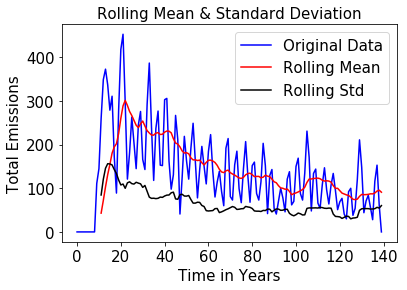

Test Statistic                  -1.861169
p-value                          0.350543
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
free


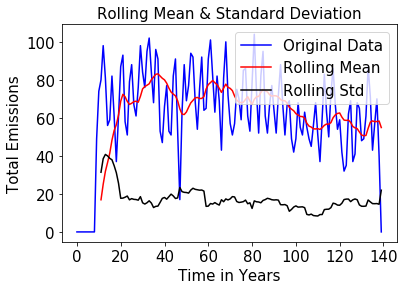

Test Statistic                  -4.338574
p-value                          0.000381
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
leo


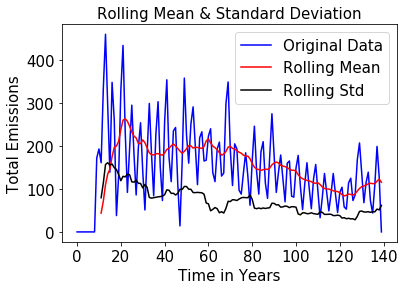

Test Statistic                  -2.315458
p-value                          0.167031
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
taurus


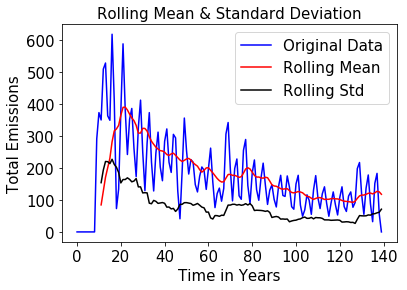

Test Statistic                  -1.893604
p-value                          0.335076
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
wtf


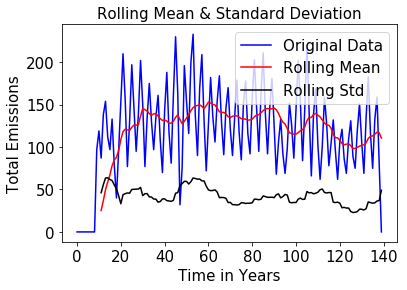

Test Statistic                  -3.015619
p-value                          0.033461
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
imagine


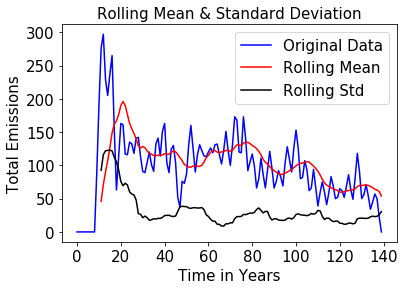

Test Statistic                  -1.608720
p-value                          0.479212
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
1dfact


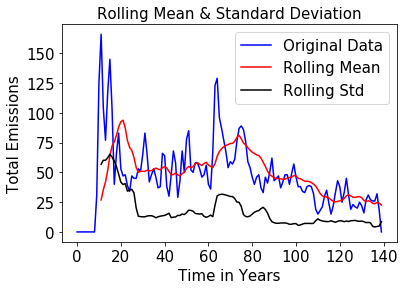

Test Statistic                  -3.418980
p-value                          0.010329
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
thingsigetalot


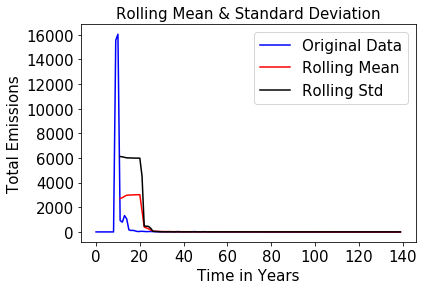

Test Statistic                  -4.619837
p-value                          0.000119
#Lags Used                      13.000000
Number of Observations Used    126.000000
Critical Value (5%)             -2.884766
Critical Value (1%)             -3.483346
Critical Value (10%)            -2.579156
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
nowplaying


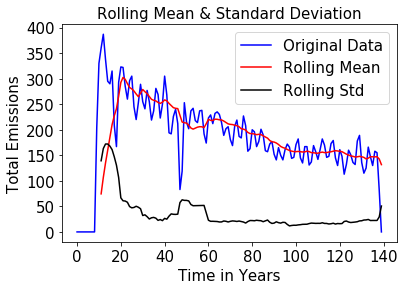

Test Statistic                  -0.447724
p-value                          0.901821
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
thingsisaywhilereadingmytl


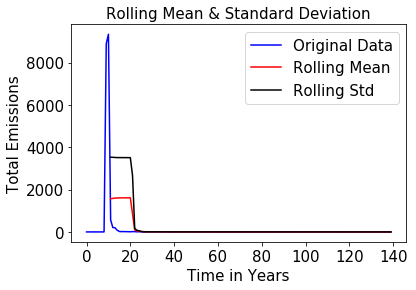

Test Statistic                  -4.035447
p-value                          0.001236
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
nowfollowing


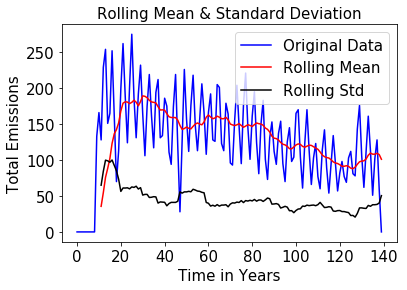

Test Statistic                  -1.474730
p-value                          0.545973
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
syria


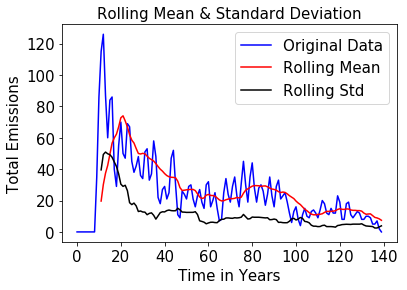

Test Statistic                  -1.821350
p-value                          0.369915
#Lags Used                       9.000000
Number of Observations Used    130.000000
Critical Value (5%)             -2.884042
Critical Value (1%)             -3.481682
Critical Value (10%)            -2.578770
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
top100lies


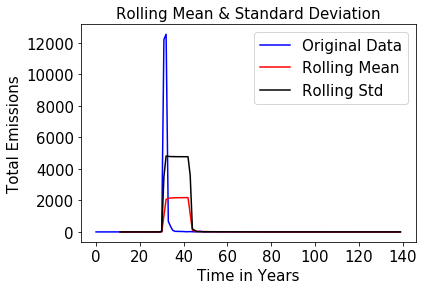

Test Statistic                  -4.665091
p-value                          0.000098
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
love


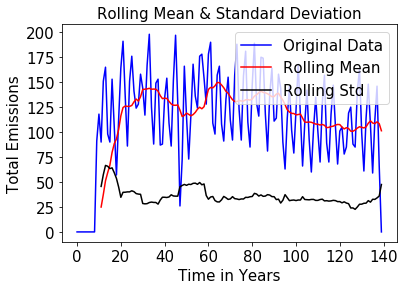

Test Statistic                  -2.663933
p-value                          0.080490
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
cancer


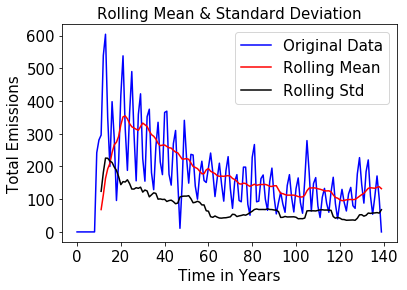

Test Statistic                  -1.746315
p-value                          0.407422
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
dearoomf


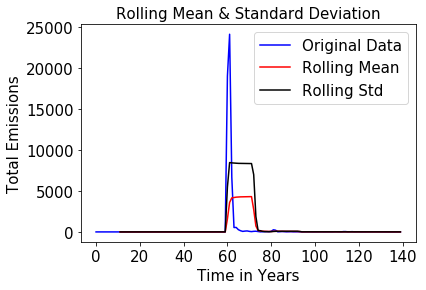

Test Statistic                  -3.680877
p-value                          0.004390
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
blessed


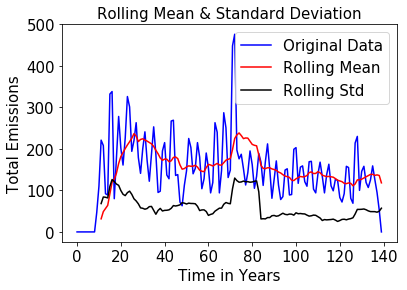

Test Statistic                  -3.203125
p-value                          0.019804
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
thoughtsduringschool


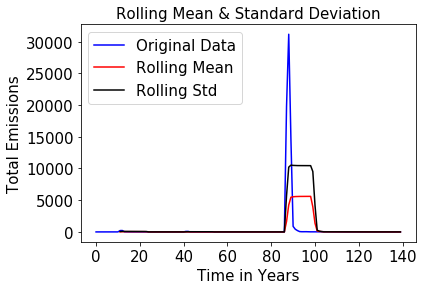

Test Statistic                  -3.664406
p-value                          0.004643
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
imhappywhen


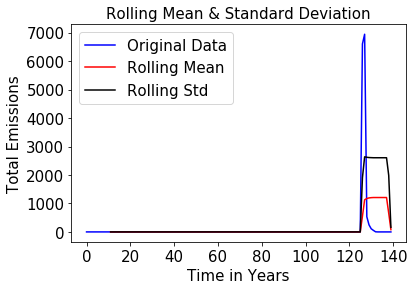

Test Statistic                  -0.016529
p-value                          0.957144
#Lags Used                      12.000000
Number of Observations Used    127.000000
Critical Value (5%)             -2.884580
Critical Value (1%)             -3.482920
Critical Value (10%)            -2.579058
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
truthis


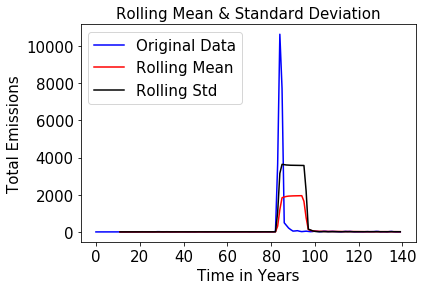

Test Statistic                  -3.893531
p-value                          0.002083
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
lol


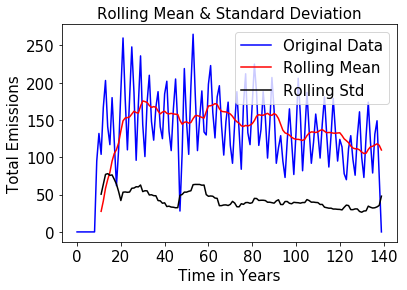

Test Statistic                  -2.783160
p-value                          0.060720
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
fml


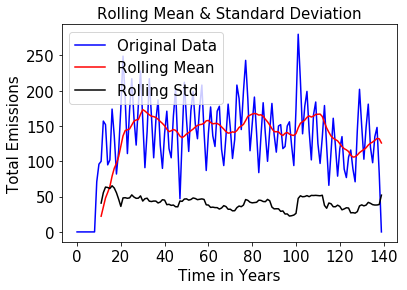

Test Statistic                  -3.128467
p-value                          0.024517
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
aries


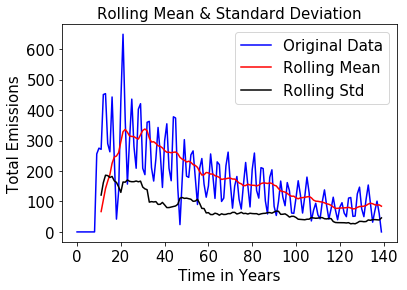

Test Statistic                  -1.209527
p-value                          0.669484
#Lags Used                      13.000000
Number of Observations Used    126.000000
Critical Value (5%)             -2.884766
Critical Value (1%)             -3.483346
Critical Value (10%)            -2.579156
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
realshit


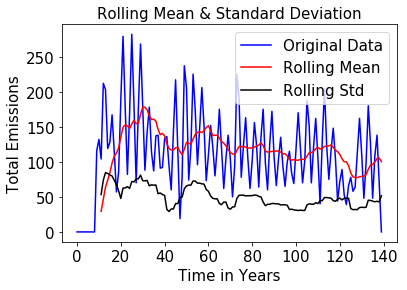

Test Statistic                  -3.690590
p-value                          0.004247
#Lags Used                       3.000000
Number of Observations Used    136.000000
Critical Value (5%)             -2.883037
Critical Value (1%)             -3.479372
Critical Value (10%)            -2.578234
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
confessionhour


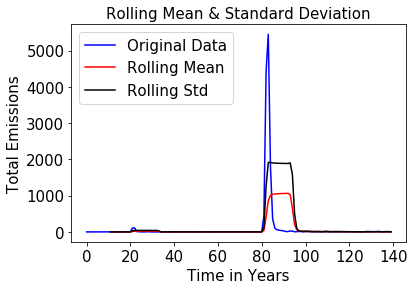

Test Statistic                  -3.897614
p-value                          0.002052
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
iadmit


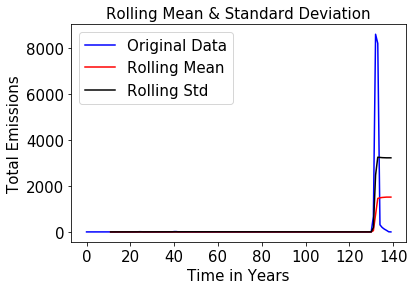

Test Statistic                   0.282989
p-value                          0.976550
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
realtalk


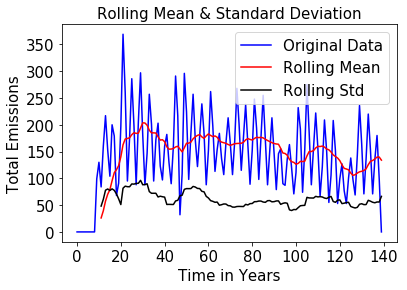

Test Statistic                  -3.346549
p-value                          0.012922
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
subtweet


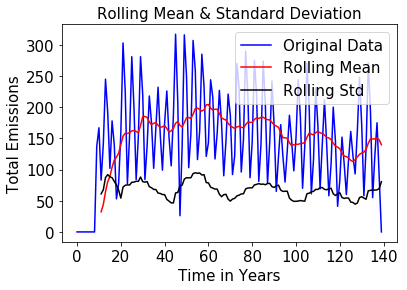

Test Statistic                  -2.888384
p-value                          0.046716
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
tfb


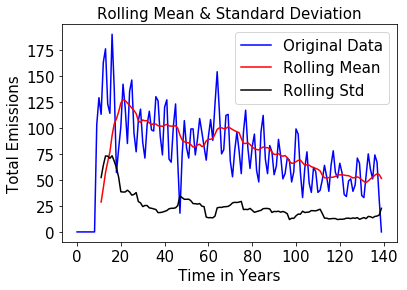

Test Statistic                  -1.217934
p-value                          0.665834
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
bgc


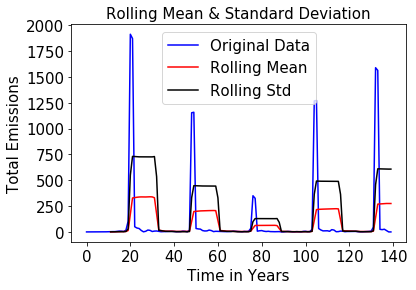

Test Statistic                  -4.532483
p-value                          0.000172
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
theworstfeeling


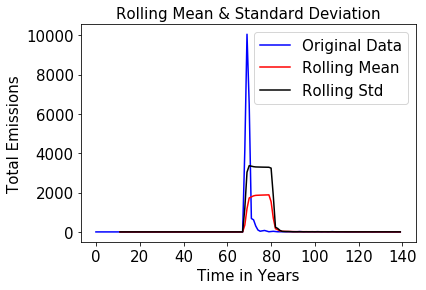

Test Statistic                  -3.468143
p-value                          0.008844
#Lags Used                       9.000000
Number of Observations Used    130.000000
Critical Value (5%)             -2.884042
Critical Value (1%)             -3.481682
Critical Value (10%)            -2.578770
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
believe


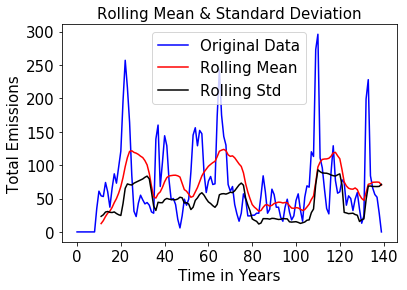

Test Statistic                  -4.128405
p-value                          0.000869
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
boyfriend


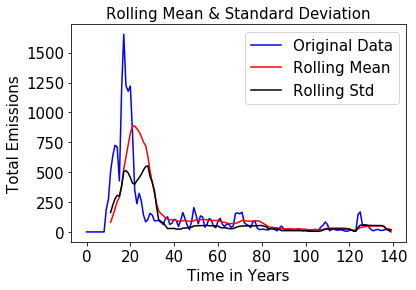

Test Statistic                  -2.127869
p-value                          0.233457
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
p2


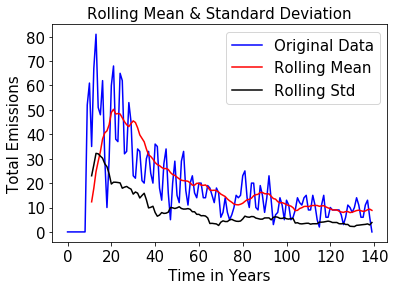

Test Statistic                  -2.299157
p-value                          0.172240
#Lags Used                      13.000000
Number of Observations Used    126.000000
Critical Value (5%)             -2.884766
Critical Value (1%)             -3.483346
Critical Value (10%)            -2.579156
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
inourgeneration


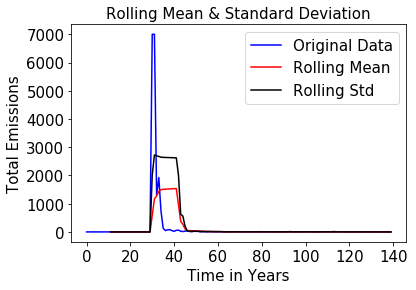

Test Statistic                  -4.385112
p-value                          0.000315
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
teamfollowback


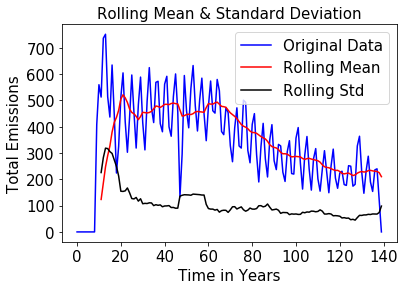

Test Statistic                  -0.605061
p-value                          0.869834
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
10thingsifindattractive


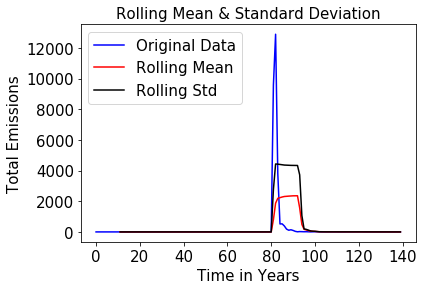

Test Statistic                  -3.878660
p-value                          0.002198
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
cancers


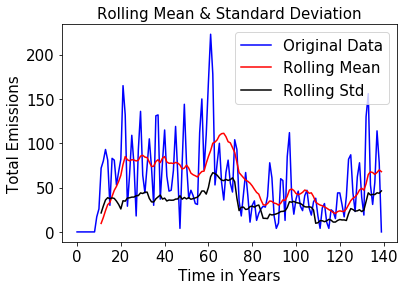

Test Statistic                  -2.788145
p-value                          0.059987
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
mybiggestproblem


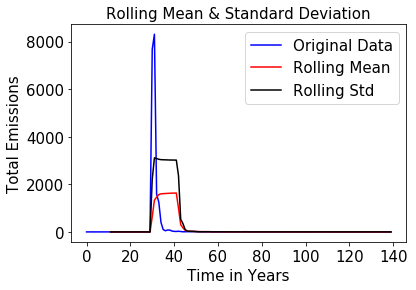

Test Statistic                  -4.457316
p-value                          0.000235
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
f1


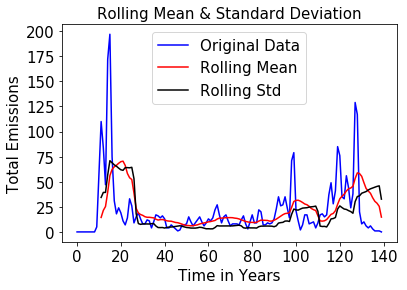

Test Statistic                  -3.562893
p-value                          0.006511
#Lags Used                       6.000000
Number of Observations Used    133.000000
Critical Value (5%)             -2.883528
Critical Value (1%)             -3.480500
Critical Value (10%)            -2.578496
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
wewontworkoutif


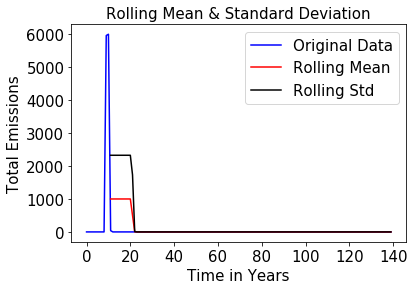

Test Statistic                -6.794123e+00
p-value                        2.324261e-09
#Lags Used                     0.000000e+00
Number of Observations Used    1.390000e+02
Critical Value (5%)           -2.882568e+00
Critical Value (1%)           -3.478294e+00
Critical Value (10%)          -2.577983e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
middleschoolmemories


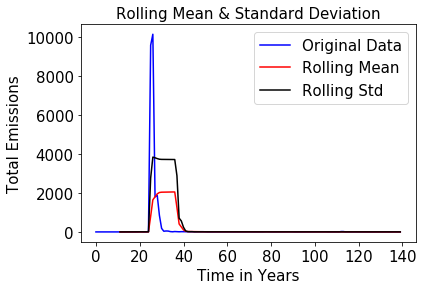

Test Statistic                  -4.449977
p-value                          0.000242
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
gemini


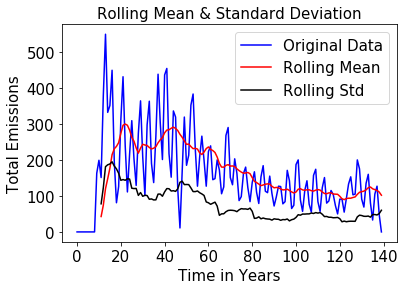

Test Statistic                  -0.818236
p-value                          0.813707
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
thatirritatesme


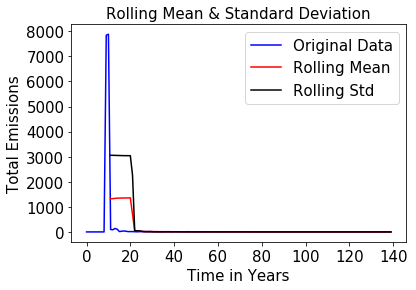

Test Statistic                  -3.261566
p-value                          0.016686
#Lags Used                      14.000000
Number of Observations Used    125.000000
Critical Value (5%)             -2.884954
Critical Value (1%)             -3.483779
Critical Value (10%)            -2.579257
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
kca


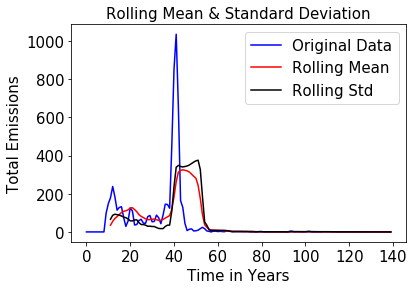

Test Statistic                  -4.034809
p-value                          0.001239
#Lags Used                       3.000000
Number of Observations Used    136.000000
Critical Value (5%)             -2.883037
Critical Value (1%)             -3.479372
Critical Value (10%)            -2.578234
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
sagittarius


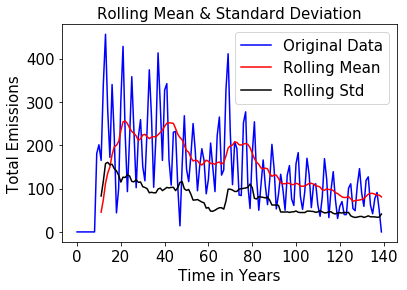

Test Statistic                  -1.562193
p-value                          0.502552
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
throwbackthursday


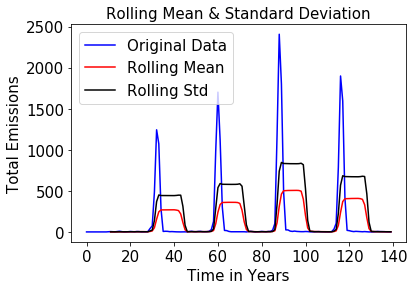

Test Statistic                  -4.054697
p-value                          0.001150
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
virgos


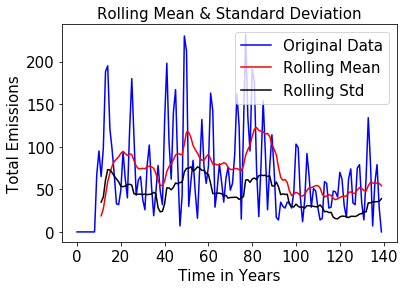

Test Statistic                  -3.135562
p-value                          0.024031
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
nf


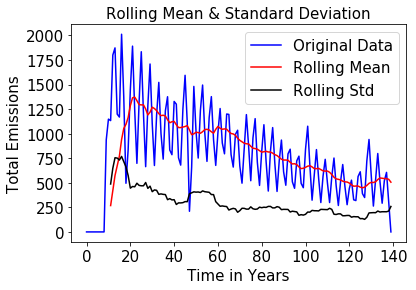

Test Statistic                  -1.051539
p-value                          0.734006
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
imsinglebecause


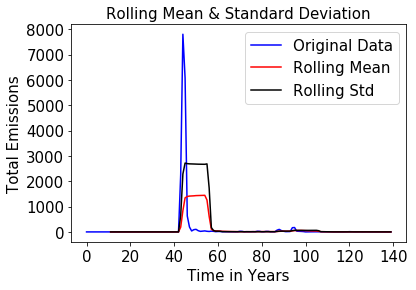

Test Statistic                  -3.925888
p-value                          0.001852
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
np


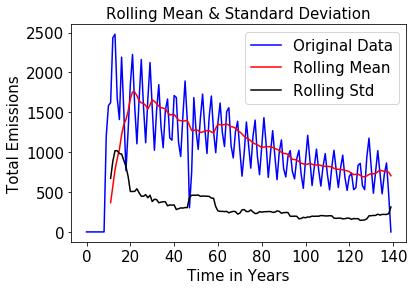

Test Statistic                  -1.099257
p-value                          0.715368
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
nw


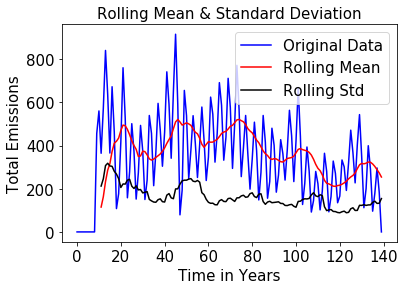

Test Statistic                  -2.242967
p-value                          0.191022
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
itscutewhen


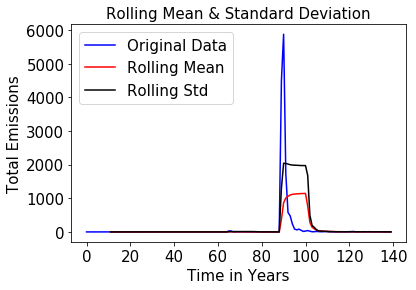

Test Statistic                  -3.833948
p-value                          0.002578
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
justsaying


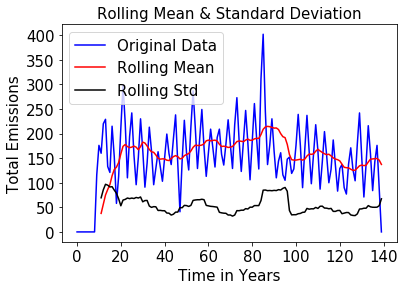

Test Statistic                  -2.746110
p-value                          0.066393
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
thingsmostpeoplelikebutidont


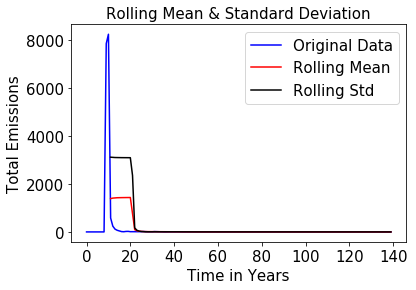

Test Statistic                -1.154023e+01
p-value                        3.649635e-21
#Lags Used                     9.000000e+00
Number of Observations Used    1.300000e+02
Critical Value (5%)           -2.884042e+00
Critical Value (1%)           -3.481682e+00
Critical Value (10%)          -2.578770e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
teamiphone


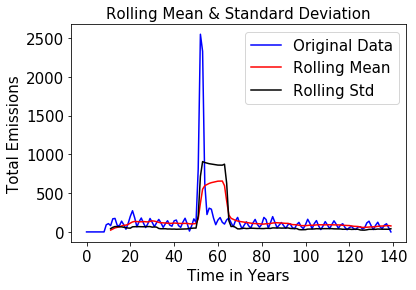

Test Statistic                  -3.134521
p-value                          0.024102
#Lags Used                       8.000000
Number of Observations Used    131.000000
Critical Value (5%)             -2.883868
Critical Value (1%)             -3.481282
Critical Value (10%)            -2.578677
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
20thingsilove


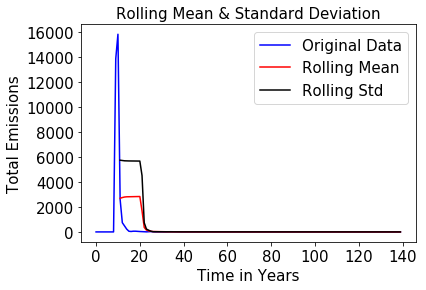

Test Statistic                -6.523210e+00
p-value                        1.029808e-08
#Lags Used                     1.400000e+01
Number of Observations Used    1.250000e+02
Critical Value (5%)           -2.884954e+00
Critical Value (1%)           -3.483779e+00
Critical Value (10%)          -2.579257e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
fb


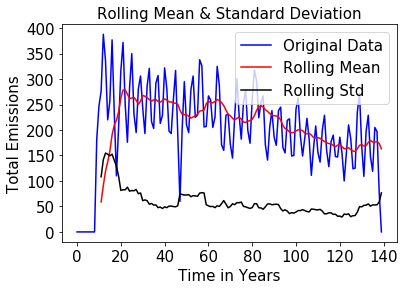

Test Statistic                  -1.538542
p-value                          0.514366
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
10factsaboutme


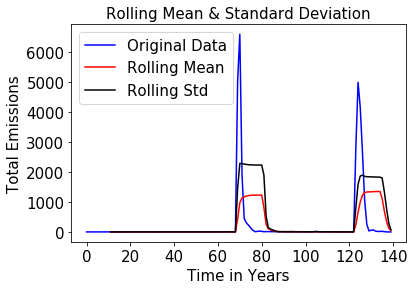

Test Statistic                  -4.492089
p-value                          0.000203
#Lags Used                       5.000000
Number of Observations Used    134.000000
Critical Value (5%)             -2.883362
Critical Value (1%)             -3.480119
Critical Value (10%)            -2.578407
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
ff


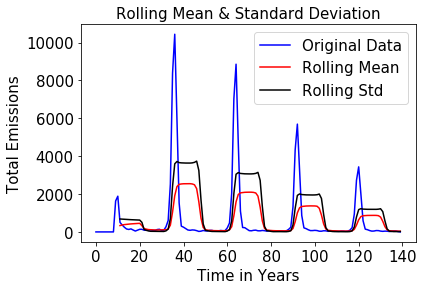

Test Statistic                  -4.329908
p-value                          0.000394
#Lags Used                       7.000000
Number of Observations Used    132.000000
Critical Value (5%)             -2.883697
Critical Value (1%)             -3.480888
Critical Value (10%)            -2.578586
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary
shoutout


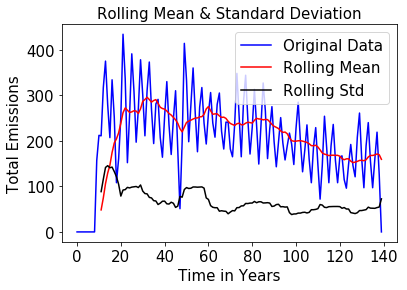

Test Statistic                  -1.882411
p-value                          0.340380
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 
fact


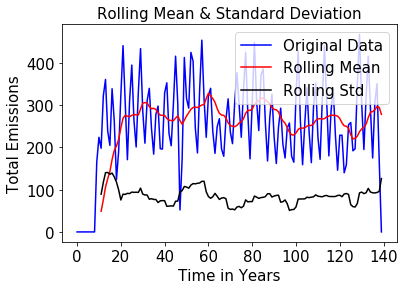

Test Statistic                  -4.364045
p-value                          0.000343
#Lags Used                      11.000000
Number of Observations Used    128.000000
Critical Value (5%)             -2.884398
Critical Value (1%)             -3.482501
Critical Value (10%)            -2.578960
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary


In [47]:
#if the mean and std of each time series show a change in time it indicates nonstationarity.
#Adfuller test is more conclusive
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    TestStationaryPlot(series)

In [7]:
import statsmodels
import statsmodels.api as sm
from statsmodels.tsa.stattools import coint, adfuller
stationary = []
NON = []
for i in Data_rt:
    indx= list(Data_rt).index(i)
    ts = df[0][indx]
    ts_test = adfuller(ts, autolag = 'AIC')
    ts_test_output = pd.Series(ts_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in ts_test[4].items():
        ts_test_output['Critical Value (%s)'%key] = value
    #print(ts_test_output)
    
    if ts_test[1] <= 0.01:
        stationary.append(i)
        #print("Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary")
    else:
        NON.append(i)
        #print("Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

In [8]:
len(stationary),len(NON)

(46, 63)

# After applying those tests I'll run Sarima on NON hashtags and re-run Arima on the stationary ones.

mythoughtsduringschool
Test RMSE: 0.930


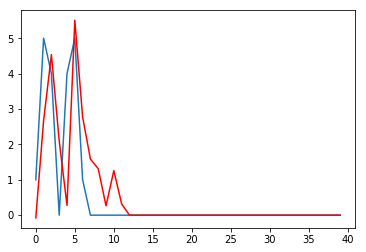

follow
Test RMSE: 16.236


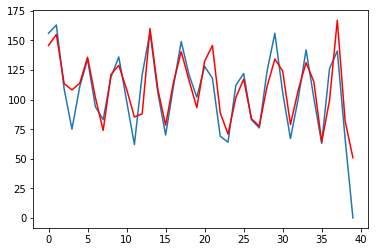

twitterpeopleilove
LinAlgError: SVD did not converge
sorrynotsorry
Test RMSE: 27.957


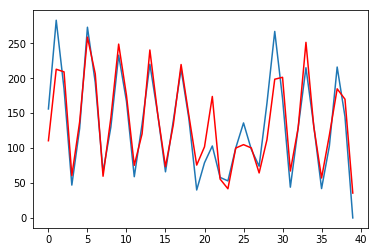

bahrain
Test RMSE: 7.507


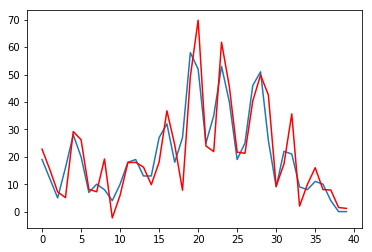

yougetpointsif
Test RMSE: 0.000


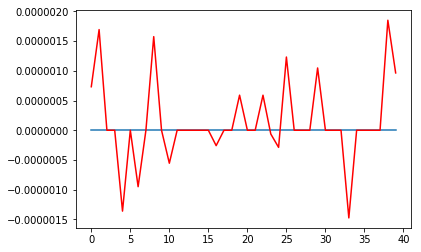

tbt
Test RMSE: 227.304


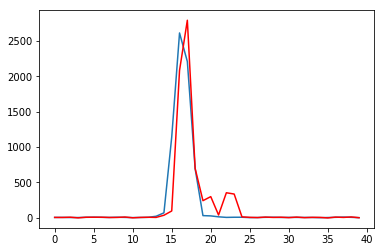

yougetmajorpointsif
Test RMSE: 0.000


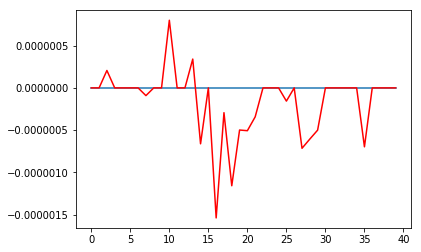

youknowwhatsannoying
Test RMSE: 0.000


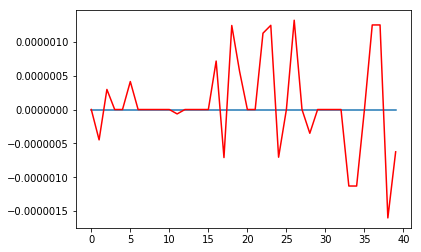

truth
Test RMSE: 27.361


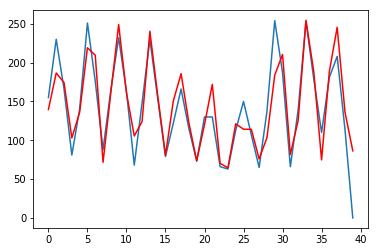

10thingsthatilike
Test RMSE: 0.000


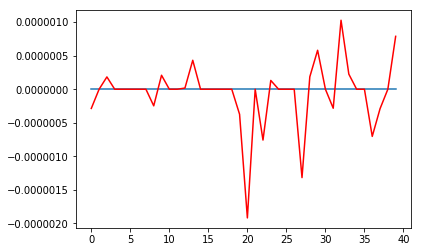

goodnight
Test RMSE: 36.184


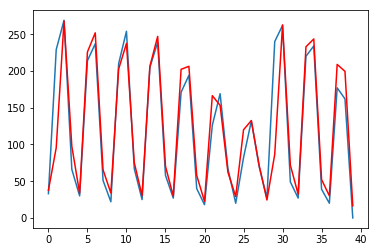

ifitwasuptome
Test RMSE: 1.686


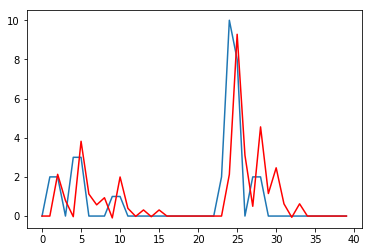

10thingsihate
Test RMSE: 6.431


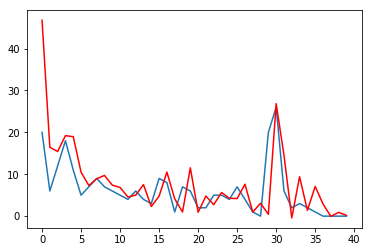

retweet
Test RMSE: 59.779


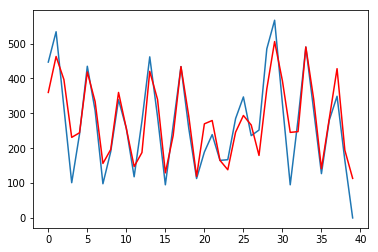

icantstandwhen
Test RMSE: 0.352


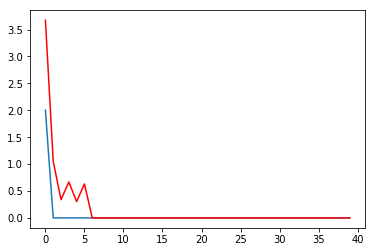

wheniwaslittle
Test RMSE: 3.266


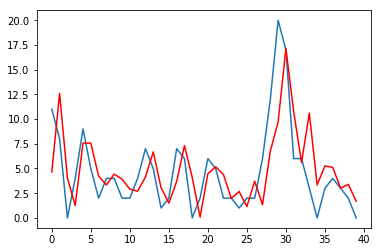

moviesthatnevergetold
Test RMSE: 1.094


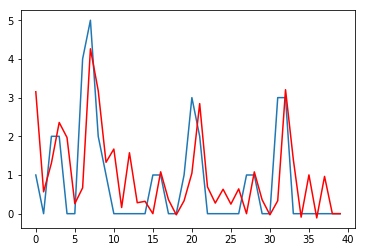

nationalbestfriendday
Test RMSE: 0.000


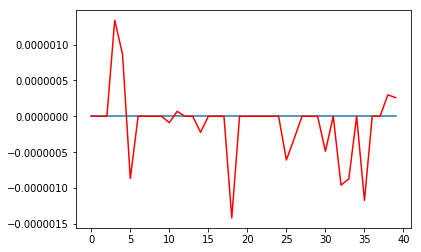

free
Test RMSE: 11.417


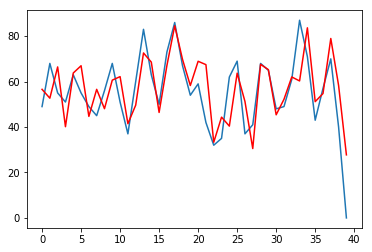

thingsigetalot
Test RMSE: 0.000


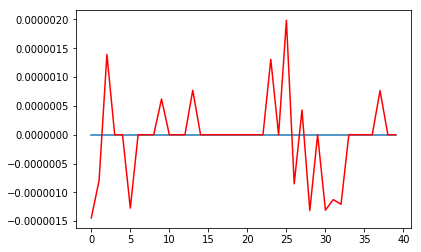

thingsisaywhilereadingmytl
Test RMSE: 0.000


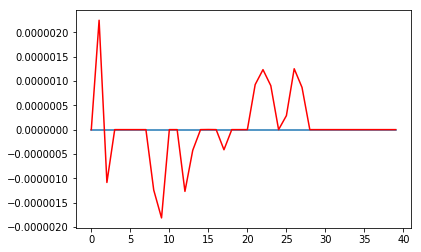

top100lies
Test RMSE: 0.000


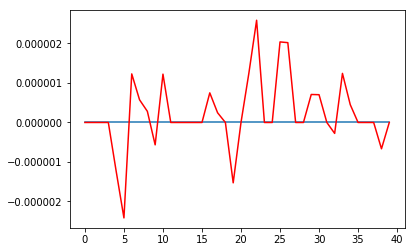

dearoomf
Test RMSE: 8.364


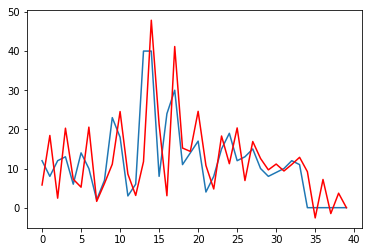

thoughtsduringschool
Test RMSE: 3.946


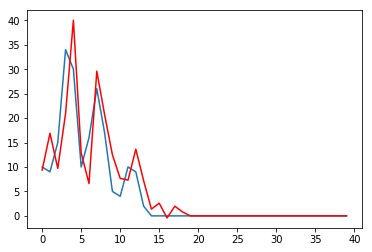

truthis
Test RMSE: 9.133


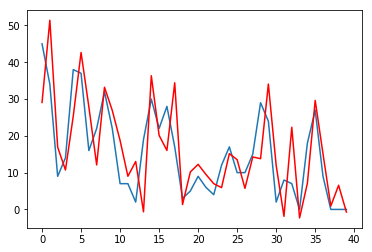

realshit
Test RMSE: 23.555


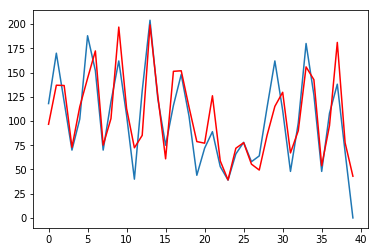

confessionhour
Test RMSE: 4.494


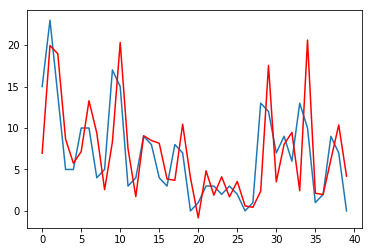

bgc
Test RMSE: 373.826


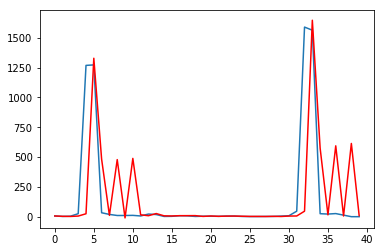

theworstfeeling
Test RMSE: 3.764


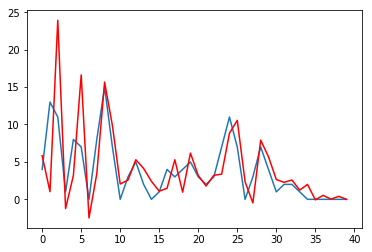

believe
Test RMSE: 57.930


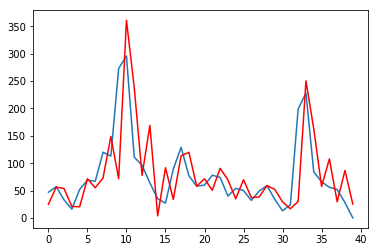

inourgeneration
Test RMSE: 1.929


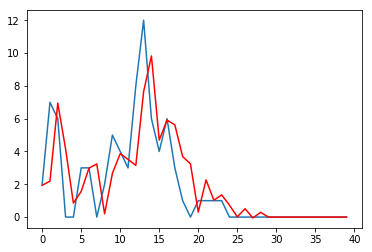

10thingsifindattractive
Test RMSE: 2.790


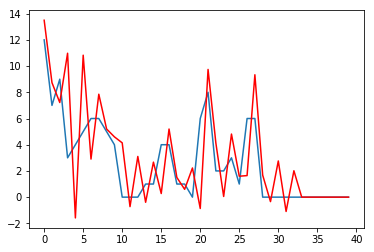

mybiggestproblem
Test RMSE: 1.202


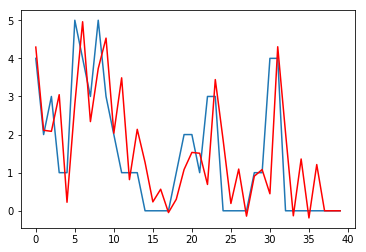

f1
Test RMSE: 20.546


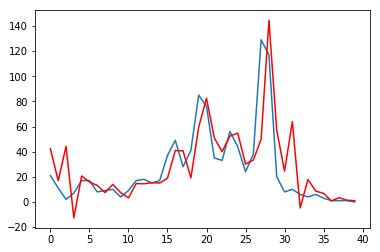

wewontworkoutif
Test RMSE: 0.000


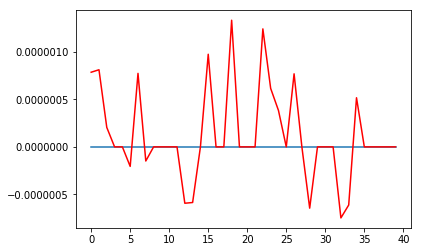

middleschoolmemories
Test RMSE: 3.461


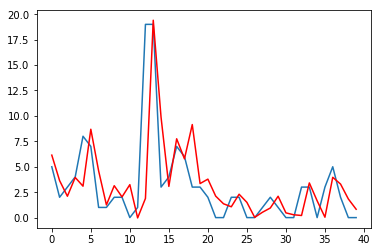

kca
Test RMSE: 0.839


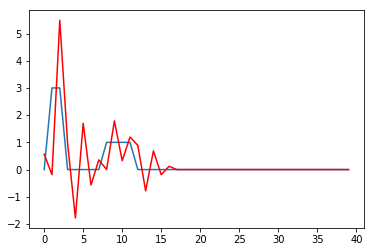

throwbackthursday
Test RMSE: 188.652


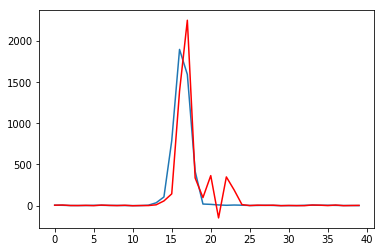

imsinglebecause
Test RMSE: 10.674


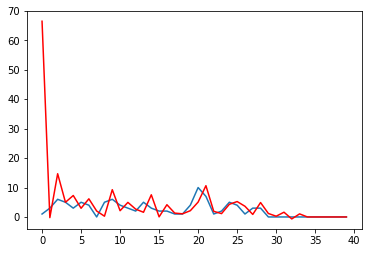

itscutewhen
Test RMSE: 5.870


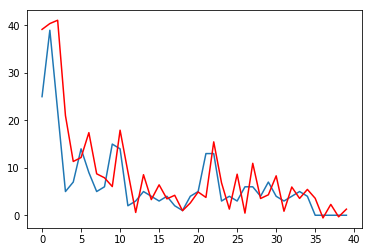

thingsmostpeoplelikebutidont
Test RMSE: 0.000


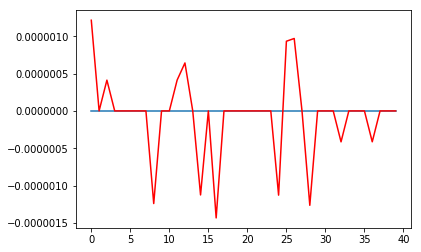

20thingsilove
Test RMSE: 0.711


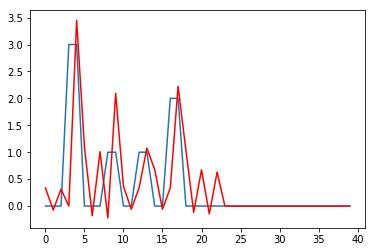

10factsaboutme
Test RMSE: 583.897


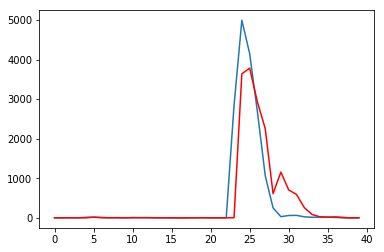

ff
Test RMSE: 247.439


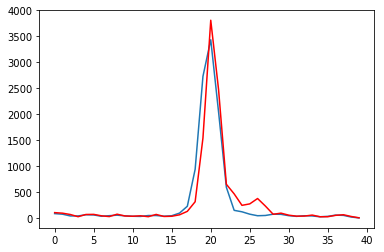

fact
Test RMSE: 46.607


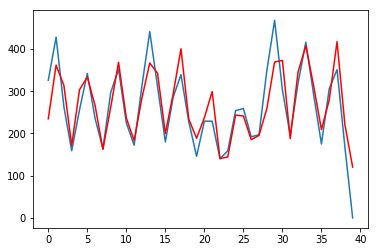

In [53]:
from pandas import read_csv
from pandas import datetime
from matplotlib import pyplot
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
# load dataset
high_err_tag = []
for i in stationary:
    try:
        print(i)
        def parser(x):
            return datetime.strptime('190'+x, '%Y-%m')
        indx = list(Data_rt).index(i)
        series = pd.Series(df[0][indx])
        X = series.values
        train, test = X[0:-40], X[-40:]
        history = [x for x in train]
        predictions = list()
# walk-forward validation
        for t in range(0,len(test)):
# fit model
            model = ARIMA(history, order=(4,1,0))
            model_fit = model.fit()
# one step forecast
            yhat = model_fit.forecast()[0]
# store forecast and ob
            predictions.append(yhat)
            history.append(test[t])
# evaluate forecasts
        rmse = sqrt(mean_squared_error(test, predictions))
        print('Test RMSE: %.3f' % rmse)
        if rmse >20:
            high_err_tag.append((i,rmse))
        
# plot forecasts against actual outcomes
        pyplot.plot(test)
        pyplot.plot(predictions, color='red')
        pyplot.show()
    except:
        print('LinAlgError: SVD did not converge')
        pass

In [54]:
high_err_tag

[('sorrynotsorry', 27.956780517179993),
 ('tbt', 227.30372793595518),
 ('truth', 27.361394661265475),
 ('goodnight', 36.183834523239945),
 ('retweet', 59.779137778411624),
 ('realshit', 23.555341361798327),
 ('bgc', 373.82631734103916),
 ('believe', 57.93025377295256),
 ('f1', 20.54574267190698),
 ('throwbackthursday', 188.652145445091),
 ('10factsaboutme', 583.8968330649127),
 ('ff', 247.43862146218112),
 ('fact', 46.6069397156383)]

In [55]:
len(high_err_tag)

13

# SeasonalARIMA

Main parameters of SARIMA:
Configuring a SARIMA requires selecting hyperparameters for both the trend and seasonal elements of the series.

Trend Elements

There are three trend elements that require configuration.

They are the same as the ARIMA model; specifically:

p: Trend autoregression order.
d: Trend difference order.
q: Trend moving average order.
Seasonal Elements

There are four seasonal elements that are not part of ARIMA that must be configured; they are:

P: Seasonal autoregressive order.>> AR as usual
D: Seasonal difference order. >> same as arima
Q: Seasonal moving average order. same as arima too

m: The number of time steps for a single seasonal period. >> for ff and tbt can be 4


# GRID Search

In [14]:
p = d = q = range(0, 3) # Define the p, d and q parameters to take any value between 0 and 3
pdq = list(itertools.product(p, d, q)) # Generate all different combinations of p, q and q triplets
pdq_x_QDQs = [(x[0], x[1], x[2], 4) for x in list(itertools.product(p, d, q))] # Generate all different combinations of seasonal p, q and q triplets
print('Examples of Seasonal ARIMA parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], pdq_x_QDQs[1]))
print('SARIMAX: {} x {}'.format(pdq[2], pdq_x_QDQs[2]))

Examples of Seasonal ARIMA parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 4)
SARIMAX: (0, 0, 2) x (0, 0, 2, 4)


In [17]:
#pdq, pdq_x_QDQs
list(Data_rt).index(stationary[1]),list(Data_rt).index(NON[1])

NameError: name 'stationary' is not defined

In [16]:
#The Akaike information criterion (AIC) is an estimator of the relative quality of statistical models for a given
#set of data. Given a collection of models for the data, 
#AIC estimates the quality of each model, relative to each of the other models. 
#Thus, AIC provides a means for model selection.
#I'll apply the grid search on one set of the stationary and one of the NON
import warnings
warnings.filterwarnings("ignore")

data_st = df[0][4]
for param in pdq:
    for seasonal_param in pdq_x_QDQs:
        try:
            mod = sm.tsa.statespace.SARIMAX(data_st,
                                            order=param,
                                            seasonal_order=seasonal_param,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)
            results = mod.fit()
            print('ARIMA{}x{} - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue


In [ ]:
#import warnings
#warnings.filterwarnings("ignore")
#data_non = df[0][1]
"""for param in pdq:
    for seasonal_param in pdq_x_QDQs:
        mod = sm.tsa.statespace.SARIMAX(data_non,
                                        order=param,
                                        seasonal_order=seasonal_param,
                                        enforce_stationarity=True,
                                        enforce_invertibility=False)
        results1 = mod.fit()"""
        #print('ARIMA{}x{} - AIC:{}'.format(param, seasonal_param, results.aic))

In [18]:
print(results.summary()) #best params

                                 Statespace Model Results                                
Dep. Variable:                                 y   No. Observations:                  140
Model:             SARIMAX(2, 2, 2)x(2, 2, 2, 4)   Log Likelihood                -553.119
Date:                           Thu, 04 Jul 2019   AIC                           1124.239
Time:                                   15:12:24   BIC                           1149.251
Sample:                                        0   HQIC                          1134.395
                                           - 140                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1359      0.095     -1.429      0.153      -0.322       0.050
ar.L2         -0.5799      0.075     -7.770

In [13]:
print(results1.summary()) #best params

                                 Statespace Model Results                                
Dep. Variable:                                 y   No. Observations:                  140
Model:             SARIMAX(1, 2, 2)x(2, 0, 1, 4)   Log Likelihood                -386.114
Date:                           Thu, 04 Jul 2019   AIC                            786.229
Time:                                   15:01:32   BIC                            806.720
Sample:                                        0   HQIC                           794.556
                                           - 140                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5768      0.049    -11.886      0.000      -0.672      -0.482
ma.L1         -0.0035      0.289     -0.012

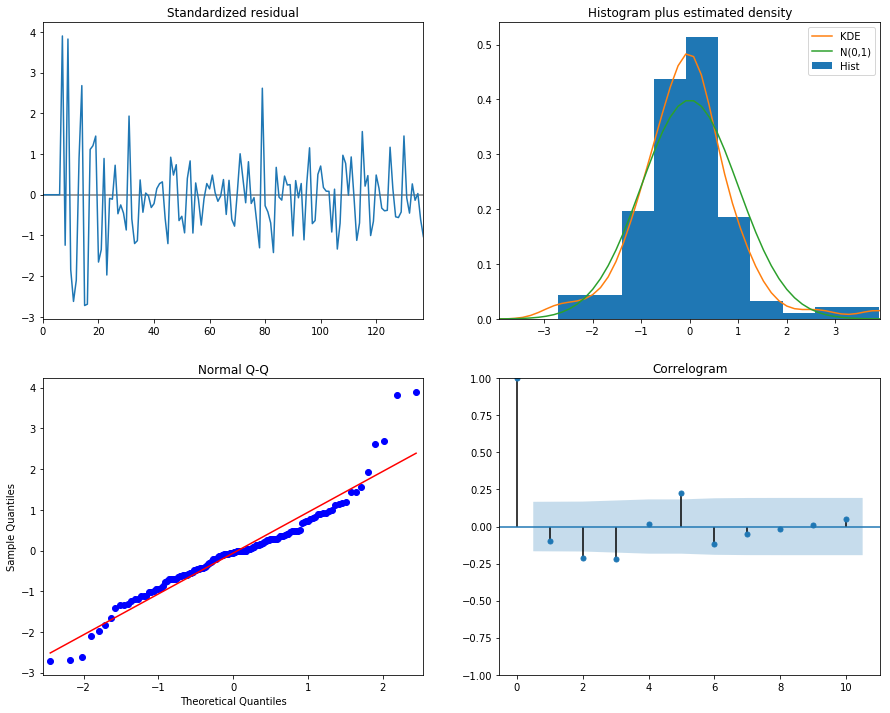

In [19]:
results1.plot_diagnostics(figsize=(15, 12))
plt.show()


# SARIMA

Obviously the non stationary data, work better with sarima so the parameters resulting see variant and consistent.

Now I'll use SARIMA on non stationary data

500aday
Test RMSE: 8.398


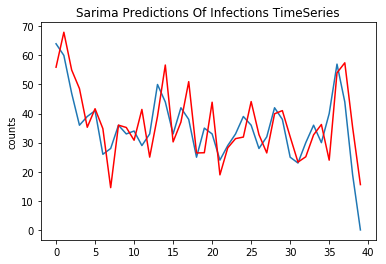

gnation
Test RMSE: 3.090


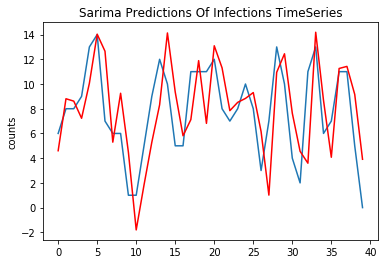

random
Test RMSE: 18.562


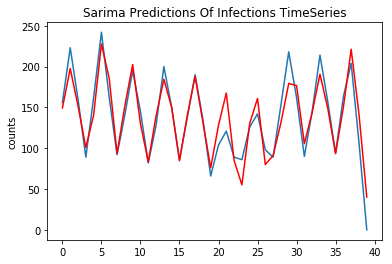

swag
Test RMSE: 10.365


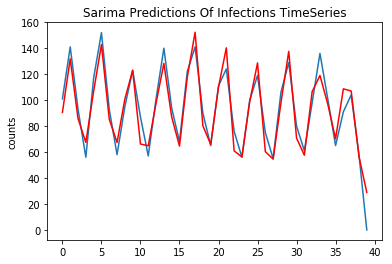

scorpio
Test RMSE: 22.304


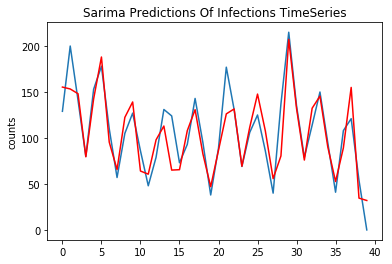

winning
Test RMSE: 35.864


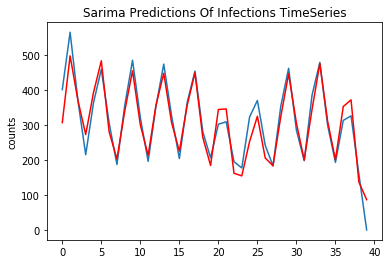

virgo
Test RMSE: 19.566


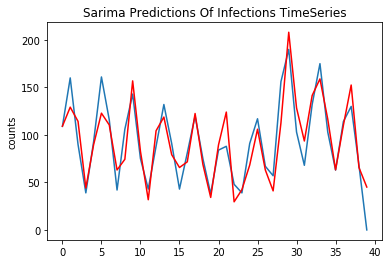

lt
Test RMSE: 20.457


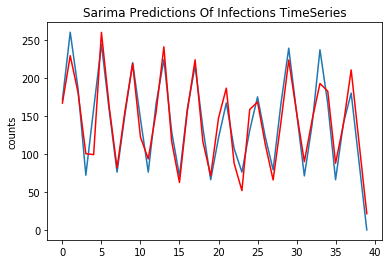

libra
Test RMSE: 39.472


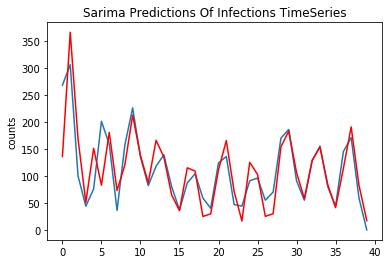

followback
Test RMSE: 23.572


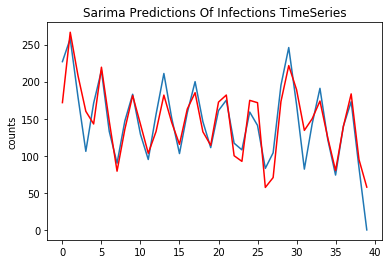

lrt
Test RMSE: 23.488


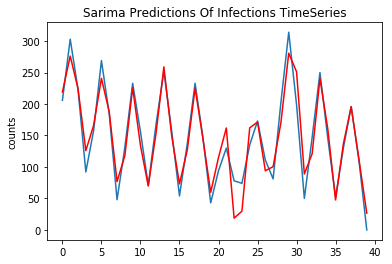

libras
Test RMSE: 35.724


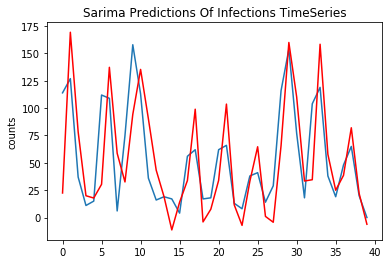

trayvonmartin
Test RMSE: 22.555


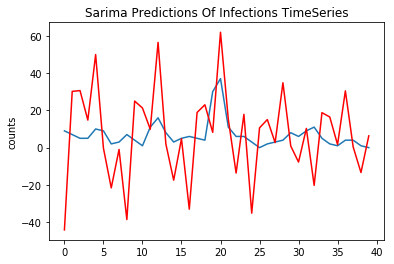

aquarians
Test RMSE: 23.554


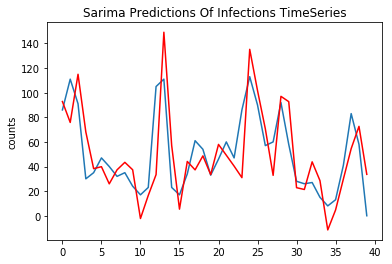

oomfs
Test RMSE: 19.922


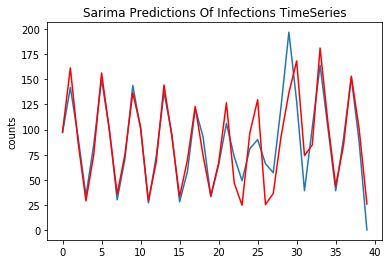

nfb
Test RMSE: 28.719


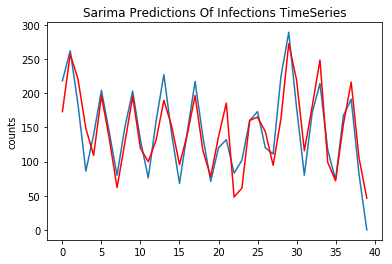

dailytweet
Test RMSE: 32.279


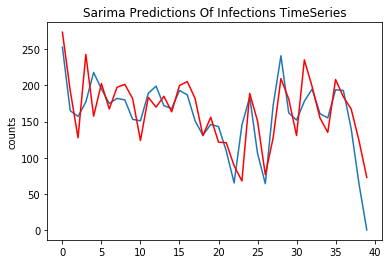

capricorn
Test RMSE: 16.711


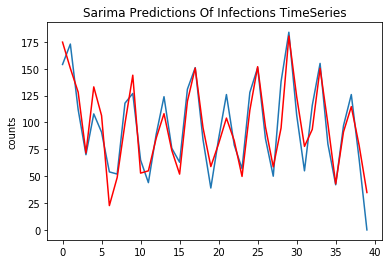

instagram
Test RMSE: 22.178


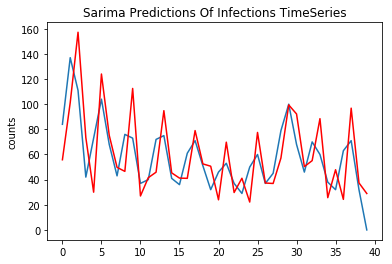

yolo
Test RMSE: 72.759


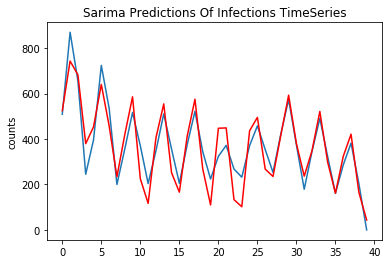

dead
Test RMSE: 28.325


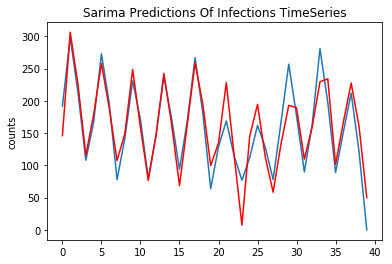

pisces
Test RMSE: 18.262


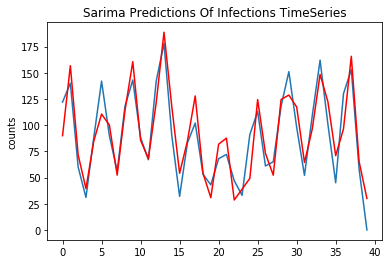

rt
Test RMSE: 58.728


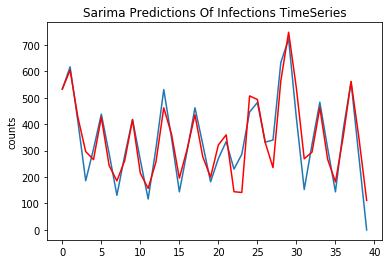

smh
Test RMSE: 24.945


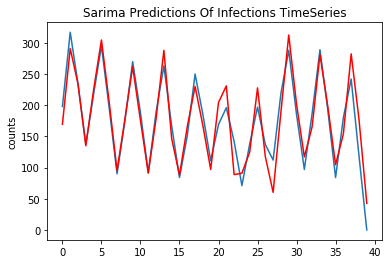

tweegram
Test RMSE: 13.661


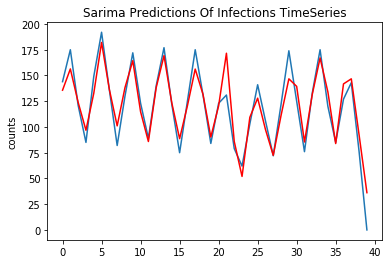

salute
Test RMSE: 23.086


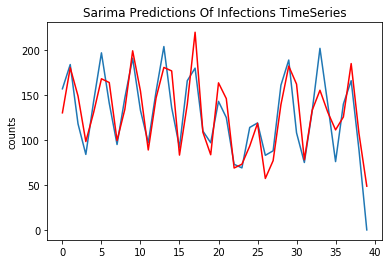

oomf
Test RMSE: 218.071


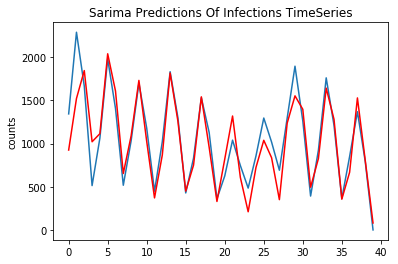

tcot
Test RMSE: 3.660


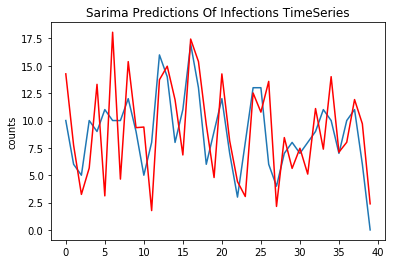

aquarius
Test RMSE: 33.035


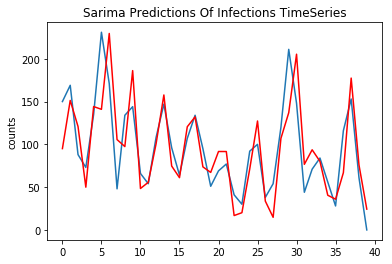

leo
Test RMSE: 26.727


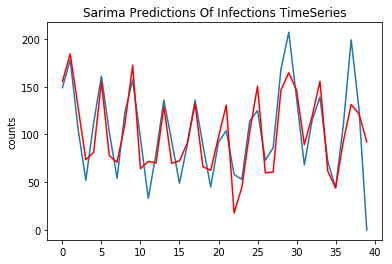

taurus
Test RMSE: 23.955


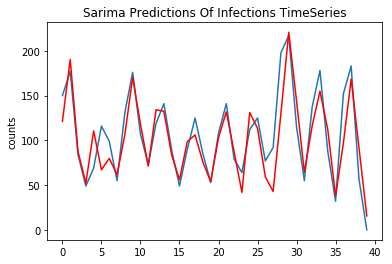

wtf
Test RMSE: 16.744


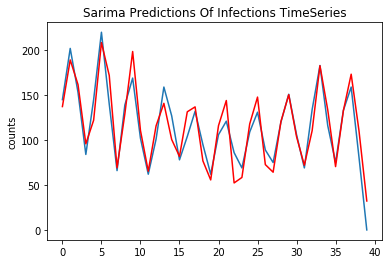

imagine
Test RMSE: 12.085


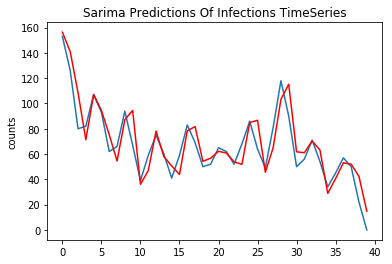

1dfact
Test RMSE: 6.822


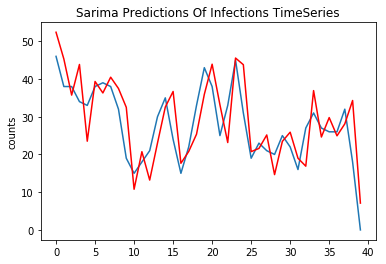

nowplaying
Test RMSE: 21.276


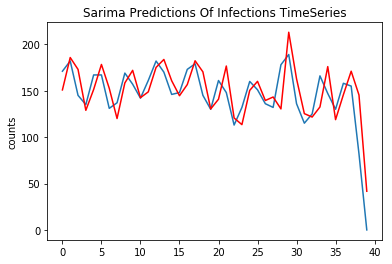

nowfollowing
Test RMSE: 17.321


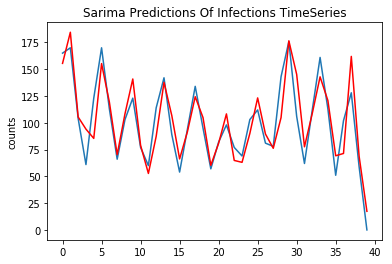

syria
Test RMSE: 3.318


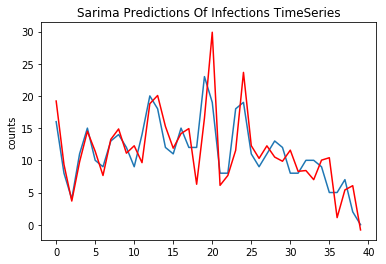

love
Test RMSE: 14.716


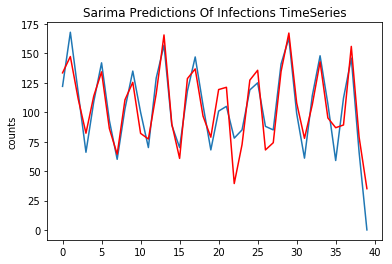

cancer
Test RMSE: 28.133


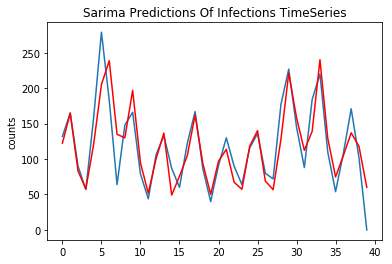

blessed
Test RMSE: 36.852


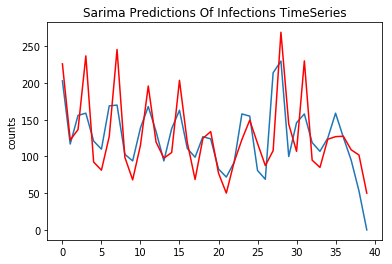

imhappywhen
Test RMSE: 58357052496.220


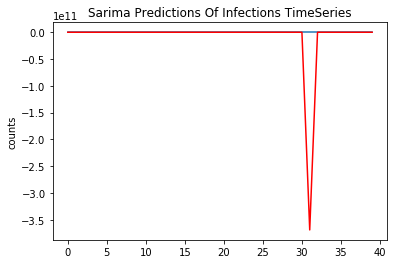

lol
Test RMSE: 16.160


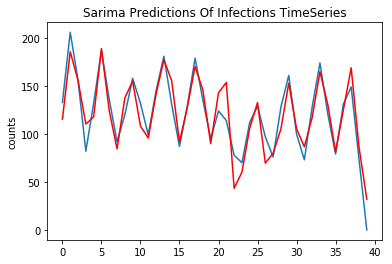

fml
Test RMSE: 25.298


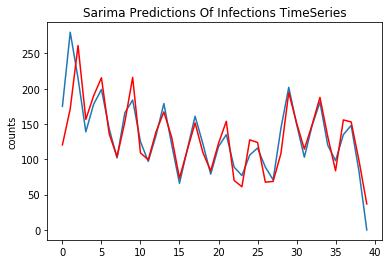

aries
Test RMSE: 21.737


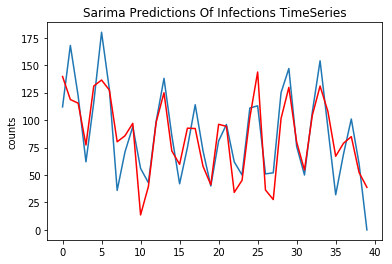

iadmit
Test RMSE: 14110.454


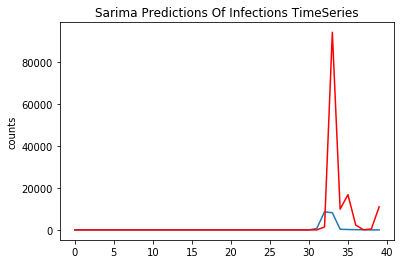

realtalk
Test RMSE: 23.548


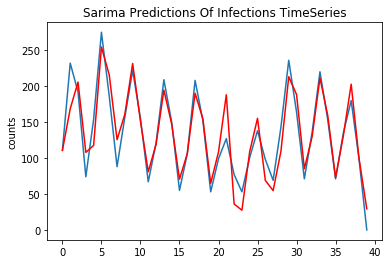

subtweet
Test RMSE: 22.823


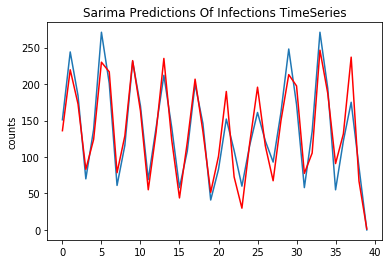

tfb
Test RMSE: 9.495


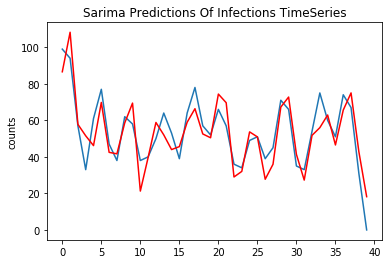

boyfriend
Test RMSE: 35.002


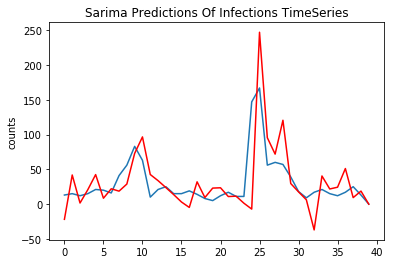

p2
Test RMSE: 4.451


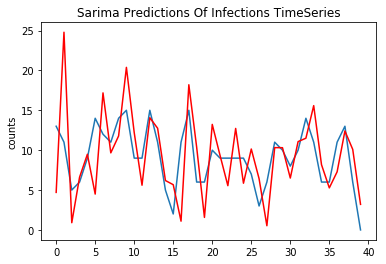

teamfollowback
Test RMSE: 34.915


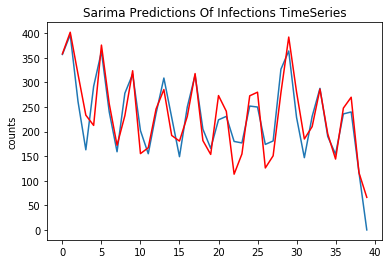

cancers
Test RMSE: 23.892


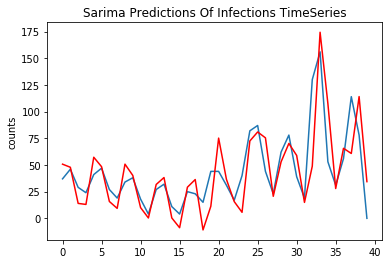

gemini
Test RMSE: 25.287


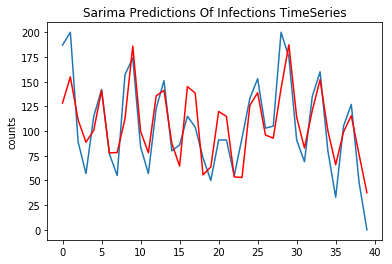

thatirritatesme
Test RMSE: 23.550


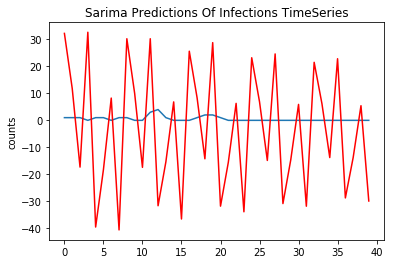

sagittarius
Test RMSE: 24.219


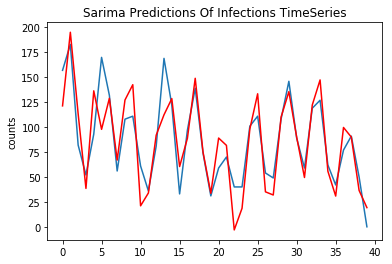

virgos
Test RMSE: 20.020


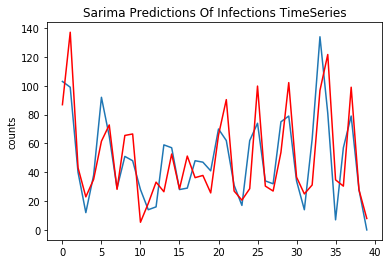

nf
Test RMSE: 98.862


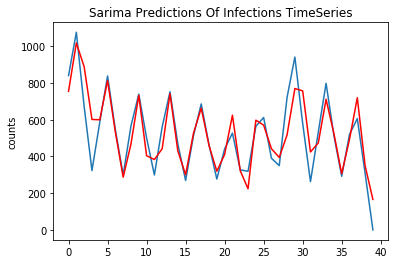

np
Test RMSE: 105.039


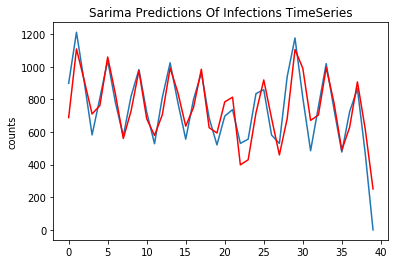

nw
Test RMSE: 50.155


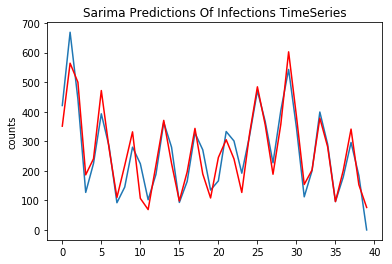

justsaying
Test RMSE: 19.966


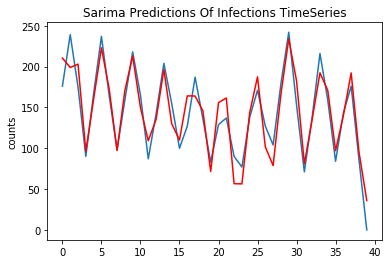

teamiphone
Test RMSE: 30.409


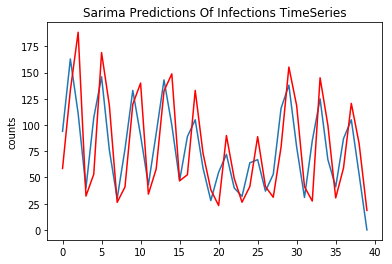

fb
Test RMSE: 26.323


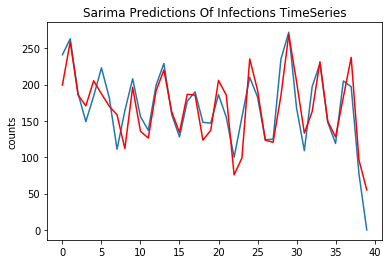

shoutout
Test RMSE: 19.393


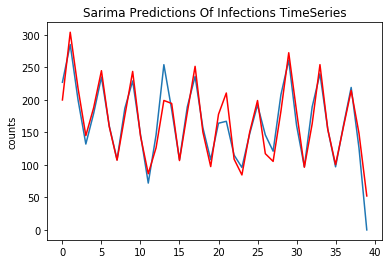

In [48]:
import warnings
warnings.filterwarnings("ignore")

from pandas import read_csv
from pandas import datetime
from matplotlib import pyplot
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
# load dataset
high_err_tag1 = []
for i in NON:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[0][indx])
    X = series.values
    train, test = X[0:-40], X[-40:]
    history = [x for x in train]
    predictions = list()
# walk-forward validation
    for t in range(0,len(test)):
# fit model
        model = sm.tsa.statespace.SARIMAX(history,order=(1, 2, 2),seasonal_order=(2, 0, 1, 4),enforce_stationarity=False, enforce_invertibility=False)
        model_fit = model.fit()
# one step forecast
        yhat = model_fit.forecast()[0]
# store forecast and ob
        predictions.append(yhat)
        history.append(test[t])
# evaluate forecasts
    rmse = sqrt(mean_squared_error(test, predictions))
    print('Test RMSE: %.3f' % rmse)
    if rmse >35:
        high_err_tag1.append((i,rmse))
        
# plot forecasts against actual outcomes
    pyplot.title("Sarima Predictions Of Infections TimeSeries")
    pyplot.ylabel("counts")
    pyplot.plot(test)
    pyplot.plot(predictions, color='red')
    pyplot.show()

In [45]:
len(high_err_tag1)

55

# Apply the same analysis to predict Recovery 

500aday


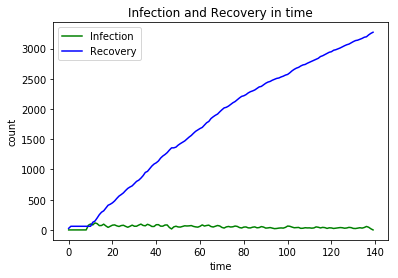

gnation


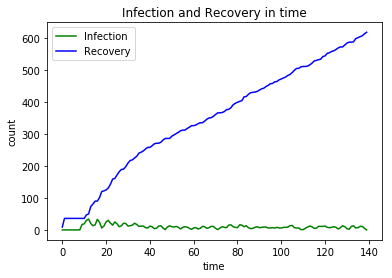

random


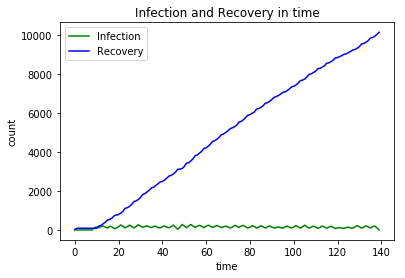

mythoughtsduringschool


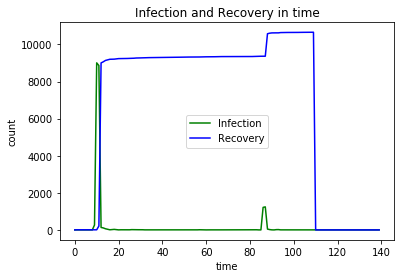

follow


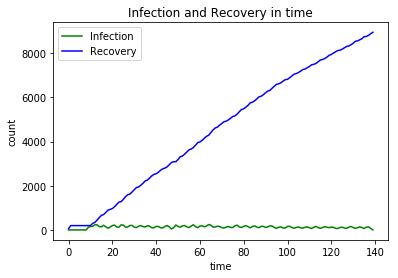

swag


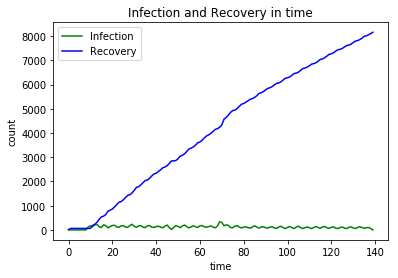

scorpio


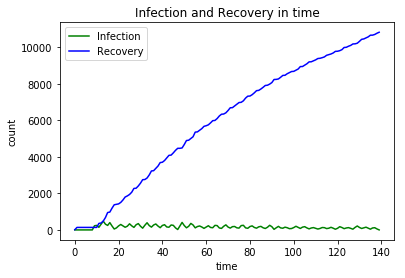

twitterpeopleilove


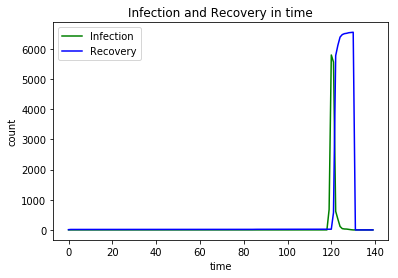

winning


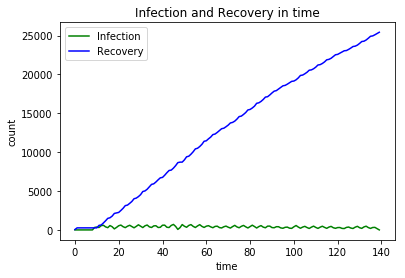

virgo


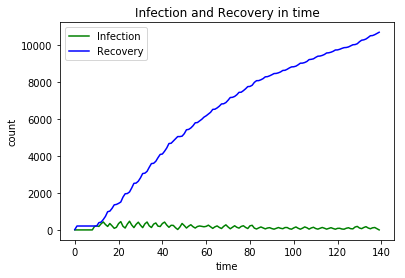

lt


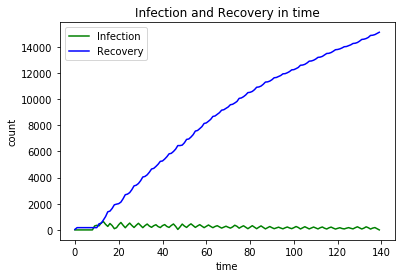

libra


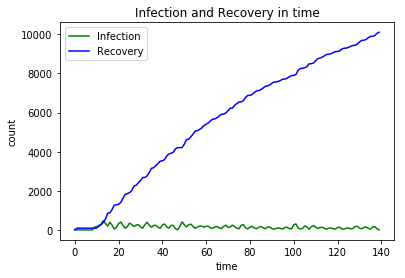

sorrynotsorry


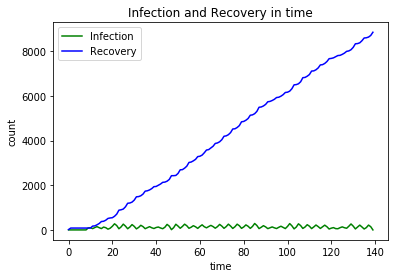

bahrain


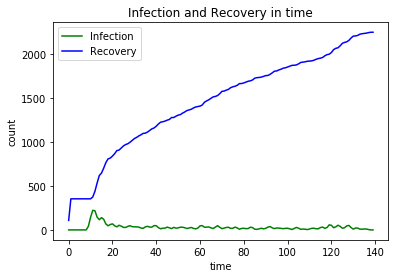

followback


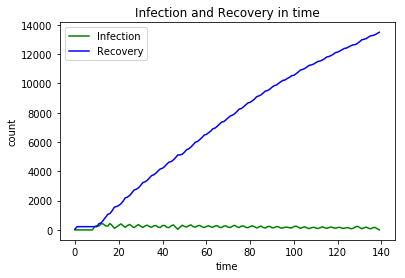

yougetpointsif


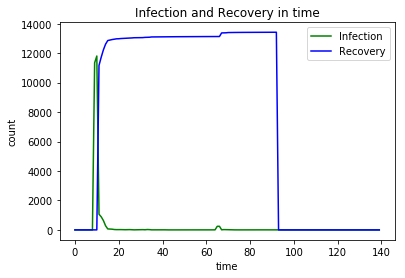

tbt


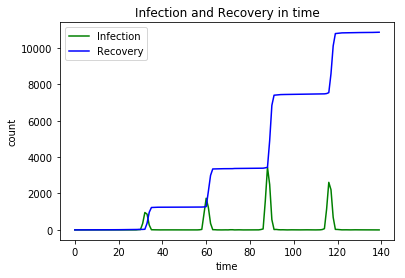

yougetmajorpointsif


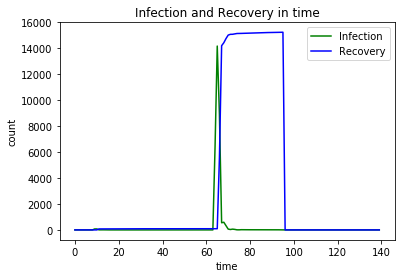

lrt


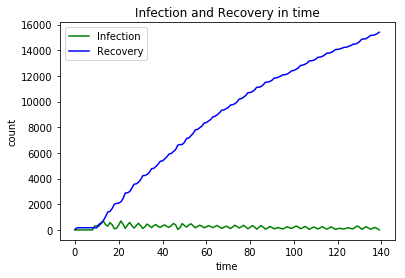

libras


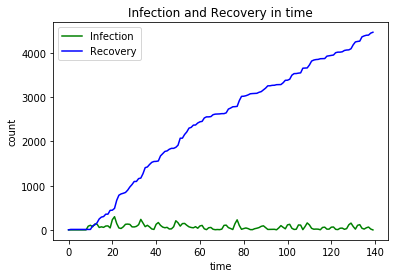

trayvonmartin


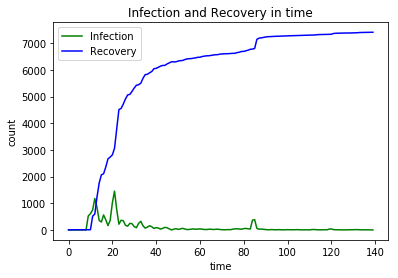

aquarians


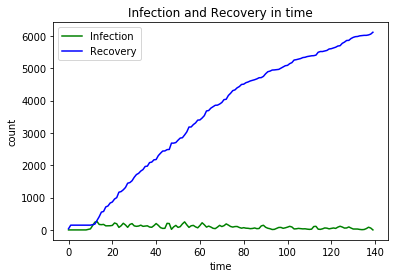

oomfs


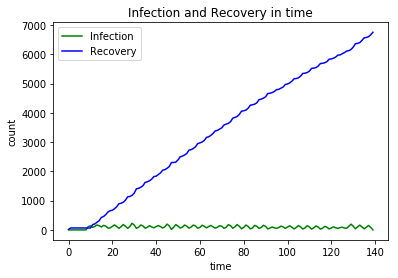

nfb


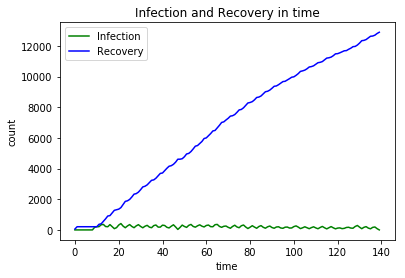

dailytweet


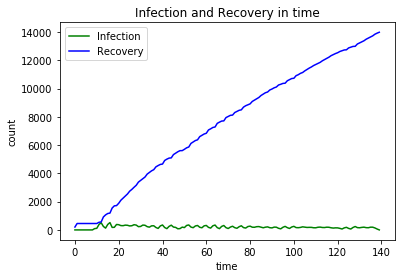

youknowwhatsannoying


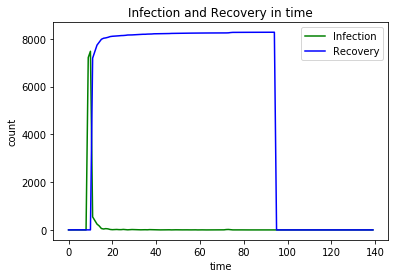

capricorn


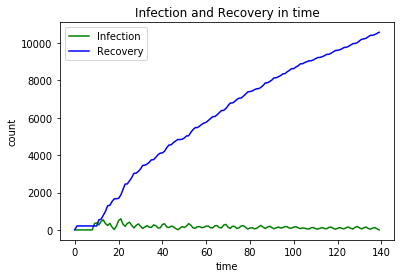

truth


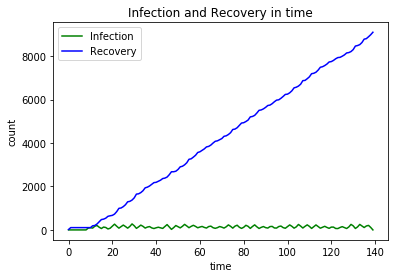

instagram


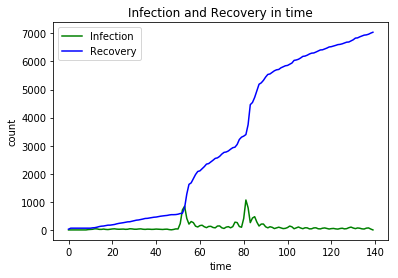

yolo


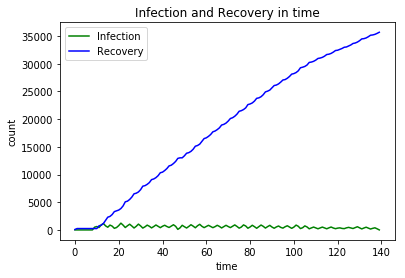

dead


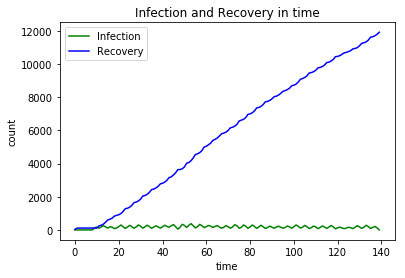

10thingsthatilike


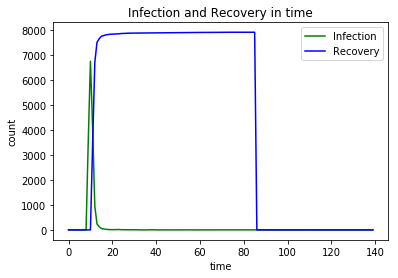

goodnight


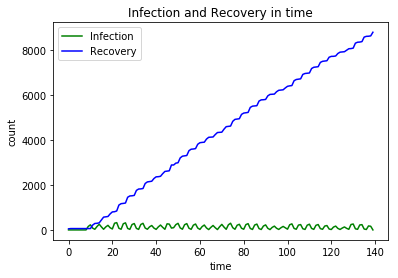

pisces


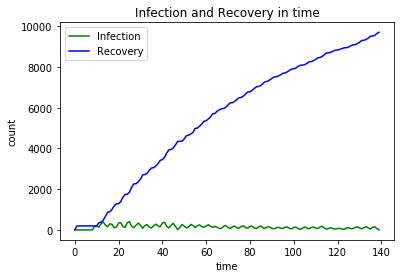

ifitwasuptome


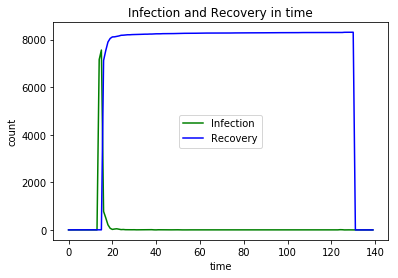

10thingsihate


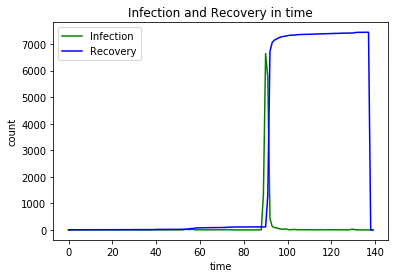

retweet


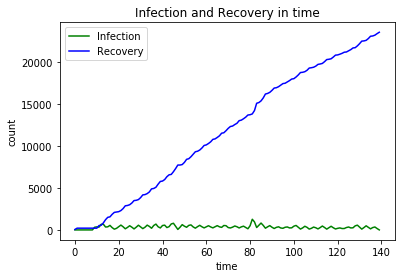

icantstandwhen


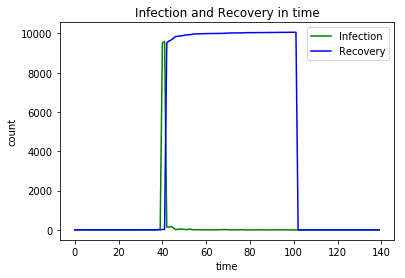

rt


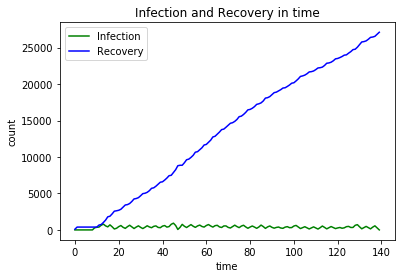

wheniwaslittle


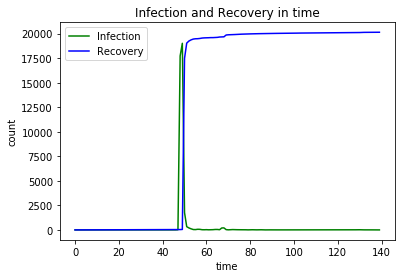

smh


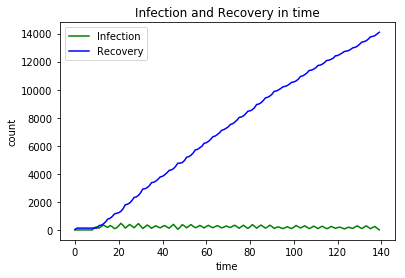

moviesthatnevergetold


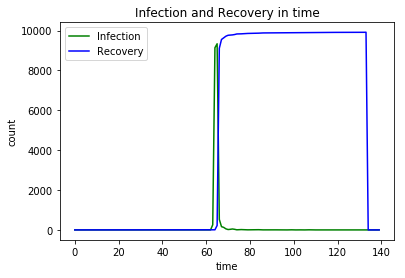

tweegram


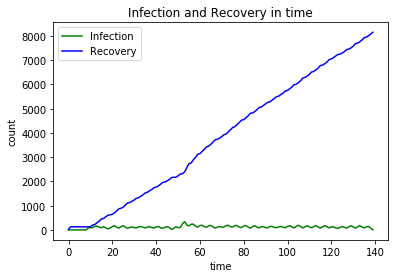

salute


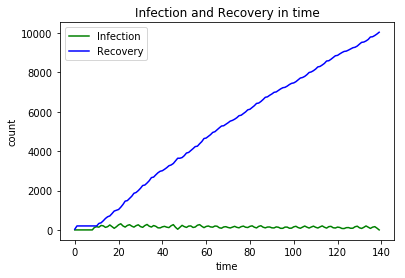

oomf


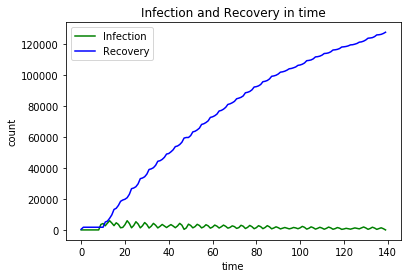

tcot


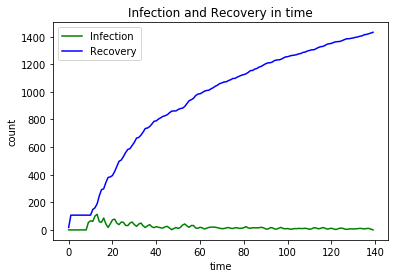

nationalbestfriendday


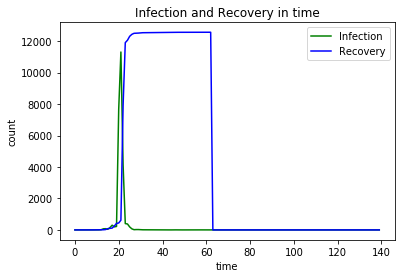

aquarius


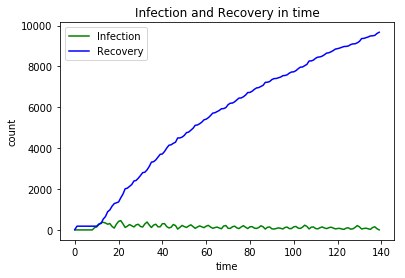

free


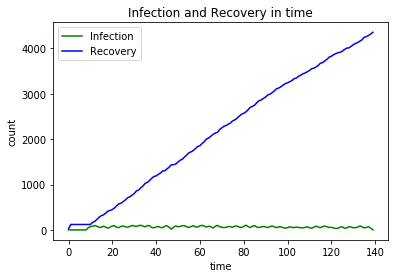

leo


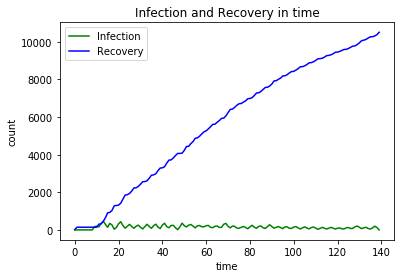

taurus


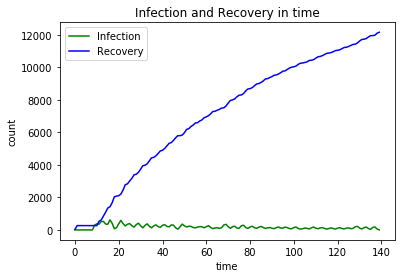

wtf


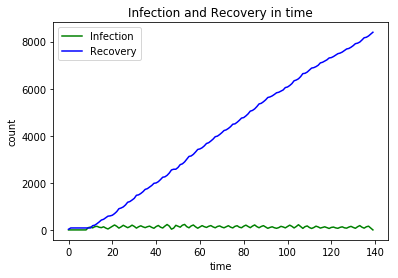

imagine


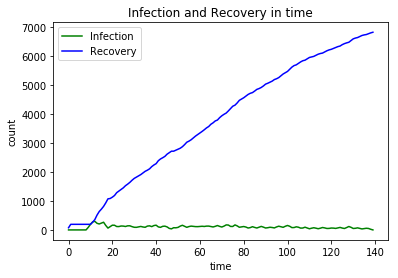

1dfact


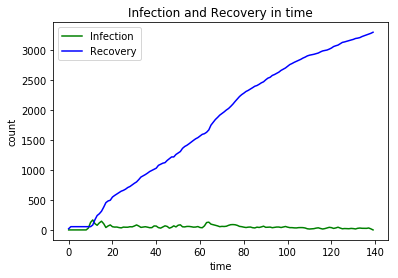

thingsigetalot


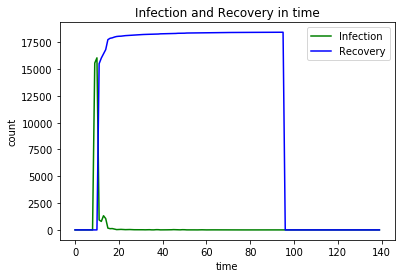

nowplaying


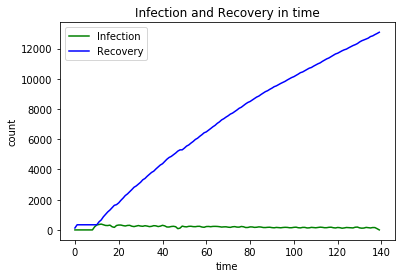

thingsisaywhilereadingmytl


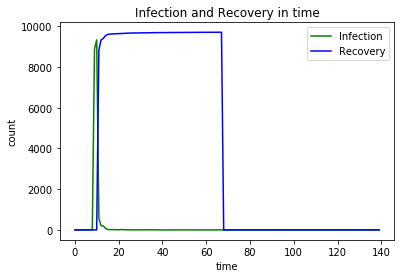

nowfollowing


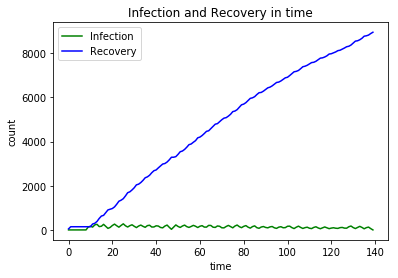

syria


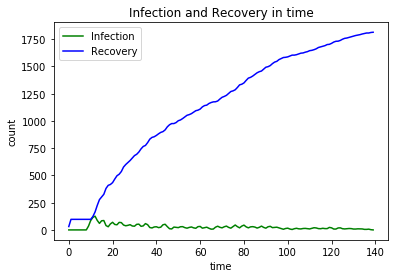

top100lies


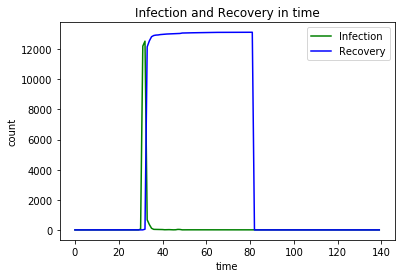

love


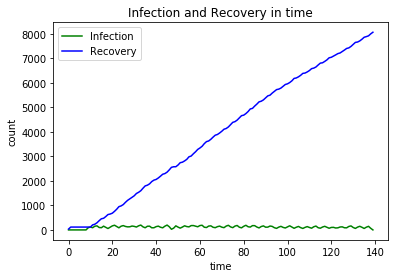

cancer


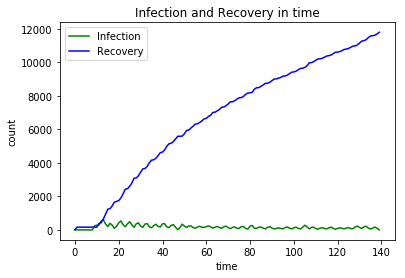

dearoomf


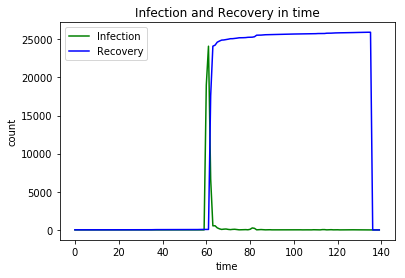

blessed


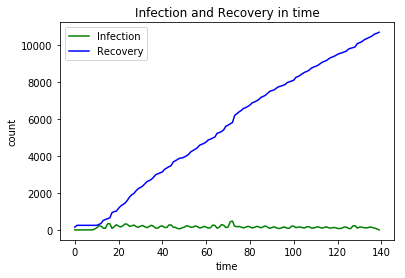

thoughtsduringschool


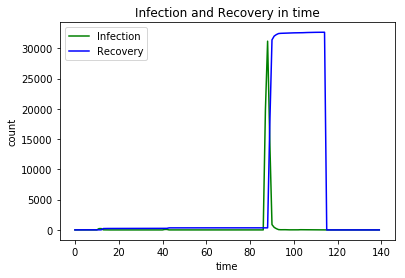

imhappywhen


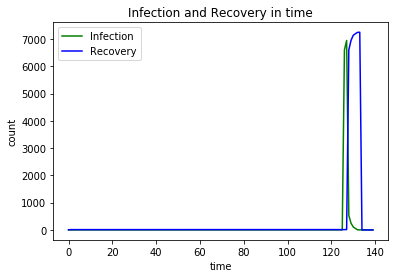

truthis


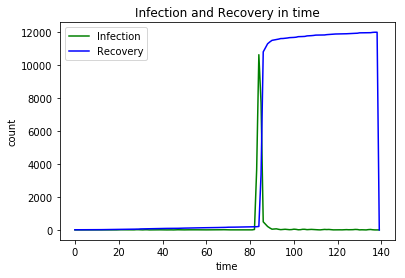

lol


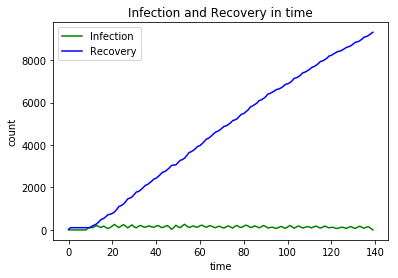

fml


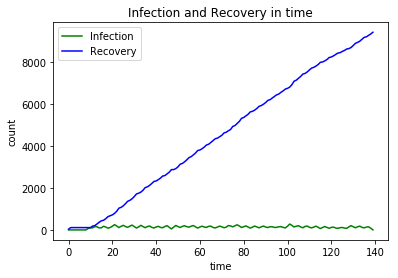

aries


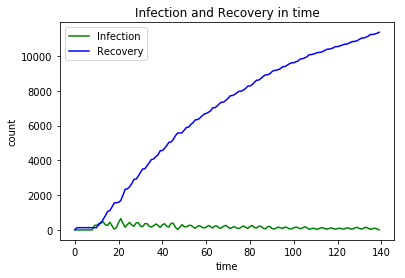

realshit


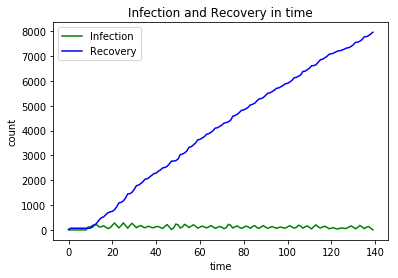

confessionhour


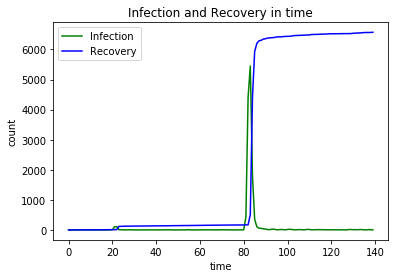

iadmit


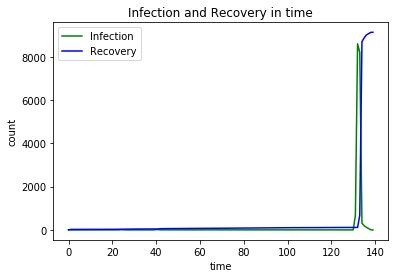

realtalk


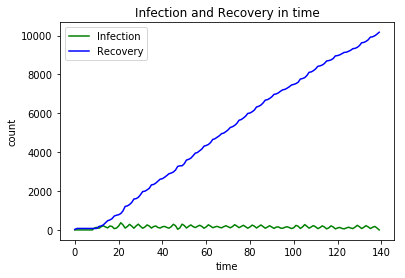

subtweet


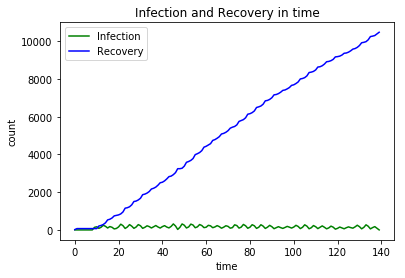

tfb


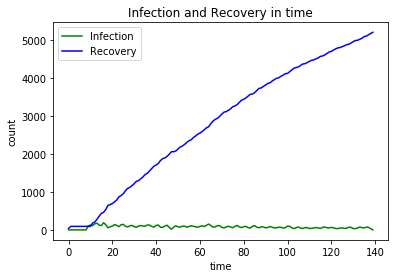

bgc


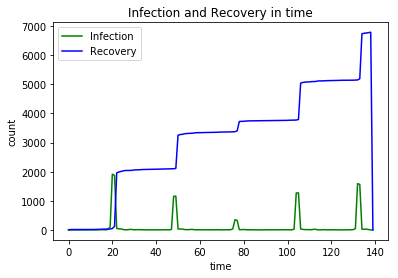

theworstfeeling


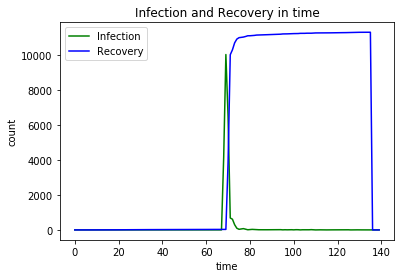

believe


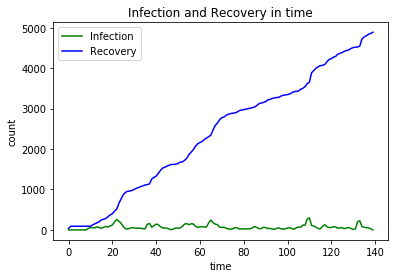

boyfriend


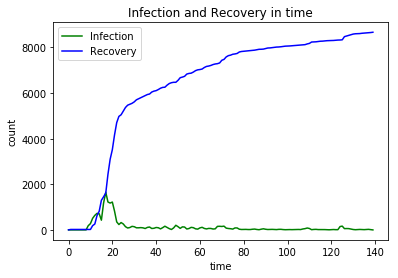

p2


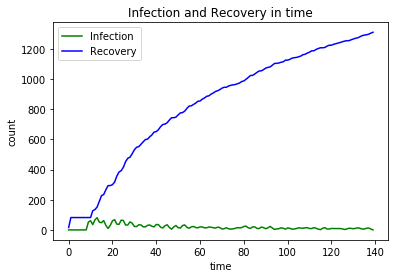

inourgeneration


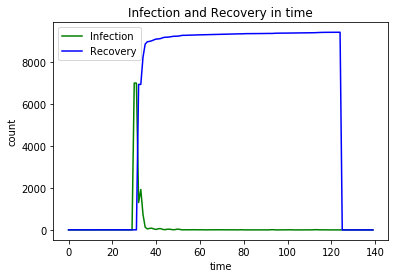

teamfollowback


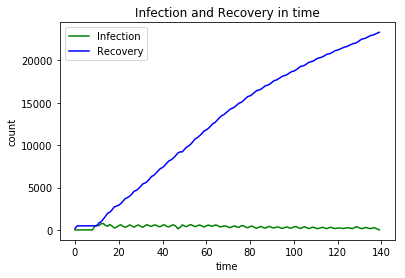

10thingsifindattractive


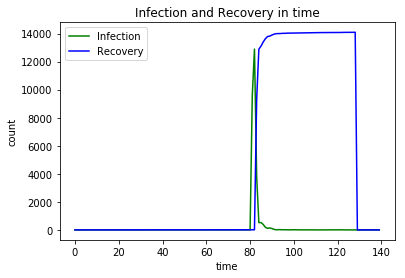

cancers


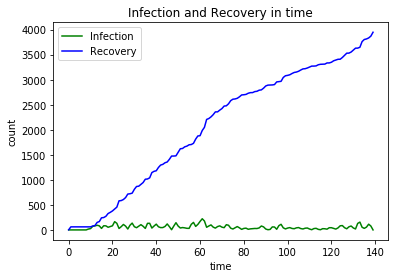

mybiggestproblem


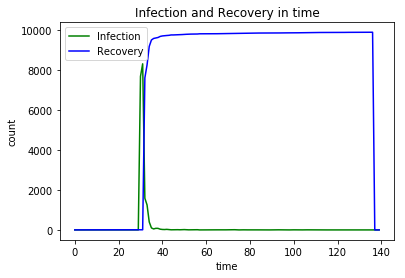

f1


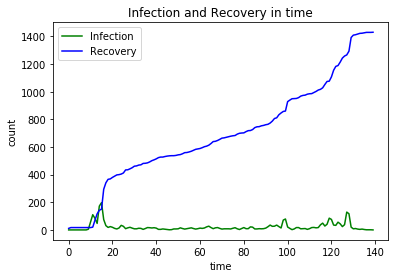

wewontworkoutif


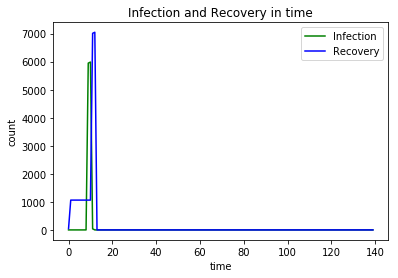

middleschoolmemories


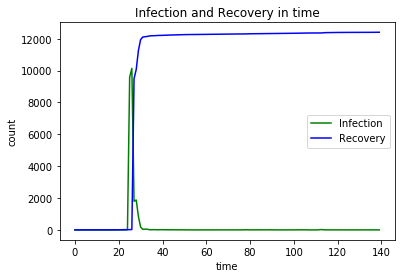

gemini


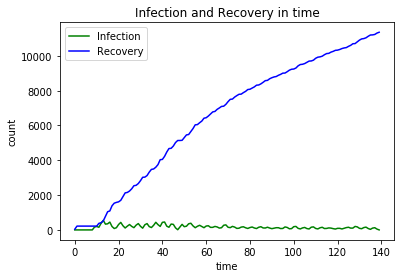

thatirritatesme


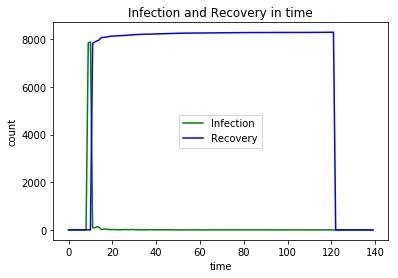

kca


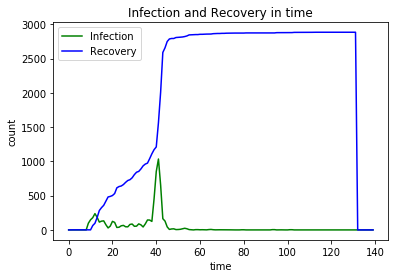

sagittarius


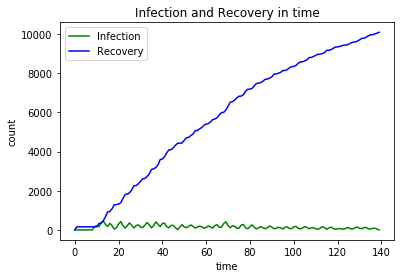

throwbackthursday


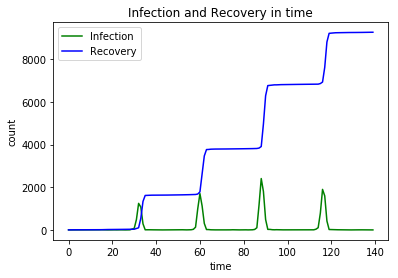

virgos


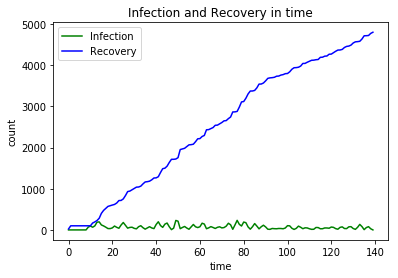

nf


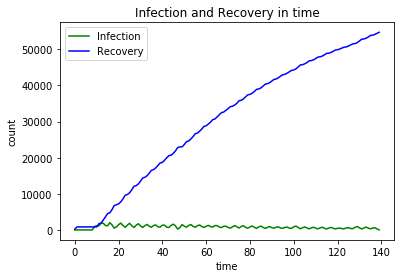

imsinglebecause


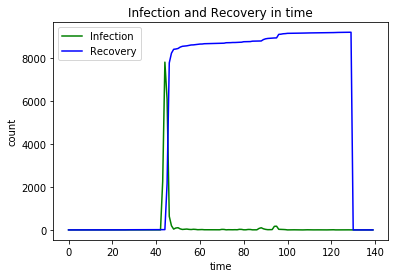

np


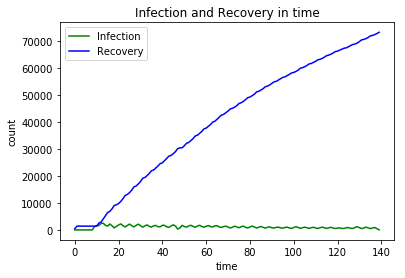

nw


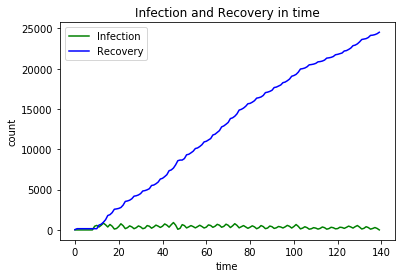

itscutewhen


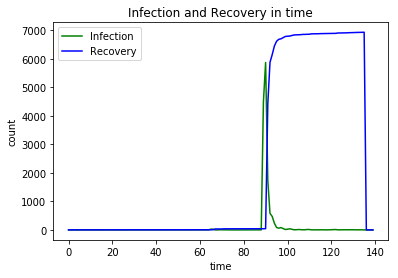

justsaying


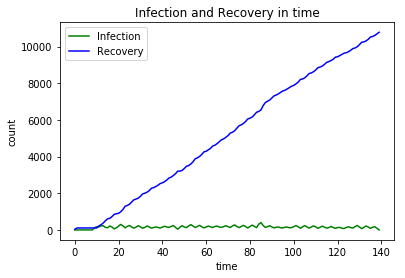

thingsmostpeoplelikebutidont


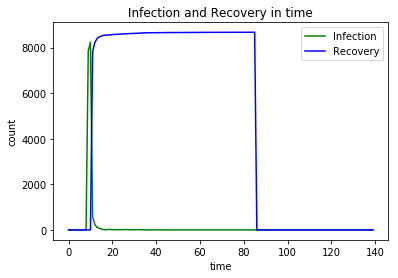

teamiphone


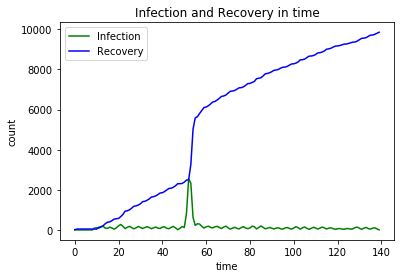

20thingsilove


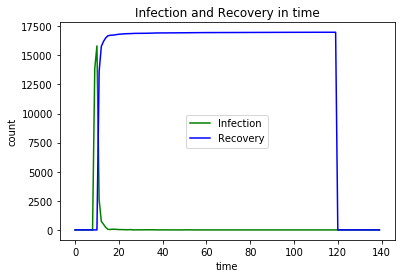

fb


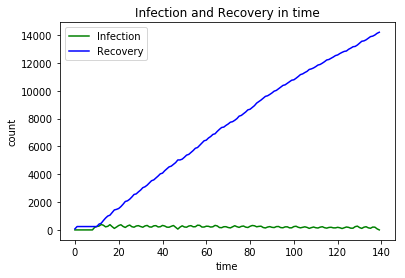

10factsaboutme


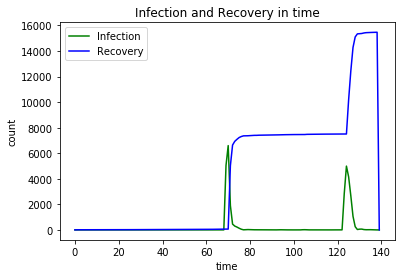

ff


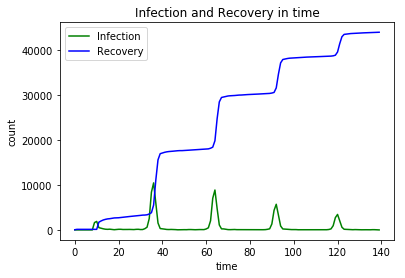

shoutout


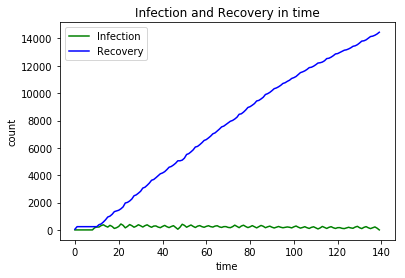

fact


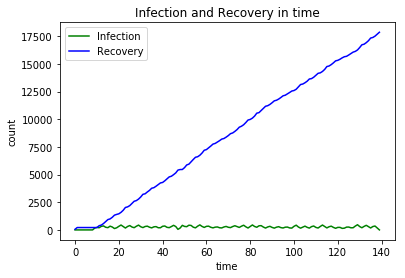

In [47]:
#Plot RECOVERY counts first
for i in (Data_rt):
        print(i)
        indx = list(Data_rt).index(i)
        pyplot.title('Infection and Recovery in time')
        pyplot.ylabel('count')
        pyplot.xlabel('time')
        pyplot.plot(df[0][indx], color = 'green', label = 'Infection')
        pyplot.plot(df[1][indx], color ='blue', label = 'Recovery')
        pyplot.legend()
        pyplot.show()

# AUTO REGRESSION:

500aday
Test MSE: 190.516


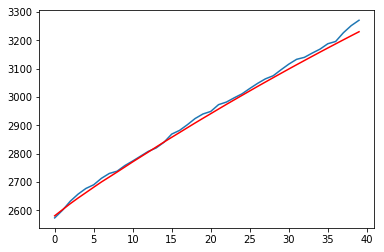

gnation
Test MSE: 2565.758


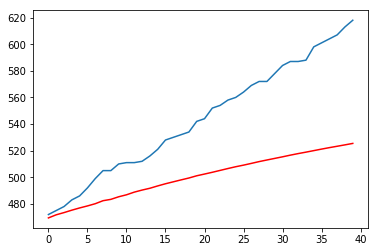

random
Test MSE: 7380.936


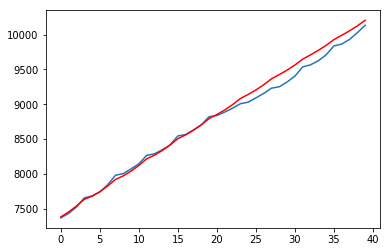

mythoughtsduringschool
Test MSE: 88776804.704


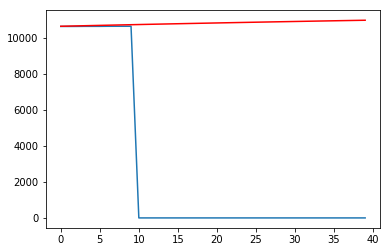

follow
Test MSE: 102561.346


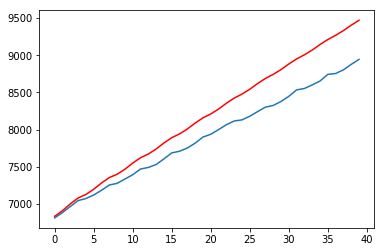

swag
Test MSE: 89363.114


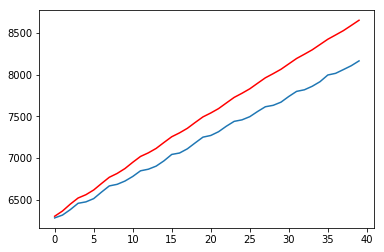

scorpio
Test MSE: 41733.903


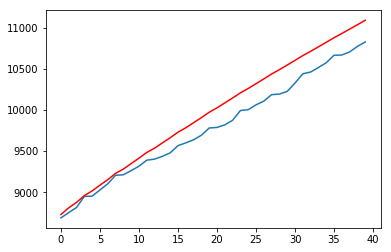

twitterpeopleilove
Test MSE: 9118755.338


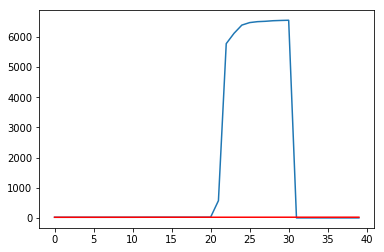

winning
Test MSE: 156156.321


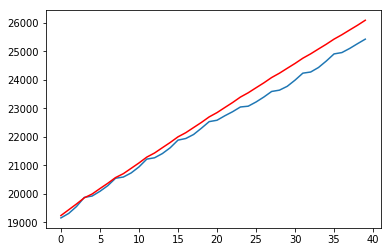

virgo
Test MSE: 16262.493


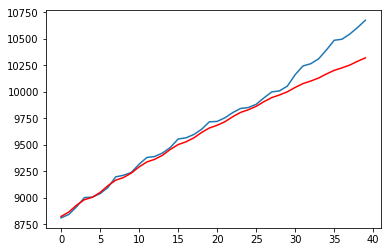

lt
Test MSE: 17658.793


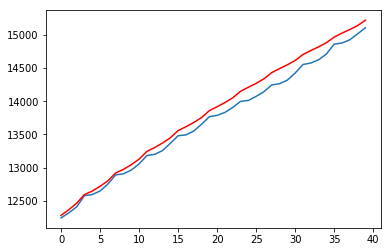

libra
Test MSE: 73235.562


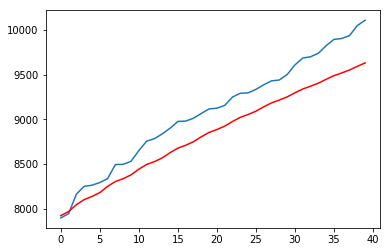

sorrynotsorry
Test MSE: 8145.134


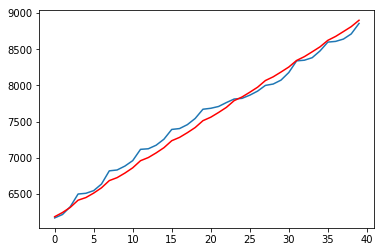

bahrain
Test MSE: 31252.566


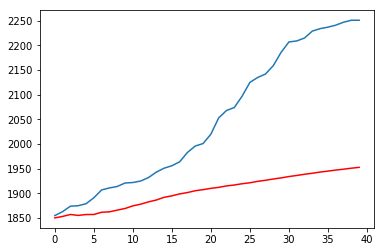

followback
Test MSE: 71065.663


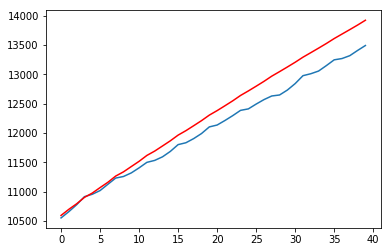

yougetpointsif
Test MSE: 47221029.360


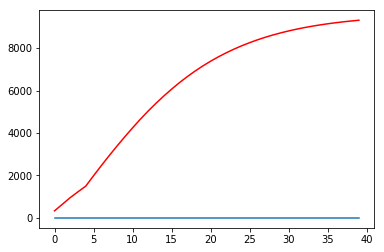

tbt
Test MSE: 29457766.827


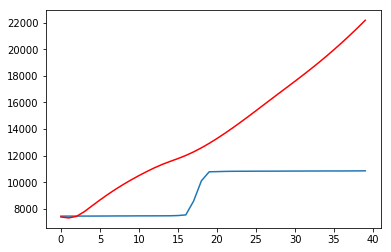

yougetmajorpointsif
Test MSE: 11804935.192


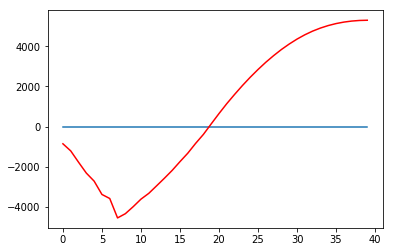

lrt
Test MSE: 3277.504


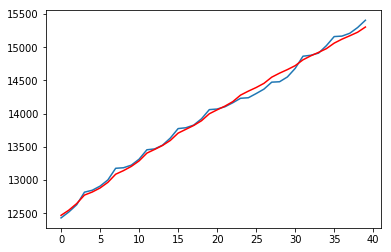

libras
Test MSE: 67270.528


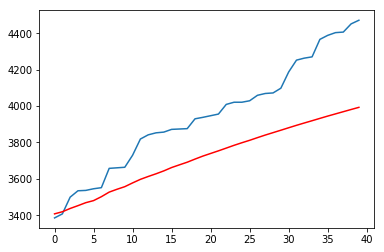

trayvonmartin
Test MSE: 136115.900


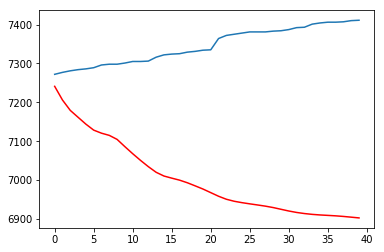

aquarians
Test MSE: 9091.966


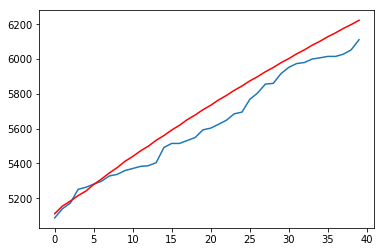

oomfs
Test MSE: 8318.081


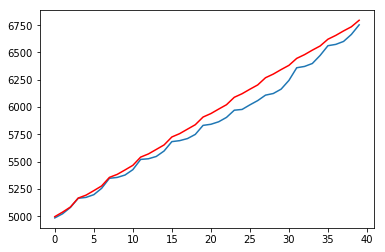

nfb
Test MSE: 78490.951


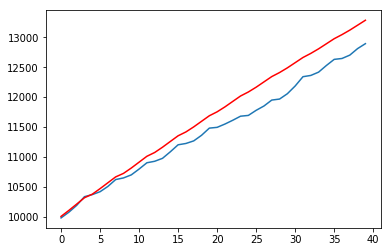

dailytweet
Test MSE: 66185.870


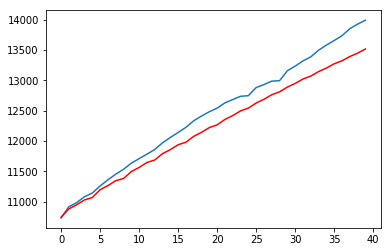

youknowwhatsannoying
Test MSE: 16339593.357


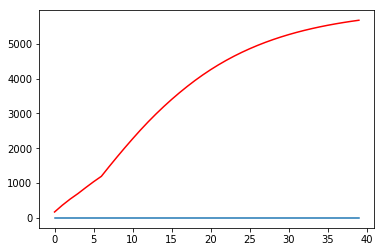

capricorn
Test MSE: 30996.373


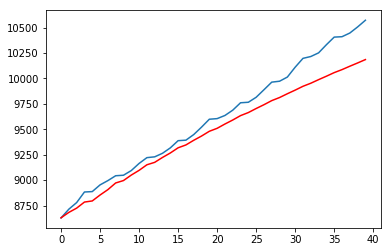

truth
Test MSE: 15232.972


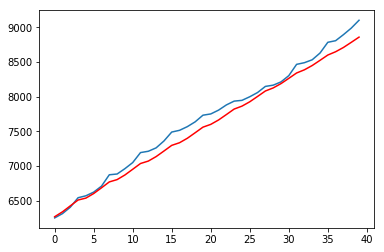

instagram
Test MSE: 12761159.866


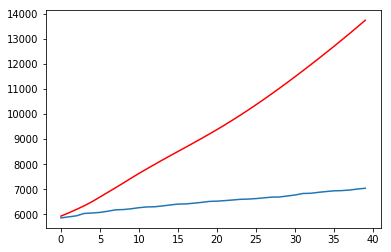

yolo
Test MSE: 2230070.233


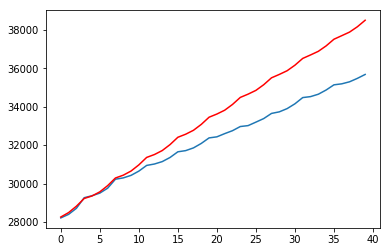

dead
Test MSE: 16468.279


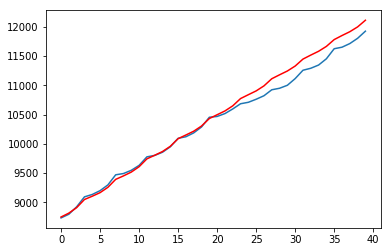

10thingsthatilike
Test MSE: 9642365.171


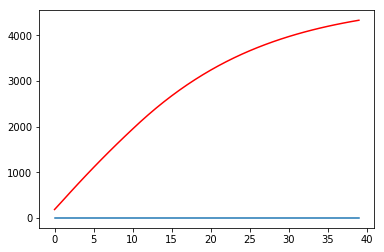

goodnight
Test MSE: 38439.207


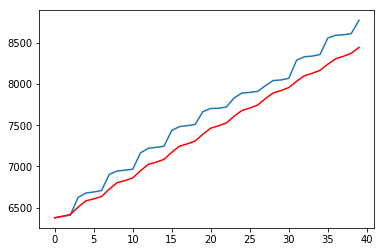

pisces
Test MSE: 2980.273


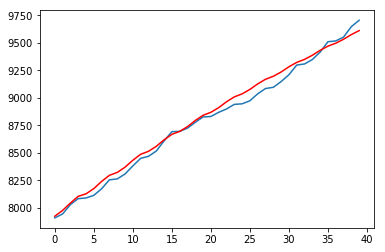

ifitwasuptome
Test MSE: 15394381.367


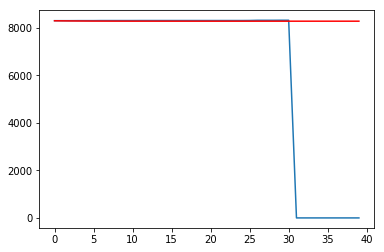

10thingsihate
Test MSE: 15506593665660786688.000


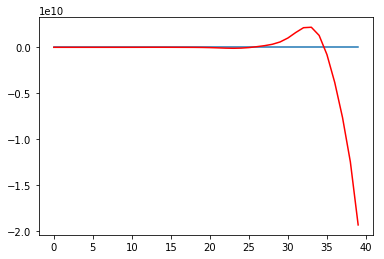

retweet
Test MSE: 4976869.389


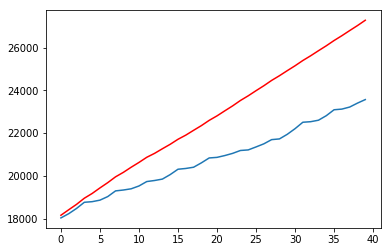

icantstandwhen
Test MSE: 96478820.727


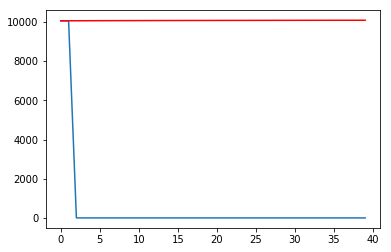

rt
Test MSE: 578059.535


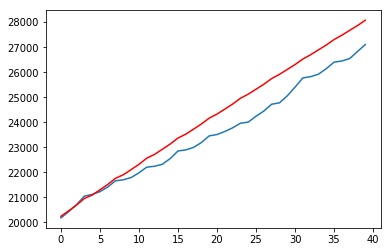

wheniwaslittle
Test MSE: 9924.061


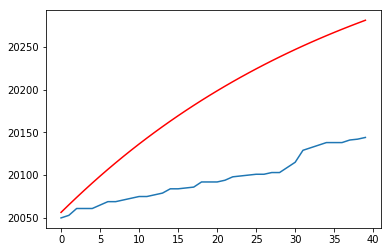

smh
Test MSE: 19519.640


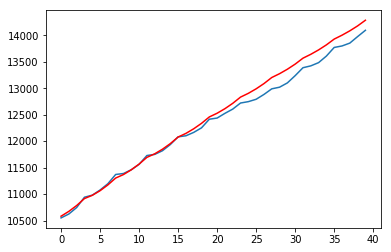

moviesthatnevergetold
Test MSE: 14844855.898


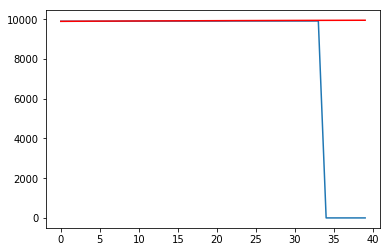

tweegram
Test MSE: 67591.246


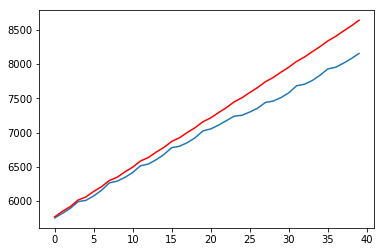

salute
Test MSE: 33221.218


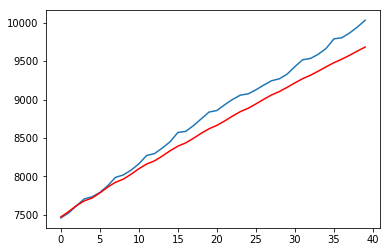

oomf
Test MSE: 993095.845


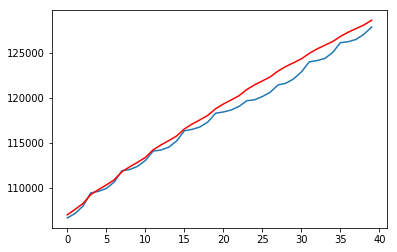

tcot
Test MSE: 3561.889


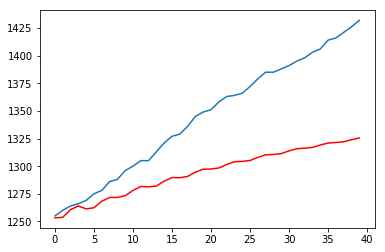

nationalbestfriendday
Test MSE: 22898407.911


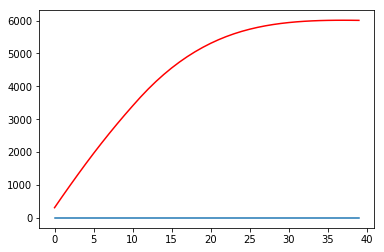

aquarius
Test MSE: 122167.935


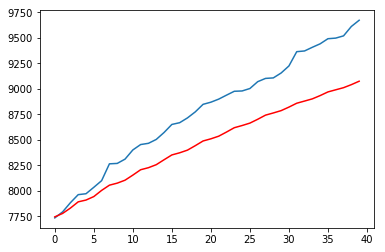

free
Test MSE: 19674.801


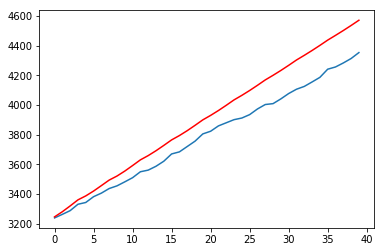

leo
Test MSE: 174615.244


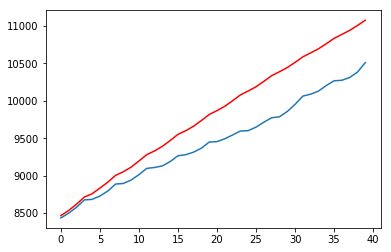

taurus
Test MSE: 19690.120


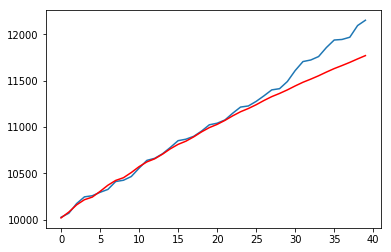

wtf
Test MSE: 15866.325


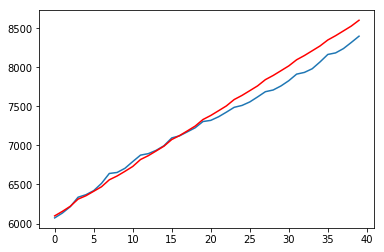

imagine
Test MSE: 14407.341


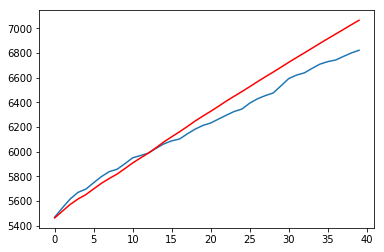

1dfact
Test MSE: 49767.832


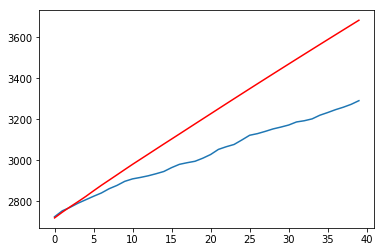

thingsigetalot
Test MSE: 79221688.581


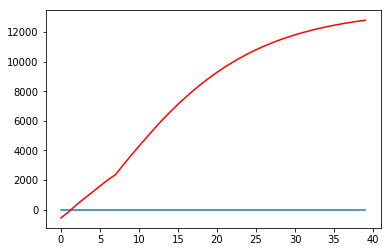

nowplaying
Test MSE: 13473.786


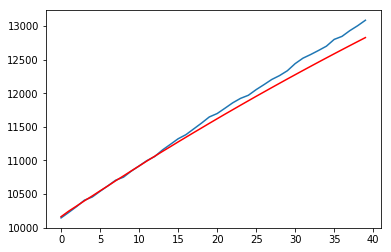

thingsisaywhilereadingmytl
Test MSE: 741382.628


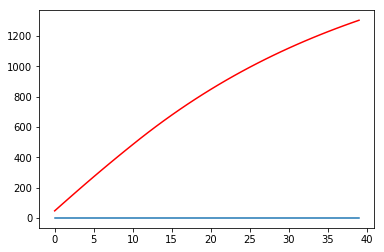

nowfollowing
Test MSE: 14369.279


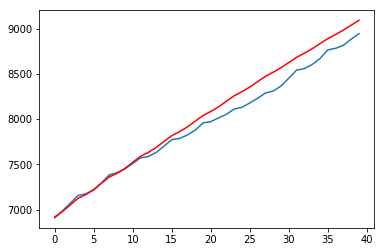

syria
Test MSE: 272.245


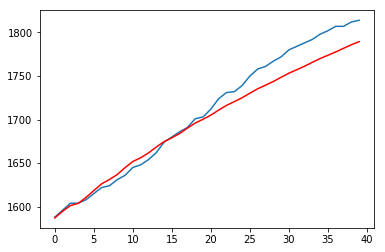

top100lies
Test MSE: 35790131.644


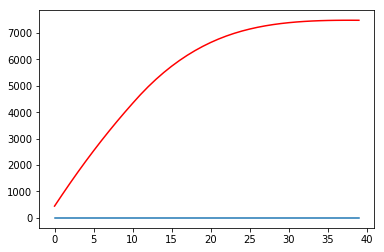

love
Test MSE: 69457.636


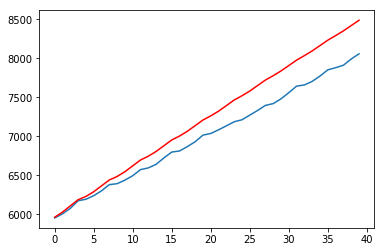

cancer
Test MSE: 186616.850


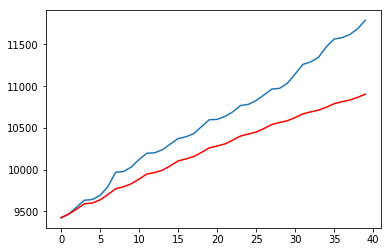

dearoomf
Test MSE: 68580362.850


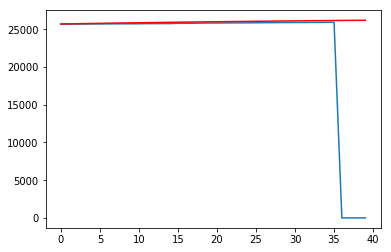

blessed
Test MSE: 1402.148


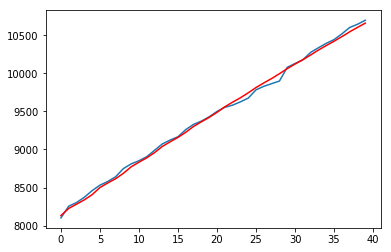

thoughtsduringschool
Test MSE: 9467290116472292.000


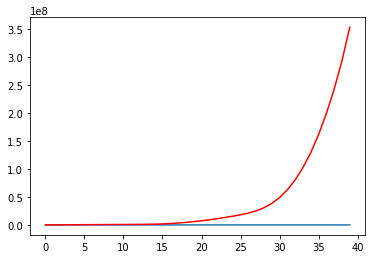

imhappywhen


ValueError: x contains a constant. Adding a constant with trend='c' is not allowed.

In [50]:
for i in Data_rt:
    print(i)
    indx = list(Data_rt).index(i)
    series = pd.Series(df[1][indx])
# create lagged dataset
    X = series.values 
    #10 here is to say we want to pedict the ten following time windows
    train, test = X[1:len(X)-40], X[len(X)-40:]
# train autoregression
    model = AR(train)
    model_fit = model.fit()
    #print('Lag: %s' % model_fit.k_ar)
    #print('Coefficients: %s' % model_fit.params)
    # make predictions
    predictions = model_fit.predict(start=len(train), end=len(train)+len(test)-1, dynamic=False)
    #for i in range(len(predictions)):
        #print('predicted=%f, expected=%f' % (predictions[i], test[i]))
    error = np.sqrt(mean_squared_error(test, predictions))
    print('Test MSE: %.3f' % error)
# plot results
    pyplot.plot(test)
    pyplot.plot(predictions, color='red')
    pyplot.show()

Defintely, AR is not a good predictor for recovery counts in Time.
very high errors

# ARIMA>> recovery

500aday
Test RMSE: 7.341


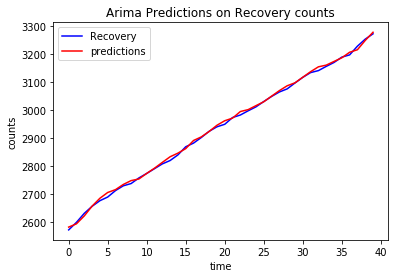

gnation
Test RMSE: 2.554


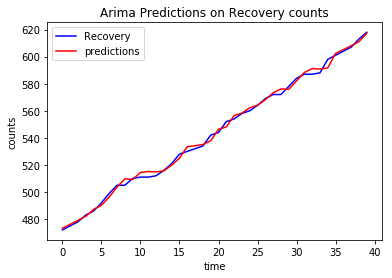

random
Test RMSE: 26.490


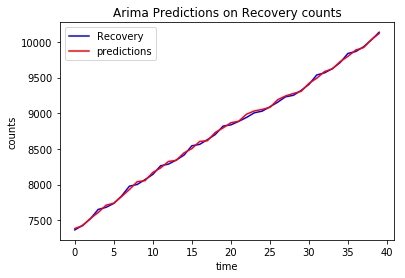

mythoughtsduringschool
SVD did not converge
follow
SVD did not converge
swag
Test RMSE: 15.637


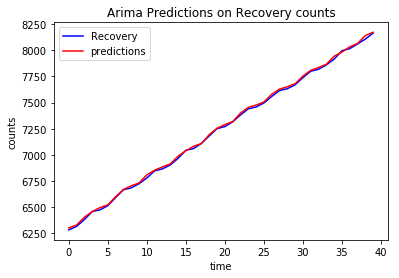

scorpio
Test RMSE: 41.322


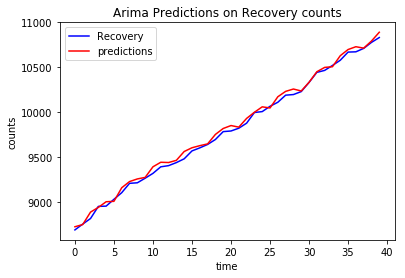

twitterpeopleilove
SVD did not converge
winning
Test RMSE: 59.863


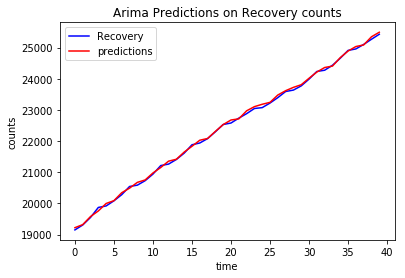

virgo
Test RMSE: 40.568


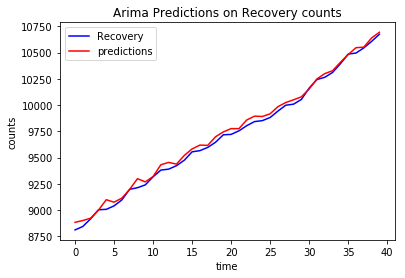

lt
SVD did not converge
libra
Test RMSE: 36.931


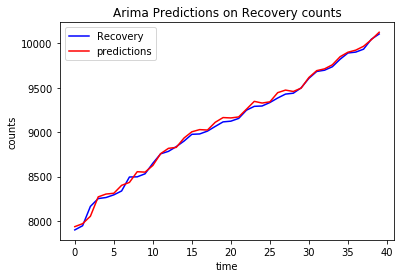

sorrynotsorry
Test RMSE: 33.218


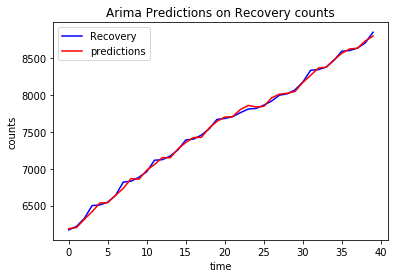

bahrain
Test RMSE: 8.147


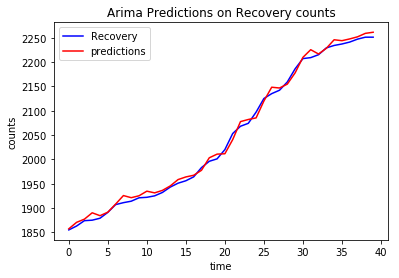

followback
Test RMSE: 33.415


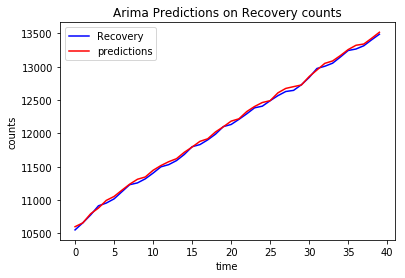

yougetpointsif
Test RMSE: 76.074


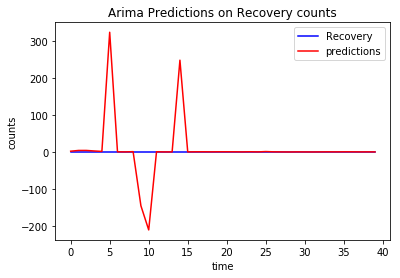

tbt
SVD did not converge
yougetmajorpointsif
Test RMSE: 8.319


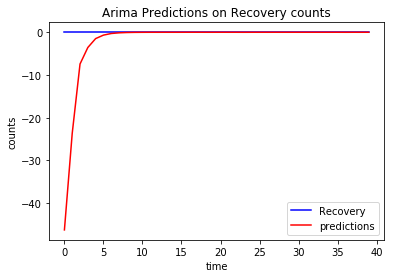

lrt
Test RMSE: 53.574


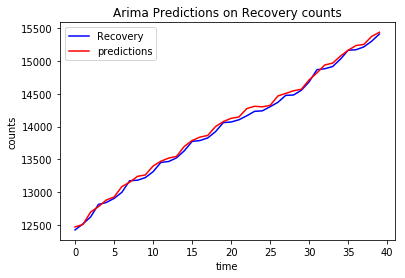

libras
Test RMSE: 31.861


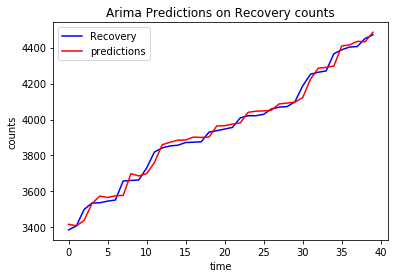

trayvonmartin
Test RMSE: 14.576


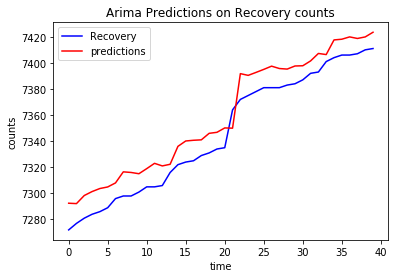

aquarians
SVD did not converge
oomfs
Test RMSE: 17.645


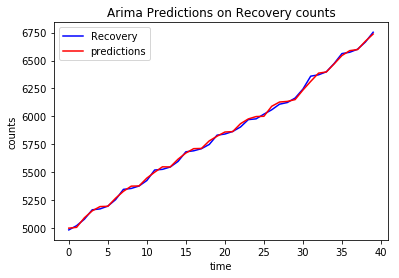

nfb
Test RMSE: 32.936


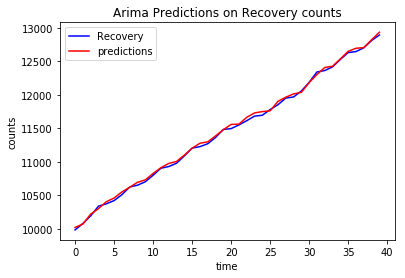

dailytweet
Test RMSE: 36.011


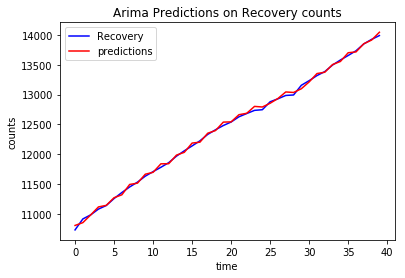

youknowwhatsannoying
SVD did not converge
capricorn
Test RMSE: 37.078


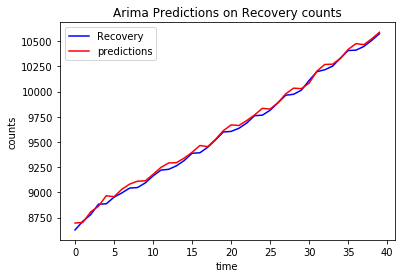

truth
Test RMSE: 31.101


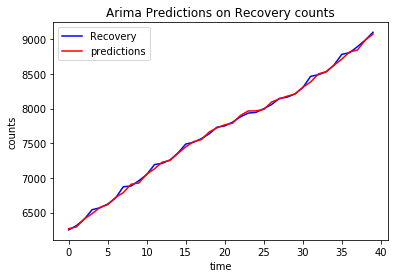

instagram
Test RMSE: 22.157


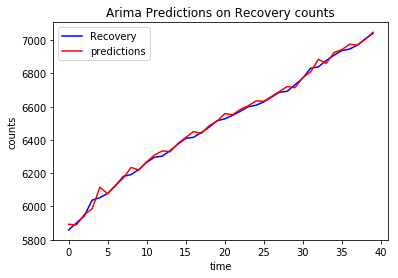

yolo
Test RMSE: 106.079


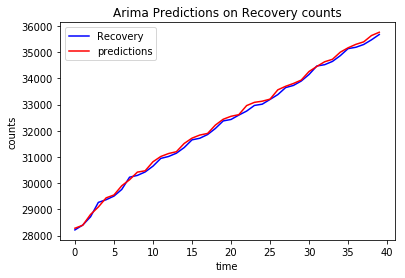

dead
Test RMSE: 28.645


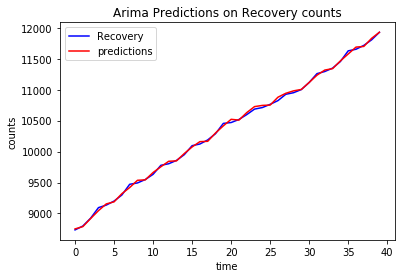

10thingsthatilike
Test RMSE: 28.060


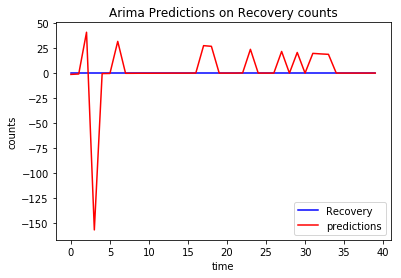

goodnight
SVD did not converge
pisces
SVD did not converge
ifitwasuptome
SVD did not converge
10thingsihate
SVD did not converge
retweet
Test RMSE: 64.176


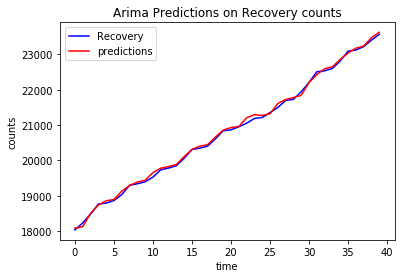

icantstandwhen
SVD did not converge
rt
Test RMSE: 74.023


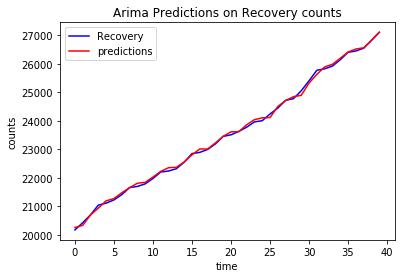

wheniwaslittle
SVD did not converge
smh
Test RMSE: 36.305


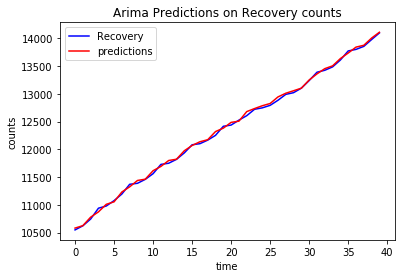

moviesthatnevergetold
SVD did not converge
tweegram
Test RMSE: 22.241


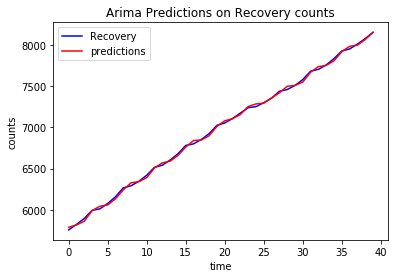

salute
Test RMSE: 28.613


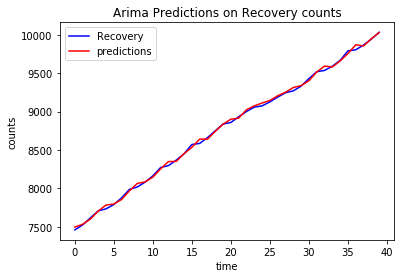

oomf
Test RMSE: 501.492


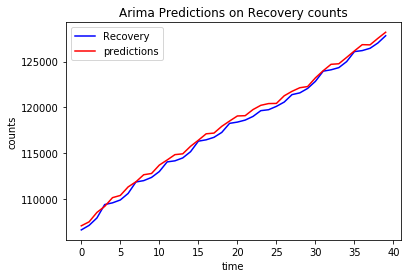

tcot
Test RMSE: 3.330


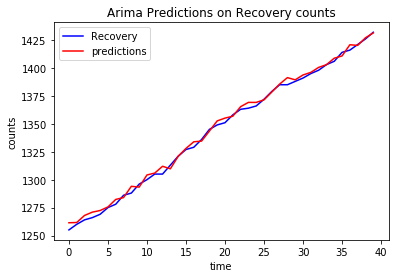

nationalbestfriendday
Test RMSE: 0.003


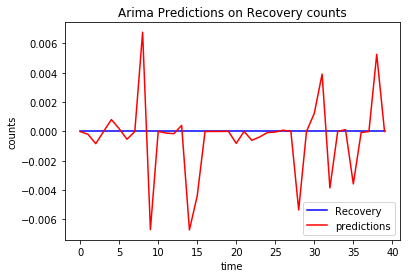

aquarius
Test RMSE: 37.508


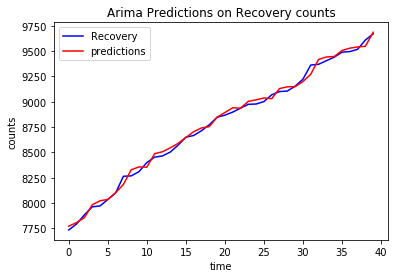

free
Test RMSE: 11.580


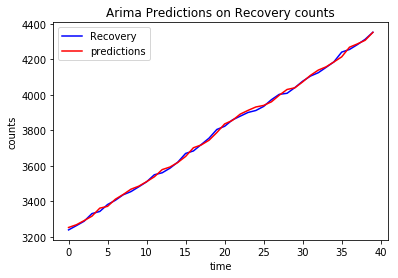

leo
Test RMSE: 37.628


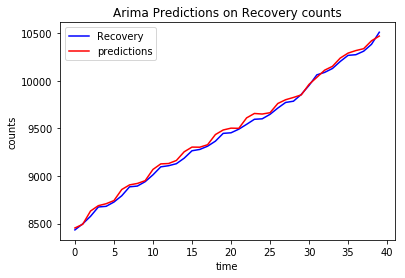

taurus
SVD did not converge
wtf
Test RMSE: 21.019


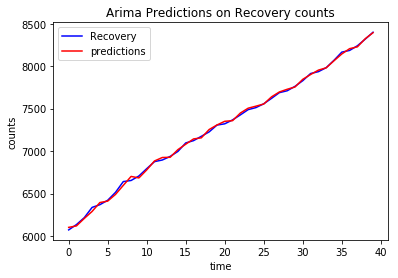

imagine
Test RMSE: 15.617


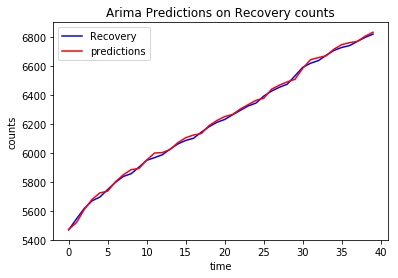

1dfact
Test RMSE: 6.475


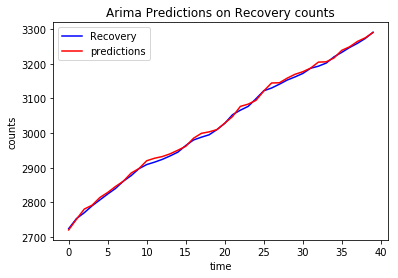

thingsigetalot
SVD did not converge
nowplaying
SVD did not converge
thingsisaywhilereadingmytl
Test RMSE: 0.042


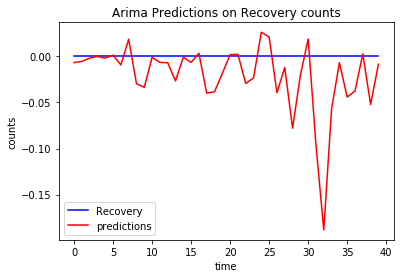

nowfollowing
Test RMSE: 20.980


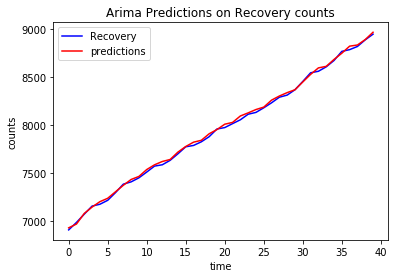

syria
Test RMSE: 4.824


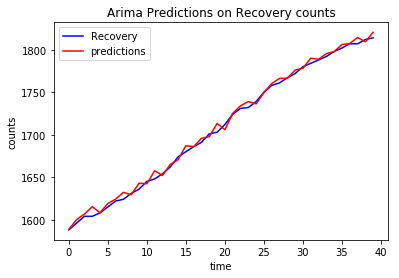

top100lies
Test RMSE: 0.008


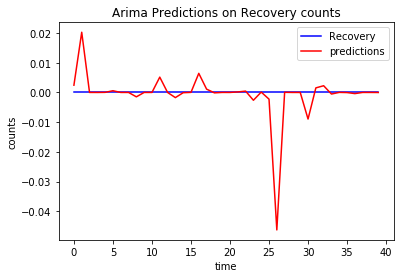

love
Test RMSE: 16.986


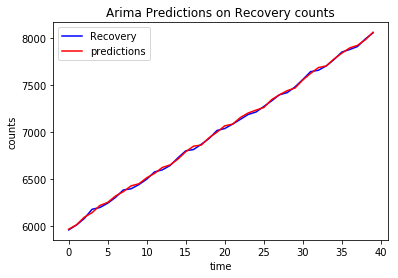

cancer
Test RMSE: 42.013


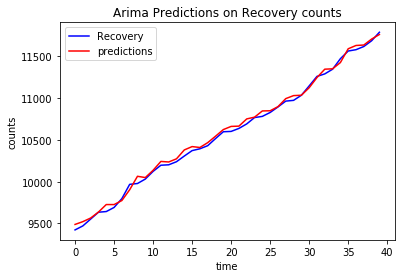

dearoomf
SVD did not converge
blessed
SVD did not converge
thoughtsduringschool
SVD did not converge
imhappywhen
SVD did not converge
truthis
SVD did not converge
lol
Test RMSE: 20.950


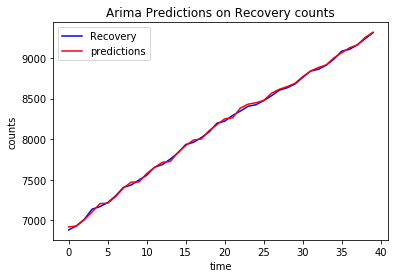

fml
Test RMSE: 28.745


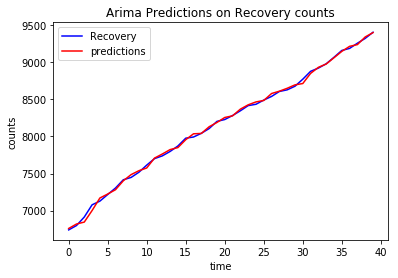

aries
SVD did not converge
realshit
Test RMSE: 24.696


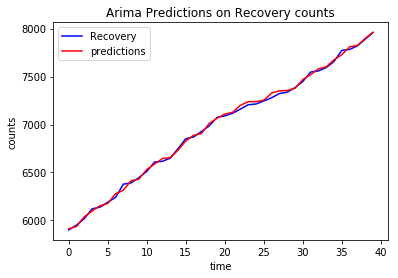

confessionhour
SVD did not converge
iadmit
SVD did not converge
realtalk
Test RMSE: 29.400


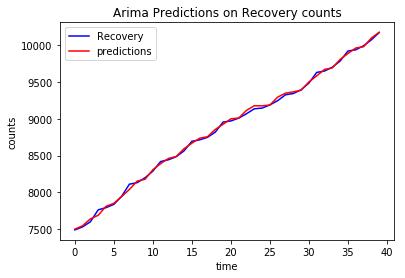

subtweet
Test RMSE: 27.655


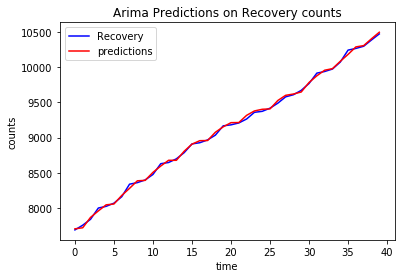

tfb
Test RMSE: 16.154


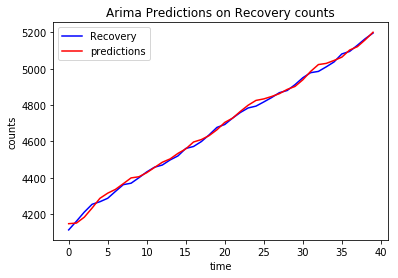

bgc
SVD did not converge
theworstfeeling
SVD did not converge
believe
Test RMSE: 46.059


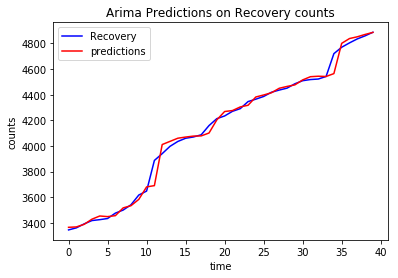

boyfriend
Test RMSE: 26.768


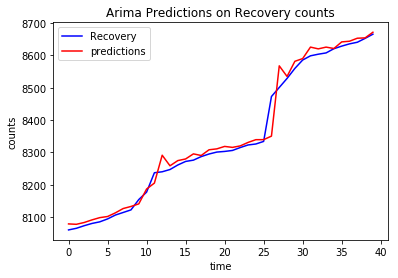

p2
Test RMSE: 3.438


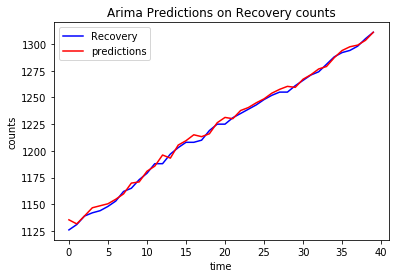

inourgeneration
SVD did not converge
teamfollowback
Test RMSE: 53.984


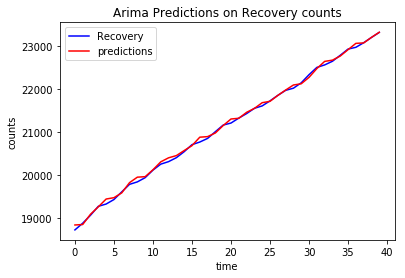

10thingsifindattractive
SVD did not converge
cancers
SVD did not converge
mybiggestproblem
Test RMSE: 1590.975


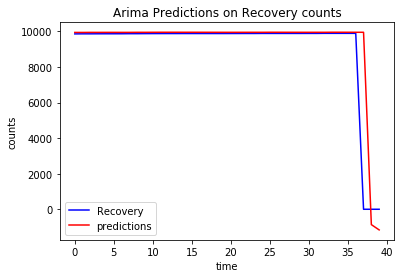

f1
Test RMSE: 19.601


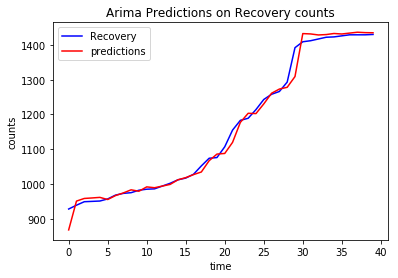

wewontworkoutif
SVD did not converge
middleschoolmemories
Test RMSE: 85.334


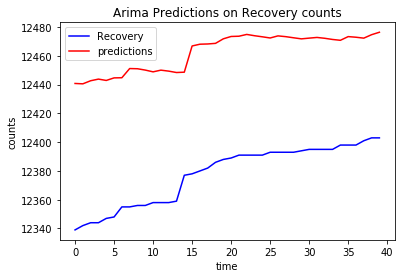

gemini
SVD did not converge
thatirritatesme
SVD did not converge
kca
SVD did not converge
sagittarius
SVD did not converge
throwbackthursday
SVD did not converge
virgos
Test RMSE: 21.704


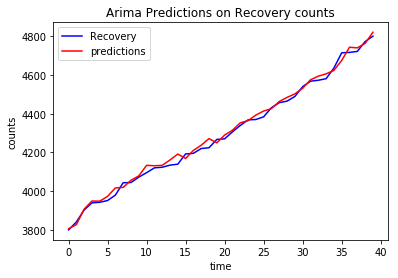

nf
Test RMSE: 170.547


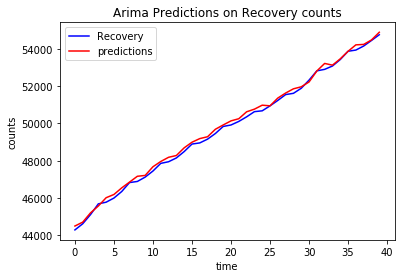

imsinglebecause
Test RMSE: 1549.839


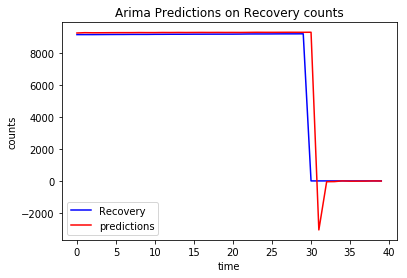

np
Test RMSE: 177.649


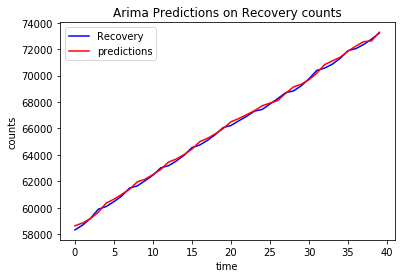

nw
Test RMSE: 76.903


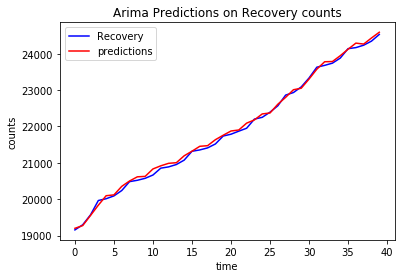

itscutewhen
Test RMSE: 1162.355


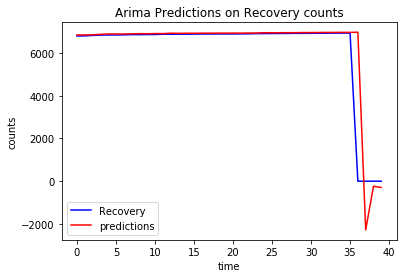

justsaying
Test RMSE: 23.413


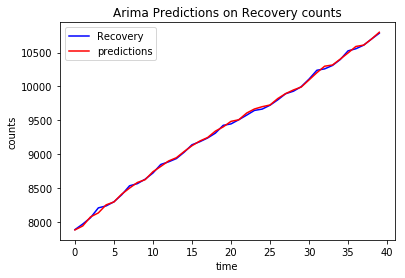

thingsmostpeoplelikebutidont
Test RMSE: 0.001


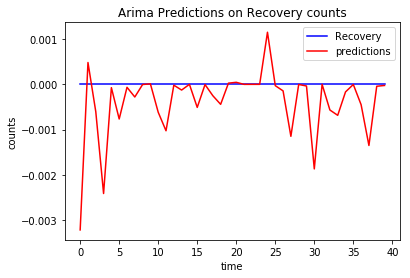

teamiphone
Test RMSE: 41.490


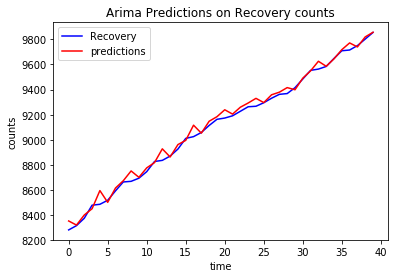

20thingsilove
SVD did not converge
fb
Test RMSE: 33.815


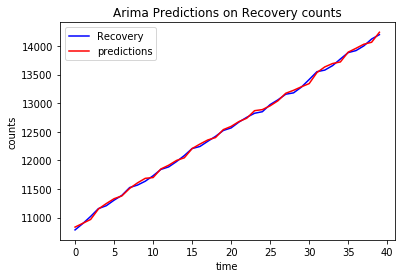

10factsaboutme
SVD did not converge
ff
Test RMSE: 214.366


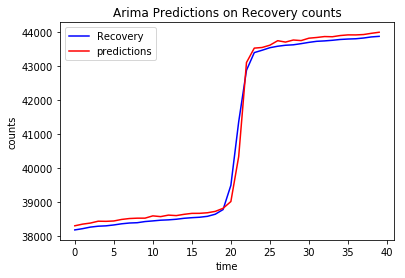

shoutout
Test RMSE: 31.105


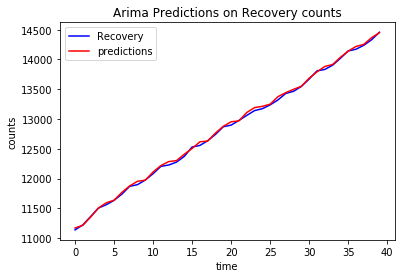

fact
Test RMSE: 41.376


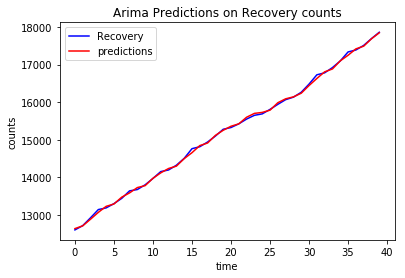

In [39]:
from pandas import read_csv
from pandas import datetime
from matplotlib import pyplot
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
# load dataset
high_err_tag_rec = []
for i in Data_rt:
    try:
        print(i)
        def parser(x):
            return datetime.strptime('190'+x, '%Y-%m')
        indx = list(Data_rt).index(i)
        series = pd.Series(df[1][indx])
        X = series.values
        train, test = X[0:-40], X[-40:]
        history = [x for x in train]
        predictions = list()
# walk-forward validation
        for t in range(0,len(test)):
# fit model
            model = ARIMA(history, order=(2,1,2))
            model_fit = model.fit()
# one step forecast
            yhat = model_fit.forecast()[0]
# store forecast and ob
            predictions.append(yhat)
            history.append(test[t])
# evaluate forecasts
        rmse = sqrt(mean_squared_error(test, predictions))
        print('Test RMSE: %.3f' % rmse)
        if rmse >30:
            high_err_tag_rec.append((i,rmse))
        
# plot forecasts against actual outcomes
        pyplot.title("Arima Predictions on Recovery counts")
        pyplot.ylabel('counts')
        pyplot.xlabel('time')
        pyplot.plot(test, color = 'blue', label = 'Recovery')
        pyplot.plot(predictions, color='red', label = 'predictions')
        pyplot.legend()
        pyplot.show()
    except:
        print('SVD did not converge')
        pass

In [40]:
len(high_err_tag_rec)

35

ARIMA seems reasonable treating Recovery data, I believe the time series of recovery mostly not looking seasonal, So I believe so far, ARIMA is the best but maybe a grid search of parameters would improve the errors.

GRID Search ARIMA:

In [22]:
p = d = q = range(0, 3) # Define the p, d and q parameters to take any value between 0 and 3
pdq = list(itertools.product(p, d, q)) # Generate all different combinations of p, q and q triplets

In [30]:
import warnings
warnings.filterwarnings("ignore")
m = []
data = df[1][4]
for param in pdq:
    mod = ARIMA(data,order=param)
    results = mod.fit()
    m.append((param, results.aic))

In [37]:
list(np.array(m).T[1]).index(min(np.array(m).T[1]))

23

In [38]:
np.array(m).T[0][23]

(2, 1, 2)

# Markov Chain Monte Carlo, Matroplis Hasting

# General Epedimic Model:

1) Each infectious individual remains so for a length of time T ~ exp(gamma)

2) During this time, infectious contacts occurwith each susceptible according to a Poisson process of rate (beta/N)

3) OVERALL infection rate:

$\frac{dI}{dt} = \frac{\beta S_{t} I_{t}}{N} $

4) Two model parameters, Beta and Gamma

5) STANDARD INFERENCE Problem:
standard inference problem: we observe infection and removal times and wish to perform Bayesian inference for Beta and gamma


$Psterior \propto Likelihood * Prior$

LIKELIHOOD

$\prod_{j=2}^{n} (\beta/N) S_{ij} I_{ij} \prod_{j=1}^{n} \gamma I_{rj}  * exp[-\int_{i_1}^{r_n} {(\beta/N)S_{t}I_{t}+\gamma I_{t}}]dt $

# Computation functions:


In [18]:
# count the number of infectives just before time t.
def count_inf_t(it, rt, t):
    s1 = []
    s2= []
    count = []
    # individual -i- is infected just before time t, if this holds:  I_i < t < R_i
    for i in range(0, len(it)):
        if it[i] < t:
            s1.append(it[i])
        if rt[i] < t:
            s2.append(rt[i])
    count = sum(s2) - sum(s1)
    return count

$\int  S_{t} I_{t} dt$

The reason why this double sum represebts the term in the integral {S(t)I(t)} is because the infective time at point i is considered infected while at point j which is latter is susciptible.
I believe this is a crude approximation but could be working!

In [19]:
###############################################################
# compute the integral \int_{t} S_t I_t dt using a double sum.
###############################################################

def double_sum(Inf_times, Rec_times, fs):
    total = 0
    dbl = []
    N = fs
    for i in range(1,fs):
        for j in range(1,N):
            total =total + (min(Rec_times[i],Inf_times[j]) - min(Inf_times[i], Inf_times[j]))
    return total

$\prod_{j\neq a}  I_{i_j} $ 

In [20]:
######################################################
# compute the log of the product \prod_{j!=1} I_{i_j}
######################################################
def log_prod(inf_time, rec_time, final_size):
    # find the index of the initial infective.
    time_init_inf =min(inf_time)
    index_init_inf = list(inf_time).index(time_init_inf)
    product = []
    
    for i in range(0,final_size): 
        if i!=index_init_inf:
            #prod = math.log(abs(count_inf_t(inf_time, rec_time, inf_time[i])))
            #product.append(prod)
            #return sum(product)
                if count_inf_t(inf_time, rec_time, inf_time[i]) != 0:
                    prod = math.log(abs(count_inf_t(inf_time, rec_time, inf_time[i])))
                    product.append(prod)
    return sum(product)

# Application

I'll apply the the function on the hashtags that seem to be showing the most interesting behaviour in infection and recovery, and will provide the code that' gives the result for each hastag.
Being Computationally heavy I won't run it.

In [20]:
for i in Data_rt:
    print(i)

500aday
gnation
random
mythoughtsduringschool
follow
swag
scorpio
twitterpeopleilove
winning
virgo
lt
libra
sorrynotsorry
bahrain
followback
yougetpointsif
tbt
yougetmajorpointsif
lrt
libras
trayvonmartin
aquarians
oomfs
nfb
dailytweet
youknowwhatsannoying
capricorn
truth
instagram
yolo
dead
10thingsthatilike
goodnight
pisces
ifitwasuptome
10thingsihate
retweet
icantstandwhen
rt
wheniwaslittle
smh
moviesthatnevergetold
tweegram
salute
oomf
tcot
nationalbestfriendday
aquarius
free
leo
taurus
wtf
imagine
1dfact
thingsigetalot
nowplaying
thingsisaywhilereadingmytl
nowfollowing
syria
top100lies
love
cancer
dearoomf
blessed
thoughtsduringschool
imhappywhen
truthis
lol
fml
aries
realshit
confessionhour
iadmit
realtalk
subtweet
tfb
bgc
theworstfeeling
believe
boyfriend
p2
inourgeneration
teamfollowback
10thingsifindattractive
cancers
mybiggestproblem
f1
wewontworkoutif
middleschoolmemories
gemini
thatirritatesme
kca
sagittarius
throwbackthursday
virgos
nf
imsinglebecause
np
nw
itscutewhen
jus

Hashtags of interest: ff, tbt, throwbackthursday

In [16]:
fs = 1000
N = 1000
#N,fs
# Assume  for the parameters beta and gamma
lmda_beta = 1.0
nu_beta = 10**(-3)

lmda_gamma= 1.0  
nu_gamma= 10**(-3)

In [21]:
I_time_one = Inf_time_dict['Inf_times_ff']
I_time_one = [i for i in I_time_one if i != 0]
I_time_two = Inf_time_dict['Inf_times_tbt']
I_time_two = [i for i in I_time_two if i != 0]
I_time_three = Inf_time_dict['Inf_times_throwbackthursday']
I_time_three = [i for i in I_time_three if i != 0]

In [22]:
R_time_one = Rec_time_dict['Rec_times_ff']
R_time_one = [i for i in R_time_one if i != 0]
R_time_two = Rec_time_dict['Rec_times_tbt']
R_time_two = [i for i in R_time_two if i != 0]
R_time_three = Rec_time_dict['Rec_times_throwbackthursday']
I_time_three = [i for i in I_time_three if i != 0]

# ff initial values

In [23]:
#initial values
start_time = time.time()
fs = 1000
N = 1000
#N,fs
# Assume  for the parameters beta and gamma
lmda_beta = 1.0
nu_beta = 10**(-3)
lmda_gamma= 1.0  
nu_gamma= 10**(-3)
# compute the current values of the double sum and the log(product).
double_sum_cur_ff=double_sum(I_time_one, R_time_one,fs)
log_prod_cur_ff = log_prod(I_time_one, R_time_one, fs)
elapsed_time = time.time() - start_time
print(elapsed_time)

30.0562181473


In [24]:
RminusI_cur_ff = sum(np.array(R_time_one[0:1000]) - np.array(I_time_one[0:1000]))

In [20]:
# initial values for beta and gamma - draw from the full conditionals.
#initial values make the biggest difference in inference... duh!
#I'll follow the initial values in the suggested study then I will follow with a survey of values.
n = 1
shapeB = fs - 1 +lmda_beta
shapeg = fs +lmda_gamma
d1 = nu_beta + (double_sum_cur_ff/N)
d2 = nu_gamma+(RminusI_cur_ff/N)
beta_cur_ff= np.random.gamma(shape=shapeB, scale=1, size=None)/d1
gamma_cur_ff= np.random.gamma(shape=shapeg, scale=1, size=None)/d2

# tbt initial values

In [21]:
double_sum_cur_tbt=double_sum(I_time_two, R_time_two,fs)
log_prod_cur_tbt = log_prod(I_time_two, R_time_two, fs)

In [22]:
RminusI_tbt = sum(np.array(R_time_two[0:1000]) - np.array(I_time_two[0:1000]))

In [23]:
shapeB = fs - 1 +lmda_beta
shapeg = fs +lmda_gamma
d1 = nu_beta + (double_sum_cur_tbt/N)
d2 = nu_gamma+(IminusR_tbt/N)
beta_cur_tbt= np.random.gamma(shape=shapeB, scale=1, size=None)/d1
gamma_cur_tbt= np.random.gamma(shape=shapeg, scale=1, size=None)/d2

NameError: name 'IminusR_tbt' is not defined

# throwback initial values

In [24]:
double_sum_cur_throw=double_sum(I_time_three, R_time_three,fs)
log_prod_cur_throw = log_prod(I_time_three, R_time_three, fs)

In [25]:
RminusI_throw = sum(np.array(R_time_three[0:1000]) - np.array(I_time_three[0:1000]))

In [26]:
shapeB = fs - 1 +lmda_beta
shapeg = fs +lmda_gamma
d1 = nu_beta + (double_sum_cur_throw/N)
d2 = nu_gamma+(RminusI_throw/N)
beta_cur_throw= np.random.gamma(shape=shapeB, scale=1, size=None)/d1
gamma_cur_throw= np.random.gamma(shape=shapeg, scale=1, size=None)/d2

In [27]:
import numpy as np
niter = 1000
Result = np.zeros((niter,3), dtype=float)

# MCMC Function 

In [17]:
##########################
# MCMC loop starts here  # 
##########################
def mcmcsir(niter,I_time,R_time, double_sum_cur,log_prod_cur,RminusI_cur, beta_cur,gamma_cur,fs, result):
    N = fs
    lmda_beta = 1.0
    nu_beta = 10**(-3)

    lmda_gamma= 1.0  
    nu_gamma= 10**(-3)

    result[0,0] = beta_cur
    result[0,1] = gamma_cur
    result[0,2] = sum(I_time)
    for i in range(1,niter):

    ########################
    # update infection times
    ########################

    # first choose an individual whose infection time will be updated.
        a= np.linspace(1,fs,fs)
        choose_ind = np.random.choice(a)
        choose_ind = int(choose_ind)
    # record the current value and propose a candidate value
        inf_time_cur= I_time[choose_ind]
        inf_time_can= R_time[choose_ind] - np.random.exponential(scale = 1/abs(gamma_cur), size = None)
    # compute the (new) value of the double sum, log(prod) and sum.R.minus.I
    
    # first update the data frame data which is used for the computation of the quantities of interest
        I_time[choose_ind]= inf_time_can
        
    # compute the log product first. The proposed move should be consistent with the observed data,
    # i.e. results into the same final size. Otherwise, the move is rejected straight away.
    
        log_prod_can= log_prod(I_time, R_time, fs)

        if (log_prod_can != -float('inf')):

      # compute the other two quantities
            double_sum_can = double_sum(I_time, R_time, fs)
            RminusI_can= sum(np.array(R_time)-np.array(I_time))

      # compute the log(q_ratio);
            x1 = (R_time[choose_ind] - inf_time_cur)
            x2 = (R_time[choose_ind] - inf_time_can)
            q1= np.log(np.random.exponential(abs(x1)))
            q2= np.log(np.random.exponential(abs(x2)))
            log_q_ratio = q1-q2

            log_pi_can =  log_prod_can - (beta_cur/N)*double_sum_can - (gamma_cur*RminusI_can)
            log_pi_cur= log_prod_cur - (beta_cur/N)*double_sum_cur - (gamma_cur*RminusI_cur);
      
      
      # accept/reject move
            u = np.random.uniform(low=0.0, high=1.0, size=None)
      
            if np.log(u) < (log_pi_can - log_pi_cur + log_q_ratio):

                log_prod_cur = log_prod_can
                double_sum_cur = double_sum_can
                RminusI_cur= RminusI_can
      
            
            
    
            else:
                I_time[choose_ind]= inf_time_cur
        else:
            I_time[choose_ind]= inf_time_cur;
    #################    
    # update beta&gamma
    #################
        shapeB = fs - 1 +lmda_beta
        shapeg = fs +lmda_gamma
        d1 = nu_beta + (double_sum_cur/N)
        d2 = nu_gamma+ (RminusI_cur/N)
        beta_cur= np.random.gamma(shape=shapeB, scale=1, size=None)/d1
        gamma_cur= np.random.gamma(shape=shapeg, scale=1, size=None)/d2
        result[i,0]= beta_cur
        result[i,1]= gamma_cur
        result[i,2]= sum(I_time)
    return result

# ff Results:

In [70]:
import numpy as np
niter = 1000
result_ff = np.zeros((niter,3), dtype=float)

In [71]:
time0 = time.time()
result_ff= mcmcsir(niter,I_time_one[0:1001],R_time_one[0:1001], double_sum_cur_ff,log_prod_cur_ff,RminusI_cur_ff,beta_cur_ff, gamma_cur_ff, result_ff)
elapsed = time.time() - time0
print(elapsed)

1341.34583783


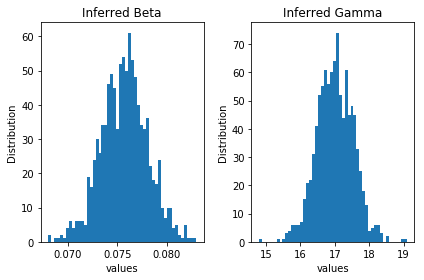

In [76]:
betaff = np.array(result_ff).T[0]
gammaff = np.array(result_ff).T[1]

(fig, subplots) = plt.subplots(nrows=1, ncols=2)
ax_0 = subplots[0]
ax_0.set_title('Inferred Beta')
ax_0.hist(betaff[1:], bins = 50)
ax_0.set_xlabel('values')
ax_0.set_ylabel("Distribution")



ax_1 = subplots[1]
ax_1.set_title('Inferred Gamma')
#glitch in the firs point
ax_1.hist(gammaff[1:], bins = 50)
ax_1.set_xlabel("values")
ax_1.set_ylabel("Distribution")


fig.tight_layout()

# tbt results 

In [281]:
import numpy as np
niter = 1000
result_tbt = np.zeros((niter,3), dtype=float)

In [282]:
time1 = time.time()
result_tbt= mcmcsir(niter,I_time_two[0:1001],R_time_two[0:1001], double_sum_cur_tbt,log_prod_cur_tbt,RminusI_tbt,beta_cur_tbt, gamma_cur_tbt, result_tbt)
elapsed1 = time.time() - time1
print(elapsed1)

1388.83208704


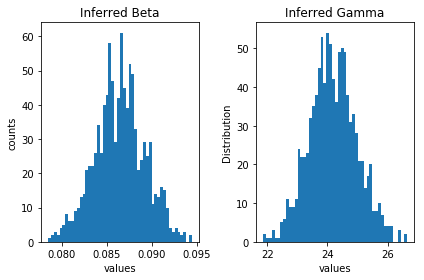

In [283]:
beta = np.array(result_tbt).T[0]
gamma = np.array(result_tbt).T[1]

(fig, subplots) = plt.subplots(nrows=1, ncols=2)
ax_0 = subplots[0]
ax_0.set_title('Inferred Beta')
ax_0.hist(beta, bins = 50)
ax_0.set_xlabel('values')
ax_0.set_ylabel("counts")



ax_1 = subplots[1]
ax_1.set_title('Inferred Gamma')
#glitch in the firs point
ax_1.hist(gamma[1:], bins = 50)
ax_1.set_xlabel("values")
ax_1.set_ylabel("Distribution")


fig.tight_layout()

# throw Results

In [34]:
import numpy as np
niter = 1000
result_throw = np.zeros((niter,3), dtype=float)

In [39]:
time1 = time.time()
result_tbt= mcmcsir(niter,I_time_three[0:1001],R_time_three[0:1001], double_sum_cur_throw,log_prod_cur_throw,RminusI_throw,beta_cur_throw, gamma_cur_throw, result_throw)
elapsed1 = time.time() - time1
print(elapsed1)

2317.70427608


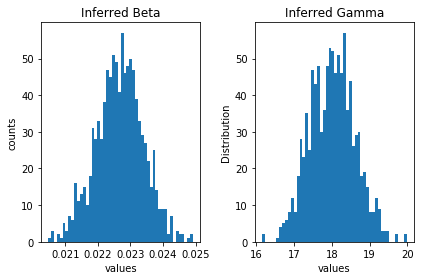

In [73]:
beta_throw = abs(np.array(Result2).T[0])
gamma_throw = abs(np.array(Result2).T[1])

(fig, subplots) = plt.subplots(nrows=1, ncols=2)
ax_0 = subplots[0]
ax_0.set_title('Inferred Beta')
ax_0.hist(beta_throw, bins = 50)
ax_0.set_xlabel('values')
ax_0.set_ylabel("counts")




ax_1 = subplots[1]
ax_1.set_title('Inferred Gamma')
#glitch in the firs point
ax_1.hist(gamma_throw[1:], bins = 50)
ax_1.set_xlabel("values")
ax_1.set_ylabel("Distribution")


fig.tight_layout()

# Generalized

# MCMC ALL

In [23]:
#inintialize the time array with the length of the maximum ID just in case that all users have recovered
#because some users might never recover we can see that about half of the times = 0
#this method gives the last recovery time of each Id >> lat time window
start_time2 = time.time()

Rec_time_dict1= {}
for i in Data_rt:
    series = Series_time_convert(Data_rt[str(i)], 8)
    I, R, InfUsers, RecUsers, badd = InfectionHistory(series, 8)
    #8 hours is my chosen time window, I'll try different time windows
    #calculated times can be converted into real tim by *(8*3600)
    a = np.zeros(np.max(np.hstack(RecUsers).astype(int))+1)
    for j in range(0,len(RecUsers)):
        if len(RecUsers[j]) != 0:
            #Some arrays in Rec user hitory are empty
            a[RecUsers[j]] = j
    Rec_time_dict1.update({str(i): a})
elapsed_time2 = time.time() - start_time2
print(elapsed_time2)

105.610271931


In [24]:
#here on the contrary I try to calculte the very first infection
#and evetually predictions are calculated over both of them
#I am following the approximation that times in between are noise.
start_time3 = time.time()
Inf_time_dict1= {}
for i in Data_rt:
    series = Series_time_convert(Data_rt[str(i)], 8)
    I, R, InfUsers, RecUsers, badd = InfectionHistory(series, 8)
    b = np.zeros(np.max(np.hstack(InfUsers).astype(int))+1)
    for j in range(1,len(InfUsers)+1):
        if len(InfUsers[len(InfUsers)-j]) != 0:
            #Some arrays in Inf user hitory are empty
            b[InfUsers[len(InfUsers)-j]] = len(InfUsers)-j
    Inf_time_dict1.update({str(i): b})
elapsed_time3 = time.time() - start_time3
print(elapsed_time3)

89.0253531933


# Loop of all hashtags

top100lies


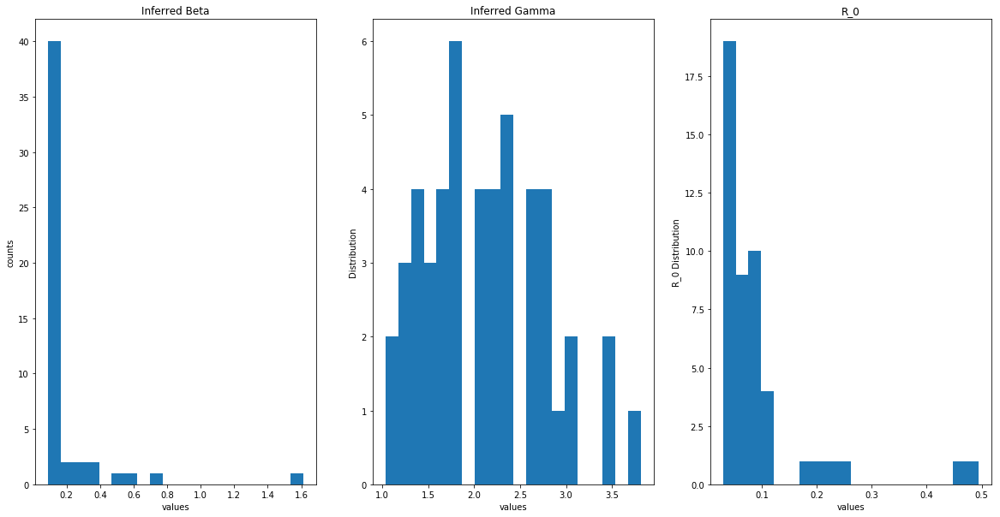

love


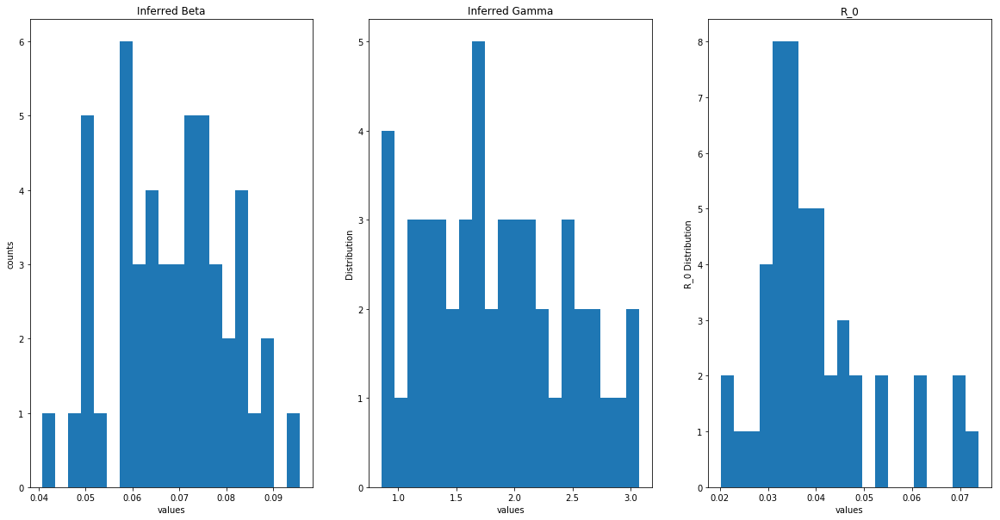

ff


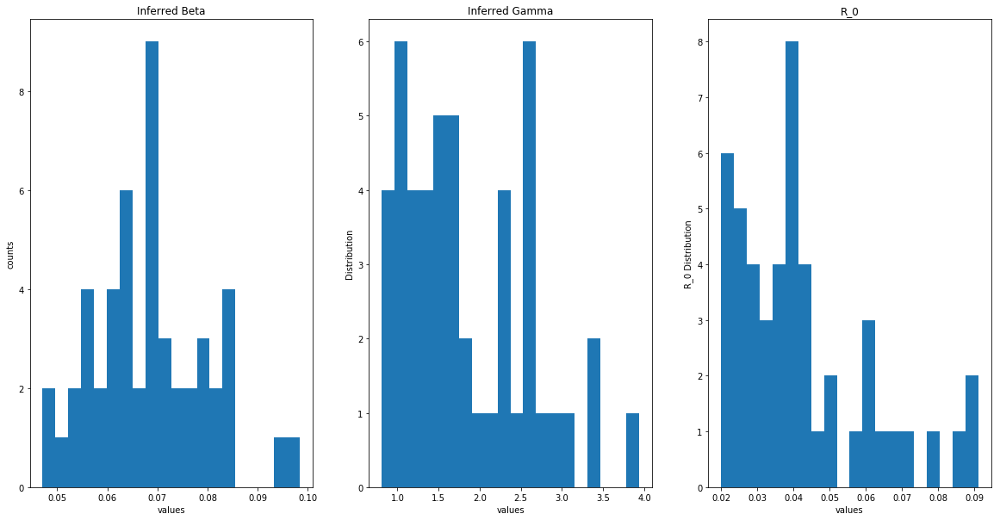

cancer


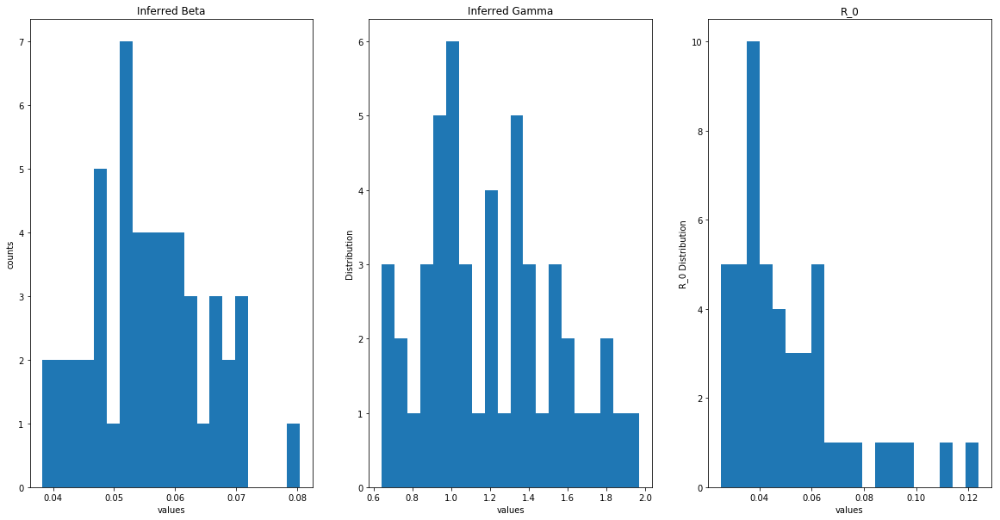

500aday


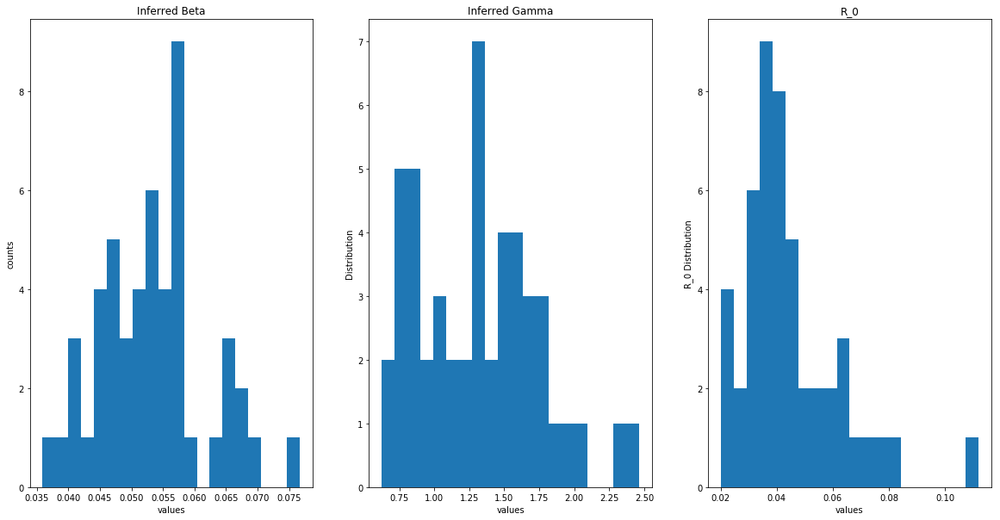

gnation


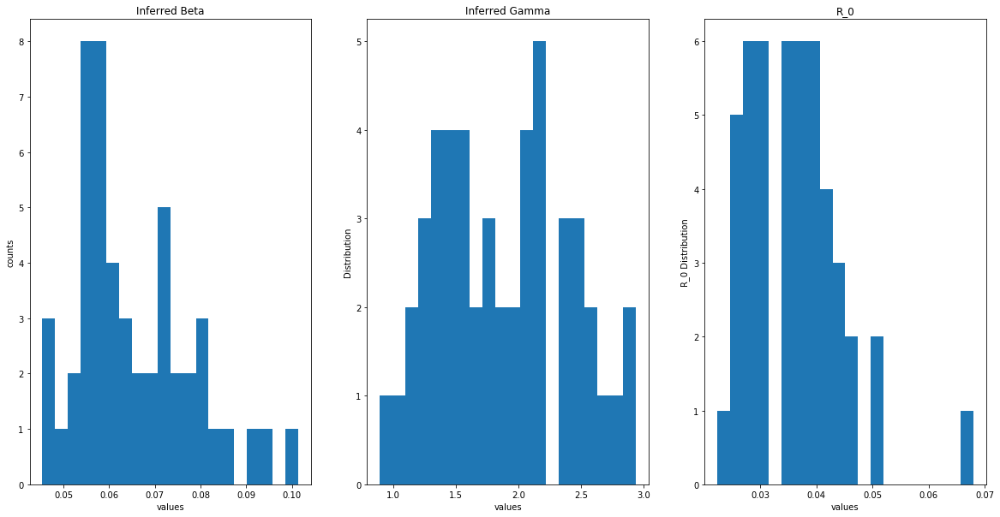

dearoomf


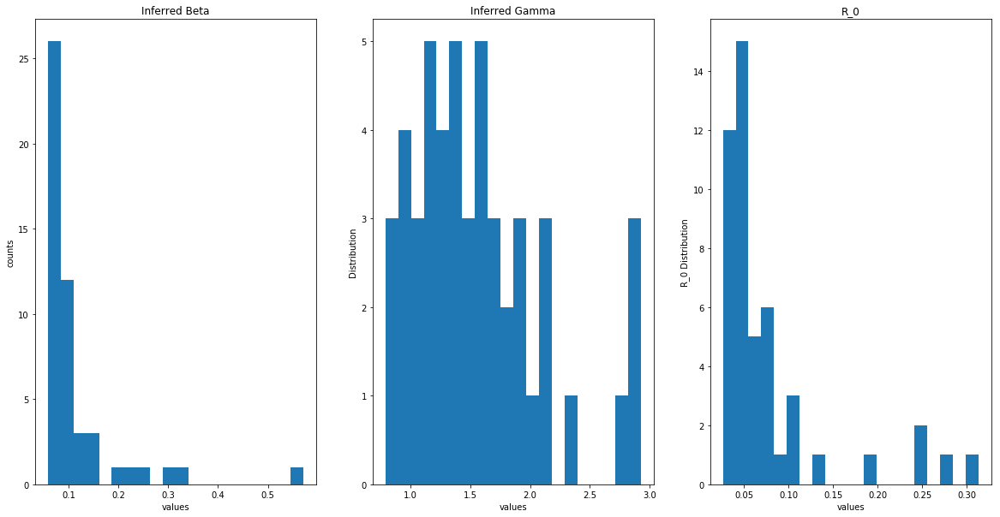

itscutewhen


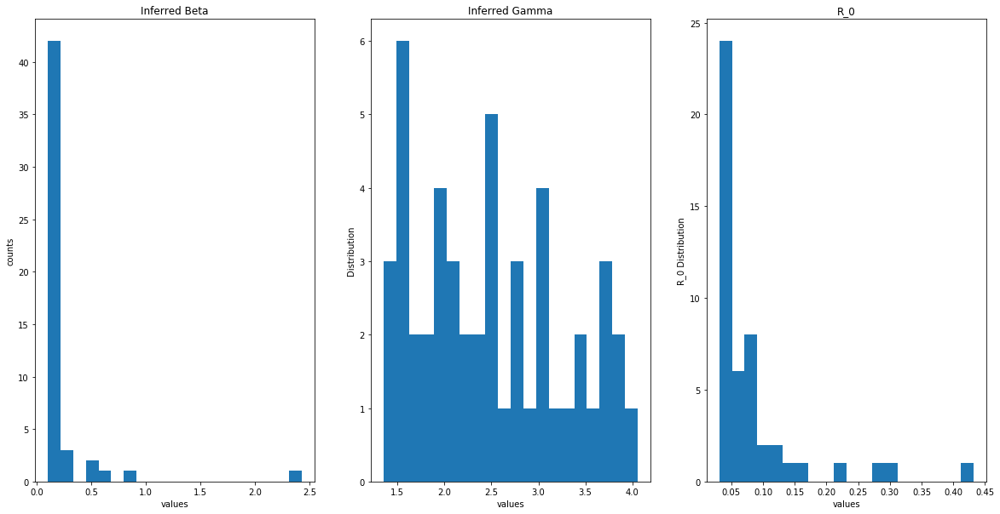

blessed


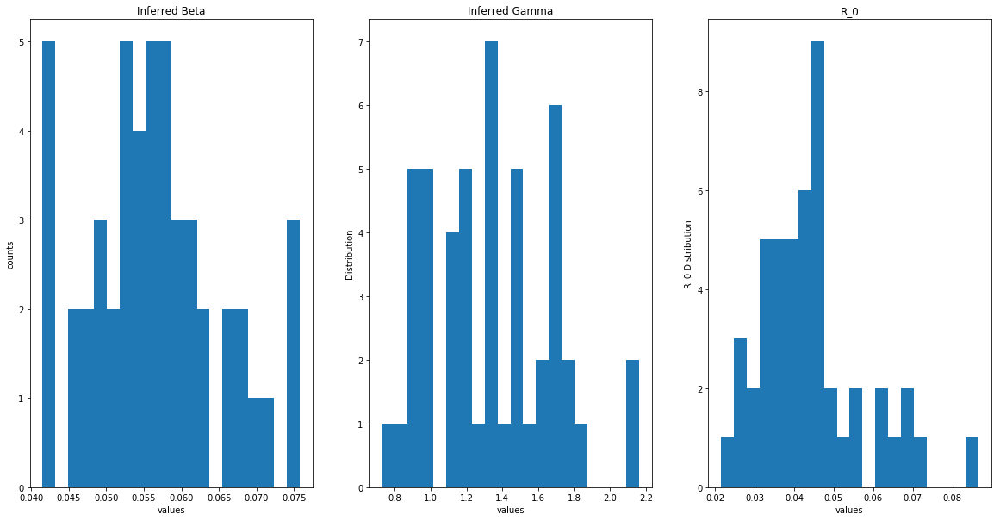

20thingsilove


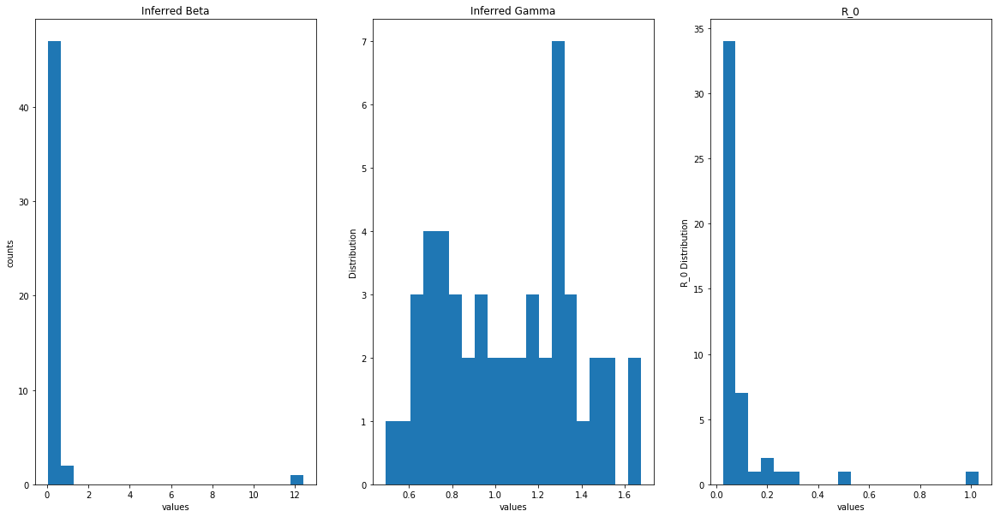

thoughtsduringschool


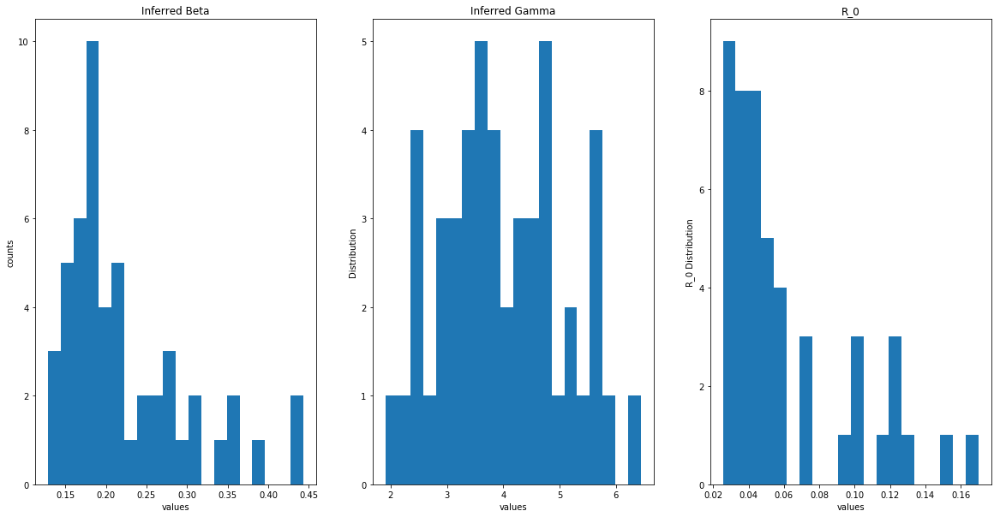

mythoughtsduringschool


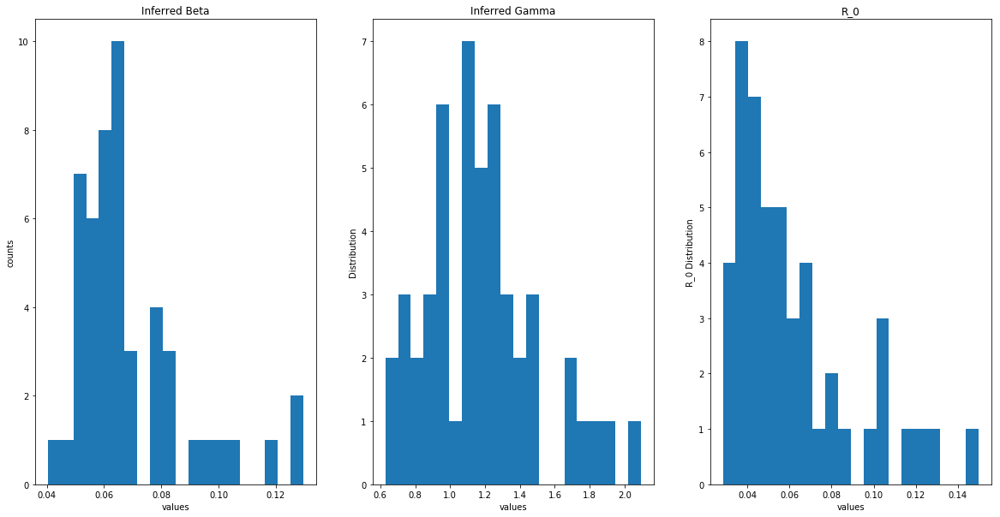

trayvonmartin


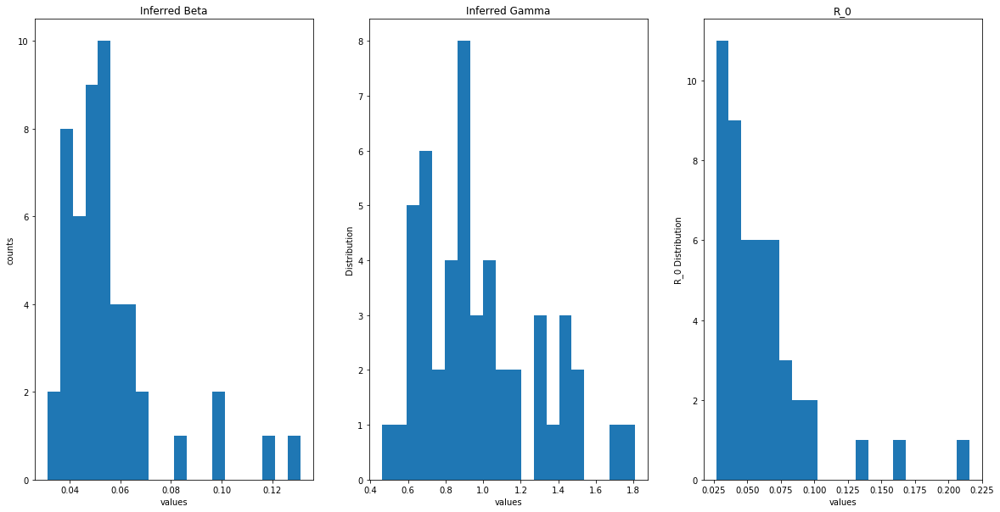

follow


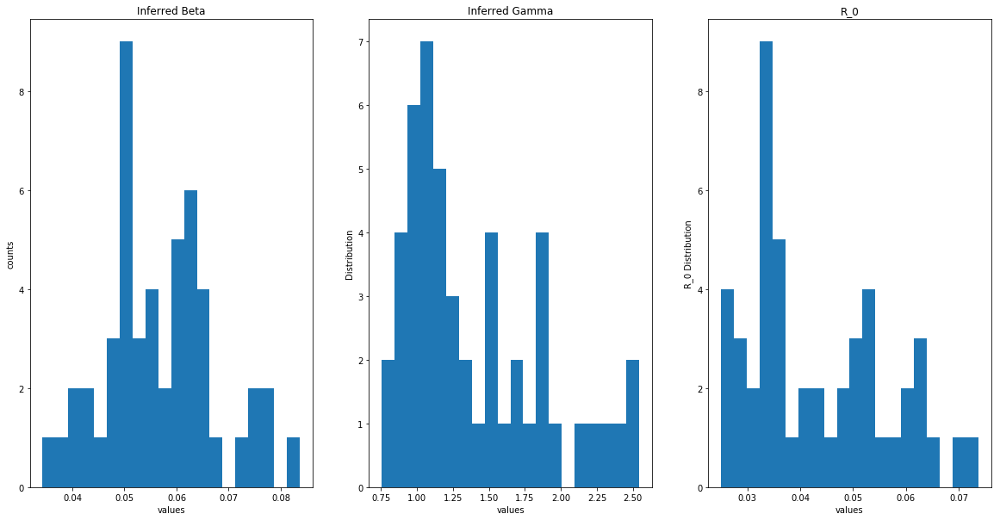

swag


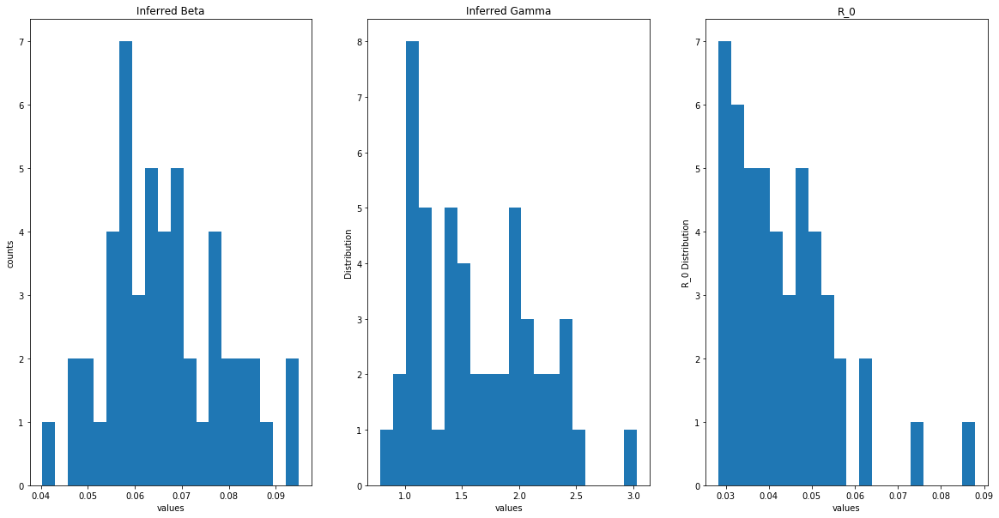

truthis


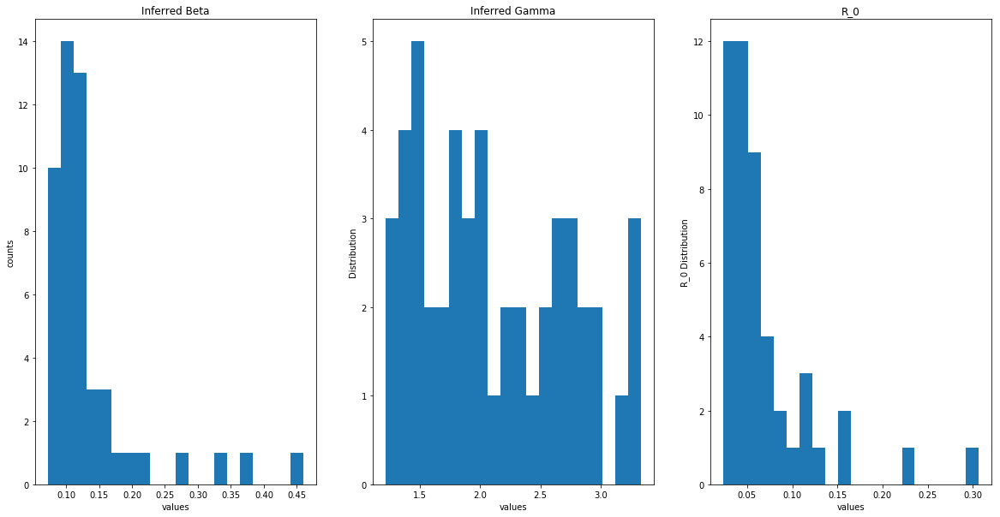

scorpio


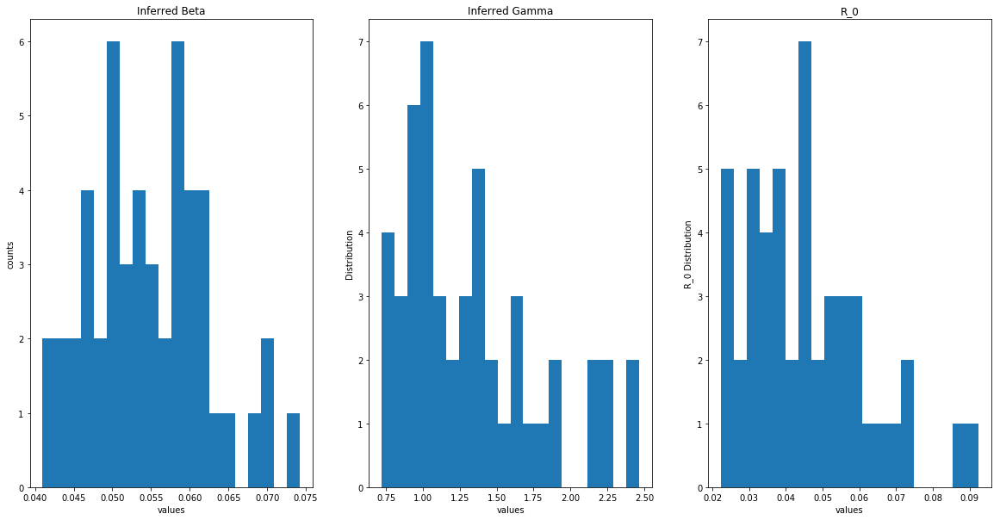

twitterpeopleilove


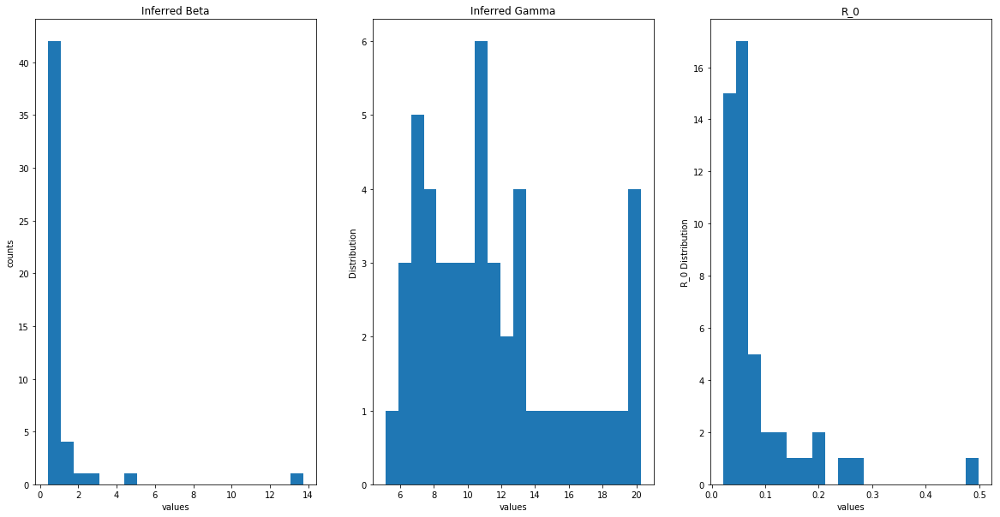

lt


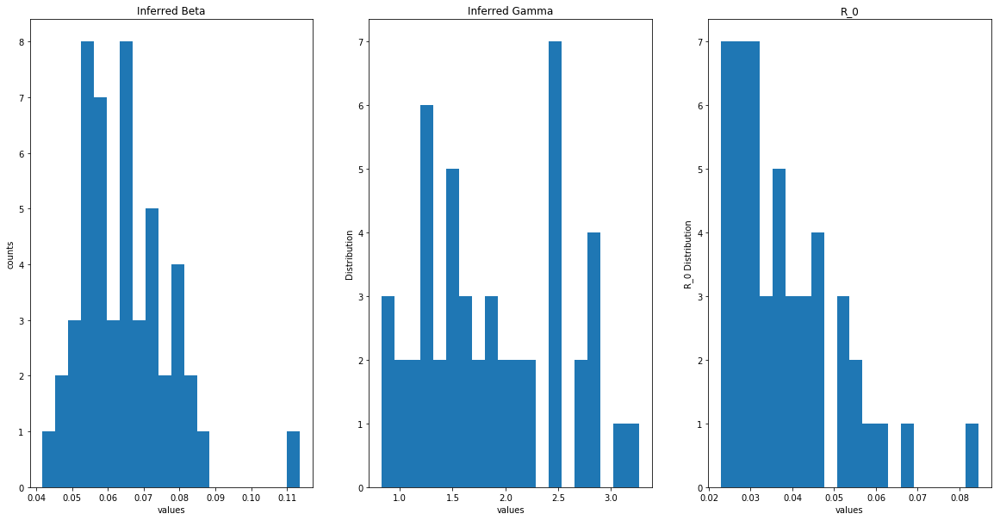

lol


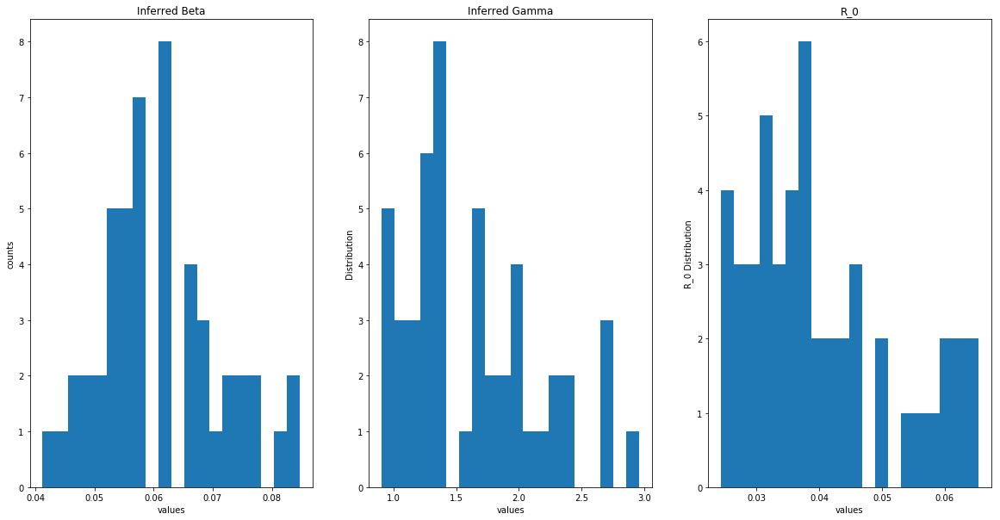

winning


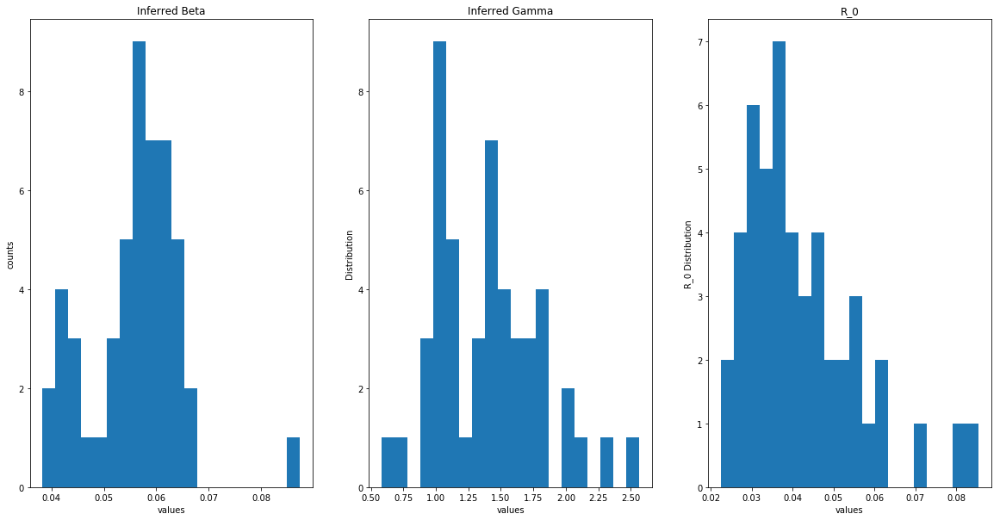

virgo


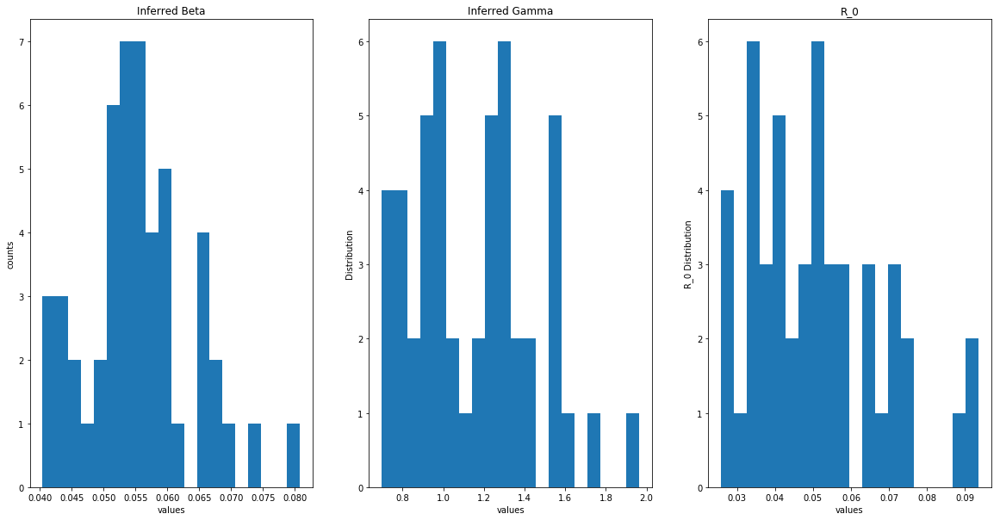

fml


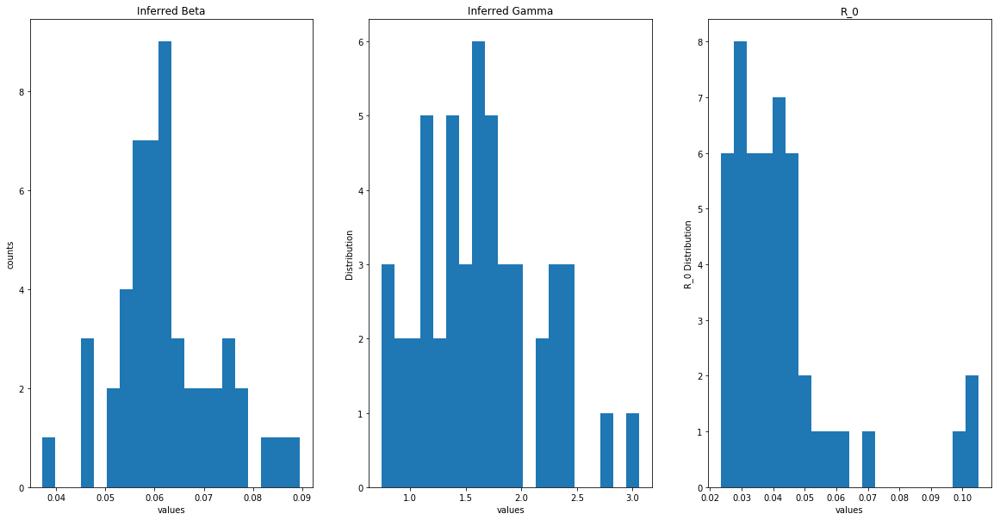

libra


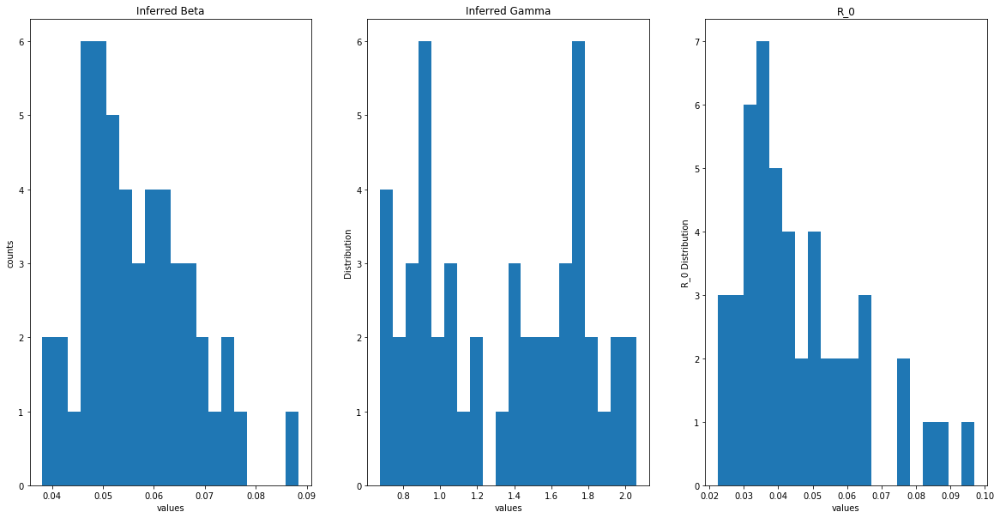

sorrynotsorry


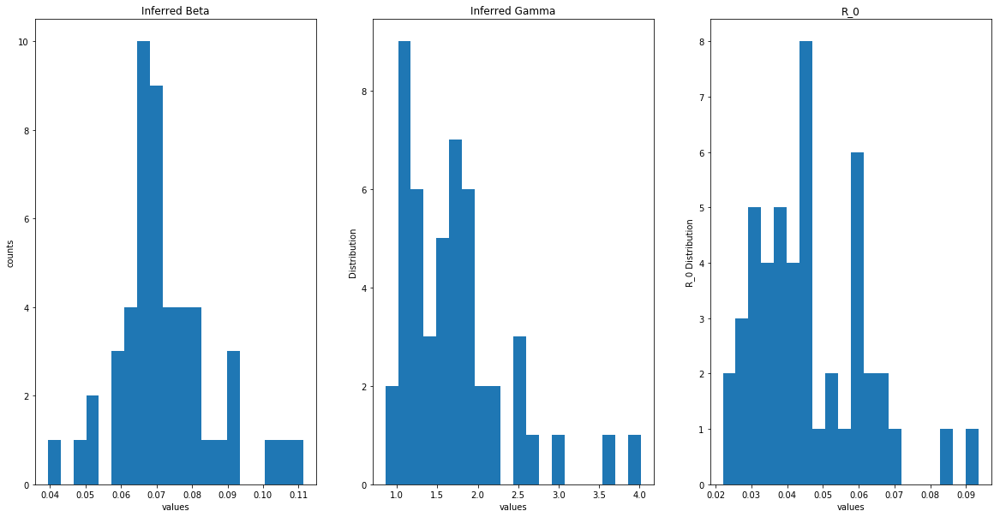

aries


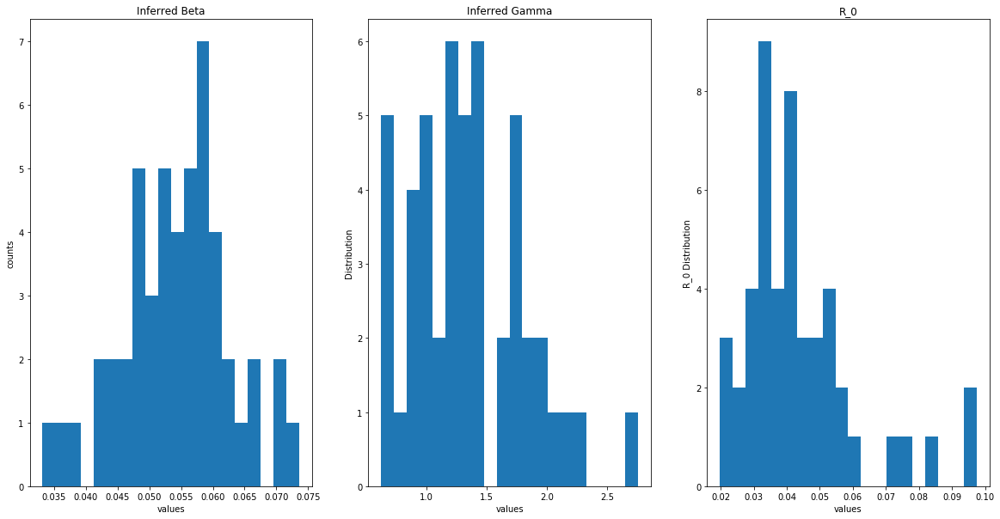

realshit


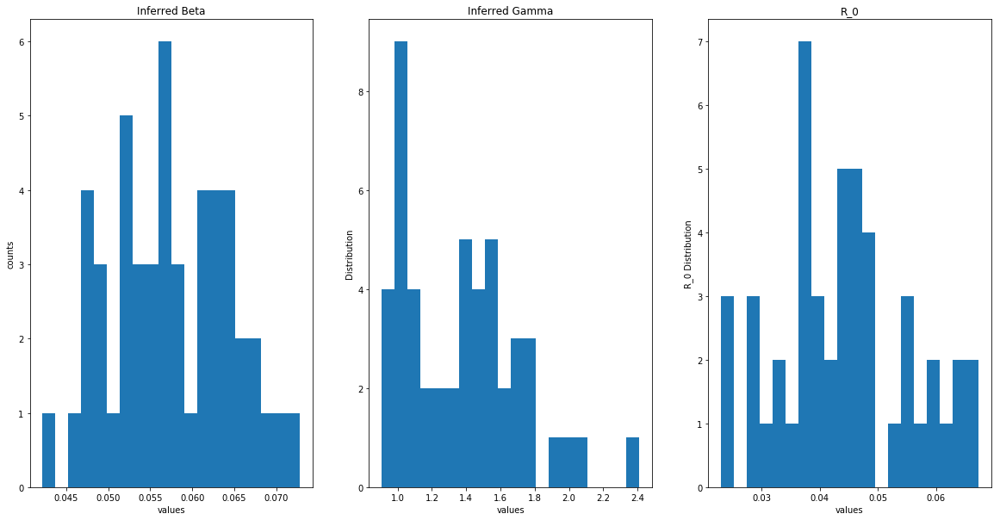

bahrain


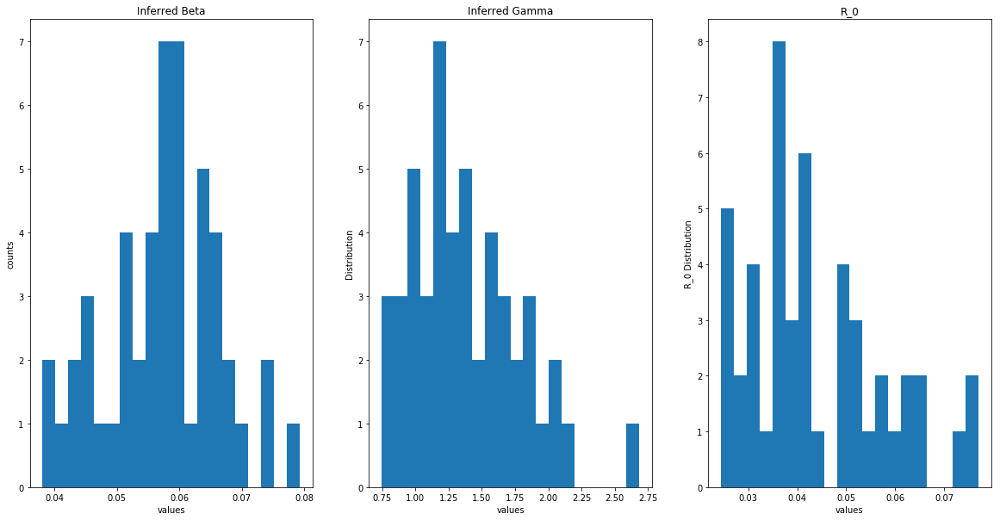

confessionhour


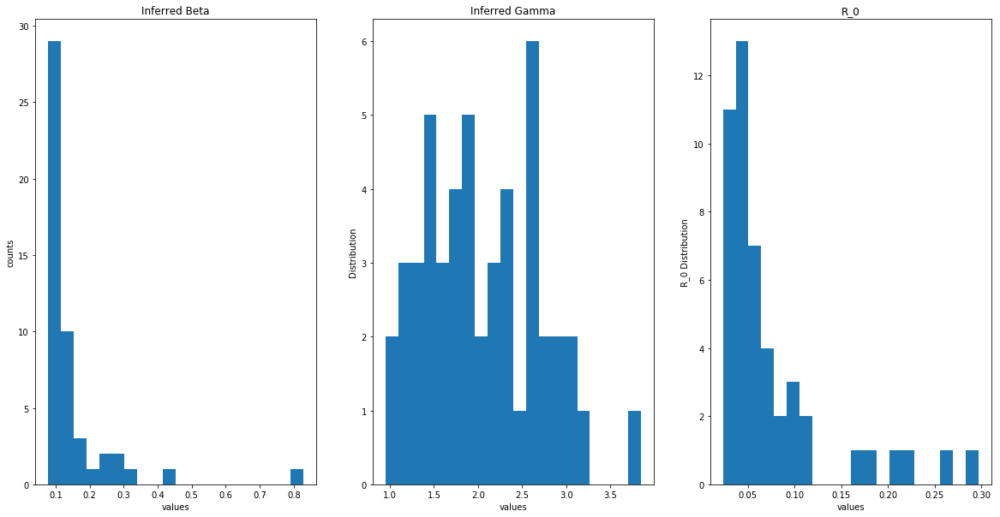

iadmit


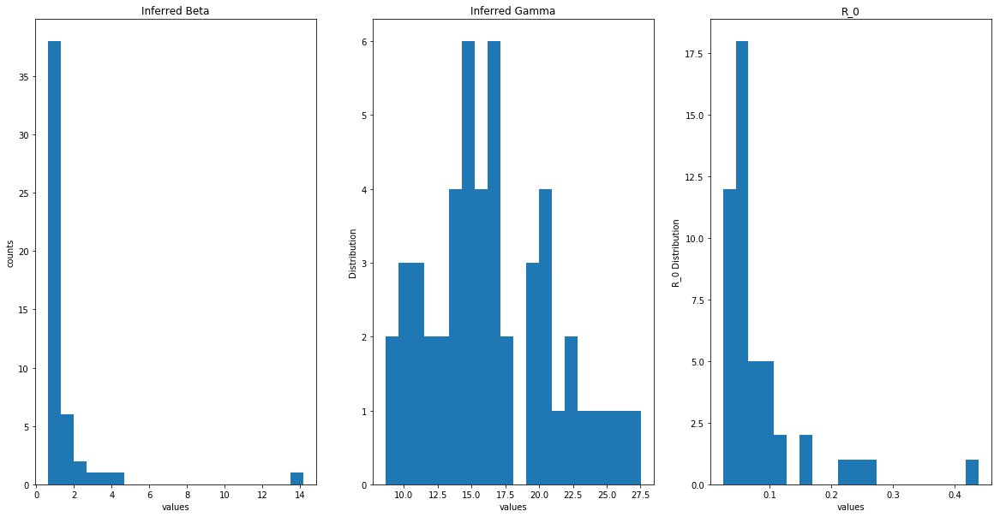

random


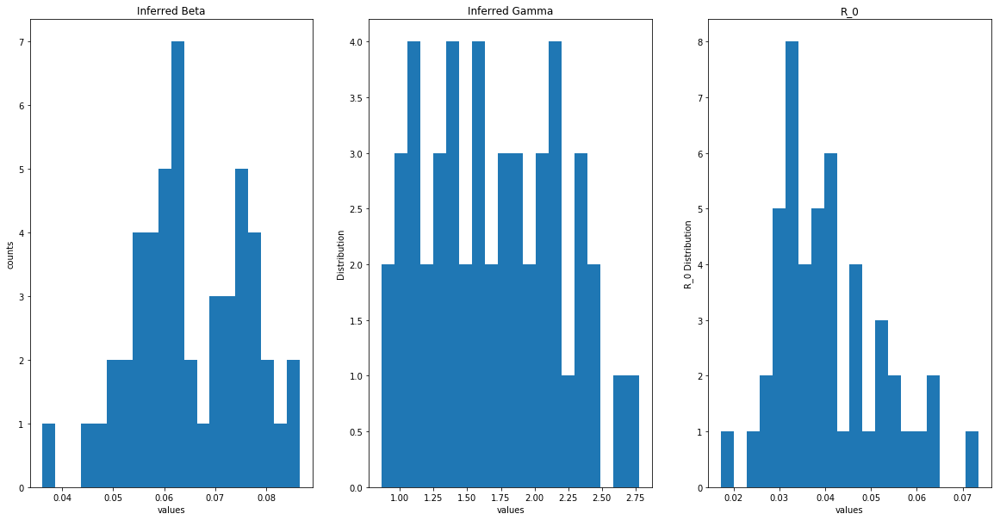

followback


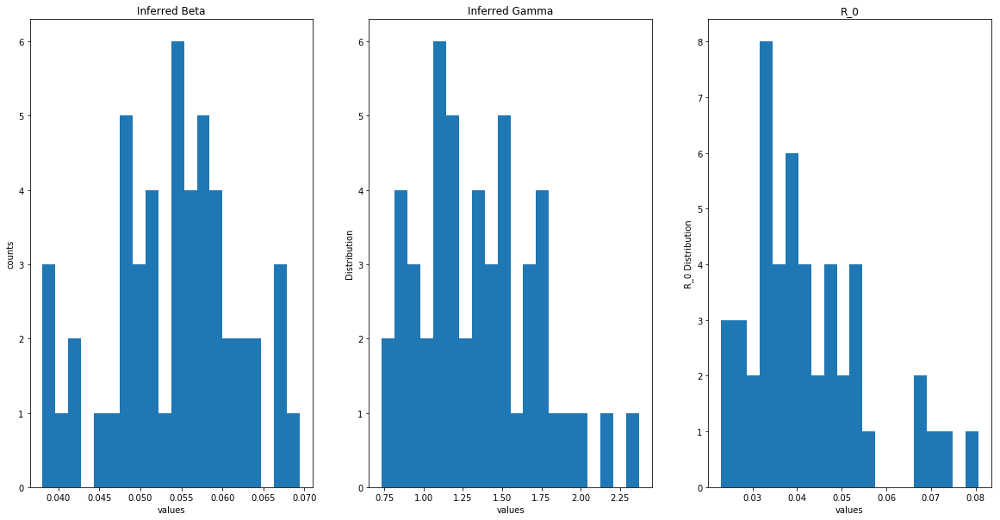

yougetpointsif


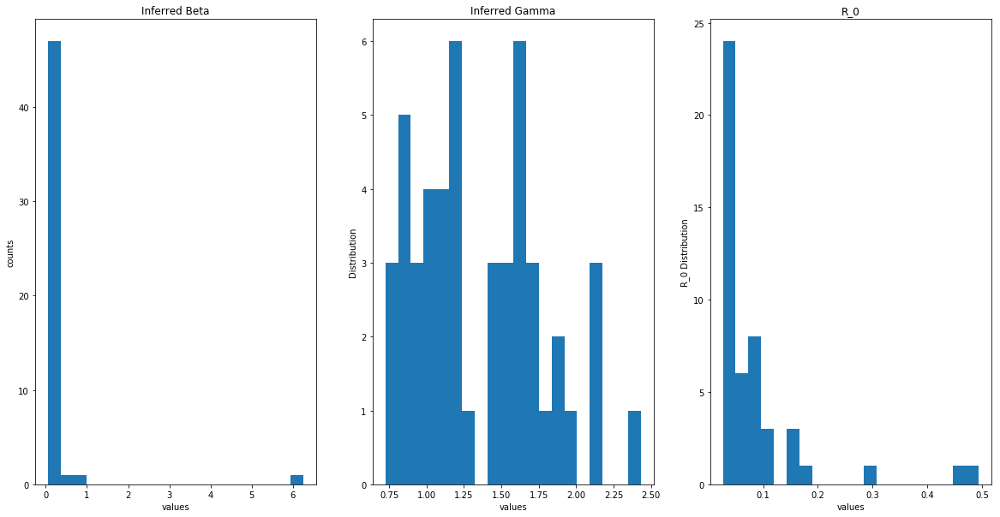

realtalk


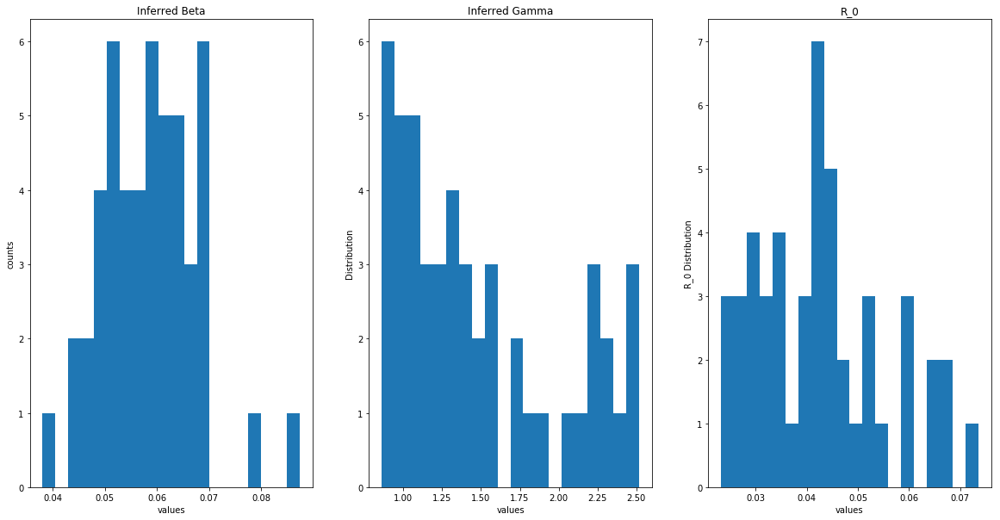

subtweet


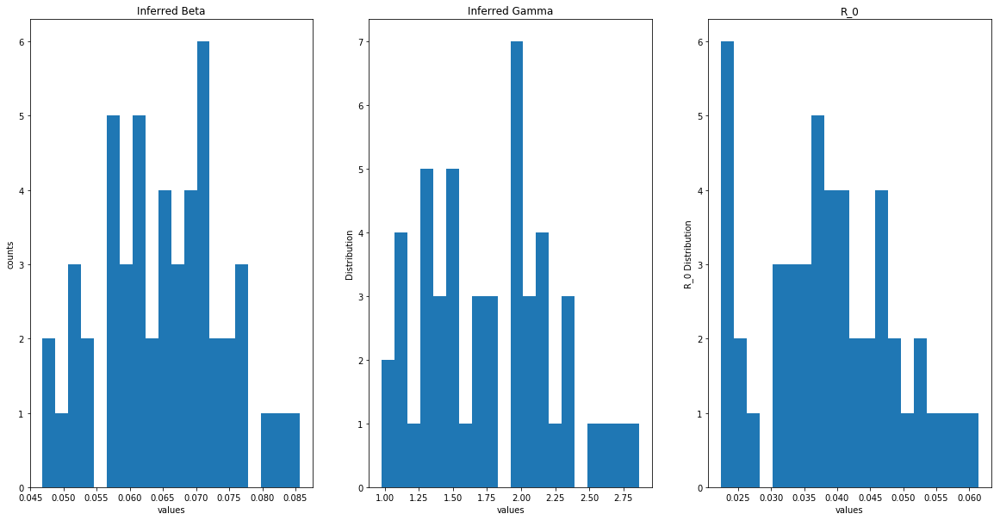

tfb


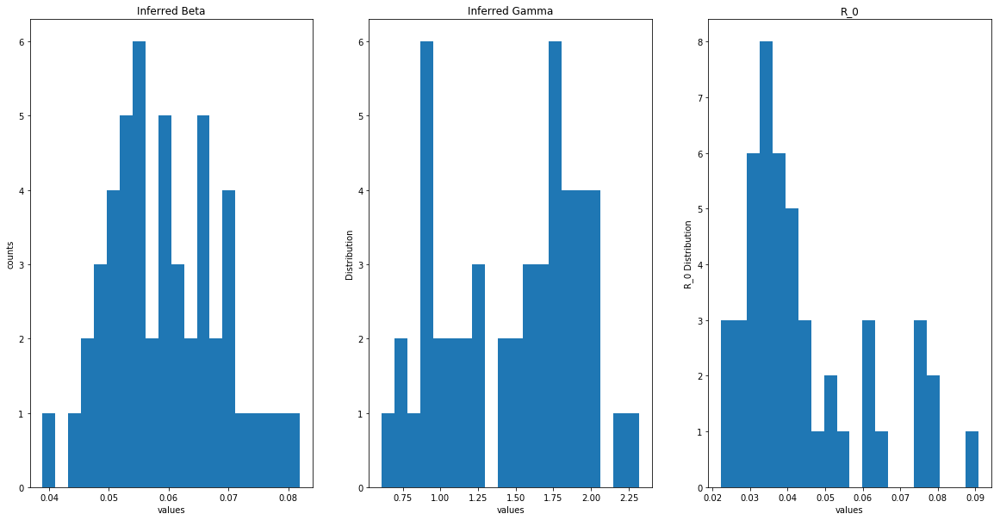

yougetmajorpointsif


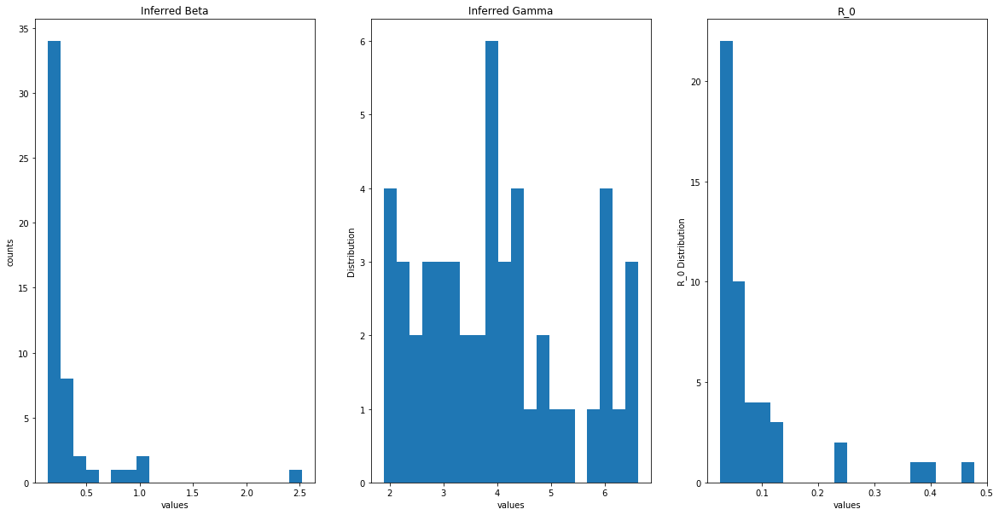

bgc


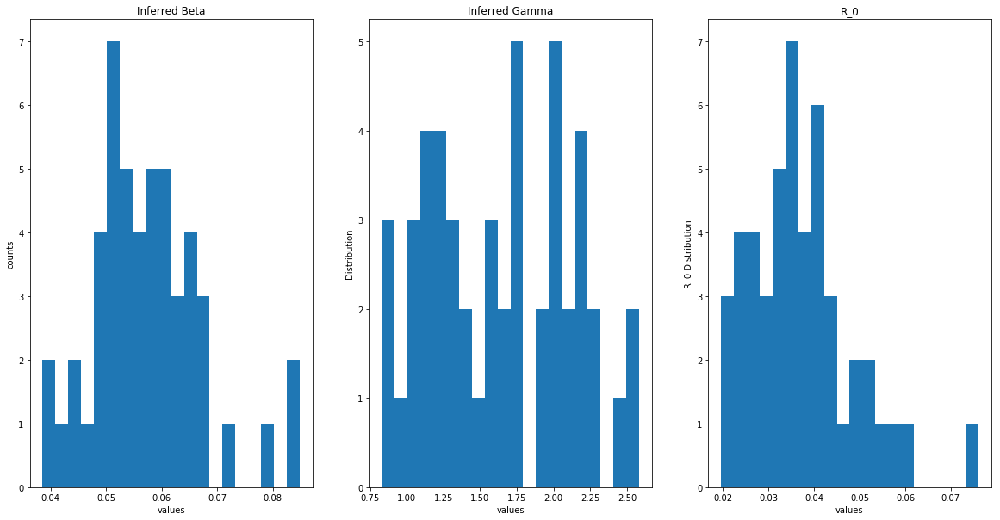

lrt


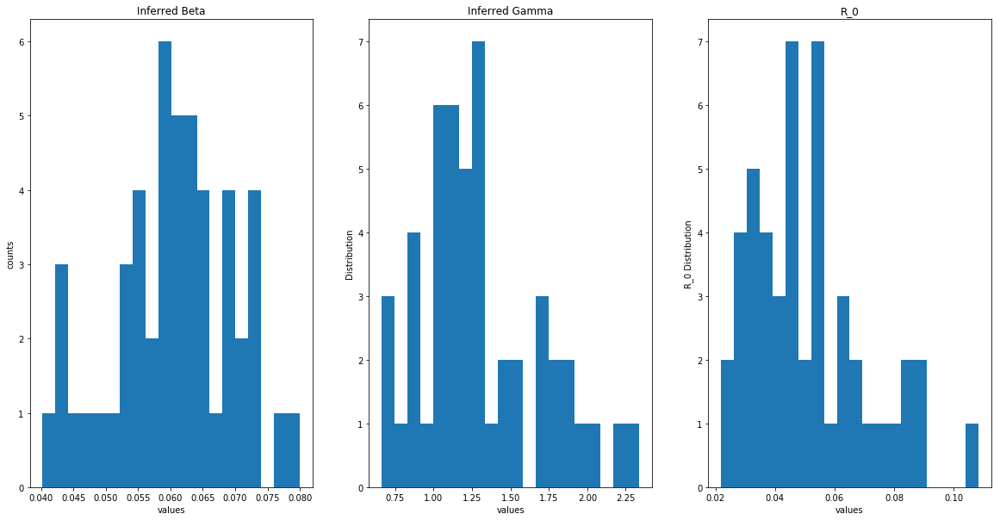

libras


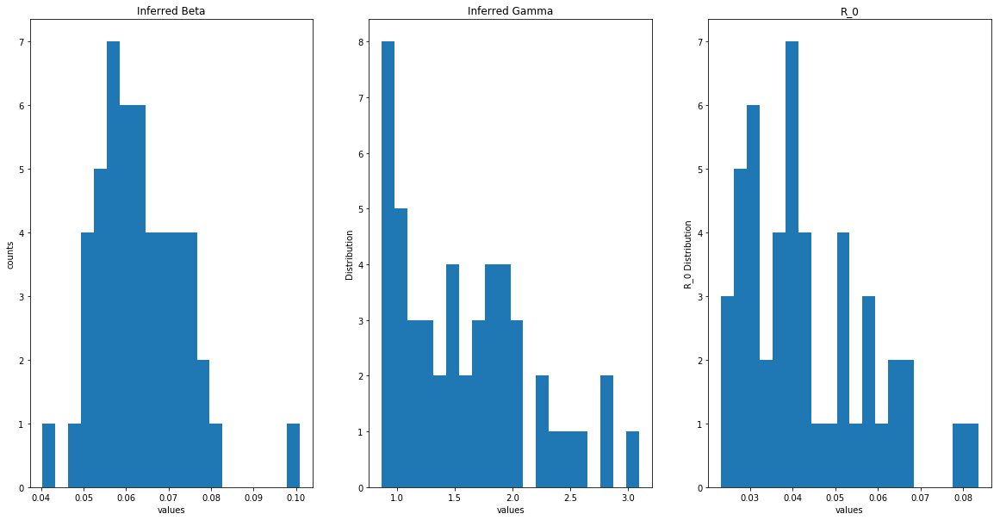

theworstfeeling


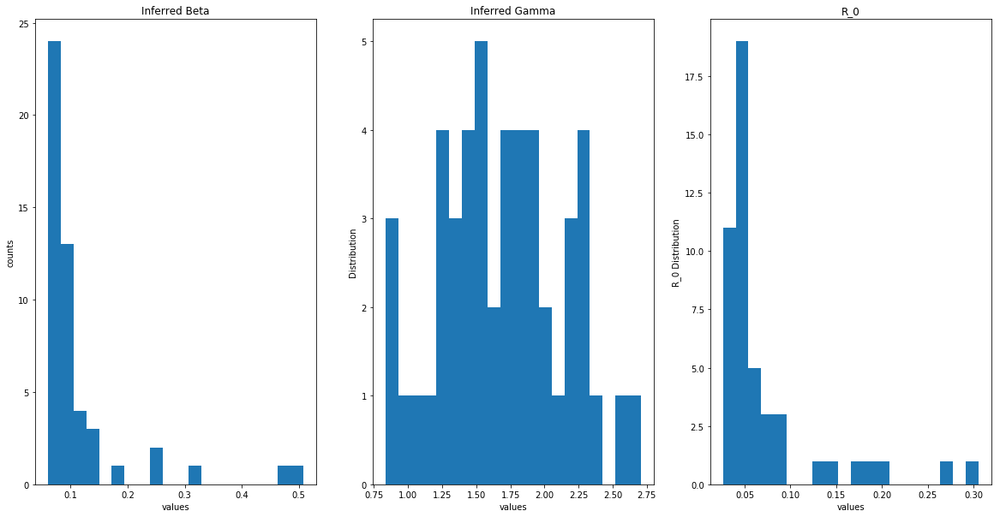

believe


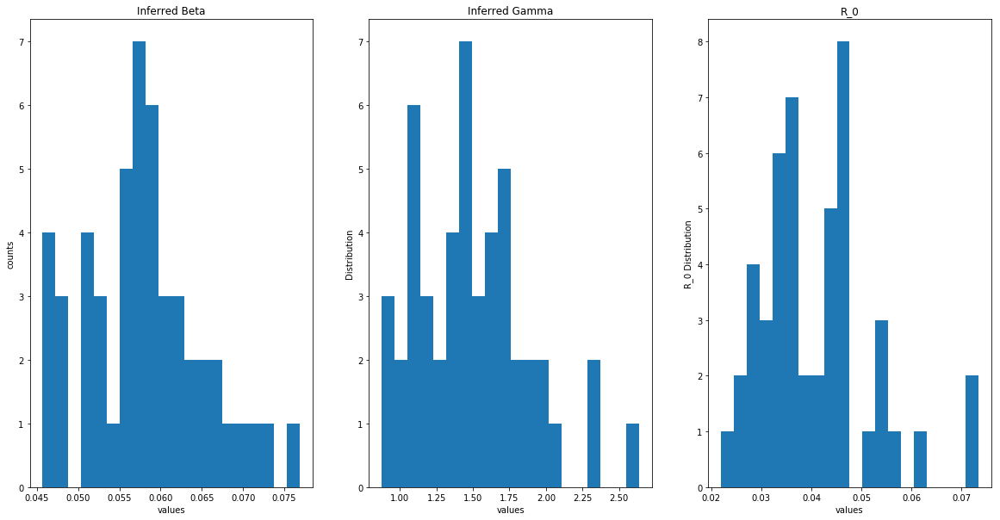

aquarians


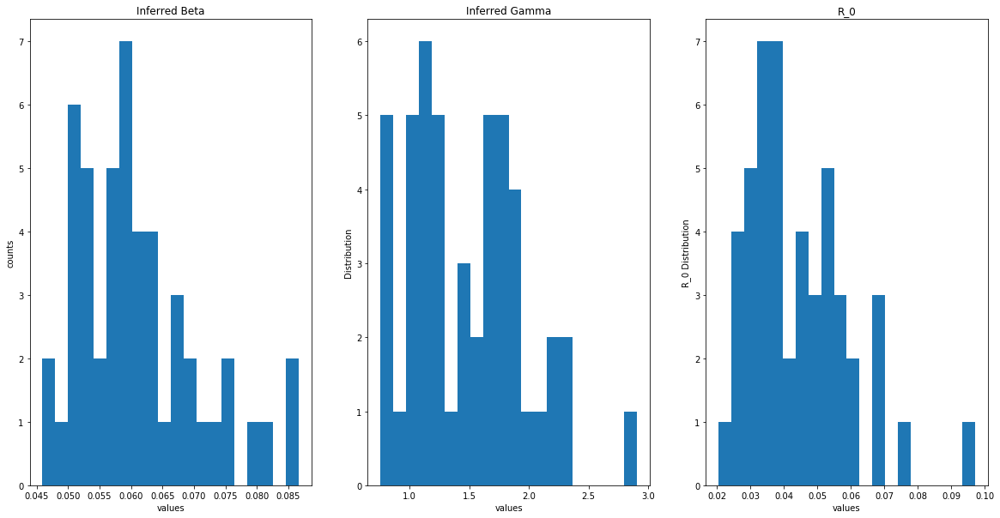

boyfriend


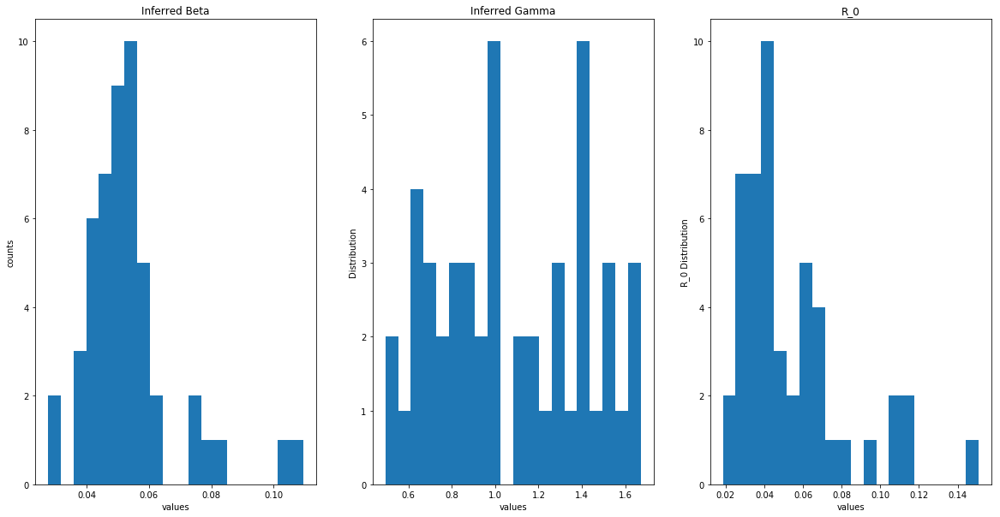

p2


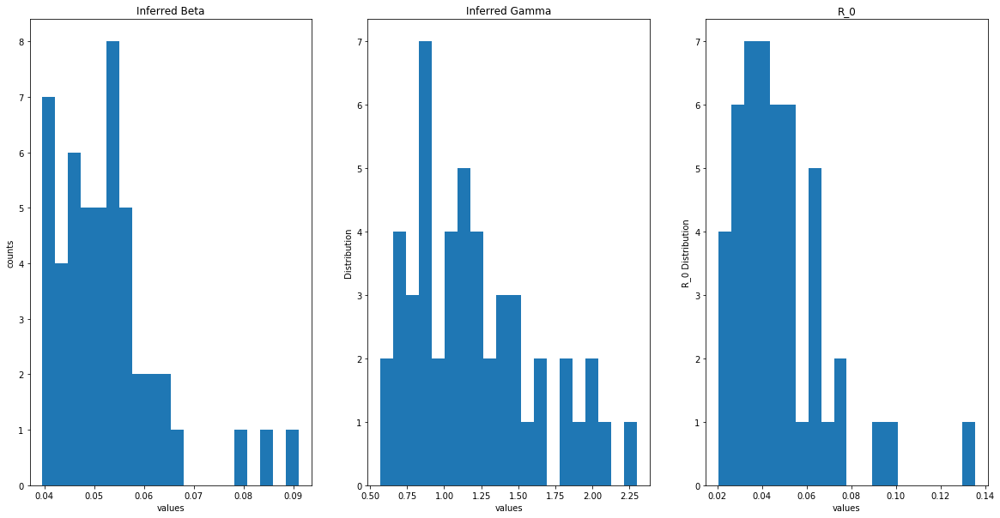

inourgeneration


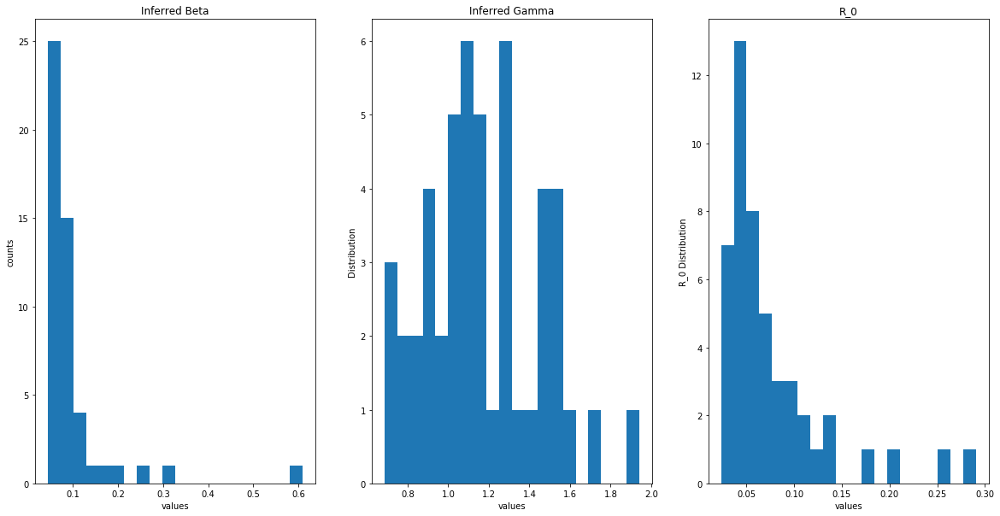

oomfs


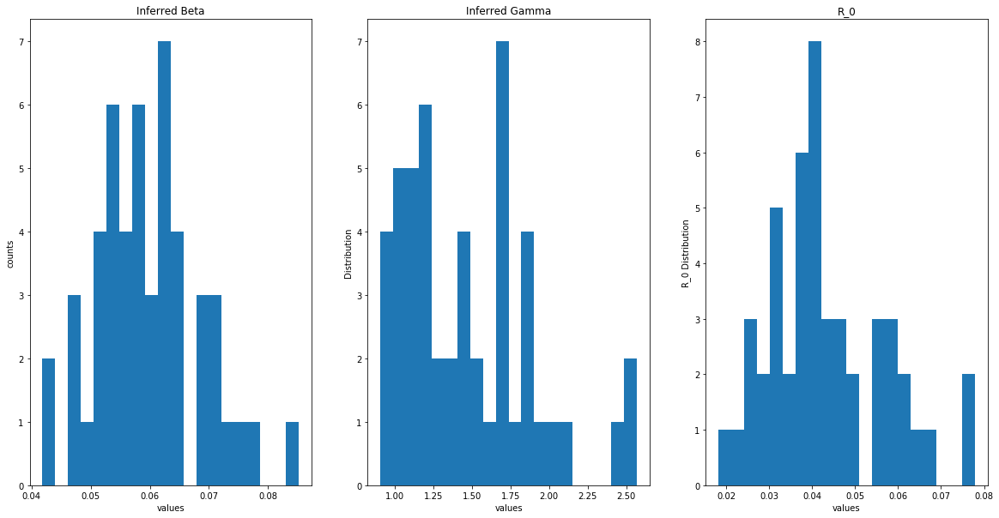

nfb


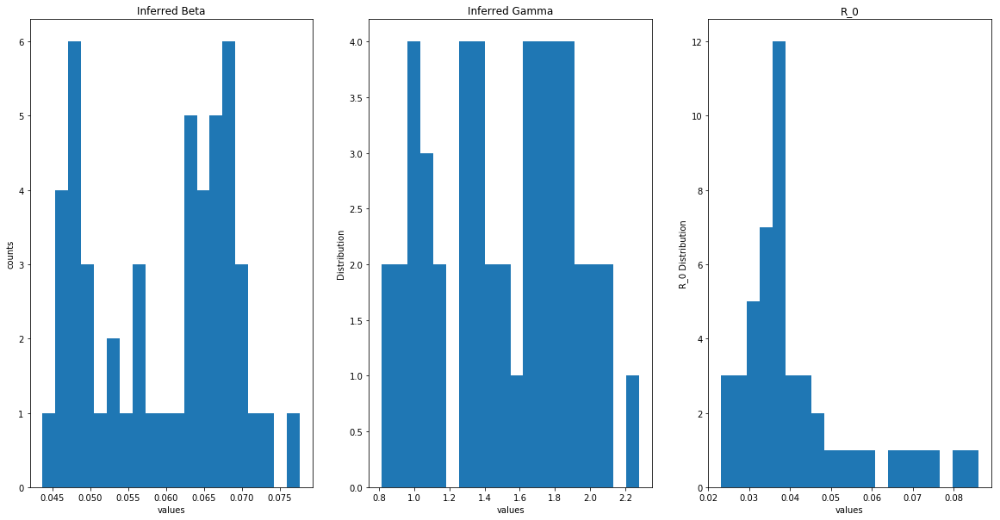

capricorn


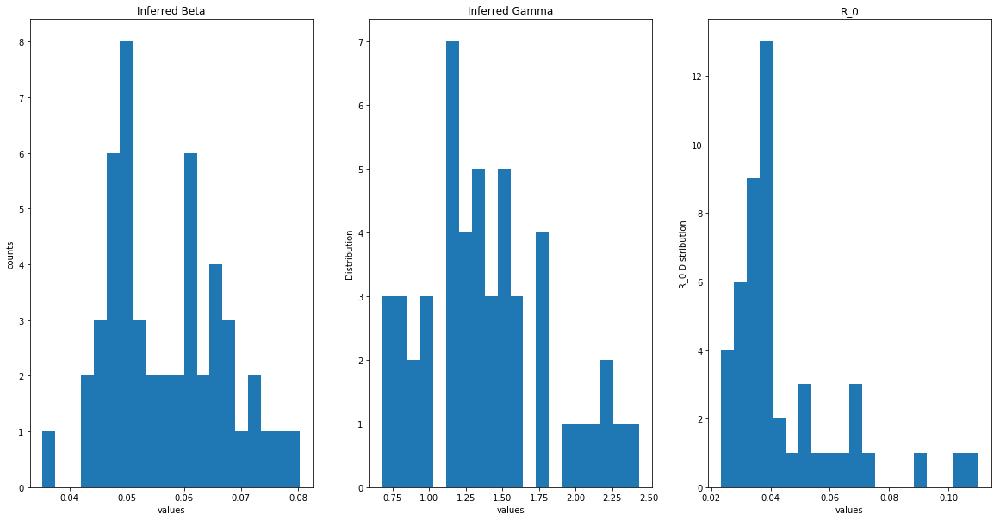

teamfollowback


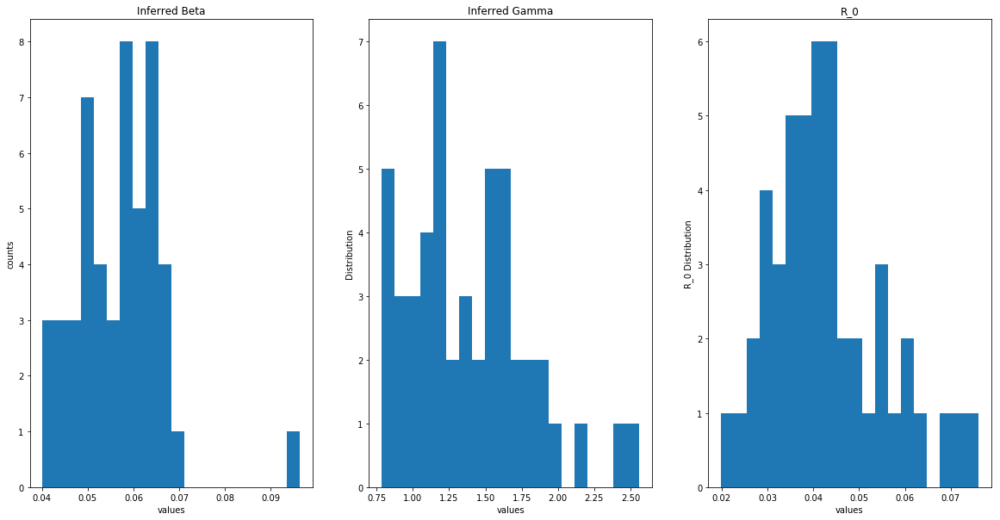

middleschoolmemories


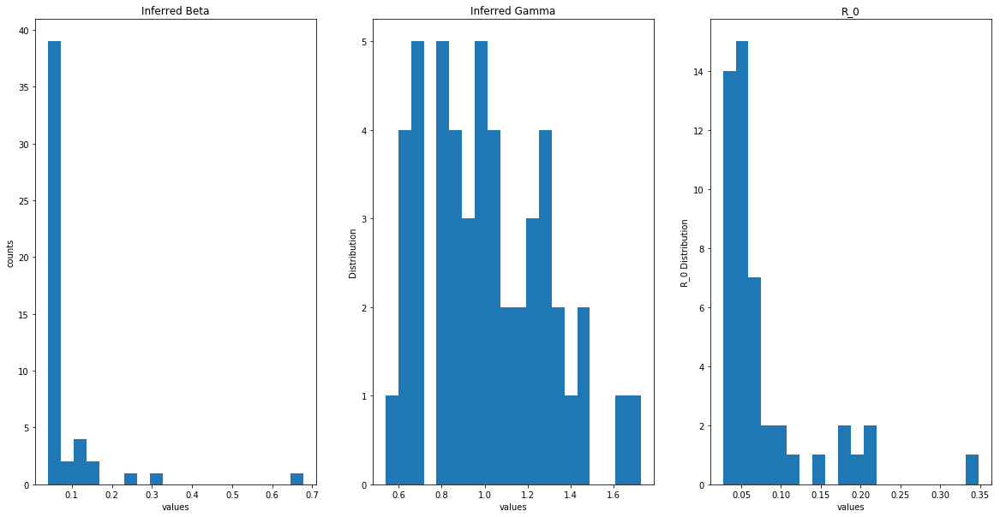

youknowwhatsannoying


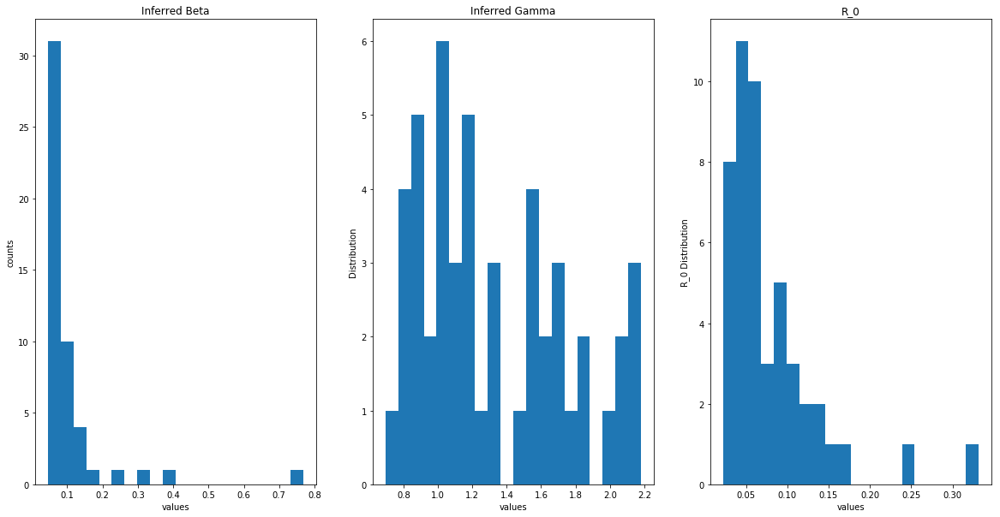

10thingsifindattractive


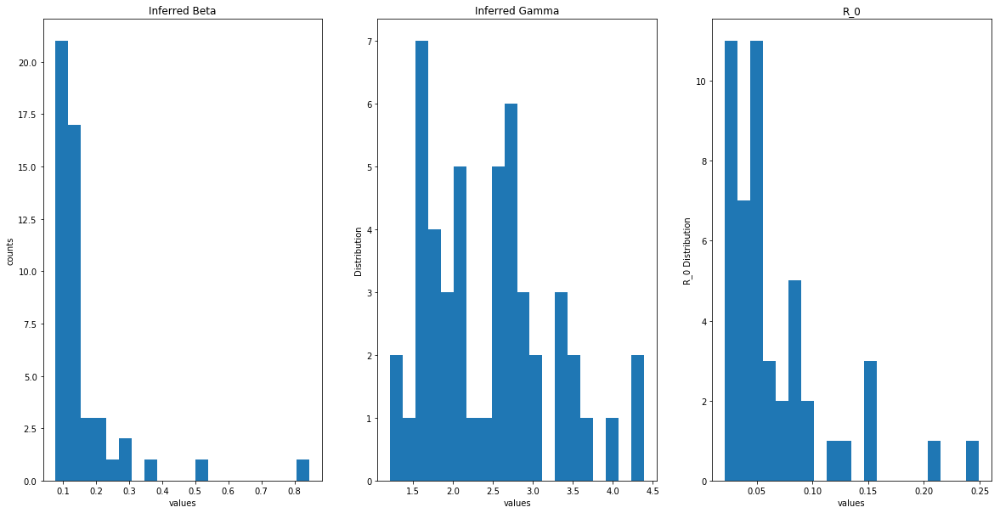

dailytweet


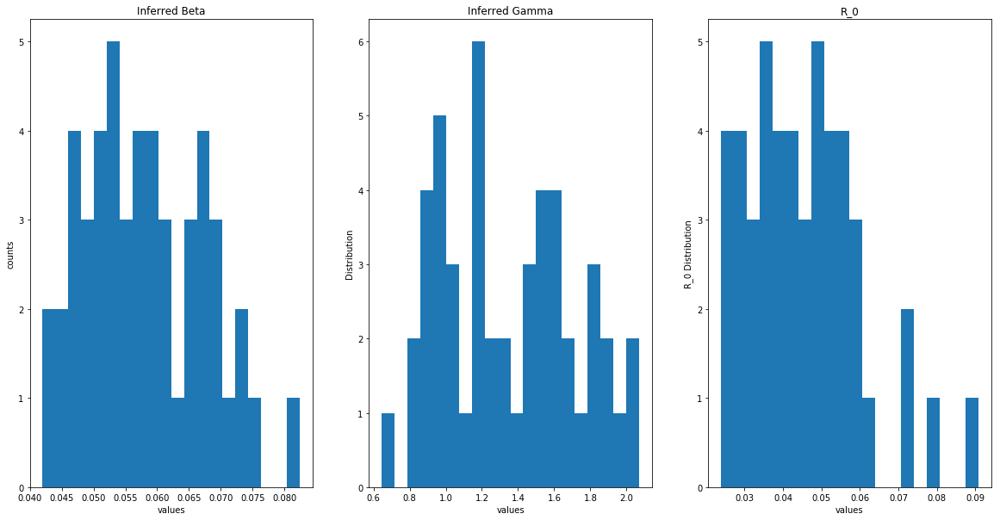

cancers


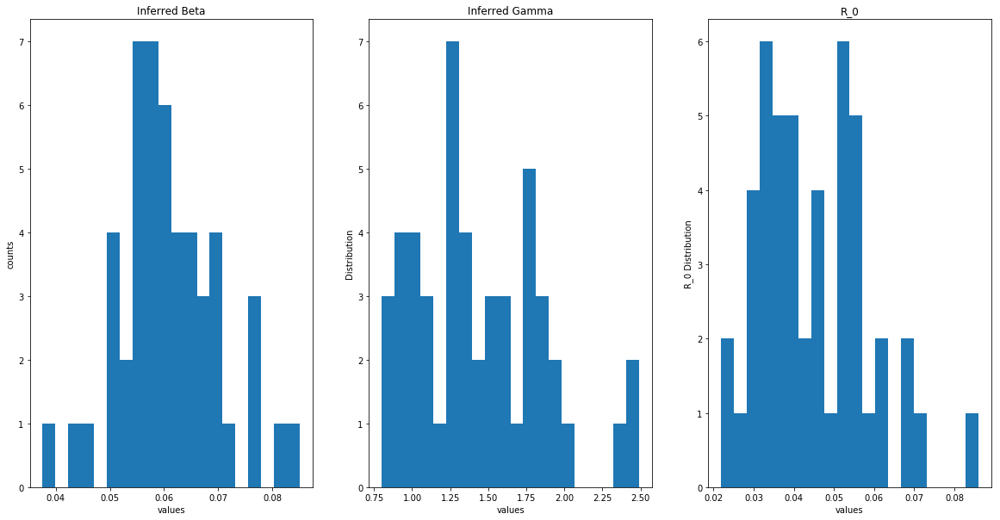

truth


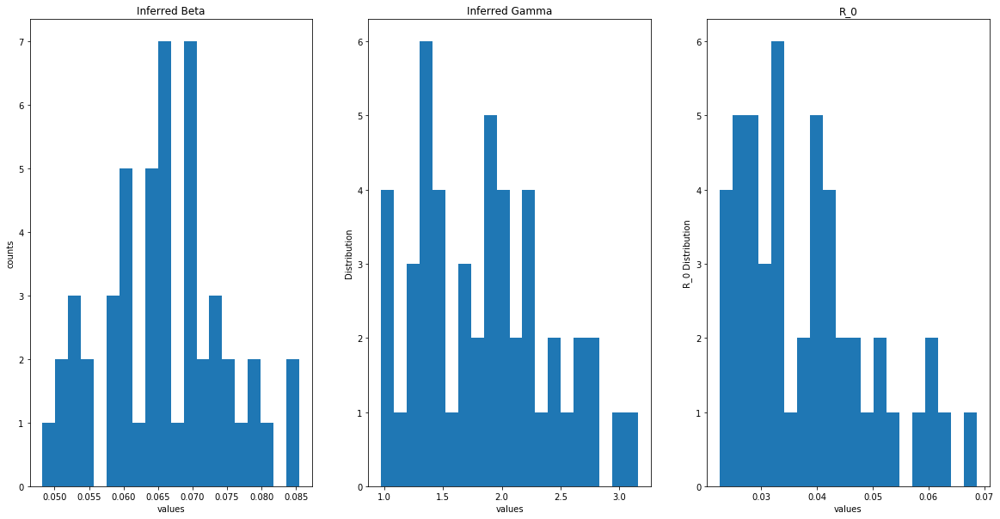

mybiggestproblem


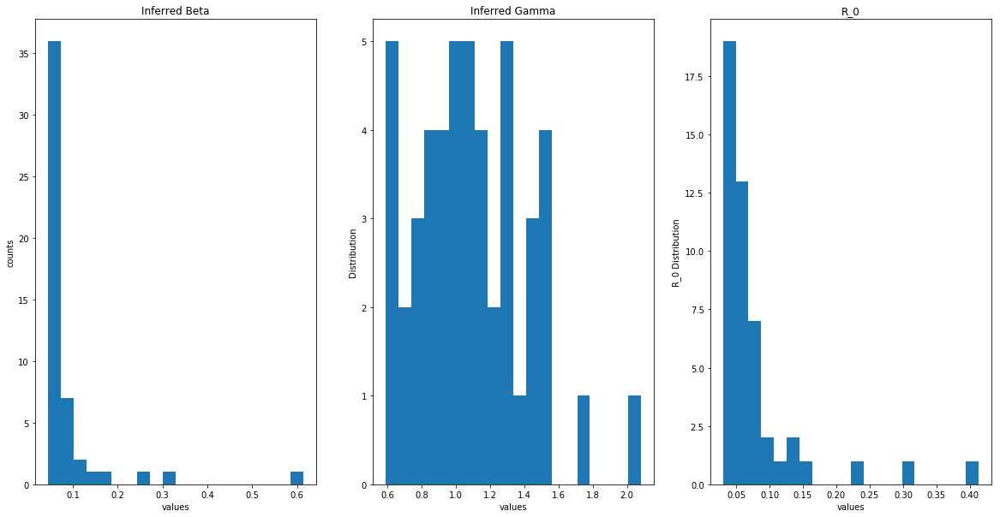

f1


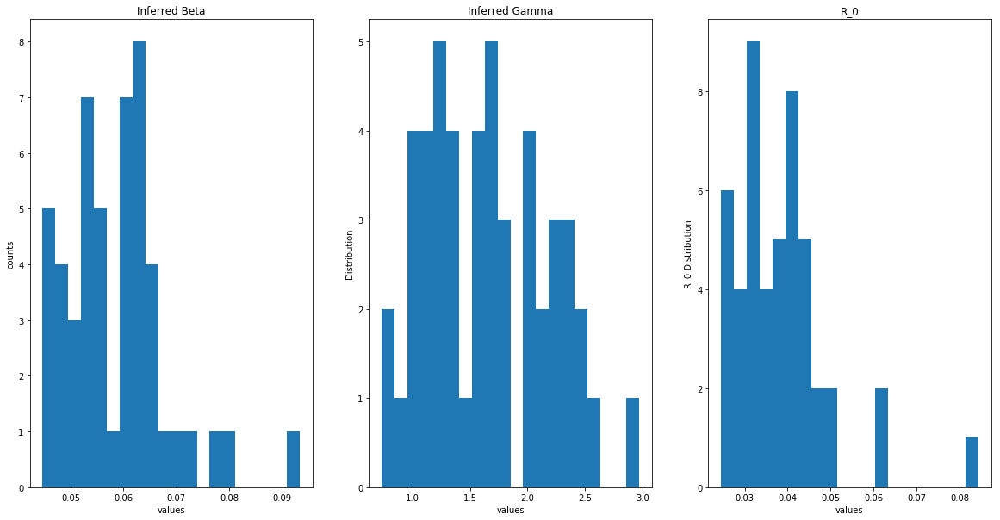

instagram


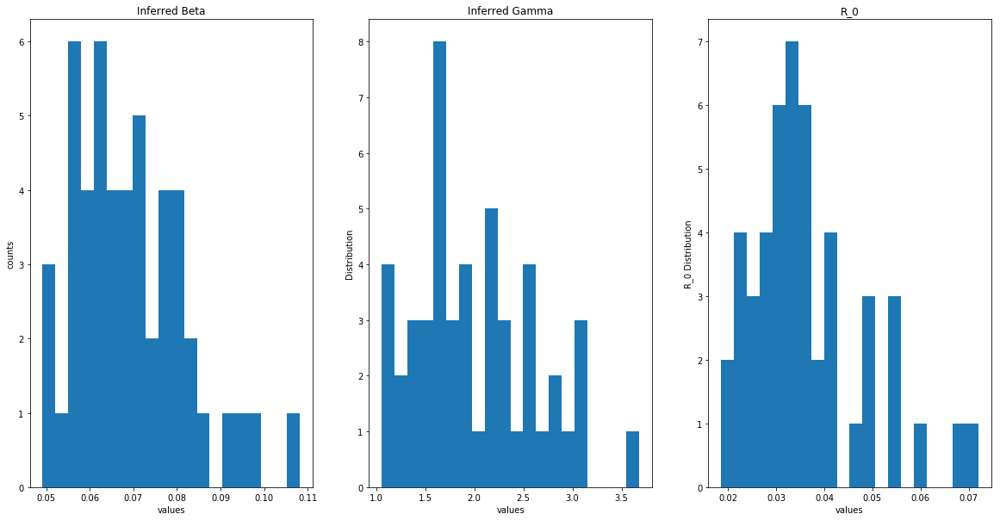

wewontworkoutif


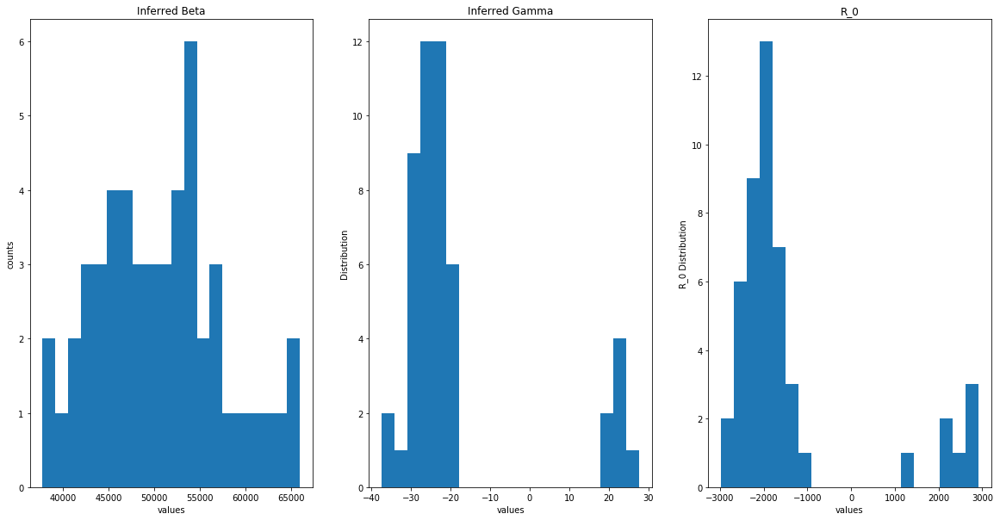

teamiphone


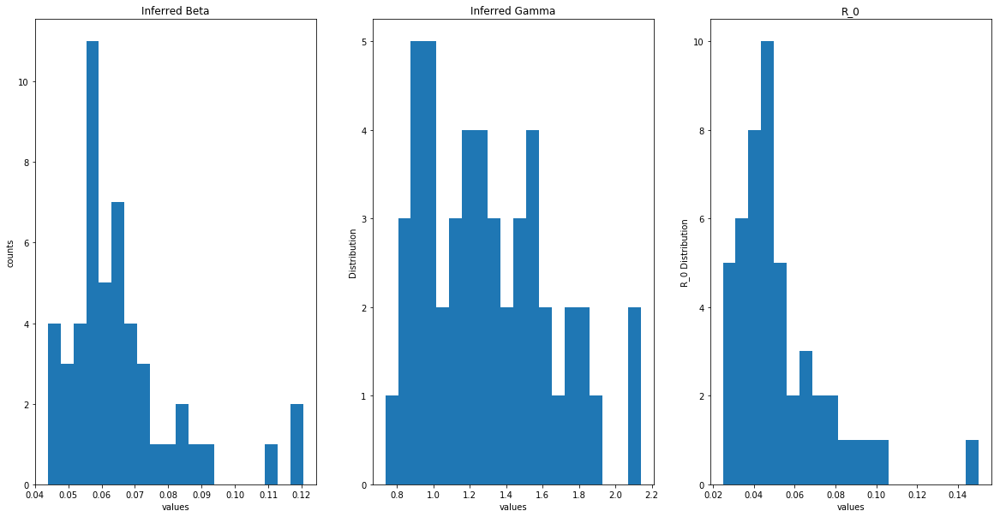

yolo


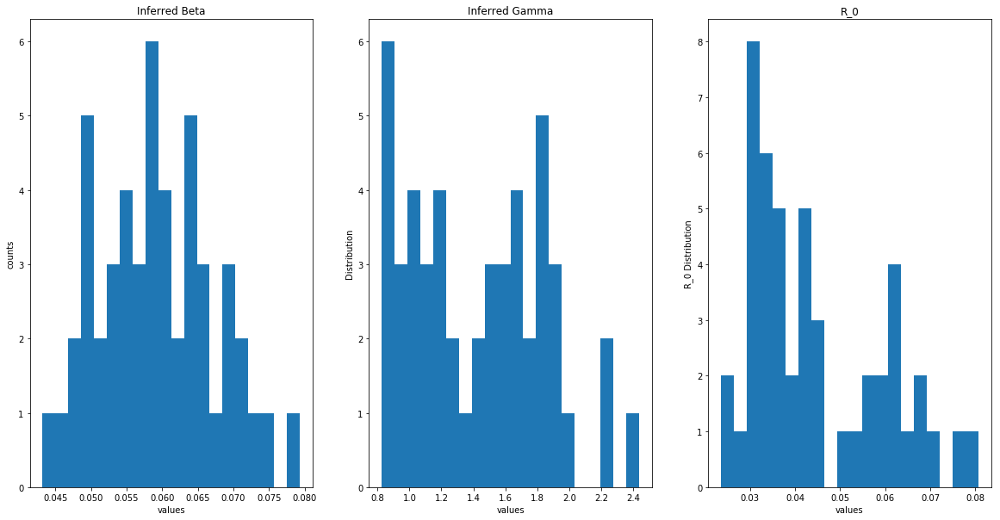

dead


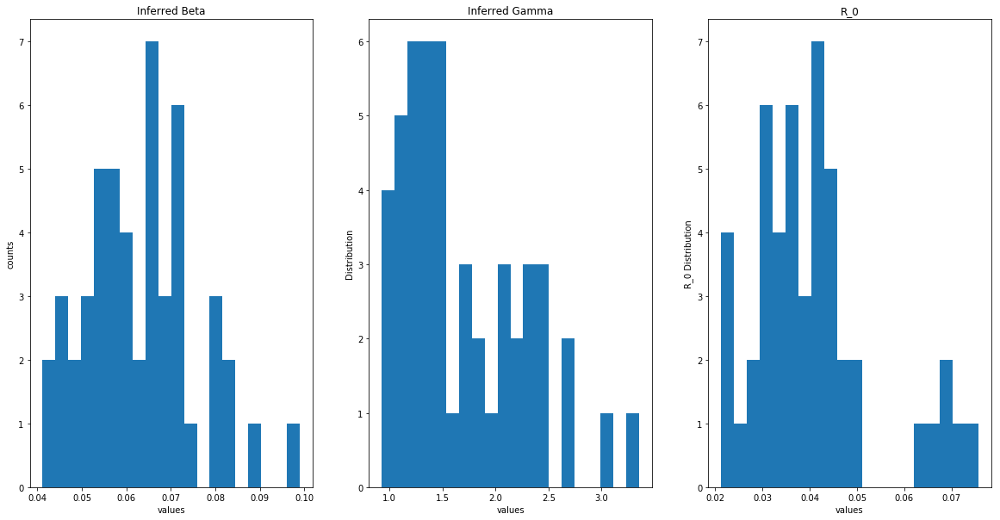

10thingsthatilike


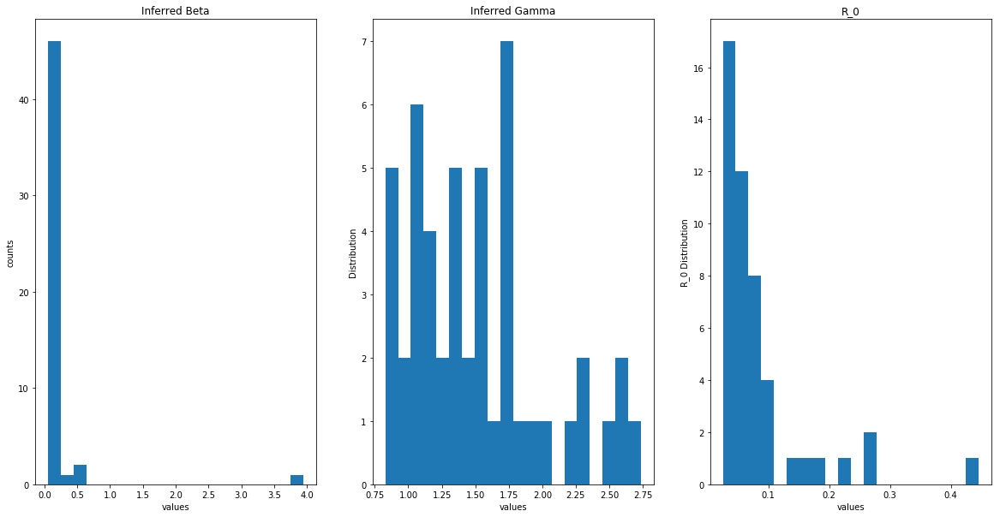

goodnight


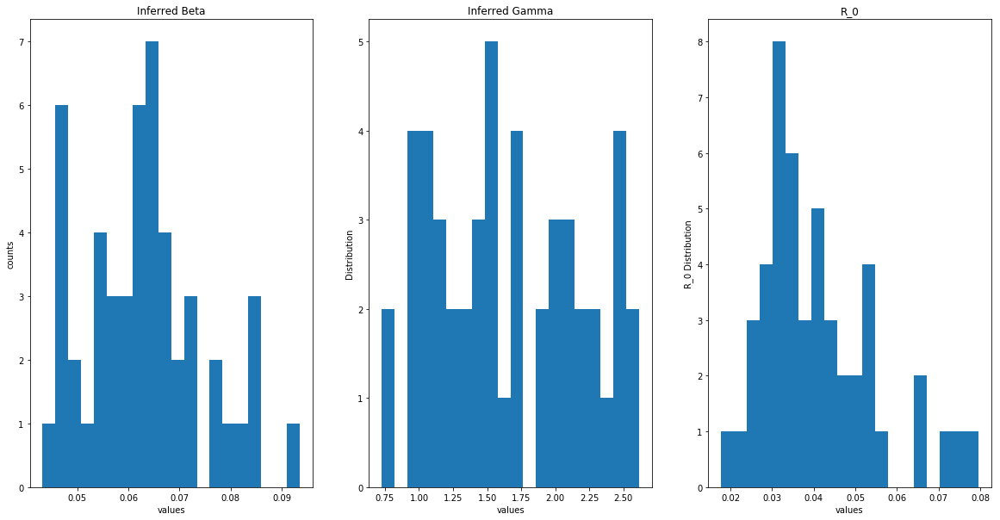

gemini


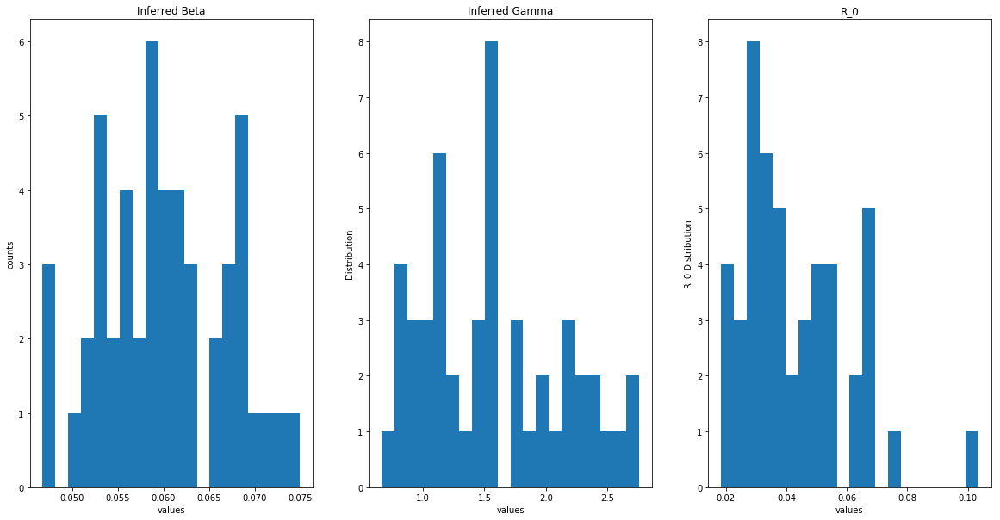

thatirritatesme


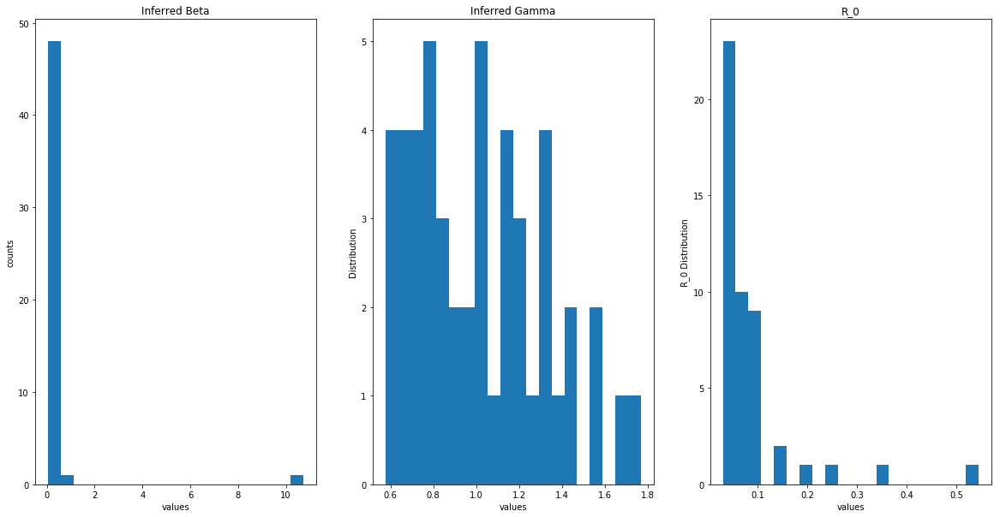

pisces


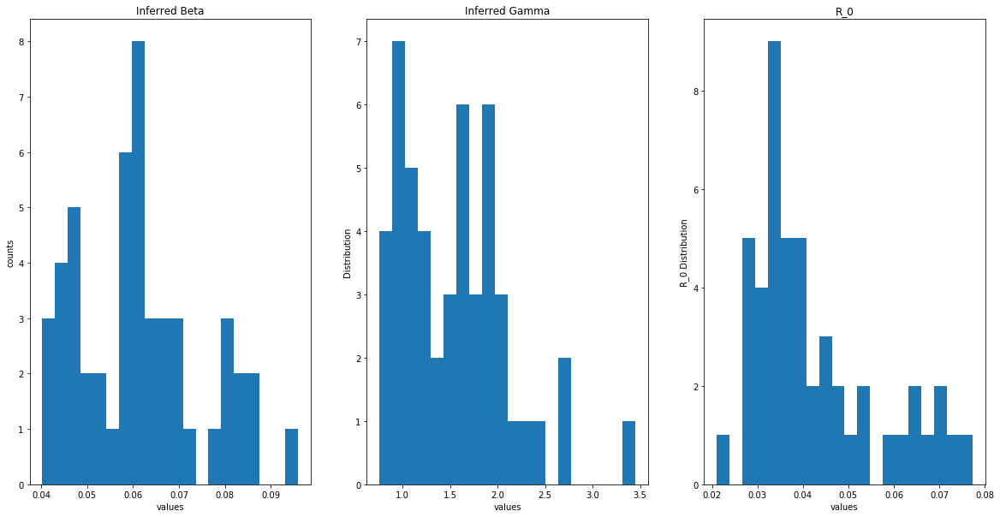

ifitwasuptome


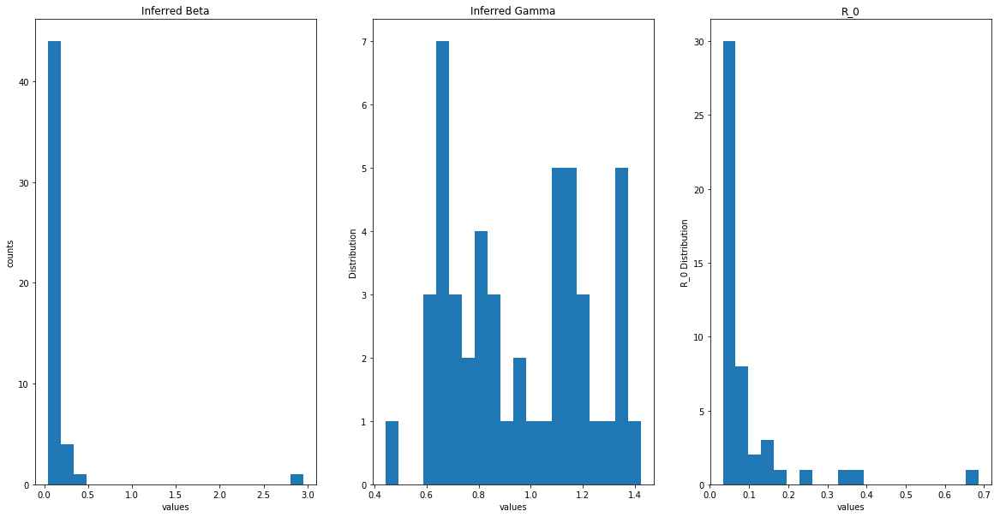

10thingsihate


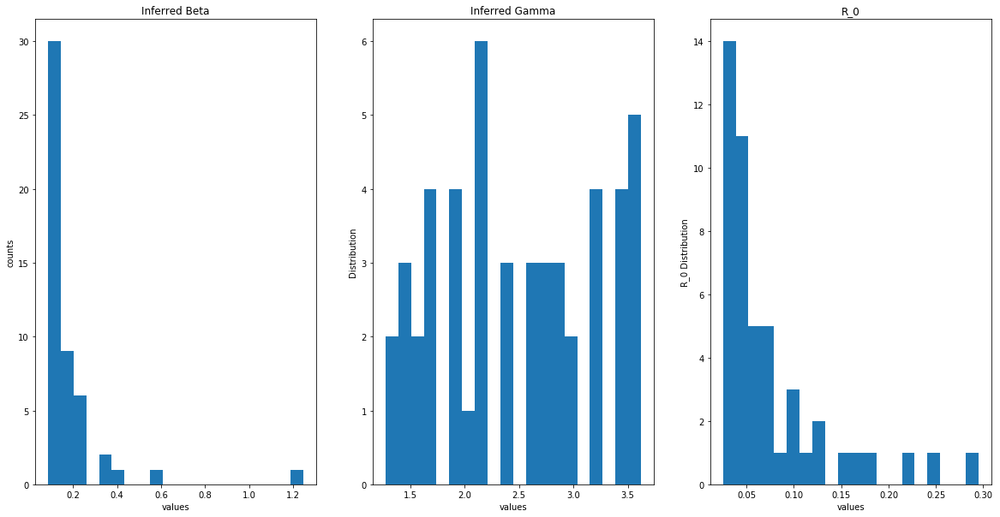

retweet


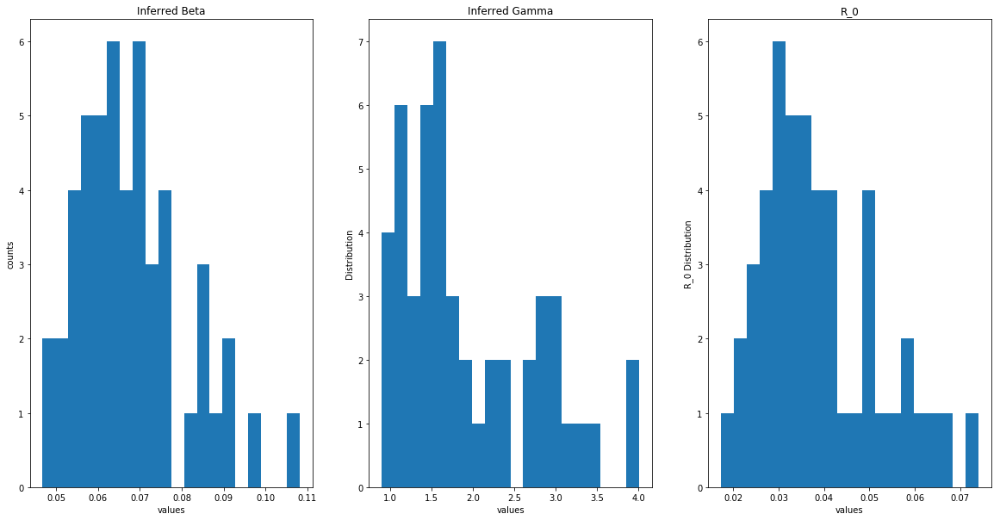

icantstandwhen


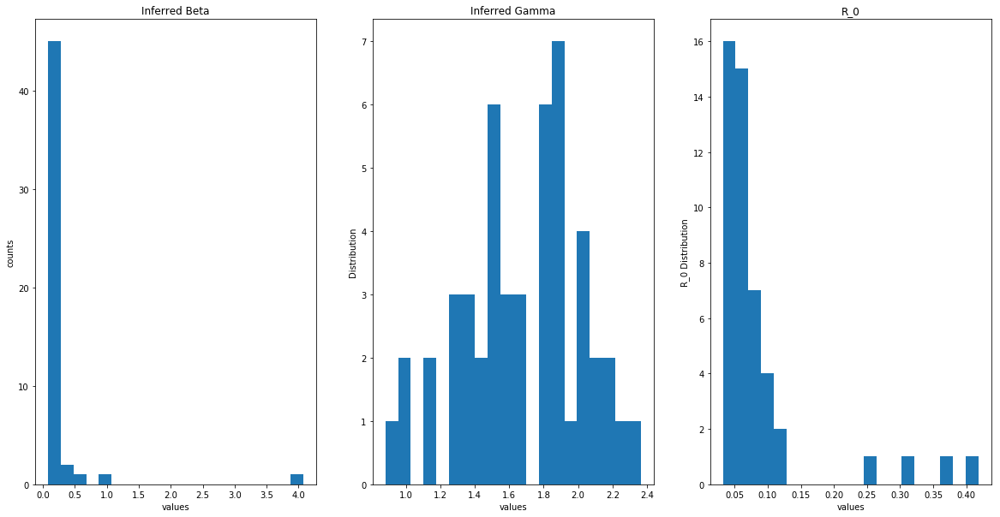

rt


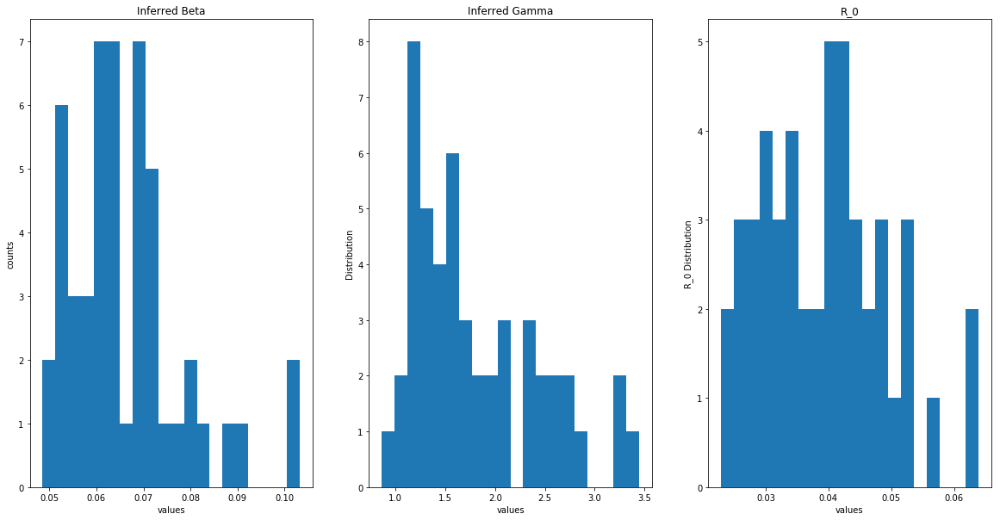

throwbackthursday


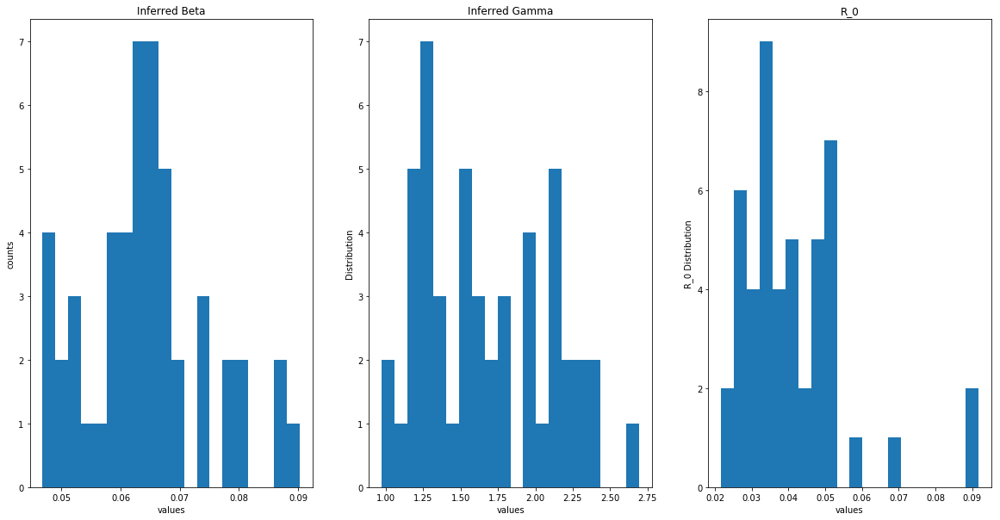

nf


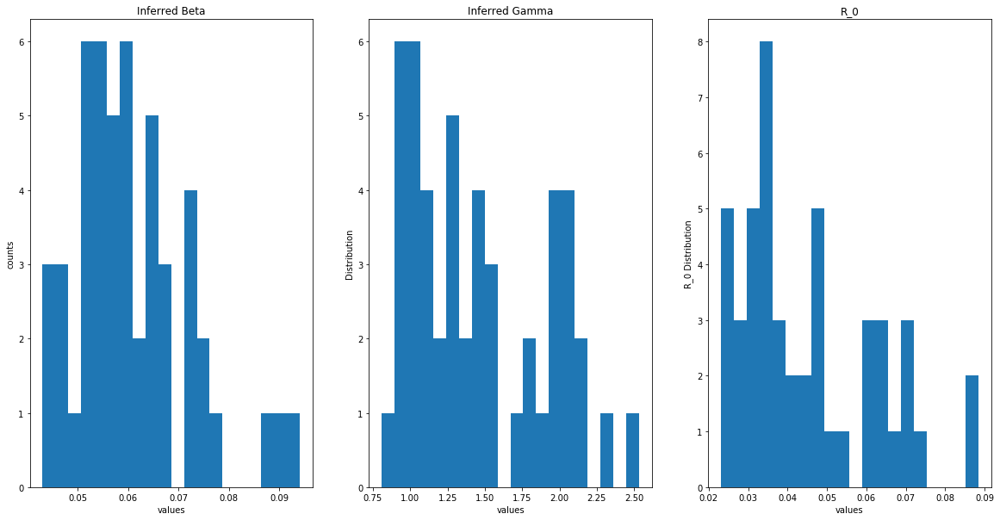

fact


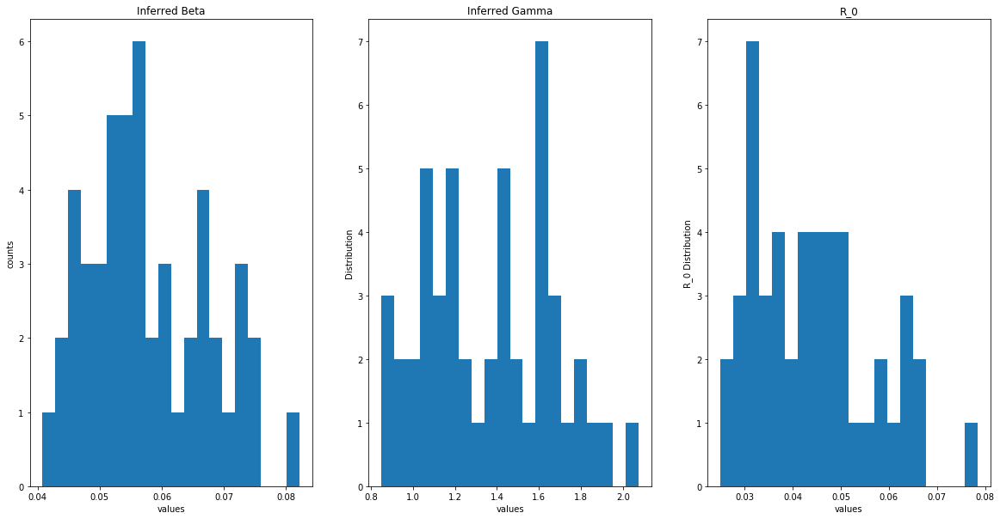

virgos


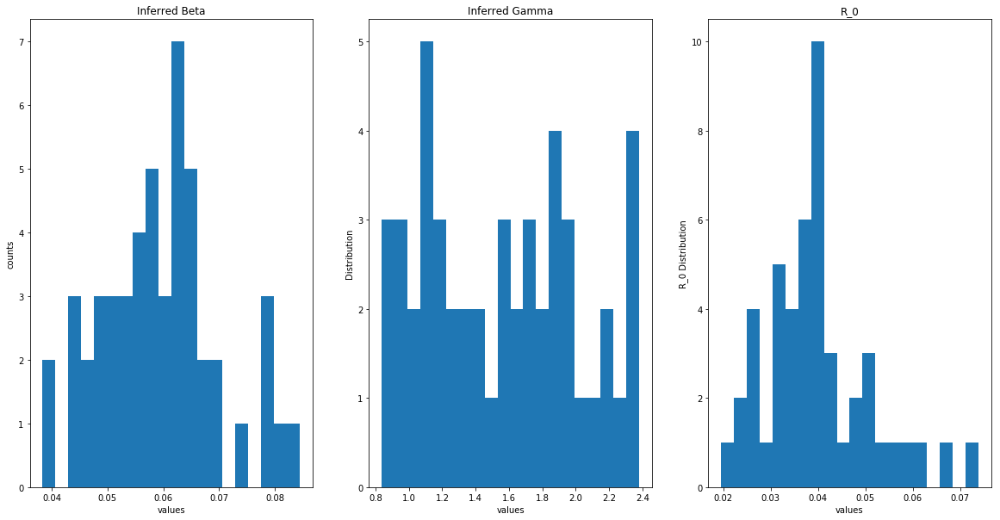

justsaying


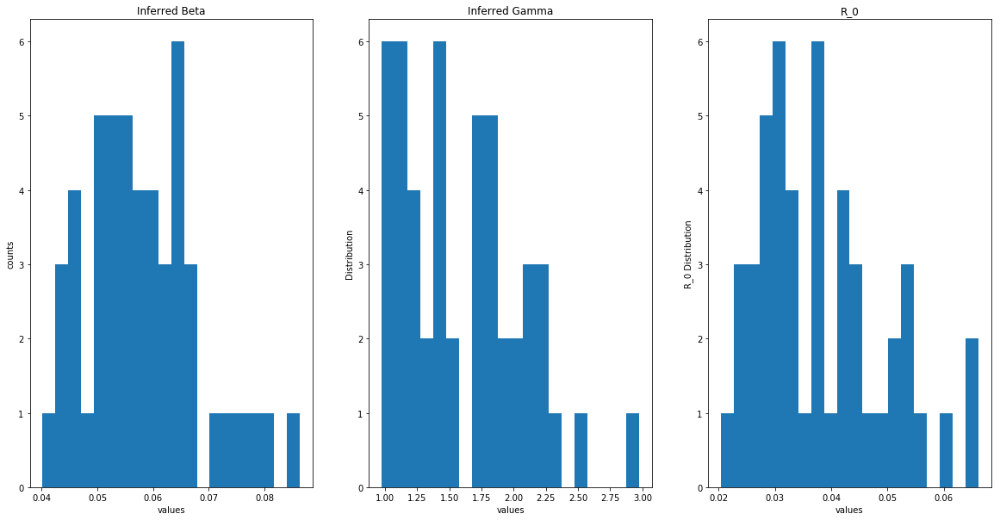

wheniwaslittle


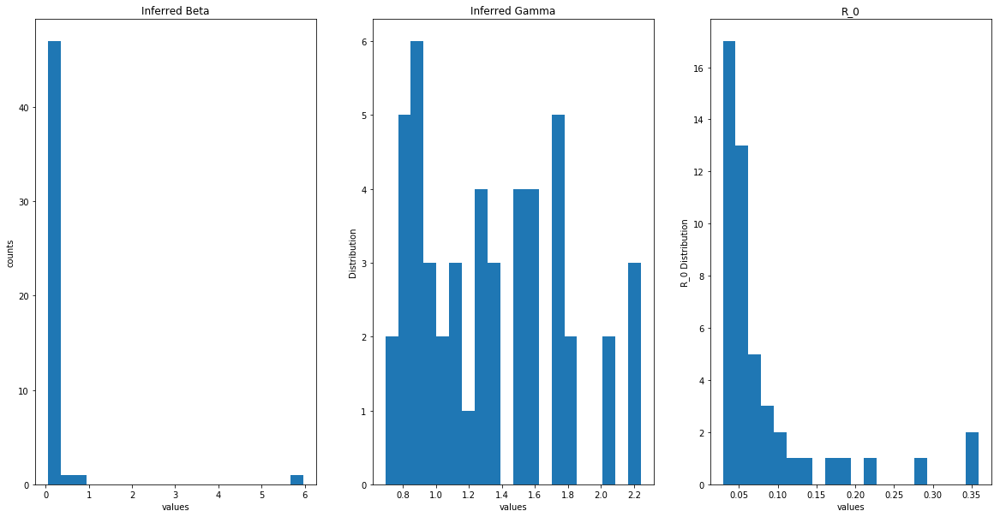

imsinglebecause


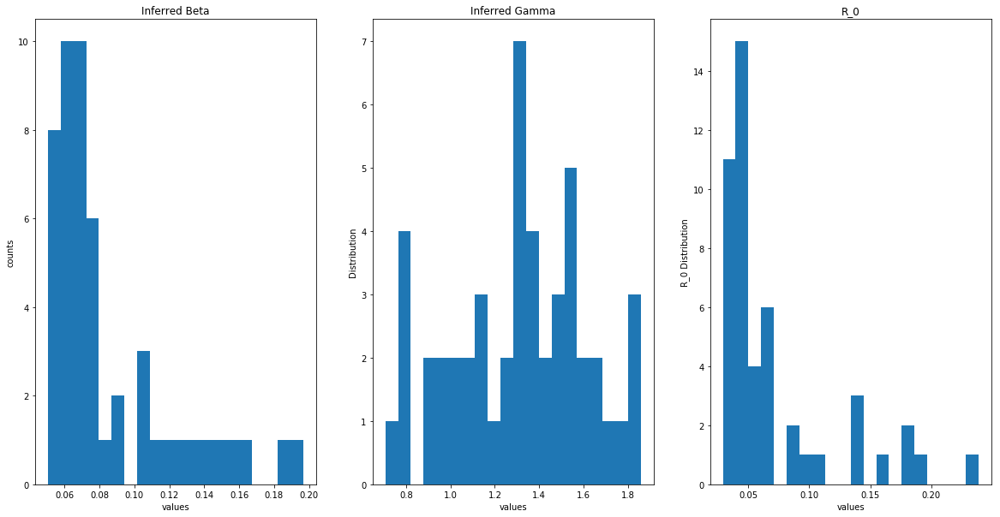

smh


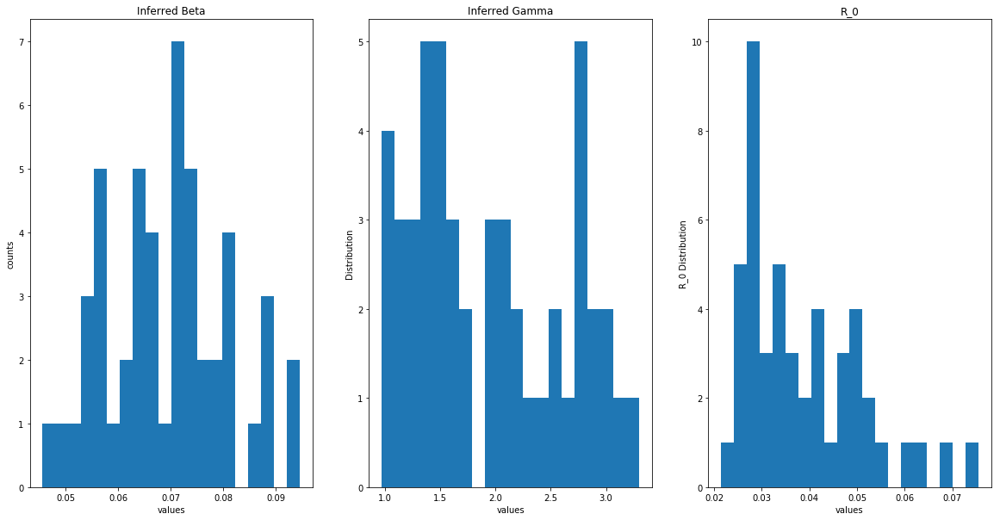

moviesthatnevergetold


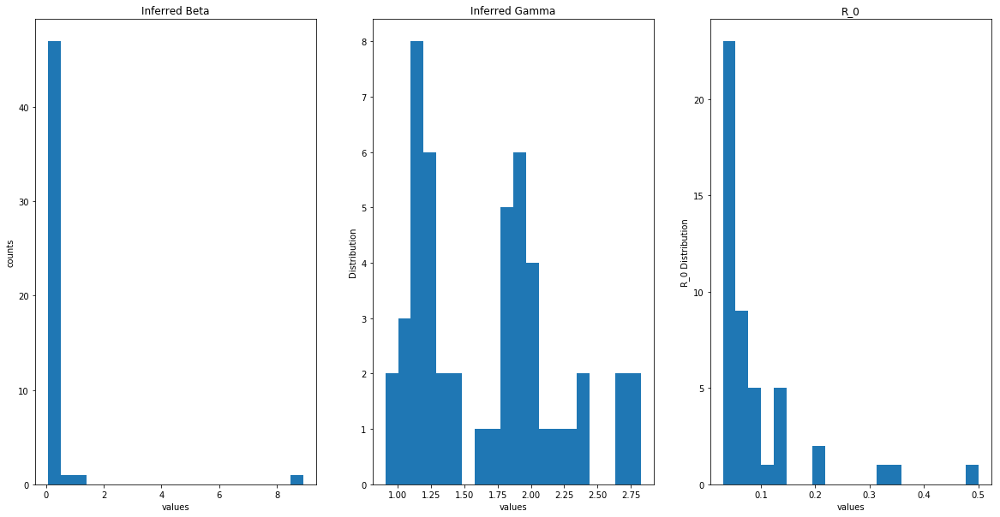

tweegram


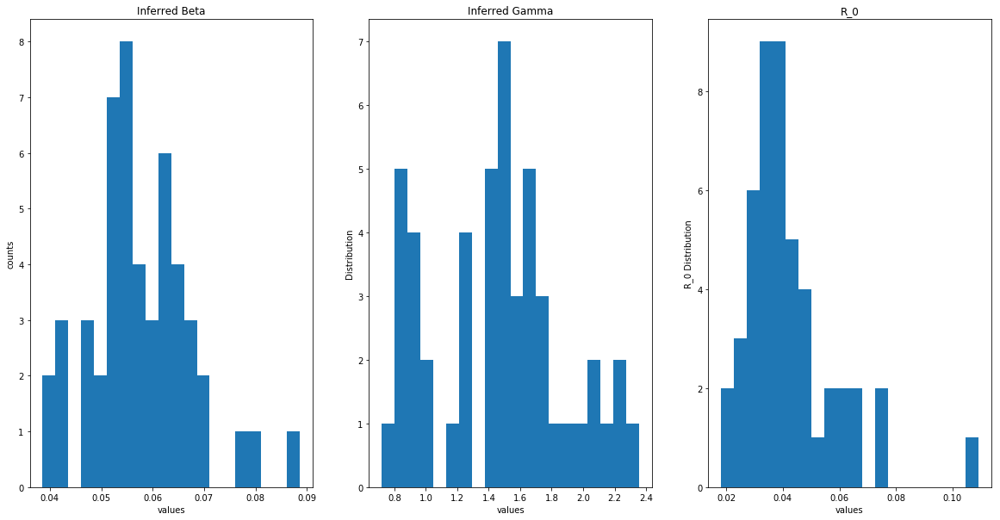

salute


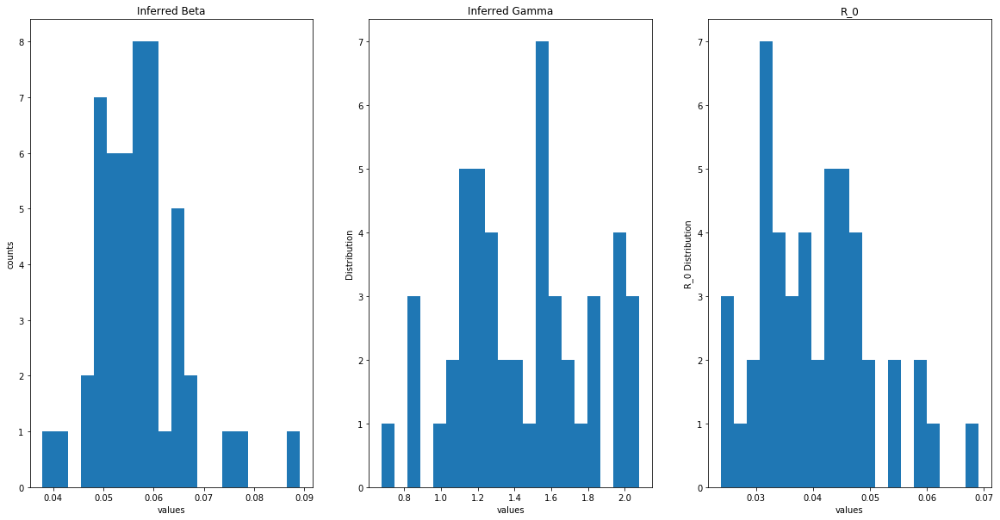

nw


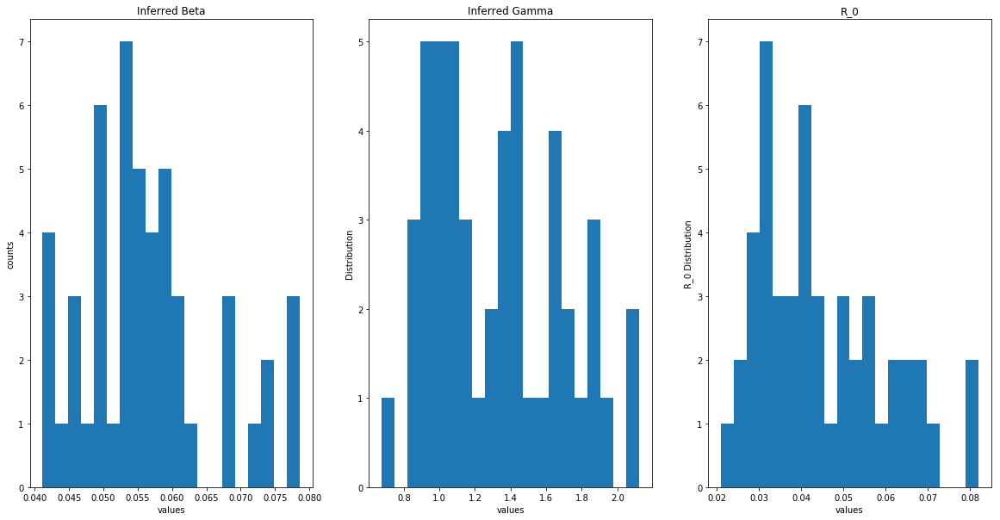

kca


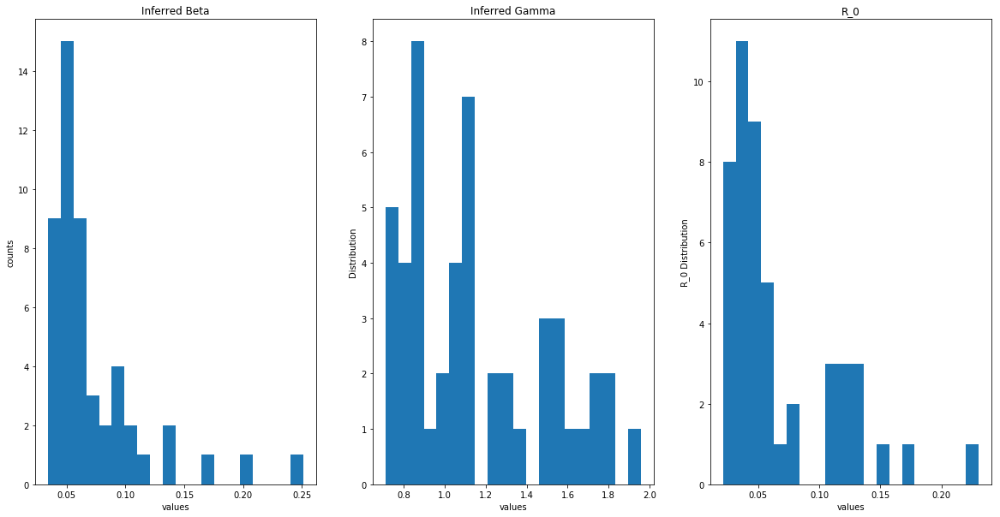

oomf


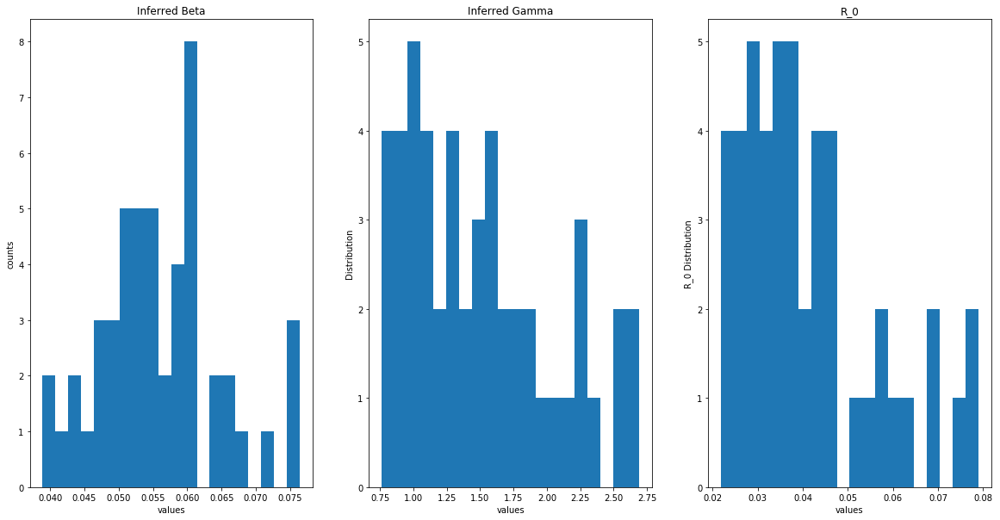

tcot


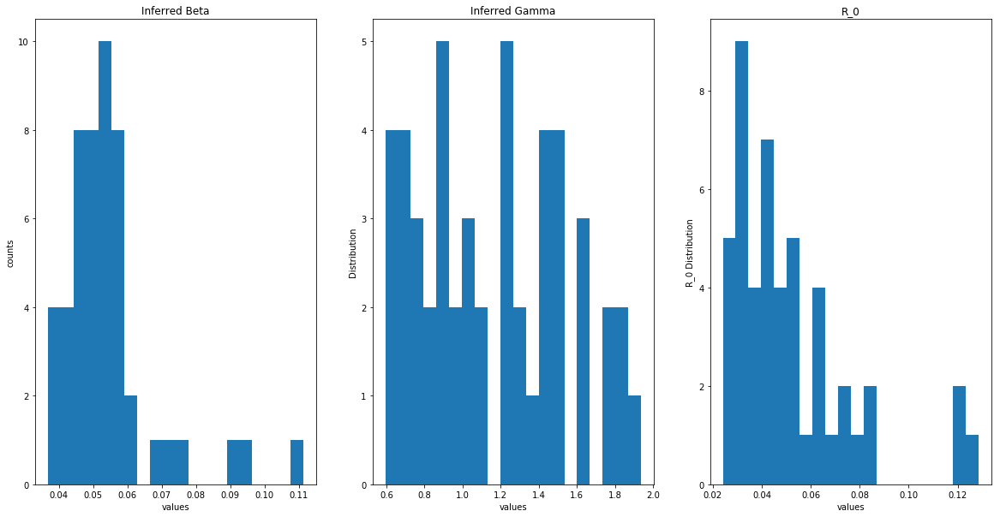

nationalbestfriendday


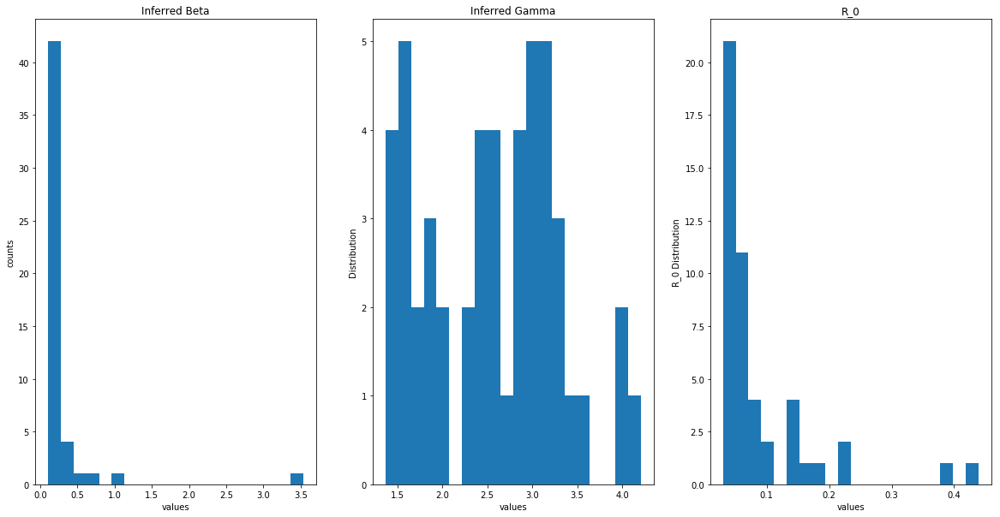

aquarius


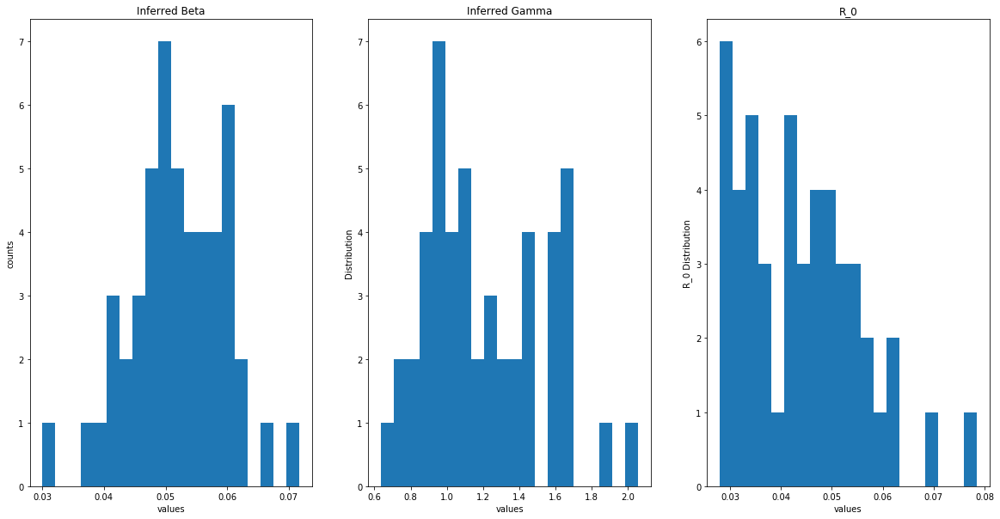

thingsmostpeoplelikebutidont


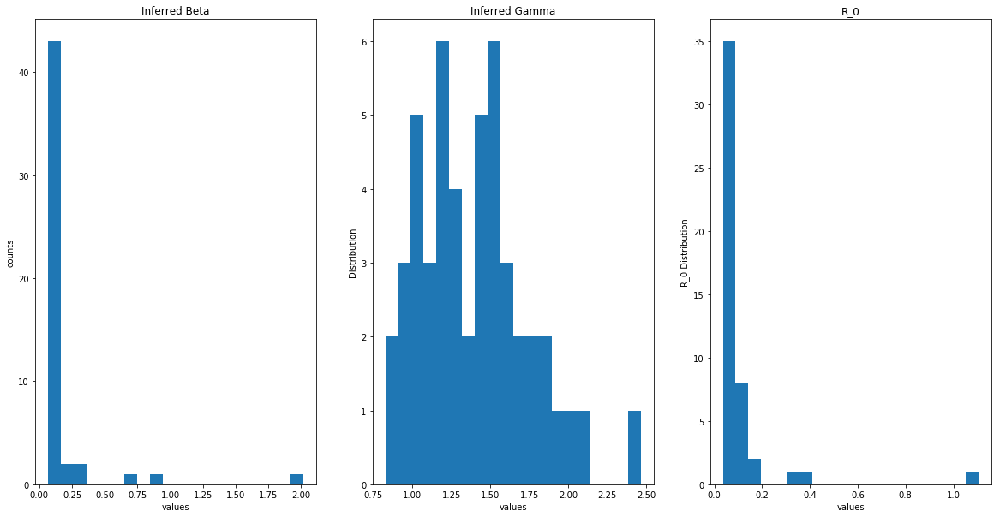

taurus


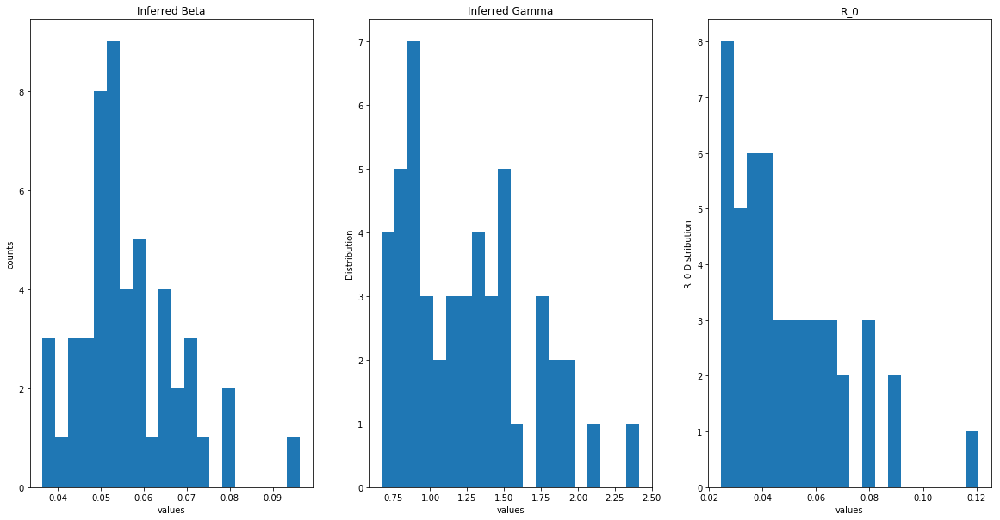

tbt


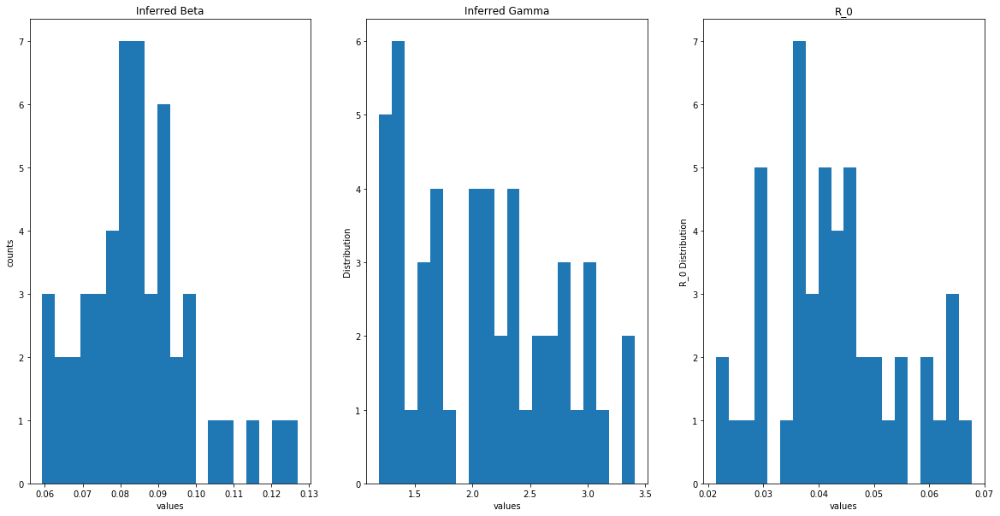

fb


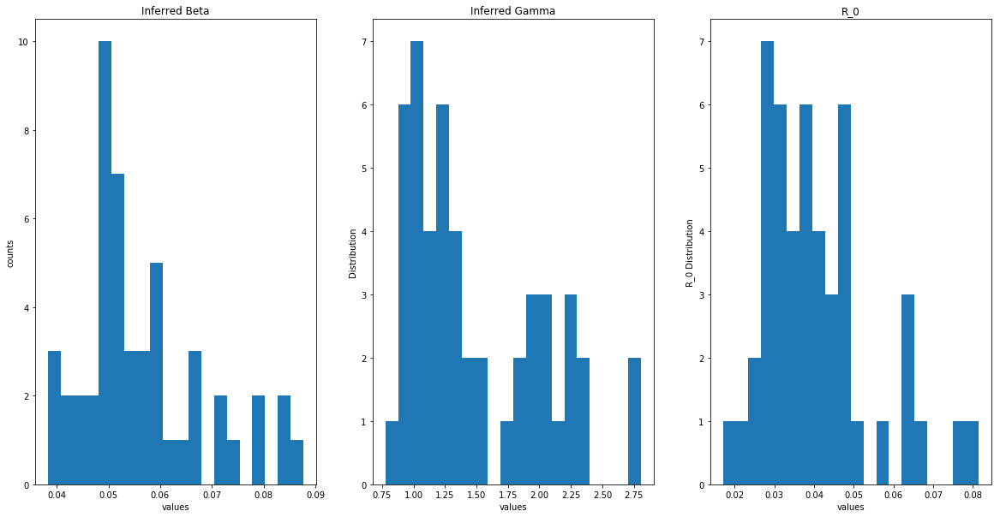

np


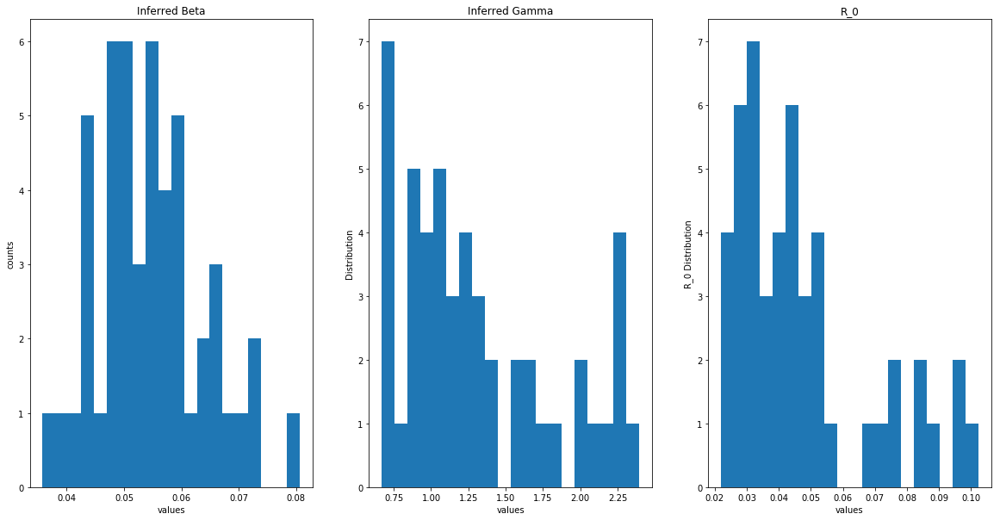

free


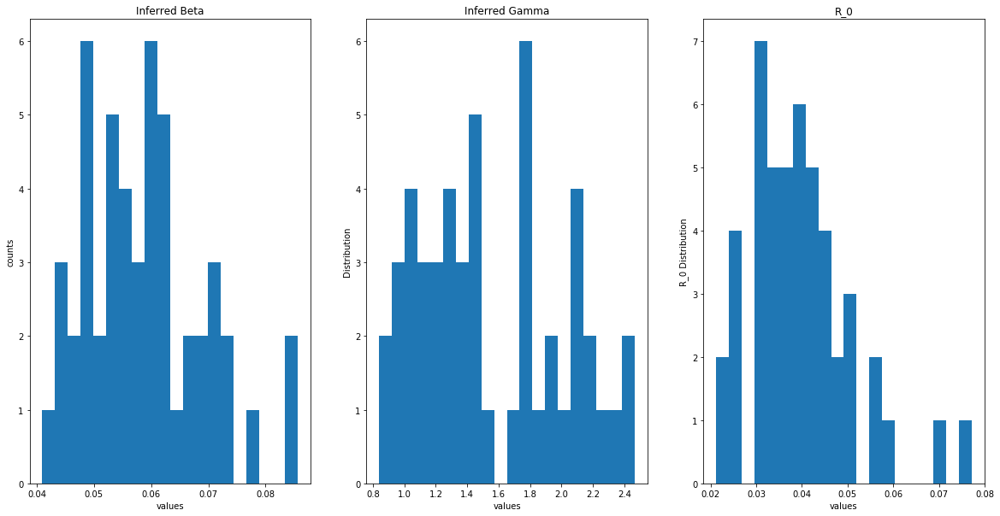

wtf


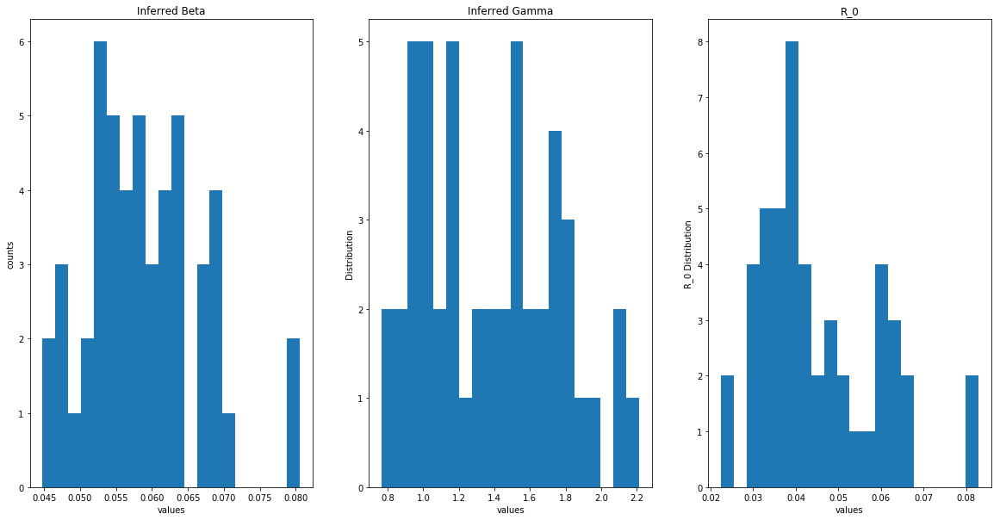

imagine


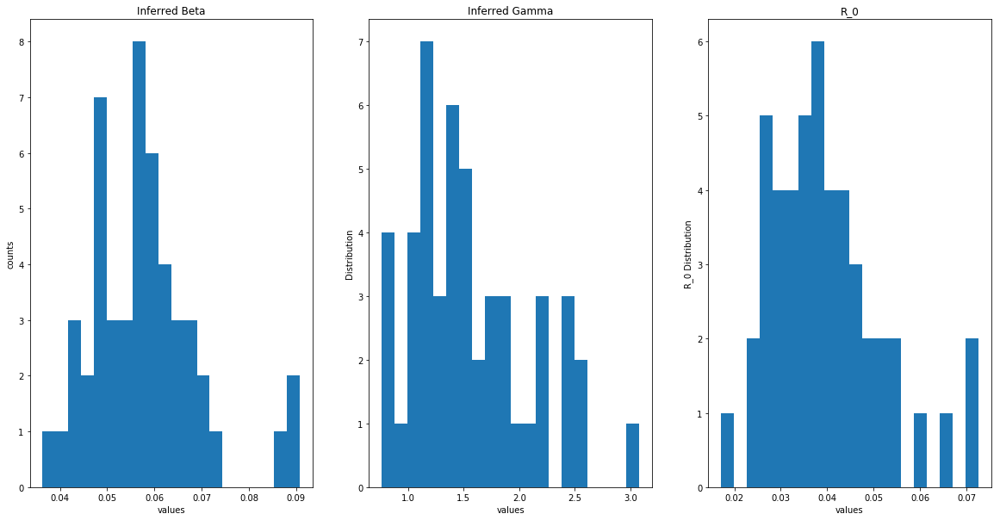

leo


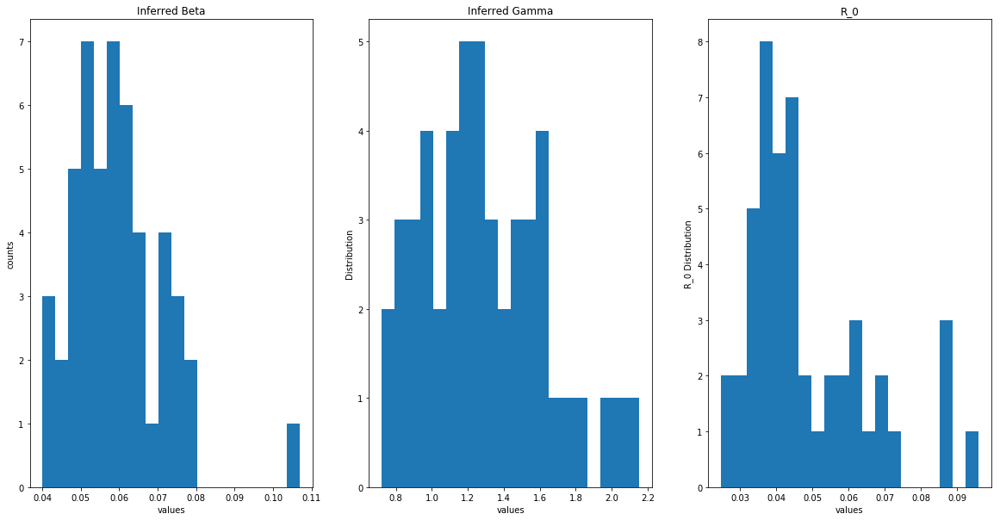

1dfact


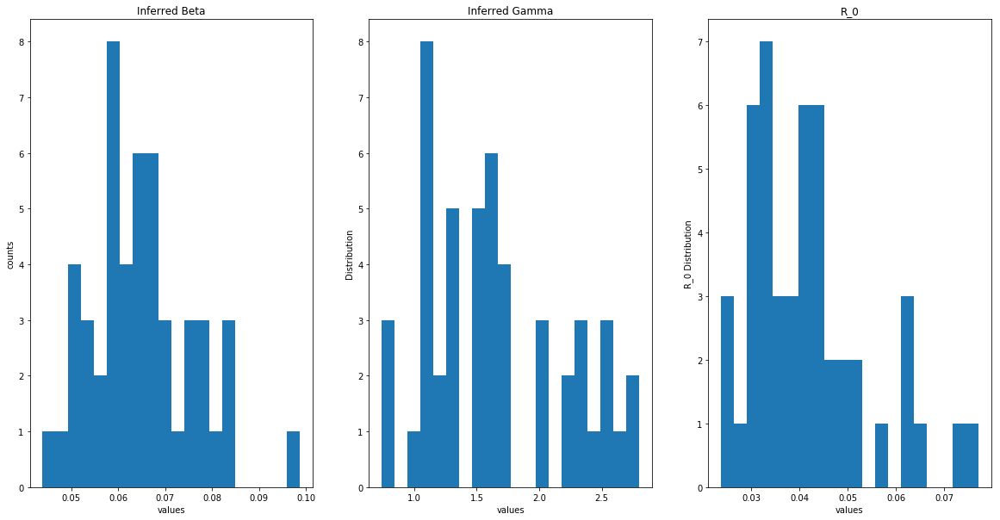

thingsigetalot


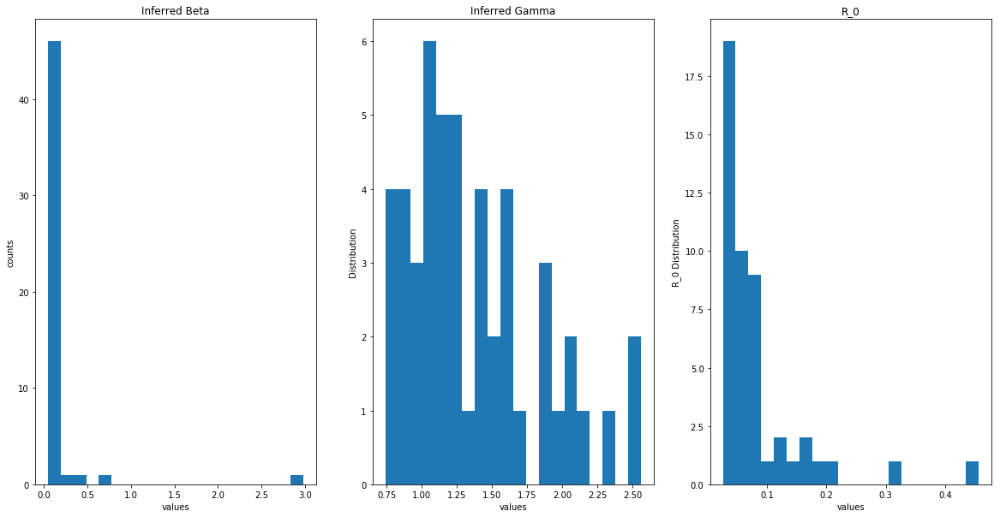

nowplaying


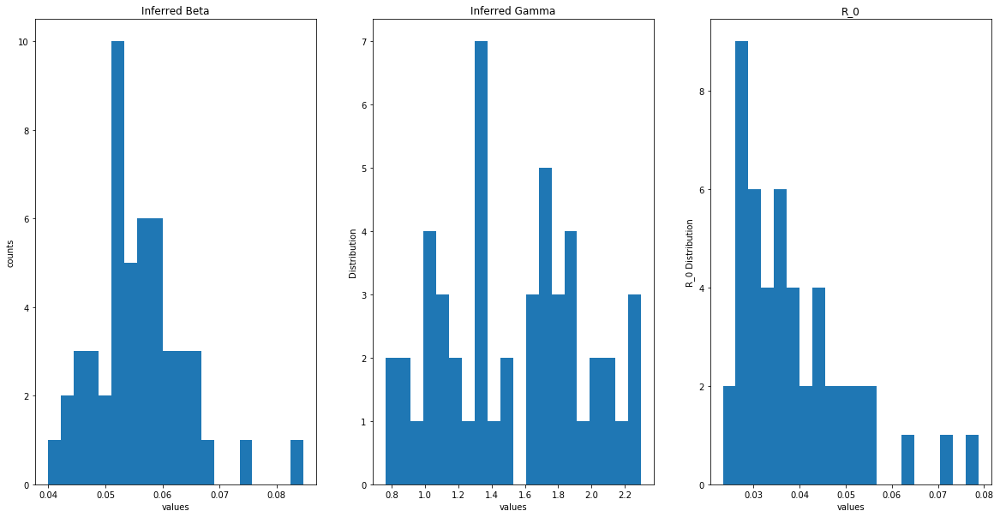

imhappywhen


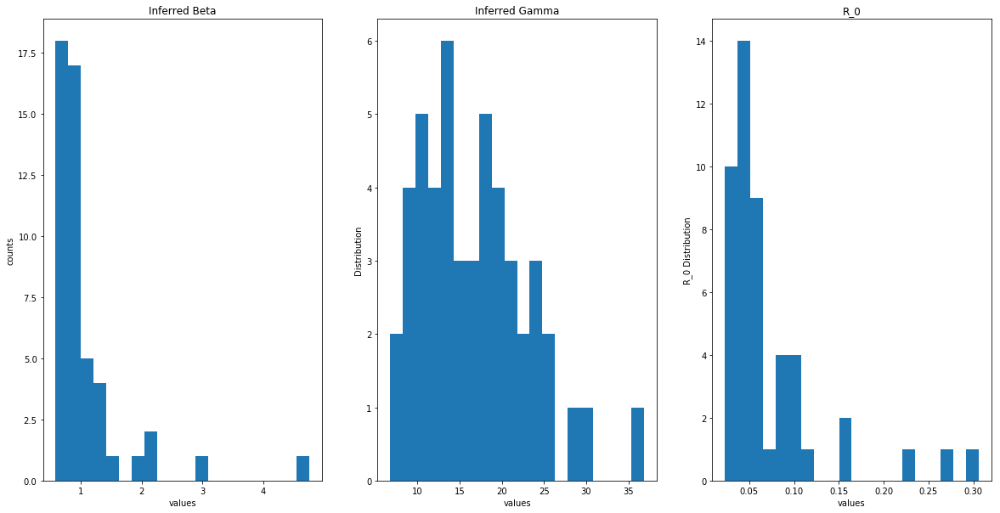

thingsisaywhilereadingmytl


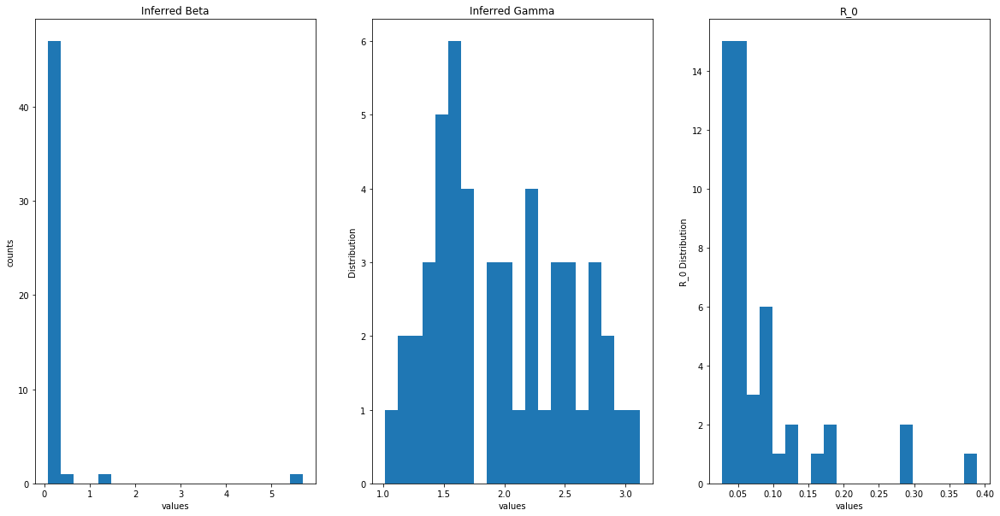

10factsaboutme


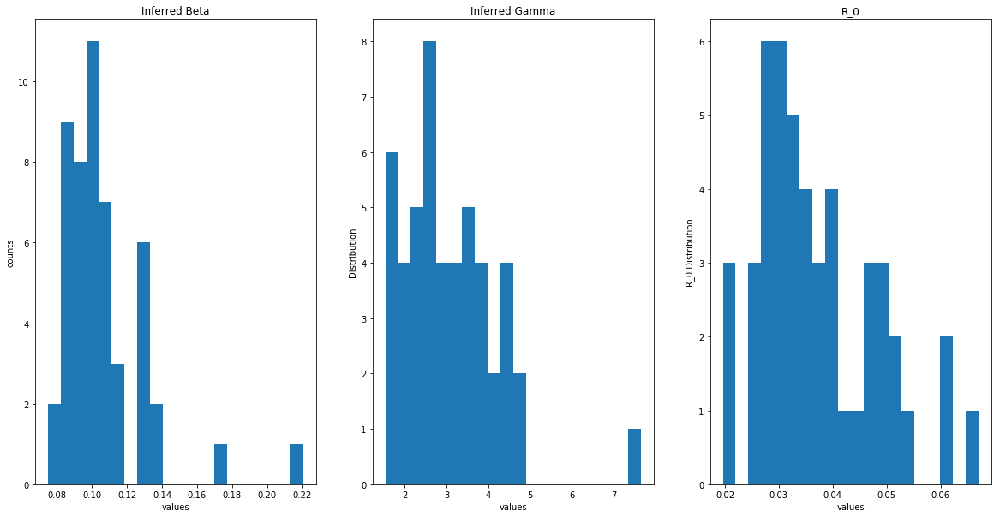

nowfollowing


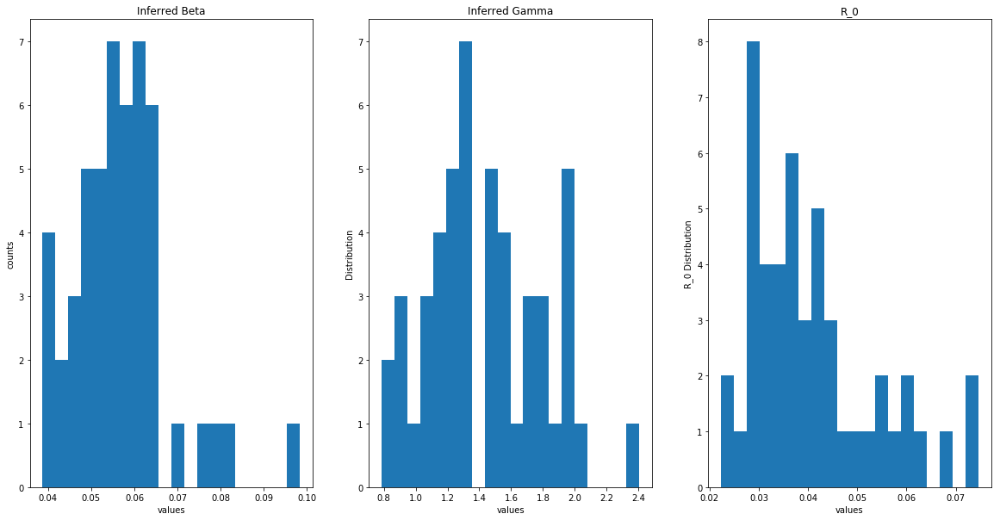

syria


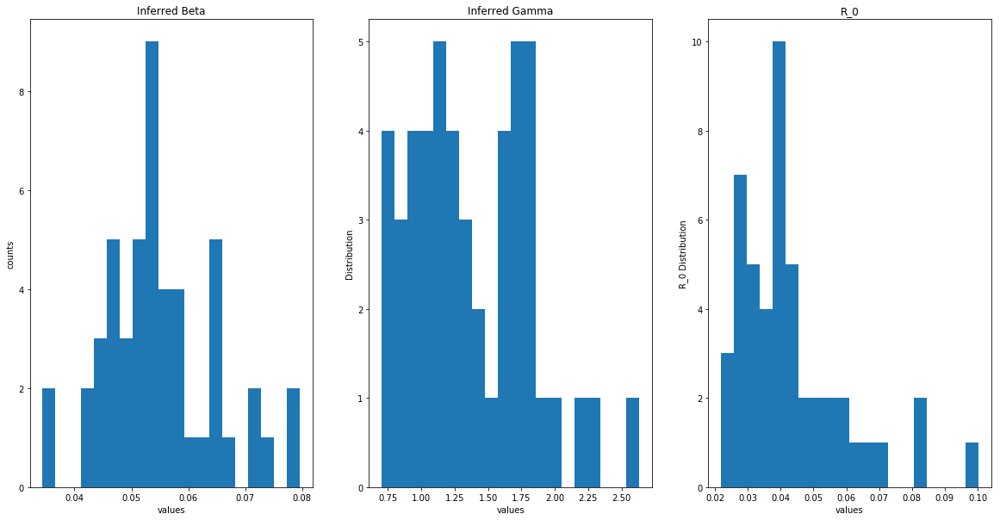

shoutout


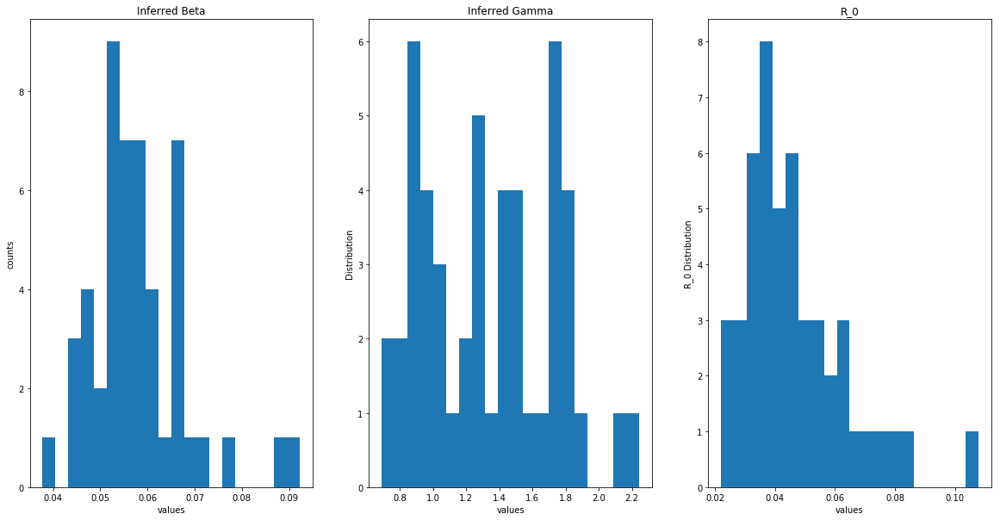

sagittarius


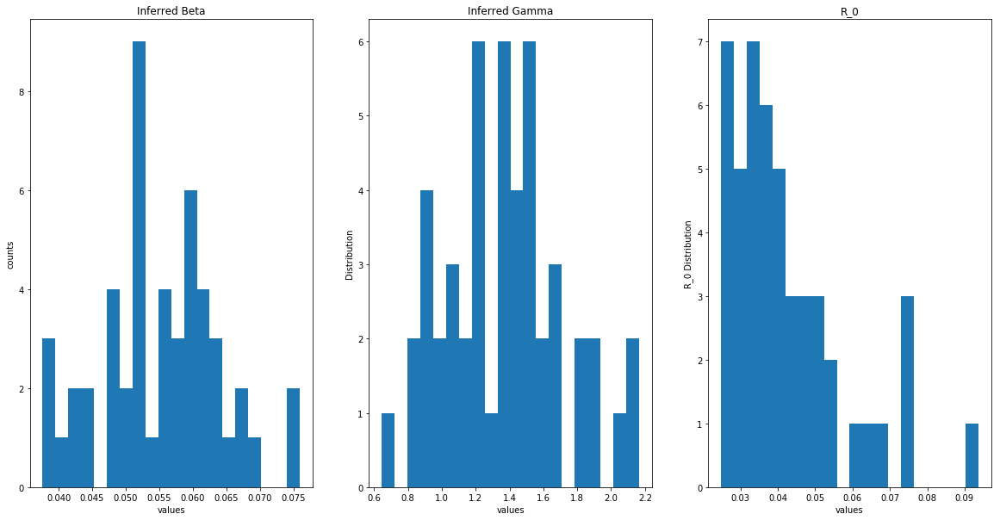

In [35]:
lmda_beta = 1.0
nu_beta = 10**(-3)
lmda_gamma= 1.0  
nu_gamma= 10**(-3)

fs = 50
N = fs
niter0 = 50
r0 = []
semi= []
for i in Inf_time_dict1:
    print(i)
    #initial values
    inf = [k for k in Inf_time_dict1[i] if k != 0]
    rec = [j for j in Rec_time_dict1[i] if j != 0]
    double_sum_cur=double_sum(inf, rec,fs)
    log_prod_cur = log_prod(inf, rec, fs)
    RminusI_cur = sum(np.array(inf[0:50]) - np.array(rec[0:50]))
    shapeB = fs - 1 +lmda_beta
    shapeg = fs +lmda_gamma
    d1 = nu_beta + (double_sum_cur/N)
    d2 = nu_gamma+(RminusI_cur/N)
    beta_cur= np.random.gamma(shape=shapeB, scale=1, size=None)/d1
    gamma_cur= np.random.gamma(shape=shapeg, scale=1, size=None)/d2
    Result = np.zeros((niter0,3), dtype=float)
    res= mcmcsir(niter0,inf[0:51],rec[0:51], double_sum_cur,log_prod_cur,RminusI_cur,beta_cur, gamma_cur, fs, Result)
    beta = np.array(res).T[0]
    gamma = np.array(res).T[1]
    r = (beta[1:]/gamma[1:])
    if np.mean(r)>0.1:
        r0.append((np.mean(r),i))
    if np.mean(r)>0.05:
        semi.append((np.mean(r),i))
    (fig, subplots) = plt.subplots(nrows=1, ncols=3, figsize= (20,10))
    ax_0 = subplots[0]
    ax_0.set_title('Inferred Beta')
    ax_0.hist(beta, bins = 20)
    ax_0.set_xlabel('values')
    ax_0.set_ylabel("counts")
    ##########################
    ax_1 = subplots[1]
    ax_1.set_title('Inferred Gamma')
    ax_1.hist(gamma[1:], bins = 20)
    ax_1.set_xlabel("values")
    ax_1.set_ylabel("Distribution")
    ###############################
    ax_2 = subplots[2]
    ax_2.set_title('R_0')
    ax_2.hist(r[1:], bins = 20)
    ax_2.set_xlabel("values")
    ax_2.set_ylabel("R_0 Distribution")
    plt.show()

In [36]:
len(r0),len(semi)

(10, 41)

In [37]:
semi

[(0.10403151270104918, 'top100lies'),
 (0.05094220457745812, 'cancer'),
 (0.08403934885871303, 'dearoomf'),
 (0.09202833151972886, 'itscutewhen'),
 (0.13411076005390846, '20thingsilove'),
 (0.06317502546553753, 'thoughtsduringschool'),
 (0.06437510272960754, 'mythoughtsduringschool'),
 (0.0633142078141452, 'trayvonmartin'),
 (0.07265106460930694, 'truthis'),
 (0.10123537231525384, 'twitterpeopleilove'),
 (0.05174051225953538, 'virgo'),
 (0.08090632195400005, 'confessionhour'),
 (0.08891057549539616, 'iadmit'),
 (0.10133401138005531, 'yougetpointsif'),
 (0.09737259222754081, 'yougetmajorpointsif'),
 (0.05180051672179126, 'lrt'),
 (0.07758659784225924, 'theworstfeeling'),
 (0.056116137741682275, 'boyfriend'),
 (0.0500459485527291, 'p2'),
 (0.08397640593101396, 'inourgeneration'),
 (0.08680198738077785, 'middleschoolmemories'),
 (0.0876033909534017, 'youknowwhatsannoying'),
 (0.07225266295179274, '10thingsifindattractive'),
 (0.08645981535888006, 'mybiggestproblem'),
 (0.05463331221772721

In [38]:
r0

[(0.10403151270104918, 'top100lies'),
 (0.13411076005390846, '20thingsilove'),
 (0.10123537231525384, 'twitterpeopleilove'),
 (0.10133401138005531, 'yougetpointsif'),
 (0.10372554505121981, 'thatirritatesme'),
 (0.10731885650798997, 'ifitwasuptome'),
 (0.10496989716876348, 'icantstandwhen'),
 (0.10559594534971287, 'moviesthatnevergetold'),
 (0.11660916590450288, 'thingsmostpeoplelikebutidont'),
 (0.10085071793871783, 'thingsisaywhilereadingmytl')]

In [39]:
ff = Series_time_convert(Data_rt['ff'], 3)[30:] #i dropped the first few days since probably theie behavious was due to previous fridays
I_history, R_history, InfUsers_history, RecUsers_history, bad = InfectionHistory(ff, seasonality=4*24, N_hours=3)

In [44]:
S_history = SusceptibleHistory(Follow_ConnList, InfUsers_history[0:50], RecUsers_history[0:50])

In [45]:
def SIR_plot(I_history, R_history, S_history, tmin=0, tmax=None): #S must be already cut
    if tmax == None:
        tmax=len(I_history)
    x = np.arange(tmin,tmax)
    I = I_history[tmin:tmax]
    R = R_history[tmin:tmax]
    
    plt.plot(x,I, label="I", color="firebrick")
    plt.plot(x,R, label="R", color="seagreen")
    plt.plot(x,S_history, label="S", color="Gold")
    
    plt.xlabel("Time(hours)")
    plt.ylabel("N. of Users")
    plt.legend()
    plt.show()


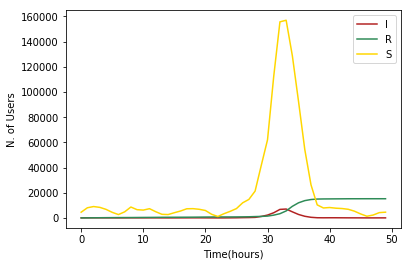

In [46]:
SIR_plot(I_history,R_history,S_history,tmin=0, tmax=50)